# 

In [ ]:
"""使用TCN加上custom loss function，與使用TCN, loss func使用MSE比較，為了減少Random seed的影響
，將每個參數組合跑10次後，平均，做出來的結果顯示加上custom loss func後，
報酬率平均比單純使用MSE作為損失函數好10%"""

In [1]:
import tensorflow as tf
print(tf.__version__)


2.0.0-dev20190213


In [2]:
print(tf.__file__ )

C:\Windows\system32\env002\lib\site-packages\tensorflow\__init__.py


# work: model  9 10

In [3]:
#tf.enable_eager_execution()

In [4]:
tf.executing_eagerly()


True

In [5]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import pydot_ng
%matplotlib inline

In [6]:
import mpld3
mpld3.enable_notebook()

In [7]:
data_dir = r'D:\python_code\data\us\rua'

fname = os.path.join(data_dir, 'rua_1988_2017_technical.csv')
df = pd.read_csv(fname)
df['Date'] = pd.to_datetime(df["Date"])
df_idx = df.set_index(["Date"], drop=True)
df_idx.head(5)

,Close,<Open>,<High>,<Low>,<Volume>
Date,,,,,
1988-01-04,143.20,138.68,143.32,138.68,0
1988-01-05,144.93,143.20,146.32,143.20,0
1988-01-06,145.29,144.93,145.59,144.37,0
1988-01-07,146.35,145.29,146.39,143.99,0
1988-01-08,137.78,146.35,146.35,137.68,0


In [8]:
#把順序調換
df_idx = df_idx.sort_index(axis=0, ascending=False)
df_idx = df_idx.iloc[::-1]

In [9]:
df_idx.head(5)

,Close,<Open>,<High>,<Low>,<Volume>
Date,,,,,
1988-01-04,143.20,138.68,143.32,138.68,0
1988-01-05,144.93,143.20,146.32,143.20,0
1988-01-06,145.29,144.93,145.59,144.37,0
1988-01-07,146.35,145.29,146.39,143.99,0
1988-01-08,137.78,146.35,146.35,137.68,0


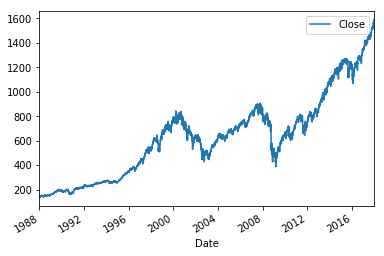

In [10]:
data = df_idx
data.plot(y='Close')

In [11]:
diff = data.index.values[-1] - data.index.values[0]
days = diff.astype('timedelta64[D]')
days = days / np.timedelta64(1, 'D')
years = int(days/365)
print("total data days:",days)
print("Total data: %d years"%years)
print("80 percent data = 1988 to %d"%(1988 + int(0.8*years)))
print(diff)
delay = 5

total data days: 10952.0
Total data: 30 years
80 percent data = 1988 to 2012
946252800000000000 nanoseconds


In [12]:
#切割訓練與測試資料
split_date = pd.Timestamp('01-01-2013')

train = data.loc[:split_date]
test = data.loc[split_date:]
test_date = test.index
test_date = pd.to_datetime(test_date)
train_date = train.index
train_date = pd.to_datetime(train_date)

In [13]:
# 資料正規化

from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler()
train_sc = sc.fit_transform(train)
test_sc = sc.transform(test)

C:\Windows\system32\env002\lib\site-packages\sklearn\preprocessing\data.py:323: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [14]:
#without sc
#train_sc = train
#test_sc = test

In [15]:
train_sc.shape

(6302, 5)

In [16]:
train_sc_df = pd.DataFrame(train_sc,index=train.index,columns=train.columns)
test_sc_df = pd.DataFrame(test_sc,index=test.index,columns=test.columns)



In [17]:
train_sc_df

,Close,<Open>,<High>,<Low>,<Volume>
Date,,,,,
1988-01-04,0.007840,0.001973,0.006943,0.003862,0.0
1988-01-05,0.010085,0.007841,0.010807,0.009761,0.0
1988-01-06,0.010553,0.010086,0.009866,0.011287,0.0
1988-01-07,0.011929,0.010554,0.010897,0.010791,0.0
1988-01-08,0.000805,0.011930,0.010845,0.002558,0.0
1988-01-11,0.002687,0.000805,0.001674,0.000718,0.0
1988-01-12,0.001103,0.002687,0.001674,0.000000,0.0
1988-01-13,0.001454,0.001103,0.002306,0.000679,0.0
1988-01-14,0.001597,0.001454,0.001288,0.002453,0.0


In [18]:
test_sc_df

,Close,<Open>,<High>,<Low>,<Volume>
Date,,,,,
2013-01-02,0.948548,0.921100,0.940312,0.927775,0.0
2013-01-03,0.946912,0.948101,0.944434,0.951067,0.0
2013-01-04,0.953013,0.947166,0.945812,0.953703,0.0
2013-01-07,0.949521,0.951593,0.943210,0.952711,0.0
2013-01-08,0.946250,0.948594,0.940570,0.948861,0.0
2013-01-09,0.949962,0.947659,0.944009,0.954472,0.0
2013-01-10,0.957439,0.953332,0.949251,0.956521,0.0
2013-01-11,0.957517,0.957421,0.949599,0.960893,0.0
2013-01-14,0.956777,0.957603,0.949264,0.959888,0.0


In [19]:
for s in range(-delay,-delay+1):
    train_sc_df['Y_{}'.format(s)] = train_sc_df['Close'].shift(s)
    test_sc_df['Y_{}'.format(s)] = test_sc_df['Close'].shift(s)



In [20]:
train_sc_df

,Close,<Open>,<High>,<Low>,<Volume>,Y_-5
Date,,,,,,
1988-01-04,0.007840,0.001973,0.006943,0.003862,0.0,0.002687
1988-01-05,0.010085,0.007841,0.010807,0.009761,0.0,0.001103
1988-01-06,0.010553,0.010086,0.009866,0.011287,0.0,0.001454
1988-01-07,0.011929,0.010554,0.010897,0.010791,0.0,0.001597
1988-01-08,0.000805,0.011930,0.010845,0.002558,0.0,0.005750
1988-01-11,0.002687,0.000805,0.001674,0.000718,0.0,0.005867
1988-01-12,0.001103,0.002687,0.001674,0.000000,0.0,0.004517
1988-01-13,0.001454,0.001103,0.002306,0.000679,0.0,0.000000
1988-01-14,0.001597,0.001454,0.001288,0.002453,0.0,0.000389


In [21]:
test_sc_df

,Close,<Open>,<High>,<Low>,<Volume>,Y_-5
Date,,,,,,
2013-01-02,0.948548,0.921100,0.940312,0.927775,0.0,0.949962
2013-01-03,0.946912,0.948101,0.944434,0.951067,0.0,0.957439
2013-01-04,0.953013,0.947166,0.945812,0.953703,0.0,0.957517
2013-01-07,0.949521,0.951593,0.943210,0.952711,0.0,0.956777
2013-01-08,0.946250,0.948594,0.940570,0.948861,0.0,0.958906
2013-01-09,0.949962,0.947659,0.944009,0.954472,0.0,0.958425
2013-01-10,0.957439,0.953332,0.949251,0.956521,0.0,0.965344
2013-01-11,0.957517,0.957421,0.949599,0.960893,0.0,0.969017
2013-01-14,0.956777,0.957603,0.949264,0.959888,0.0,0.974624


In [22]:
#X_train = train_sc_df.dropna().drop('Y', axis=1)
X_train = train_sc_df.dropna().drop('Y_-'+str(delay), axis=1)
y_train = train_sc_df.dropna()['Y_-'+str(delay)]
X_train = X_train.as_matrix()
y_train = y_train.as_matrix()


C:\Windows\system32\env002\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  after removing the cwd from sys.path.
C:\Windows\system32\env002\lib\site-packages\ipykernel_launcher.py:5: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """


In [23]:
X_train

array([[0.00783988, 0.00197315, 0.00694257, 0.00386246, 0.        ],
       [0.01008541, 0.00784069, 0.0108067 , 0.00976055, 0.        ],
       [0.01055269, 0.01008646, 0.00986643, 0.01128727, 0.        ],
       ...,
       [0.92700086, 0.93456136, 0.9266458 , 0.93380309, 0.        ],
       [0.93293269, 0.9274606 , 0.92479101, 0.93150649, 0.        ],
       [0.92293814, 0.92883662, 0.92063063, 0.92423827, 0.        ]])

In [24]:
X_train.shape

(6297, 5)

In [25]:
y_train.shape

(6297,)

In [26]:
X_test = test_sc_df.dropna().drop('Y_-'+str(delay), axis=1)
y_test = test_sc_df.dropna().dropna()['Y_-'+str(delay)]
X_test = X_test.as_matrix()
y_test = y_test.as_matrix()


C:\Windows\system32\env002\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Windows\system32\env002\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  after removing the cwd from sys.path.


In [27]:
y_train

array([0.00268685, 0.00110329, 0.00145375, ..., 0.91320319, 0.90202747,
       0.92054983])

In [28]:
X_test

array([[0.94854755, 0.92109977, 0.94031196, 0.92777452, 0.        ],
       [0.94691207, 0.94810084, 0.94443371, 0.95106674, 0.        ],
       [0.95301264, 0.94716619, 0.94581192, 0.95370262, 0.        ],
       ...,
       [1.8807923 , 1.88901005, 1.87565207, 1.8922555 , 0.        ],
       [1.87983178, 1.88299971, 1.87263805, 1.88894108, 0.        ],
       [1.88451754, 1.88097463, 1.87457011, 1.89264696, 0.        ]])

In [29]:
y_test

array([0.94996236, 0.9574388 , 0.95751668, ..., 1.88338828, 1.88765868,
       1.8763921 ])

In [30]:
print('Train size: (%d x %d)'%(X_train.shape[0], X_train.shape[1]))
print('Test size: (%d x %d)'%(X_test.shape[0], X_test.shape[1]))

Train size: (6297 x 5)
Test size: (1254 x 5)


# setup

In [31]:
loss_imagepath ='images/loss/'
predict_imagepath ='images/predict/'
losspath = 'csv/loss/'
if (not (os.path.exists(losspath))):
        os.makedirs(losspath)
model_dirpath = 'h5/'
file_name='file_name'

#for func initiate
history_model='history_model'
input_tensor='input_tensor'
y_pred='y_pred'
Target_DirPath='Target_DirPath'
test_date_trim='test_date_trim'
train_date_trim='train_date_trim'


In [32]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Add,Reshape,Lambda
from tensorflow.keras.optimizers import Adam, RMSprop
import tensorflow.keras.backend as K
from sklearn.metrics import r2_score
from tensorflow.keras.callbacks import EarlyStopping,CSVLogger
from tensorflow.keras.layers import LSTM
from tensorflow.keras import Input,layers
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import PReLU
from tensorflow.keras.utils import plot_model
K.clear_session()
#from tcn import compiled_tcn,TCN

def adj_r2_score(r2, n, k):
    return 1-((1-r2)*((n-1)/(n-k-1)))

X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])


val_split_ratio = 0.1
penalty=0.1

In [33]:
def plot_model_architecture(model, file_name):
    file_path = 'images/model/{}.png'.format(file_name)
    if not os.path.exists(os.path.dirname(file_path)):
        try:
            os.makedirs(os.path.dirname(file_path))
        except OSError as exc: # Guard against race condition
            if exc.errno != errno.EEXIST:
                raise

    plot_model(model, to_file=file_path, show_shapes=True, show_layer_names=False)

In [34]:
def loadmodel(model_dirpath=model_dirpath,file_name=file_name):
    model = load_model(model_dirpath + file_name + '.h5')
    return model
def loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name):
    import matplotlib.pyplot as plt
    loss = history_model.history['loss']
    val_loss = history_model.history['val_loss']
    epochs = range(1, len(loss) + 1)
    plt.figure()
    plt.plot(epochs, loss, 'bo', label='Training loss')
    plt.plot(epochs, val_loss, 'b', label='Validation loss')
    plt.title('Training and validation loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    if (not (os.path.exists(loss_imagepath))):
                os.makedirs(loss_imagepath)
    plt.savefig(loss_imagepath +  file_name +'_loss.png')
    plt.show()    

def CSV(losspath=losspath, file_name=file_name):
    csv_logger = CSVLogger(losspath + file_name + '_log.csv')
    return csv_logger
def predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,
                  predict_imagepath=predict_imagepath, file_name=file_name):
    from sklearn.metrics import r2_score
    y_pred = model.predict([X_tst_t])
    #y_pred是三天前就知道，所以往前移三格
    y_test_pic = y_test[:]
    y_pred_pic = y_pred[delay:]
    y_test_rsquare = y_test[:]
    plt.plot(y_test_pic, label='True')
    plt.plot(y_pred_pic, label='pred')
    plt.xlabel('Observation')
    plt.ylabel('Scaled_Value')
    plt.legend()
    print("y_pred.shape:",y_pred.shape)
    print("y_test_rsquare.shape:",y_test_rsquare.shape)
    r2_test = r2_score(y_test_rsquare, y_pred)
    print('R-Squared: %f'%(r2_test))
    print("The Adjusted R2 score on the Test set is:\t{:0.3f}"\
          .format(adj_r2_score(r2_test, X_test.shape[0], X_test.shape[1])))
    if (not (os.path.exists(predict_imagepath))):
            os.makedirs(predict_imagepath)
    plt.savefig(predict_imagepath +  file_name +'_loss.png')
    plt.show()    
    return y_pred
def save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,\
             file_name=file_name,test_date=test_date):
    # 把價格縮放解除
    ## create empty table with label fields
    y_pred_data_like = np.zeros(shape=(len(y_pred), X_train.shape[1]))
    ## put the predicted values in the right field
    y_pred_data_like[:,0] = y_pred[:,0]
    ## inverse transform and then select the right field
    y_pred_data = sc.inverse_transform(y_pred_data_like)[:,0]

    #檢查測試資料的維度
    yd_size = X_test.shape[0]

    # 把價格轉換維度
    yd = y_pred_data.reshape(yd_size,)

    #把最後X天刪除(預測X天後)
    test_date_trim = np.delete(test_date, np.s_[-delay:])

    # 製作CSV
    AnalysisResult = pd.DataFrame()
    Date = pd.Series(test_date_trim)
    Close = pd.Series(yd)
    Date.name = 'Date'
    Close.name = 'Close'

    # 因為放在MC要開高低收，所以複製收盤填入
    Open = Close.copy()
    High = Close.copy()
    Low = Close.copy()
    Open.name = 'Open'
    High.name = 'High'
    Low.name = 'Low'

    AnalysisResult = pd.concat([AnalysisResult,Date], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,Close], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,Open], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,High], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,Low], axis=1)

    # 輸出CSV檔案
    import os
    Target_DirPath = 'Deep-Learning-in-Python-master/'
    if (not (os.path.exists(Target_DirPath))):
            os.makedirs(Target_DirPath)
    AnalysisResult.to_csv(Target_DirPath + file_name+'.csv', mode='w', header=True, index=False)
    
def save_train_csv(file_name=file_name):
    y_train_pred = model.predict([X_tr_t])
    # 把價格縮放解除
    ## create empty table with label fields
    y_train_pred_data_like = np.zeros(shape=(len(y_train_pred), X_train.shape[1]))
    ## put the predicted values in the right field
    y_train_pred_data_like[:,0] = y_train_pred[:,0]
    ## inverse transform and then select the right field
    y_train_pred_data = sc.inverse_transform(y_train_pred_data_like)[:,0]

    #檢查測試資料的維度
    yd_size = X_train.shape[0]

    # 把價格轉換維度
    yd = y_train_pred_data.reshape(yd_size,)

    #把最後X天刪除(預測X天後)
    train_date_trim = np.delete(train_date, np.s_[-delay:])

    # 製作CSV
    AnalysisResult = pd.DataFrame()
    Date = pd.Series(train_date_trim)
    Close = pd.Series(yd)
    Date.name = 'Date'
    Close.name = 'Close'

    # 因為放在MC要開高低收，所以複製收盤填入
    Open = Close.copy()
    High = Close.copy()
    Low = Close.copy()
    Open.name = 'Open'
    High.name = 'High'
    Low.name = 'Low'

    AnalysisResult = pd.concat([AnalysisResult,Date], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,Close], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,Open], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,High], axis=1)
    AnalysisResult = pd.concat([AnalysisResult,Low], axis=1)

    # 輸出CSV檔案
    import os
    Target_DirPath = 'Deep-Learning-in-Python-master-train/'
    if (not (os.path.exists(Target_DirPath))):
            os.makedirs(Target_DirPath)
    AnalysisResult.to_csv(Target_DirPath + file_name+'_train.csv', mode='w', header=True, index=False)    

# tcn

In [35]:
act_of_skip_connections='selu'
import tensorflow.keras.backend as K
import tensorflow.keras.layers
from tensorflow.keras import optimizers
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import Activation, Lambda
from tensorflow.keras.layers import Conv1D, SpatialDropout1D
from tensorflow.keras.layers import Convolution1D, Dense
from tensorflow.keras.models import Model
from tensorflow.keras import Input

from typing import List, Tuple


def channel_normalization(x):
    # type: (Layer) -> Layer
    """ Normalize a layer to the maximum activation

    This keeps a layers values between zero and one.
    It helps with relu's unbounded activation

    Args:
        x: The layer to normalize

    Returns:
        A maximal normalized layer
    """
    max_values = K.max(K.abs(x), 2, keepdims=True) + 1e-5
    out = x / max_values
    return out


def wave_net_activation(x):
    # type: (Layer) -> Layer
    """This method defines the activation used for WaveNet

    described in https://deepmind.com/blog/wavenet-generative-model-raw-audio/

    Args:
        x: The layer we want to apply the activation to

    Returns:
        A new layer with the wavenet activation applied
    """
    tanh_out = Activation('tanh')(x)
    sigm_out = Activation('sigmoid')(x)
    return tensorflow.keras.layers.multiply([tanh_out, sigm_out])


def residual_block(x, s, i, activation, nb_filters, kernel_size, padding, dropout_rate=0, name=''):
    # type: (Layer, int, int, str, int, int, str, float, str) -> Tuple[Layer, Layer]
    """Defines the residual block for the WaveNet TCN

    Args:
        x: The previous layer in the model
        s: The stack index i.e. which stack in the overall TCN
        i: The dilation power of 2 we are using for this residual block
        activation: The name of the type of activation to use
        nb_filters: The number of convolutional filters to use in this block
        kernel_size: The size of the convolutional kernel
        padding: The padding used in the convolutional layers, 'same' or 'causal'.
        dropout_rate: Float between 0 and 1. Fraction of the input units to drop.
        name: Name of the model. Useful when having multiple TCN.

    Returns:
        A tuple where the first element is the residual model layer, and the second
        is the skip connection.
    """

    original_x = x
    conv = Conv1D(filters=nb_filters, kernel_size=kernel_size,
                  dilation_rate=i, padding=padding,
                  name=name + '_d_%s_conv_%d_tanh_s%d' % (padding, i, s))(x)
    if activation == 'norm_relu':
        x = Activation('relu')(conv)
        x = Lambda(channel_normalization)(x)
    elif activation == 'wavenet':
        x = wave_net_activation(conv)
    else:
        x = Activation(activation)(conv)

    x = SpatialDropout1D(dropout_rate, name=name + '_spatial_dropout1d_%d_s%d_%f' % (i, s, dropout_rate))(x)

    # 1x1 conv.
    x = Convolution1D(nb_filters, 1, padding='same')(x)
    res_x = tensorflow.keras.layers.add([original_x, x])
    return res_x, x


def process_dilations(dilations):
    def is_power_of_two(num):
        return num != 0 and ((num & (num - 1)) == 0)

    if all([is_power_of_two(i) for i in dilations]):
        return dilations

    else:
        new_dilations = [2 ** i for i in dilations]
        # print(f'Updated dilations from {dilations} to {new_dilations} because of backwards compatibility.')
        return new_dilations


class TCN:
    """Creates a TCN layer.

        Input shape:
            A tensor of shape (batch_size, timesteps, input_dim).

        Args:
            nb_filters: The number of filters to use in the convolutional layers.
            kernel_size: The size of the kernel to use in each convolutional layer.
            dilations: The list of the dilations. Example is: [1, 2, 4, 8, 16, 32, 64].
            nb_stacks : The number of stacks of residual blocks to use.
            activation: The activations to use (norm_relu, wavenet, relu...).
            padding: The padding to use in the convolutional layers, 'causal' or 'same'.
            use_skip_connections: Boolean. If we want to add skip connections from input to each residual block.
            return_sequences: Boolean. Whether to return the last output in the output sequence, or the full sequence.
            dropout_rate: Float between 0 and 1. Fraction of the input units to drop.
            name: Name of the model. Useful when having multiple TCN.

        Returns:
            A TCN layer.
        """

    def __init__(self,
                 nb_filters=64,
                 kernel_size=2,
                 nb_stacks=1,
                 dilations=[1, 2, 4, 8, 16],
                 activation='norm_relu',
                 padding='causal',
                 use_skip_connections=True,
                 dropout_rate=0.0,
                 return_sequences=True,
                 name='tcn'):
        self.name = name
        self.return_sequences = return_sequences
        self.dropout_rate = dropout_rate
        self.use_skip_connections = use_skip_connections
        self.activation = activation
        self.dilations = dilations
        self.nb_stacks = nb_stacks
        self.kernel_size = kernel_size
        self.nb_filters = nb_filters
        self.padding = padding

        if padding != 'causal' and padding != 'same':
            raise ValueError("Only 'causal' or 'same' padding are compatible for this layer.")

        if not isinstance(nb_filters, int):
            print('An interface change occurred after the version 2.1.2.')
            print('Before: tcn.TCN(i, return_sequences=False, ...)')
            print('Now should be: tcn.TCN(return_sequences=False, ...)(i)')
            print('Second solution is to pip install keras-tcn==2.1.2 to downgrade.')
            raise Exception()

    def __call__(self, inputs, Activation_of_skip_connections='selu'):
        x = inputs
        x = Convolution1D(self.nb_filters, 1, padding=self.padding, name=self.name + '_initial_conv')(x)
        skip_connections = []
        for s in range(self.nb_stacks):
            for i in self.dilations:
                x, skip_out = residual_block(x, s, i, self.activation, self.nb_filters,
                                             self.kernel_size, self.padding, self.dropout_rate, name=self.name)
                skip_connections.append(skip_out)
        if self.use_skip_connections:
            x = tensorflow.keras.layers.add(skip_connections)
        x = Activation(Activation_of_skip_connections)(x)

        if not self.return_sequences:
            output_slice_index = -1
            x = Lambda(lambda tt: tt[:, output_slice_index, :])(x)
        return x


def compiled_tcn(num_feat,  # type: int
                 num_classes,  # type: int
                 nb_filters,  # type: int
                 kernel_size,  # type: int
                 dilations,  # type: List[int]
                 nb_stacks,  # type: int
                 max_len,  # type: int
                 activation='norm_relu',  # type: str
                 padding='causal',  # type: str
                 use_skip_connections=True,  # type: bool
                 return_sequences=True,
                 regression=False,  # type: bool
                 dropout_rate=0.05,  # type: float
                 name='tcn'  # type: str
                 ):
    # type: (...) -> tensorflow.keras.Model
    """Creates a compiled TCN model for a given task (i.e. regression or classification).

    Args:
        num_feat: The number of features of your input, i.e. the last dimension of: (batch_size, timesteps, input_dim).
        num_classes: The size of the final dense layer, how many classes we are predicting.
        nb_filters: The number of filters to use in the convolutional layers.
        kernel_size: The size of the kernel to use in each convolutional layer.
        dilations: The list of the dilations. Example is: [1, 2, 4, 8, 16, 32, 64].
        nb_stacks : The number of stacks of residual blocks to use.
        max_len: The maximum sequence length, use None if the sequence length is dynamic.
        activation: The activations to use.
        padding: The padding to use in the convolutional layers.
        use_skip_connections: Boolean. If we want to add skip connections from input to each residual block.
        return_sequences: Boolean. Whether to return the last output in the output sequence, or the full sequence.
        regression: Whether the output should be continuous or discrete.
        dropout_rate: Float between 0 and 1. Fraction of the input units to drop.
        name: Name of the model. Useful when having multiple TCN.

    Returns:
        A compiled keras TCN.
    """

    dilations = process_dilations(dilations)

    input_layer = Input(shape=(max_len, num_feat))

    x = TCN(nb_filters, kernel_size, nb_stacks, dilations, activation,
            padding, use_skip_connections, dropout_rate, return_sequences, name)(input_layer)

    print('x.shape=', x.shape)

    if not regression:
        # classification
        x = Dense(num_classes)(x)
        x = Activation('softmax')(x)
        output_layer = x
        print(f'model.x = {input_layer.shape}')
        print(f'model.y = {output_layer.shape}')
        model = Model(input_layer, output_layer)

        # https://github.com/keras-team/keras/pull/11373
        # It's now in Keras@master but still not available with pip.
        # TODO To remove later.
        def accuracy(y_true, y_pred):
            # reshape in case it's in shape (num_samples, 1) instead of (num_samples,)
            if K.ndim(y_true) == K.ndim(y_pred):
                y_true = K.squeeze(y_true, -1)
            # convert dense predictions to labels
            y_pred_labels = K.argmax(y_pred, axis=-1)
            y_pred_labels = K.cast(y_pred_labels, K.floatx())
            return K.cast(K.equal(y_true, y_pred_labels), K.floatx())

        adam = optimizers.Adam(lr=0.002, clipnorm=1.)
        model.compile(adam, loss='sparse_categorical_crossentropy', metrics=[accuracy])
        print('Adam with norm clipping.')
    else:
        # regression
        x = Dense(1)(x)
        x = Activation('linear')(x)
        output_layer = x
        print(f'model.x = {input_layer.shape}')
        print(f'model.y = {output_layer.shape}')
        model = Model(input_layer, output_layer)
        adam = optimizers.Adam(lr=0.002, clipnorm=1.)
        model.compile(adam, loss=tf_stock_loss_9)

    return model

# loss func

In [36]:
def mean_squared_error(y_true, y_pred):
    return K.mean(K.square(y_pred - y_true), axis=-1)

In [37]:
def tf_stock_loss_9(y_true, y_pred):
    #indices = tf.constant([[0]])
    #updates = tf.constant([False])
    indices = tf.constant([[-1],[-2],[-3],[-4],[-5]])
    updates = tf.cast(tf.constant([0,0,0,0,0]),tf.float32)

    y_pred_tobemodified0 = tf.reshape(y_pred, [-1])
    y_pred_tobemodified1 = tf.roll(y_pred_tobemodified0, shift=-5, axis=0)
    y_pred_previous_cl = tf.tensor_scatter_update(y_pred_tobemodified0, indices, updates)
    y_pred_cl = tf.tensor_scatter_update(y_pred_tobemodified1, indices, updates)
    y_pred_previous = tf.reshape(y_pred_previous_cl,tf.shape(y_pred))
    y_pred_dummy = tf.reshape(y_pred_cl,tf.shape(y_pred))
    
    y_pred_rising = K.less(y_pred_previous, y_pred_dummy)
    y_pred_falling = K.greater(y_pred_previous, y_pred_dummy)    


    y_true_tobemodified0 = tf.reshape(y_true, [-1])
    y_true_tobemodified1 = tf.roll(y_true_tobemodified0, shift=-5, axis=0)
    y_true_previous_cl = tf.tensor_scatter_update(y_pred_tobemodified0, indices, updates)
    y_true_cl = tf.tensor_scatter_update(y_true_tobemodified1, indices, updates)
    y_true_previous = tf.reshape(y_true_previous_cl,tf.shape(y_true))
    y_true_dummy = tf.reshape(y_true_cl,tf.shape(y_true))
    
    y_true_rising = K.less(y_true_previous, y_true_dummy)
    y_true_falling = K.greater(y_true_previous, y_true_dummy)  

    loss = tf.keras.backend.cast(tf.logical_and(y_true_falling,y_pred_rising),dtype='float32')*penalty* mean_squared_error(y_true, y_pred)+\
             tf.keras.backend.cast(tf.logical_and(y_true_rising,y_pred_falling),dtype='float32')*penalty*mean_squared_error(y_true, y_pred)+\
             mean_squared_error(y_true, y_pred)       

    return loss

In [38]:
def custom_r2_score(file_name):
    Target_DirPath = 'Deep-Learning-in-Python-master/'
    file_end_with = '.csv'
    #above need to be adjust
    df_for_eval= pd.read_csv(Target_DirPath + file_name + file_end_with)
    df_for_eval['Date'] = pd.to_datetime(df_for_eval["Date"])
    df_for_eval = df_for_eval.set_index(["Date"], drop=True)

    y_pred_for_eval = df_for_eval["Close"]
    print(y_pred_for_eval.shape)
    ## create empty table with label fields
    y_pred_for_eval_data_like = np.zeros(shape=(len(y_pred_for_eval), X_train.shape[1]))
    ## put the predicted values in the right field
    y_pred_for_eval_data_like[:,0] = y_pred_for_eval[:]
    ## transform and then select the right field
    y_pred_for_eval_data = sc.transform(y_pred_for_eval_data_like)[:,0]

    r2_test = r2_score(y_test, y_pred_for_eval_data)
    print("The Adjusted R2 score on the Test set is:\t{:0.3f}"\
              .format(adj_r2_score(r2_test, X_test.shape[0], X_test.shape[1])))

    y_test_diff = np.diff(y_test) #y_test[i]與y_test[i-1]差異
    y_pred_for_eval_data_diff = np.diff(y_pred_for_eval_data)#y_pred[i]與y_pred[i-1]差異
    rsquare_product = y_test_diff*y_pred_for_eval_data_diff #兩者相乘
    def return_same_sign_bool(d):
        d = np.array(d)
        return np.where(d > 0, 1, 0)
    rsquare_product_bool = return_same_sign_bool(rsquare_product) #如果兩者相乘為正數回傳1，非正數回傳0
    print("The Custom  sign score on the Test set is:\t{:0.3f}"\
              .format((int(sum(rsquare_product_bool)) / len(rsquare_product_bool)))) 
               #計算y_test及y_pred變動同向機率
    print("The Custom  R2 score on the Test set is:\t{:0.3f}"\
              .format(adj_r2_score(r2_test, X_test.shape[0], X_test.shape[1])/2 
                      + ((int(sum(rsquare_product_bool)) / len(rsquare_product_bool)))/2 ))


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_1[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation (Activation)         (None, 1, 32)        0           tcn_d_causal_conv_1_tanh_s0[0][0]
______________________________________________________________________________________________

5667/5667==============================] - 2s 291us/sample - loss: 5.5474e-04 - val_loss: 0.0028
Epoch 84/300
5667/5667==============================] - 2s 291us/sample - loss: 5.3763e-04 - val_loss: 0.0028
Epoch 85/300
5667/5667==============================] - 2s 288us/sample - loss: 5.2602e-04 - val_loss: 0.0026
Epoch 86/300
5667/5667==============================] - 2s 289us/sample - loss: 5.4507e-04 - val_loss: 0.0027
Epoch 87/300
5667/5667==============================] - 2s 288us/sample - loss: 5.3609e-04 - val_loss: 0.0026
Epoch 88/300
5667/5667==============================] - 2s 287us/sample - loss: 5.3110e-04 - val_loss: 0.0028
Epoch 89/300
5667/5667==============================] - 2s 285us/sample - loss: 5.1717e-04 - val_loss: 0.0029
Epoch 90/300
5667/5667==============================] - 2s 286us/sample - loss: 5.3389e-04 - val_loss: 0.0028
Epoch 91/300
5667/5667==============================] - 2s 287us/sample - loss: 5.2405e-04 - val_loss: 0.0029
Epoch 92/300
5667/5667=

5667/5667==============================] - 2s 287us/sample - loss: 4.4531e-04 - val_loss: 0.0020
Epoch 229/300
5667/5667==============================] - 2s 294us/sample - loss: 4.4906e-04 - val_loss: 0.0021
Epoch 230/300
5667/5667==============================] - 2s 283us/sample - loss: 4.4401e-04 - val_loss: 0.0019
Epoch 231/300
5667/5667==============================] - 2s 283us/sample - loss: 4.4947e-04 - val_loss: 0.0021
Epoch 232/300
5667/5667==============================] - 2s 285us/sample - loss: 4.4202e-04 - val_loss: 0.0020
Epoch 233/300
5667/5667==============================] - 2s 284us/sample - loss: 4.4666e-04 - val_loss: 0.0020
Epoch 234/300
5667/5667==============================] - 2s 282us/sample - loss: 4.4395e-04 - val_loss: 0.0020
Epoch 235/300
5667/5667==============================] - 2s 280us/sample - loss: 4.4564e-04 - val_loss: 0.0020
Epoch 236/300
5667/5667==============================] - 2s 282us/sample - loss: 4.4601e-04 - val_loss: 0.0020
Epoch 237/300
5

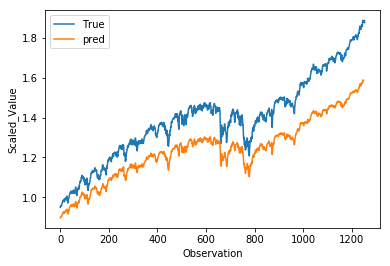

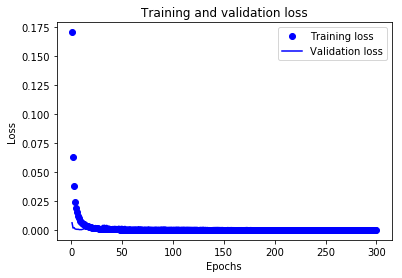

RUA_de5_tcn_clf9_n32_pe0.01_0:
(1254,)
The Adjusted R2 score on the Test set is:	0.348
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	0.424
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_2[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 303us/sample - loss: 5.6334e-04 - val_loss: 0.0030
Epoch 84/300
5667/5667==============================] - 2s 314us/sample - loss: 5.5682e-04 - val_loss: 0.0033
Epoch 85/300
5667/5667==============================] - 2s 303us/sample - loss: 5.9404e-04 - val_loss: 0.0032
Epoch 86/300
5667/5667==============================] - 2s 309us/sample - loss: 5.5121e-04 - val_loss: 0.0032
Epoch 87/300
5667/5667==============================] - 2s 305us/sample - loss: 5.5874e-04 - val_loss: 0.0037
Epoch 88/300
5667/5667==============================] - 2s 306us/sample - loss: 5.9223e-04 - val_loss: 0.0039
Epoch 89/300
5667/5667==============================] - 2s 300us/sample - loss: 5.7092e-04 - val_loss: 0.0025
Epoch 90/300
5667/5667==============================] - 2s 303us/sample - loss: 5.5629e-04 - val_loss: 0.0026
Epoch 91/300
5667/5667==============================] - 2s 305us/sample - loss: 5.5675e-04 - val_loss: 0.0030
Epoch 92/300
5667/5667=

5667/5667==============================] - 2s 299us/sample - loss: 5.0971e-04 - val_loss: 0.0027
Epoch 158/300
5667/5667==============================] - 2s 297us/sample - loss: 5.1328e-04 - val_loss: 0.0025
Epoch 159/300
5667/5667==============================] - 2s 297us/sample - loss: 4.9367e-04 - val_loss: 0.0026
Epoch 160/300
5667/5667==============================] - 2s 303us/sample - loss: 4.9926e-04 - val_loss: 0.0028
Epoch 161/300
5667/5667==============================] - 2s 301us/sample - loss: 5.1309e-04 - val_loss: 0.0028
Epoch 162/300
5667/5667==============================] - 2s 301us/sample - loss: 5.0626e-04 - val_loss: 0.0024
Epoch 163/300
5667/5667==============================] - 2s 298us/sample - loss: 4.9875e-04 - val_loss: 0.0023
Epoch 164/300
5667/5667==============================] - 2s 299us/sample - loss: 5.0125e-04 - val_loss: 0.0027
Epoch 165/300
5667/5667==============================] - 2s 298us/sample - loss: 5.0621e-04 - val_loss: 0.0028
Epoch 166/300
5

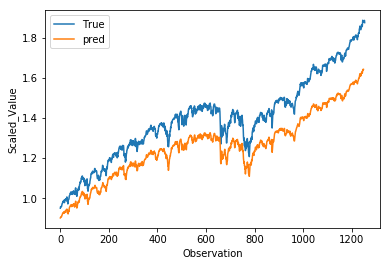

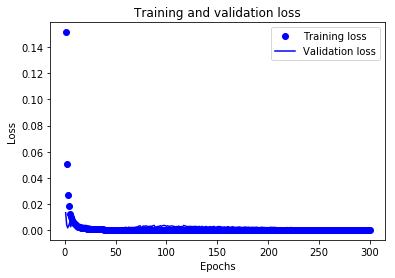

RUA_de5_tcn_clf9_n32_pe0.01_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.506
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	0.503
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_3[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 301us/sample - loss: 0.0137 - val_loss: 0.0028
Epoch 9/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0112 - val_loss: 0.0013
Epoch 10/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0093 - val_loss: 6.8305e-04
Epoch 11/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0082 - val_loss: 6.0428e-04
Epoch 12/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0067 - val_loss: 6.3500e-04
Epoch 13/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0061 - val_loss: 9.8649e-04
Epoch 14/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0055 - val_loss: 6.2219e-04
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0045 - val_loss: 5.5792e-04
Epoch 16/300
5667/5667==============================] - ETA: 0s - loss: 0.004 - 2s 301us/sample - loss: 0.0041 - val_loss: 5.7529e-04
Epoch 17

5667/5667==============================] - 2s 299us/sample - loss: 4.7750e-04 - val_loss: 0.0024
Epoch 156/300
5667/5667==============================] - 2s 301us/sample - loss: 4.8407e-04 - val_loss: 0.0024
Epoch 157/300
5667/5667==============================] - 2s 297us/sample - loss: 4.7882e-04 - val_loss: 0.0024
Epoch 158/300
5667/5667==============================] - 2s 298us/sample - loss: 4.8039e-04 - val_loss: 0.0026-
Epoch 159/300
5667/5667==============================] - 2s 299us/sample - loss: 4.8564e-04 - val_loss: 0.0026
Epoch 160/300
5667/5667==============================] - 2s 300us/sample - loss: 4.7807e-04 - val_loss: 0.0025
Epoch 161/300
5667/5667==============================] - 2s 299us/sample - loss: 4.7469e-04 - val_loss: 0.0024
Epoch 162/300
5667/5667==============================] - 2s 300us/sample - loss: 4.8204e-04 - val_loss: 0.0025
Epoch 163/300
5667/5667==============================] - 2s 300us/sample - loss: 4.8633e-04 - val_loss: 0.0026
Epoch 164/300


5667/5667==============================] - 2s 301us/sample - loss: 4.5874e-04 - val_loss: 0.0021
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.087659
The Adjusted R2 score on the Test set is:	0.084


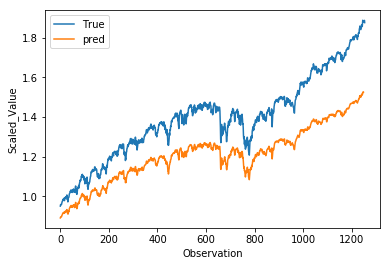

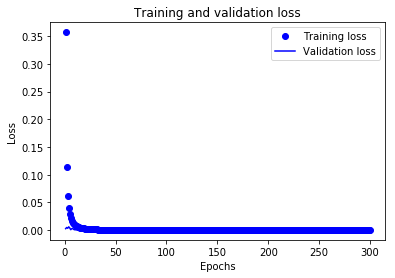

RUA_de5_tcn_clf9_n32_pe0.01_2:
(1254,)
The Adjusted R2 score on the Test set is:	0.084
The Custom  sign score on the Test set is:	0.493
The Custom  R2 score on the Test set is:	0.289
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_4[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 84/300
5667/5667==============================] - 2s 307us/sample - loss: 6.8532e-04 - val_loss: 0.00431s - loss: 1 - ETA: 0s - loss: 
Epoch 85/300
5667/5667==============================] - 2s 307us/sample - loss: 6.8175e-04 - val_loss: 0.0031
Epoch 86/300
5667/5667==============================] - 2s 306us/sample - loss: 7.2709e-04 - val_loss: 0.0041
Epoch 87/300
5667/5667==============================] - 2s 306us/sample - loss: 6.9103e-04 - val_loss: 0.0041
Epoch 88/300
5667/5667==============================] - 2s 307us/sample - loss: 6.9011e-04 - val_loss: 0.0041
Epoch 89/300
5667/5667==============================] - 2s 304us/sample - loss: 6.8443e-04 - val_loss: 0.0043
Epoch 90/300
5667/5667==============================] - 2s 305us/sample - loss: 6.8663e-04 - val_loss: 0.0039
Epoch 91/300
5667/5667==============================] - 2s 302us/sample - loss: 6.8980e-04 - val_loss: 0.0037
Epoch 92/300
5667/5667==============================] - 2s 304us/sample - loss: 6.8715e-0

Epoch 231/300
5667/5667==============================] - 2s 303us/sample - loss: 5.1290e-04 - val_loss: 0.0026
Epoch 232/300
5667/5667==============================] - 2s 305us/sample - loss: 5.0180e-04 - val_loss: 0.0024
Epoch 233/300
5667/5667==============================] - ETA: 0s - loss: 4.9524e-0 - 2s 307us/sample - loss: 5.0305e-04 - val_loss: 0.0026
Epoch 234/300
5667/5667==============================] - 2s 301us/sample - loss: 5.1114e-04 - val_loss: 0.0027
Epoch 235/300
5667/5667==============================] - 2s 305us/sample - loss: 5.1735e-04 - val_loss: 0.0026
Epoch 236/300
5667/5667==============================] - 2s 306us/sample - loss: 5.1546e-04 - val_loss: 0.0027
Epoch 237/300
5667/5667==============================] - 2s 305us/sample - loss: 5.1541e-04 - val_loss: 0.0027
Epoch 238/300
5667/5667==============================] - 2s 302us/sample - loss: 5.1631e-04 - val_loss: 0.0028
Epoch 239/300
5667/5667==============================] - 2s 303us/sample - loss: 5.2

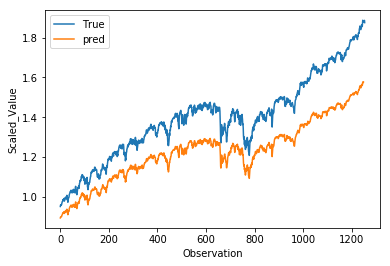

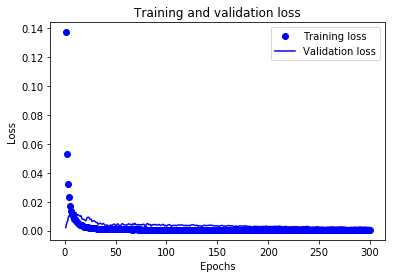

RUA_de5_tcn_clf9_n32_pe0.01_3:
(1254,)
The Adjusted R2 score on the Test set is:	0.268
The Custom  sign score on the Test set is:	0.511
The Custom  R2 score on the Test set is:	0.390
Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_5[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 8/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0118 - val_loss: 0.0039
Epoch 9/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0097 - val_loss: 0.0044
Epoch 10/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0084 - val_loss: 0.0014
Epoch 11/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0071 - val_loss: 0.0036
Epoch 12/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0062 - val_loss: 0.0040
Epoch 13/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0053 - val_loss: 0.0040
Epoch 14/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0046 - val_loss: 0.0064
Epoch 15/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0043 - val_loss: 0.0058
Epoch 16/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0041 - val_loss: 0.0054
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 2s 296us/sample - loss: 5.4907e-04 - val_loss: 0.0024
Epoch 158/300
5667/5667==============================] - ETA: 0s - loss: 5.0599e-04 - 2s 294us/sample - loss: 5.1474e-04 - val_loss: 0.0029
Epoch 159/300
5667/5667==============================] - 2s 295us/sample - loss: 5.4293e-04 - val_loss: 0.0028
Epoch 160/300
5667/5667==============================] - 2s 295us/sample - loss: 5.2447e-04 - val_loss: 0.0027
Epoch 161/300
5667/5667==============================] - 2s 296us/sample - loss: 5.4149e-04 - val_loss: 0.0028
Epoch 162/300
5667/5667==============================] - 2s 298us/sample - loss: 5.2263e-04 - val_loss: 0.0027
Epoch 163/300
5667/5667==============================] - 2s 300us/sample - loss: 5.1645e-04 - val_loss: 0.0031
Epoch 164/300
5667/5667==============================] - 2s 296us/sample - loss: 5.1967e-04 - val_loss: 0.0033
Epoch 165/300
5667/5667==============================] - 2s 296us/sample - loss: 5.0985e-04 - val

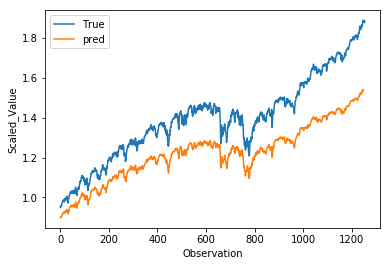

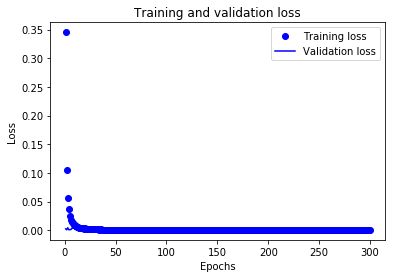

RUA_de5_tcn_clf9_n32_pe0.01_4:
(1254,)
The Adjusted R2 score on the Test set is:	0.191
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.346
Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_6[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 291us/sample - loss: 6.3534e-04 - val_loss: 0.0042
Epoch 84/300
5667/5667==============================] - 2s 290us/sample - loss: 6.4195e-04 - val_loss: 0.0034
Epoch 85/300
5667/5667==============================] - 2s 291us/sample - loss: 6.4953e-04 - val_loss: 0.0035
Epoch 86/300
5667/5667==============================] - 2s 289us/sample - loss: 6.2880e-04 - val_loss: 0.0036
Epoch 87/300
5667/5667==============================] - 2s 290us/sample - loss: 6.0910e-04 - val_loss: 0.0031
Epoch 88/300
5667/5667==============================] - 2s 291us/sample - loss: 6.0041e-04 - val_loss: 0.0029
Epoch 89/300
5667/5667==============================] - 2s 290us/sample - loss: 5.7403e-04 - val_loss: 0.0033
Epoch 90/300
5667/5667==============================] - 2s 291us/sample - loss: 5.8409e-04 - val_loss: 0.0030
Epoch 91/300
5667/5667==============================] - 2s 292us/sample - loss: 5.8150e-04 - val_loss: 0.0032
Epoch 92/300
5667/5667=

5667/5667==============================] - 2s 292us/sample - loss: 4.6748e-04 - val_loss: 0.0019
Epoch 230/300
5667/5667==============================] - 2s 295us/sample - loss: 4.7061e-04 - val_loss: 0.0019
Epoch 231/300
5667/5667==============================] - 2s 289us/sample - loss: 4.6393e-04 - val_loss: 0.0019
Epoch 232/300
5667/5667==============================] - 2s 294us/sample - loss: 4.6541e-04 - val_loss: 0.0018
Epoch 233/300
5667/5667==============================] - 2s 290us/sample - loss: 4.5724e-04 - val_loss: 0.0018
Epoch 234/300
5667/5667==============================] - 2s 287us/sample - loss: 4.5205e-04 - val_loss: 0.0017
Epoch 235/300
5667/5667==============================] - 2s 295us/sample - loss: 4.6225e-04 - val_loss: 0.0017
Epoch 236/300
5667/5667==============================] - 2s 301us/sample - loss: 4.6079e-04 - val_loss: 0.0017
Epoch 237/300
5667/5667==============================] - 2s 304us/sample - loss: 4.6153e-04 - val_loss: 0.0018
Epoch 238/300
5

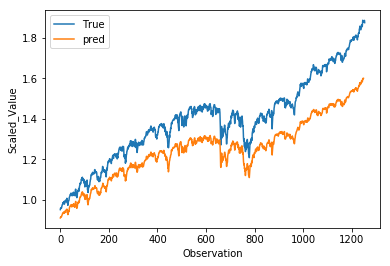

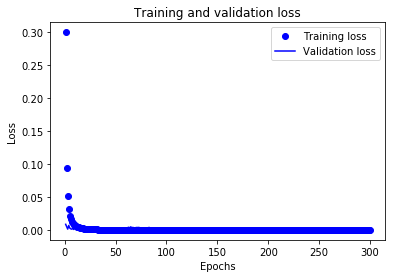

RUA_de5_tcn_clf9_n32_pe0.01_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.427
The Custom  sign score on the Test set is:	0.504
The Custom  R2 score on the Test set is:	0.465
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_7[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 299us/sample - loss: 5.6376e-04 - val_loss: 0.0028
Epoch 84/300
5667/5667==============================] - 2s 304us/sample - loss: 5.4816e-04 - val_loss: 0.0022
Epoch 85/300
5667/5667==============================] - 2s 304us/sample - loss: 5.5917e-04 - val_loss: 0.0024
Epoch 86/300
5667/5667==============================] - 2s 304us/sample - loss: 5.4046e-04 - val_loss: 0.0025
Epoch 87/300
5667/5667==============================] - 2s 308us/sample - loss: 5.4750e-04 - val_loss: 0.0022
Epoch 88/300
5667/5667==============================] - 2s 310us/sample - loss: 5.4612e-04 - val_loss: 0.0025
Epoch 89/300
5667/5667==============================] - 2s 302us/sample - loss: 5.3609e-04 - val_loss: 0.0025
Epoch 90/300
5667/5667==============================] - 2s 303us/sample - loss: 5.4431e-04 - val_loss: 0.0027 -
Epoch 91/300
5667/5667==============================] - 2s 305us/sample - loss: 5.3026e-04 - val_loss: 0.0025
Epoch 92/300
5667/566

Epoch 157/300
5667/5667==============================] - 2s 296us/sample - loss: 4.7052e-04 - val_loss: 0.0020
Epoch 158/300
5667/5667==============================] - 2s 295us/sample - loss: 4.6641e-04 - val_loss: 0.0020
Epoch 159/300
5667/5667==============================] - 2s 300us/sample - loss: 4.6734e-04 - val_loss: 0.0020
Epoch 160/300
5667/5667==============================] - 2s 296us/sample - loss: 4.7043e-04 - val_loss: 0.0019
Epoch 161/300
5667/5667==============================] - 2s 298us/sample - loss: 4.6465e-04 - val_loss: 0.0019
Epoch 162/300
5667/5667==============================] - 2s 300us/sample - loss: 4.6523e-04 - val_loss: 0.0020
Epoch 163/300
5667/5667==============================] - 2s 300us/sample - loss: 4.7305e-04 - val_loss: 0.0020
Epoch 164/300
5667/5667==============================] - 2s 298us/sample - loss: 4.6318e-04 - val_loss: 0.0020
Epoch 165/300
5667/5667==============================] - 2s 297us/sample - loss: 4.6931e-04 - val_loss: 0.0020
E

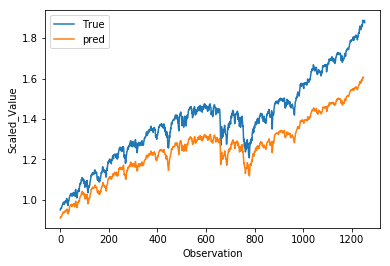

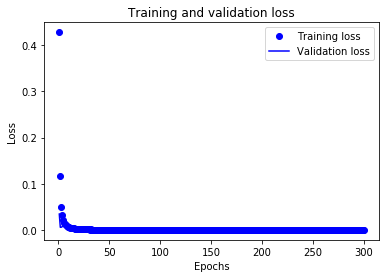

RUA_de5_tcn_clf9_n32_pe0.01_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.470
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	0.485
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_8[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 303us/sample - loss: 0.0150 - val_loss: 0.0070
Epoch 9/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0125 - val_loss: 0.0088
Epoch 10/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0103 - val_loss: 0.0065
Epoch 11/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0092 - val_loss: 0.0077
Epoch 12/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0084 - val_loss: 0.0048
Epoch 13/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0073 - val_loss: 0.0063
Epoch 14/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0066 - val_loss: 0.0086
Epoch 15/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0055 - val_loss: 0.0083
Epoch 16/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0048 - val_loss: 0.0060
Epoch 17/300
5667/5667==============================] - 2s 3

Epoch 84/300
5667/5667==============================] - 2s 297us/sample - loss: 7.6121e-04 - val_loss: 0.0043
Epoch 85/300
5667/5667==============================] - 2s 300us/sample - loss: 7.5505e-04 - val_loss: 0.0047
Epoch 86/300
5667/5667==============================] - 2s 302us/sample - loss: 7.9902e-04 - val_loss: 0.0047
Epoch 87/300
5667/5667==============================] - 2s 303us/sample - loss: 7.8008e-04 - val_loss: 0.0047
Epoch 88/300
5667/5667==============================] - 2s 300us/sample - loss: 7.2349e-04 - val_loss: 0.0037
Epoch 89/300
5667/5667==============================] - 2s 299us/sample - loss: 7.4321e-04 - val_loss: 0.0039
Epoch 90/300
5667/5667==============================] - 2s 301us/sample - loss: 7.2913e-04 - val_loss: 0.0042
Epoch 91/300
5667/5667==============================] - 2s 298us/sample - loss: 7.2292e-04 - val_loss: 0.0041
Epoch 92/300
5667/5667==============================] - 2s 297us/sample - loss: 6.9722e-04 - val_loss: 0.0045
Epoch 93/3

Epoch 157/300
5667/5667==============================] - 2s 297us/sample - loss: 5.8065e-04 - val_loss: 0.0038
Epoch 158/300
5667/5667==============================] - 2s 299us/sample - loss: 5.7145e-04 - val_loss: 0.0037
Epoch 159/300
5667/5667==============================] - 2s 302us/sample - loss: 5.6641e-04 - val_loss: 0.0036
Epoch 160/300
5667/5667==============================] - 2s 303us/sample - loss: 5.7007e-04 - val_loss: 0.0036
Epoch 161/300
5667/5667==============================] - 2s 301us/sample - loss: 5.4380e-04 - val_loss: 0.0034
Epoch 162/300
5667/5667==============================] - 2s 299us/sample - loss: 5.4999e-04 - val_loss: 0.0035
Epoch 163/300
5667/5667==============================] - 2s 301us/sample - loss: 5.6634e-04 - val_loss: 0.0036
Epoch 164/300
5667/5667==============================] - 2s 298us/sample - loss: 5.7382e-04 - val_loss: 0.0036
Epoch 165/300
5667/5667==============================] - 2s 299us/sample - loss: 5.7078e-04 - val_loss: 0.0036
E

Epoch 231/300
5667/5667==============================] - 2s 301us/sample - loss: 5.1073e-04 - val_loss: 0.0029
Epoch 232/300
5667/5667==============================] - 2s 294us/sample - loss: 5.1924e-04 - val_loss: 0.0030
Epoch 233/300
5667/5667==============================] - 2s 298us/sample - loss: 5.2851e-04 - val_loss: 0.0030
Epoch 234/300
5667/5667==============================] - 2s 300us/sample - loss: 5.2291e-04 - val_loss: 0.0030
Epoch 235/300
5667/5667==============================] - 2s 300us/sample - loss: 5.2813e-04 - val_loss: 0.0032
Epoch 236/300
5667/5667==============================] - ETA: 0s - loss: 5.3145e-0 - 2s 301us/sample - loss: 5.4113e-04 - val_loss: 0.0032
Epoch 237/300
5667/5667==============================] - 2s 298us/sample - loss: 5.3569e-04 - val_loss: 0.0032
Epoch 238/300
5667/5667==============================] - 2s 297us/sample - loss: 5.1242e-04 - val_loss: 0.0030
Epoch 239/300
5667/5667==============================] - 2s 299us/sample - loss: 5.2

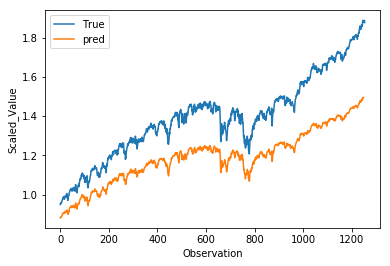

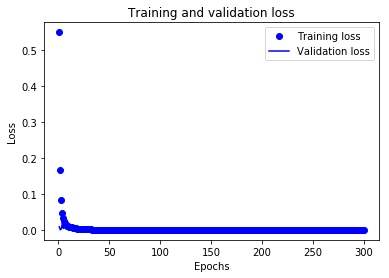

RUA_de5_tcn_clf9_n32_pe0.01_7:
(1254,)
The Adjusted R2 score on the Test set is:	-0.105
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.196
Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_9[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 306us/sample - loss: 0.0107 - val_loss: 0.0124
Epoch 9/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0087 - val_loss: 0.0085
Epoch 10/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0074 - val_loss: 0.0085
Epoch 11/300
5667/5667==============================] - 2s 320us/sample - loss: 0.0065 - val_loss: 0.0114
Epoch 12/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0055 - val_loss: 0.0096
Epoch 13/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0052 - val_loss: 0.0090
Epoch 14/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0044 - val_loss: 0.0080
Epoch 15/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0039 - val_loss: 0.0070
Epoch 16/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0035 - val_loss: 0.0091
Epoch 17/300
5667/5667==============================] - 2s 3

Epoch 84/300
5667/5667==============================] - 2s 309us/sample - loss: 5.7518e-04 - val_loss: 0.0027
Epoch 85/300
5667/5667==============================] - 2s 309us/sample - loss: 6.0281e-04 - val_loss: 0.0025
Epoch 86/300
5667/5667==============================] - 2s 312us/sample - loss: 5.8861e-04 - val_loss: 0.0030
Epoch 87/300
5667/5667==============================] - 2s 312us/sample - loss: 5.7552e-04 - val_loss: 0.0033
Epoch 88/300
5667/5667==============================] - 2s 312us/sample - loss: 5.6321e-04 - val_loss: 0.0031
Epoch 89/300
5667/5667==============================] - 2s 309us/sample - loss: 5.7926e-04 - val_loss: 0.0030
Epoch 90/300
5667/5667==============================] - 2s 311us/sample - loss: 5.8740e-04 - val_loss: 0.0024
Epoch 91/300
5667/5667==============================] - 2s 312us/sample - loss: 5.4300e-04 - val_loss: 0.0023
Epoch 92/300
5667/5667==============================] - 2s 311us/sample - loss: 5.6116e-04 - val_loss: 0.0026
Epoch 93/3

Epoch 158/300
5667/5667==============================] - 2s 310us/sample - loss: 4.9969e-04 - val_loss: 0.0025
Epoch 159/300
5667/5667==============================] - 2s 311us/sample - loss: 5.0853e-04 - val_loss: 0.0026
Epoch 160/300
5667/5667==============================] - 2s 308us/sample - loss: 5.0690e-04 - val_loss: 0.0027
Epoch 161/300
5667/5667==============================] - 2s 307us/sample - loss: 5.1050e-04 - val_loss: 0.0025
Epoch 162/300
5667/5667==============================] - 2s 311us/sample - loss: 5.0070e-04 - val_loss: 0.0026
Epoch 163/300
5667/5667==============================] - 2s 309us/sample - loss: 4.9747e-04 - val_loss: 0.0026
Epoch 164/300
5667/5667==============================] - 2s 313us/sample - loss: 4.9756e-04 - val_loss: 0.0027
Epoch 165/300
5667/5667==============================] - 2s 312us/sample - loss: 4.9727e-04 - val_loss: 0.0025
Epoch 166/300
5667/5667==============================] - 2s 313us/sample - loss: 5.0375e-04 - val_loss: 0.0026
E

Epoch 232/300
5667/5667==============================] - 2s 310us/sample - loss: 4.6651e-04 - val_loss: 0.0020
Epoch 233/300
5667/5667==============================] - 2s 311us/sample - loss: 4.5868e-04 - val_loss: 0.0021
Epoch 234/300
5667/5667==============================] - 2s 305us/sample - loss: 4.5430e-04 - val_loss: 0.0020
Epoch 235/300
5667/5667==============================] - 2s 306us/sample - loss: 4.5971e-04 - val_loss: 0.0019
Epoch 236/300
5667/5667==============================] - 2s 313us/sample - loss: 4.5693e-04 - val_loss: 0.0019
Epoch 237/300
5667/5667==============================] - 2s 310us/sample - loss: 4.5363e-04 - val_loss: 0.0019
Epoch 238/300
5667/5667==============================] - 2s 311us/sample - loss: 4.6140e-04 - val_loss: 0.0019
Epoch 239/300
5667/5667==============================] - 2s 320us/sample - loss: 4.6739e-04 - val_loss: 0.0020
Epoch 240/300
5667/5667==============================] - 2s 317us/sample - loss: 4.5553e-04 - val_loss: 0.0020
E

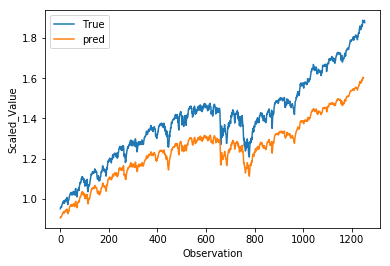

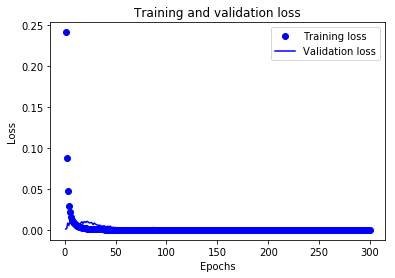

RUA_de5_tcn_clf9_n32_pe0.01_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.433
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.466
Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_10[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 8/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0114 - val_loss: 0.0027
Epoch 9/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0093 - val_loss: 0.0021
Epoch 10/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0080 - val_loss: 0.0028
Epoch 11/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0066 - val_loss: 0.0041
Epoch 12/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0056 - val_loss: 0.0028
Epoch 13/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0053 - val_loss: 0.0047
Epoch 14/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0048 - val_loss: 0.0053
Epoch 15/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0039 - val_loss: 0.0041
Epoch 16/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0036 - val_loss: 0.0038
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 2s 313us/sample - loss: 5.2332e-04 - val_loss: 0.0032
Epoch 158/300
5667/5667==============================] - 2s 313us/sample - loss: 5.4405e-04 - val_loss: 0.0029
Epoch 159/300
5667/5667==============================] - 2s 313us/sample - loss: 5.2541e-04 - val_loss: 0.0028
Epoch 160/300
5667/5667==============================] - 2s 312us/sample - loss: 5.2958e-04 - val_loss: 0.0029
Epoch 161/300
5667/5667==============================] - 2s 311us/sample - loss: 5.2567e-04 - val_loss: 0.0028
Epoch 162/300
5667/5667==============================] - 2s 312us/sample - loss: 5.1985e-04 - val_loss: 0.0031
Epoch 163/300
5667/5667==============================] - 2s 312us/sample - loss: 5.2217e-04 - val_loss: 0.0030
Epoch 164/300
5667/5667==============================] - 2s 312us/sample - loss: 5.1350e-04 - val_loss: 0.0031
Epoch 165/300
5667/5667==============================] - 2s 309us/sample - loss: 5.3119e-04 - val_loss: 0.0031
Epoch 166/300
5

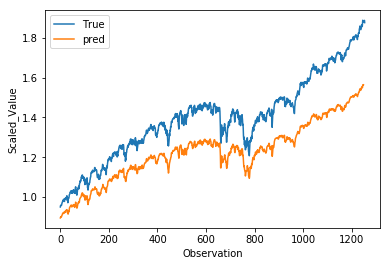

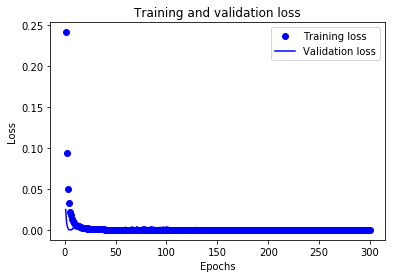

RUA_de5_tcn_clf9_n32_pe0.01_9:
(1254,)
The Adjusted R2 score on the Test set is:	0.243
The Custom  sign score on the Test set is:	0.502
The Custom  R2 score on the Test set is:	0.372
Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_11[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 312us/sample - loss: 0.0085 - val_loss: 8.2349e-04
Epoch 9/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0072 - val_loss: 0.0022
Epoch 10/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0060 - val_loss: 0.0026
Epoch 11/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0050 - val_loss: 0.0021
Epoch 12/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0046 - val_loss: 0.0027
Epoch 13/300
5667/5667==============================] - 2s 320us/sample - loss: 0.0040 - val_loss: 0.0030
Epoch 14/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0034 - val_loss: 0.0033
Epoch 15/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0033 - val_loss: 0.0020
Epoch 16/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0030 - val_loss: 0.0016
Epoch 17/300
5667/5667==============================] - 

5667/5667==============================] - 2s 320us/sample - loss: 5.8193e-04 - val_loss: 0.0032
Epoch 84/300
5667/5667==============================] - 2s 318us/sample - loss: 5.8124e-04 - val_loss: 0.0037
Epoch 85/300
5667/5667==============================] - 2s 320us/sample - loss: 6.1594e-04 - val_loss: 0.00370s - lo
Epoch 86/300
5667/5667==============================] - 2s 320us/sample - loss: 5.5978e-04 - val_loss: 0.0035
Epoch 87/300
5667/5667==============================] - 2s 320us/sample - loss: 6.1177e-04 - val_loss: 0.0035
Epoch 88/300
5667/5667==============================] - 2s 317us/sample - loss: 5.5620e-04 - val_loss: 0.0034
Epoch 89/300
5667/5667==============================] - 2s 315us/sample - loss: 5.9345e-04 - val_loss: 0.0031
Epoch 90/300
5667/5667==============================] - 2s 318us/sample - loss: 5.8432e-04 - val_loss: 0.0035
Epoch 91/300
5667/5667==============================] - 2s 320us/sample - loss: 5.6740e-04 - val_loss: 0.0035 - ETA: 1s - ETA:

Epoch 229/300
5667/5667==============================] - 2s 315us/sample - loss: 4.5950e-04 - val_loss: 0.0020
Epoch 230/300
5667/5667==============================] - 2s 319us/sample - loss: 4.5770e-04 - val_loss: 0.0018
Epoch 231/300
5667/5667==============================] - 2s 314us/sample - loss: 4.4756e-04 - val_loss: 0.0019
Epoch 232/300
5667/5667==============================] - 2s 319us/sample - loss: 4.5770e-04 - val_loss: 0.0019 1s
Epoch 233/300
5667/5667==============================] - 2s 321us/sample - loss: 4.5560e-04 - val_loss: 0.0019
Epoch 234/300
5667/5667==============================] - 2s 316us/sample - loss: 4.5981e-04 - val_loss: 0.0019
Epoch 235/300
5667/5667==============================] - 2s 320us/sample - loss: 4.6273e-04 - val_loss: 0.0019
Epoch 236/300
5667/5667==============================] - ETA: 0s - loss: 4.5387e-04 - 2s 321us/sample - loss: 4.5731e-04 - val_loss: 0.0019
Epoch 237/300
5667/5667==============================] - 2s 319us/sample - loss:

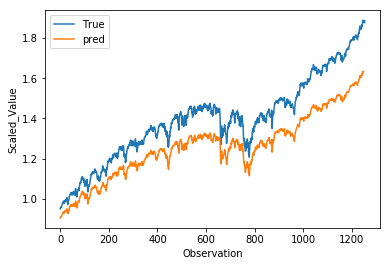

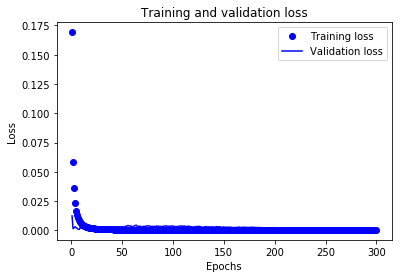

RUA_de5_tcn_clf9_n32_pe0.1_0:
(1254,)
The Adjusted R2 score on the Test set is:	0.510
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.504
Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_12[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 320us/sample - loss: 0.0109 - val_loss: 0.0027
Epoch 9/300
5667/5667==============================] - 2s 320us/sample - loss: 0.0090 - val_loss: 0.0025s: 0.008
Epoch 10/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0074 - val_loss: 0.0021
Epoch 11/300
5667/5667==============================] - 2s 317us/sample - loss: 0.0063 - val_loss: 0.0025
Epoch 12/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0054 - val_loss: 0.0023
Epoch 13/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0050 - val_loss: 0.0021
Epoch 14/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0044 - val_loss: 0.0030
Epoch 15/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0040 - val_loss: 0.0020
Epoch 16/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0035 - val_loss: 0.0024
Epoch 17/300
5667/5667==============================

5667/5667==============================] - 2s 313us/sample - loss: 5.0710e-04 - val_loss: 0.0020
Epoch 84/300
5667/5667==============================] - 2s 315us/sample - loss: 5.0730e-04 - val_loss: 0.0018
Epoch 85/300
5667/5667==============================] - 2s 314us/sample - loss: 5.1209e-04 - val_loss: 0.0017
Epoch 86/300
5667/5667==============================] - 2s 313us/sample - loss: 5.0294e-04 - val_loss: 0.0016
Epoch 87/300
5667/5667==============================] - 2s 313us/sample - loss: 5.0798e-04 - val_loss: 0.0018
Epoch 88/300
5667/5667==============================] - 2s 315us/sample - loss: 5.1260e-04 - val_loss: 0.0020
Epoch 89/300
5667/5667==============================] - 2s 316us/sample - loss: 5.0284e-04 - val_loss: 0.0017
Epoch 90/300
5667/5667==============================] - 2s 312us/sample - loss: 5.1481e-04 - val_loss: 0.0025
Epoch 91/300
5667/5667==============================] - 2s 316us/sample - loss: 5.3607e-04 - val_loss: 0.0022
Epoch 92/300
5667/5667=

5667/5667==============================] - 2s 313us/sample - loss: 4.9130e-04 - val_loss: 0.0022
Epoch 158/300
5667/5667==============================] - 2s 314us/sample - loss: 4.8820e-04 - val_loss: 0.0022
Epoch 159/300
5667/5667==============================] - 2s 309us/sample - loss: 4.9238e-04 - val_loss: 0.0020
Epoch 160/300
5667/5667==============================] - 2s 309us/sample - loss: 4.7540e-04 - val_loss: 0.0022
Epoch 161/300
5667/5667==============================] - 2s 310us/sample - loss: 4.9320e-04 - val_loss: 0.0021
Epoch 162/300
5667/5667==============================] - 2s 308us/sample - loss: 4.8238e-04 - val_loss: 0.0023
Epoch 163/300
5667/5667==============================] - 2s 313us/sample - loss: 4.8651e-04 - val_loss: 0.0022
Epoch 164/300
5667/5667==============================] - 2s 312us/sample - loss: 4.7826e-04 - val_loss: 0.0021
Epoch 165/300
5667/5667==============================] - 2s 310us/sample - loss: 4.8117e-04 - val_loss: 0.0022
Epoch 166/300
5

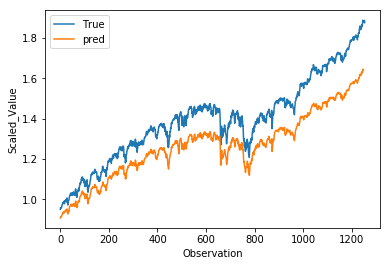

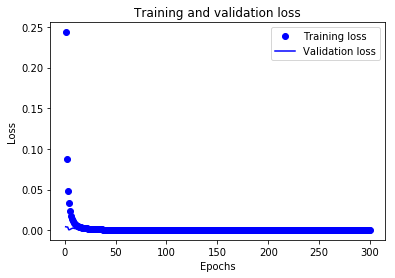

RUA_de5_tcn_clf9_n32_pe0.1_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.548
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.525
Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_13[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 8/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0097 - val_loss: 0.0047
Epoch 9/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0080 - val_loss: 0.0054
Epoch 10/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0067 - val_loss: 0.0070
Epoch 11/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0058 - val_loss: 0.0064
Epoch 12/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0049 - val_loss: 0.0054
Epoch 13/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0045 - val_loss: 0.0069
Epoch 14/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0041 - val_loss: 0.0049
Epoch 15/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0037 - val_loss: 0.0060
Epoch 16/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0035 - val_loss: 0.0073
Epoch 17/300
5667/5667==========================

Epoch 157/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0744e-04 - val_loss: 0.0022
Epoch 158/300
5667/5667==============================] - 2s 306us/sample - loss: 5.0645e-04 - val_loss: 0.0024
Epoch 159/300
5667/5667==============================] - 2s 308us/sample - loss: 5.1698e-04 - val_loss: 0.0024
Epoch 160/300
5667/5667==============================] - 2s 311us/sample - loss: 5.0482e-04 - val_loss: 0.0024
Epoch 161/300
5667/5667==============================] - 2s 311us/sample - loss: 4.9036e-04 - val_loss: 0.0022
Epoch 162/300
5667/5667==============================] - 2s 305us/sample - loss: 4.8389e-04 - val_loss: 0.0023
Epoch 163/300
5667/5667==============================] - 2s 304us/sample - loss: 4.9409e-04 - val_loss: 0.0024
Epoch 164/300
5667/5667==============================] - 2s 306us/sample - loss: 4.9769e-04 - val_loss: 0.0024
Epoch 165/300
5667/5667==============================] - 2s 308us/sample - loss: 4.9928e-04 - val_loss: 0.0026
E

Epoch 231/300
5667/5667==============================] - 2s 310us/sample - loss: 4.5081e-04 - val_loss: 0.0016
Epoch 232/300
5667/5667==============================] - 2s 311us/sample - loss: 4.5328e-04 - val_loss: 0.0016
Epoch 233/300
5667/5667==============================] - 2s 306us/sample - loss: 4.5036e-04 - val_loss: 0.0016
Epoch 234/300
5667/5667==============================] - 2s 303us/sample - loss: 4.4867e-04 - val_loss: 0.0017
Epoch 235/300
5667/5667==============================] - 2s 306us/sample - loss: 4.5572e-04 - val_loss: 0.0016
Epoch 236/300
5667/5667==============================] - 2s 309us/sample - loss: 4.5492e-04 - val_loss: 0.0016
Epoch 237/300
5667/5667==============================] - 2s 307us/sample - loss: 4.4944e-04 - val_loss: 0.0016
Epoch 238/300
5667/5667==============================] - 2s 307us/sample - loss: 4.5023e-04 - val_loss: 0.0016
Epoch 239/300
5667/5667==============================] - 2s 319us/sample - loss: 4.4766e-04 - val_loss: 0.0016
E

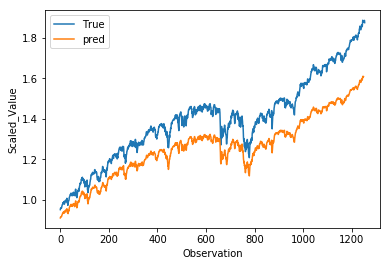

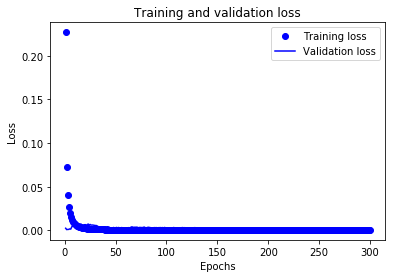

RUA_de5_tcn_clf9_n32_pe0.1_2:
(1254,)
The Adjusted R2 score on the Test set is:	0.478
The Custom  sign score on the Test set is:	0.506
The Custom  R2 score on the Test set is:	0.492
Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_14[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 8/300
5667/5667==============================] - 2s 317us/sample - loss: 0.0159 - val_loss: 0.0014
Epoch 9/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0137 - val_loss: 9.7728e-04
Epoch 10/300
5667/5667==============================] - 2s 317us/sample - loss: 0.0118 - val_loss: 8.2451e-04
Epoch 11/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0099 - val_loss: 0.0013
Epoch 12/300
5667/5667==============================] - 2s 322us/sample - loss: 0.0087 - val_loss: 0.0012 1s - loss: 0.002 - E - ETA: 0s - loss: 0.
Epoch 13/300
5667/5667==============================] - 2s 320us/sample - loss: 0.0081 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0068 - val_loss: 0.0022
Epoch 15/300
5667/5667==============================] - 2s 323us/sample - loss: 0.0060 - val_loss: 0.0019
Epoch 16/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0051 - val_loss: 0.001

5667/5667==============================] - 2s 320us/sample - loss: 5.2980e-04 - val_loss: 0.0025
Epoch 157/300
5667/5667==============================] - 2s 319us/sample - loss: 5.1883e-04 - val_loss: 0.0027
Epoch 158/300
5667/5667==============================] - 2s 321us/sample - loss: 5.1817e-04 - val_loss: 0.0025
Epoch 159/300
5667/5667==============================] - 2s 319us/sample - loss: 5.2179e-04 - val_loss: 0.0024
Epoch 160/300
5667/5667==============================] - 2s 321us/sample - loss: 5.2252e-04 - val_loss: 0.0026
Epoch 161/300
5667/5667==============================] - 2s 322us/sample - loss: 5.2577e-04 - val_loss: 0.0026
Epoch 162/300
5667/5667==============================] - 2s 322us/sample - loss: 5.1479e-04 - val_loss: 0.0024
Epoch 163/300
5667/5667==============================] - 2s 317us/sample - loss: 5.1516e-04 - val_loss: 0.0024s - loss: 5.8285 - ETA: 0s - los
Epoch 164/300
5667/5667==============================] - 2s 318us/sample - loss: 5.1186e-04 - 

Epoch 229/300
5667/5667==============================] - 2s 320us/sample - loss: 4.8797e-04 - val_loss: 0.0021
Epoch 230/300
5667/5667==============================] - 2s 318us/sample - loss: 4.8913e-04 - val_loss: 0.0020
Epoch 231/300
5667/5667==============================] - 2s 319us/sample - loss: 4.8033e-04 - val_loss: 0.0020
Epoch 232/300
5667/5667==============================] - 2s 322us/sample - loss: 4.7960e-04 - val_loss: 0.0020
Epoch 233/300
5667/5667==============================] - 2s 322us/sample - loss: 4.7863e-04 - val_loss: 0.0020
Epoch 234/300
5667/5667==============================] - 2s 315us/sample - loss: 4.8029e-04 - val_loss: 0.0020
Epoch 235/300
5667/5667==============================] - 2s 320us/sample - loss: 4.7504e-04 - val_loss: 0.0020-0
Epoch 236/300
5667/5667==============================] - 2s 318us/sample - loss: 4.8200e-04 - val_loss: 0.0019
Epoch 237/300
5667/5667==============================] - 2s 319us/sample - loss: 4.7810e-04 - val_loss: 0.0020

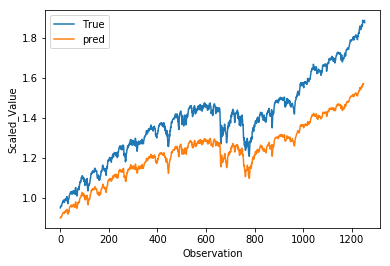

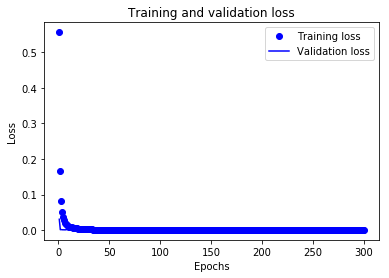

RUA_de5_tcn_clf9_n32_pe0.1_3:
(1254,)
The Adjusted R2 score on the Test set is:	0.290
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	0.395
Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_15[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 326us/sample - loss: 8.6811e-04 - val_loss: 0.0034
Epoch 85/300
5667/5667==============================] - 2s 326us/sample - loss: 8.0868e-04 - val_loss: 0.0034
Epoch 86/300
5667/5667==============================] - 2s 325us/sample - loss: 8.4518e-04 - val_loss: 0.0033
Epoch 87/300
5667/5667==============================] - 2s 326us/sample - loss: 8.2491e-04 - val_loss: 0.0031
Epoch 88/300
5667/5667==============================] - 2s 328us/sample - loss: 7.4083e-04 - val_loss: 0.0035
Epoch 89/300
5667/5667==============================] - 2s 326us/sample - loss: 7.5017e-04 - val_loss: 0.0039 - ETA: 1s - loss: 3.4333e- 
Epoch 90/300
5667/5667==============================] - 2s 329us/sample - loss: 7.2575e-04 - val_loss: 0.0033
Epoch 91/300
5667/5667==============================] - 2s 331us/sample - loss: 7.5278e-04 - val_loss: 0.0027
Epoch 92/300
5667/5667==============================] - 2s 330us/sample - loss: 7.5828e-04 - val_loss: 0.

Epoch 231/300
5667/5667==============================] - 2s 328us/sample - loss: 5.5246e-04 - val_loss: 0.0034
Epoch 232/300
5667/5667==============================] - 2s 327us/sample - loss: 5.3312e-04 - val_loss: 0.0030
Epoch 233/300
5667/5667==============================] - 2s 328us/sample - loss: 5.2462e-04 - val_loss: 0.0031
Epoch 234/300
5667/5667==============================] - 2s 332us/sample - loss: 5.2751e-04 - val_loss: 0.0035
Epoch 235/300
5667/5667==============================] - 2s 326us/sample - loss: 5.4642e-04 - val_loss: 0.0033
Epoch 236/300
5667/5667==============================] - 2s 329us/sample - loss: 5.3948e-04 - val_loss: 0.0034
Epoch 237/300
5667/5667==============================] - 2s 328us/sample - loss: 5.5162e-04 - val_loss: 0.0036
Epoch 238/300
5667/5667==============================] - 2s 330us/sample - loss: 5.5874e-04 - val_loss: 0.0034
Epoch 239/300
5667/5667==============================] - 2s 329us/sample - loss: 5.4480e-04 - val_loss: 0.0032
E

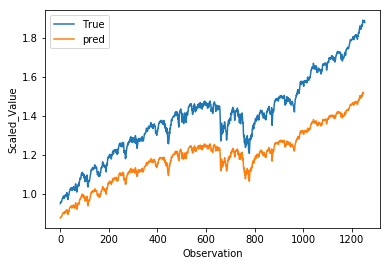

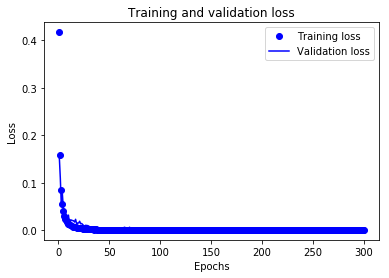

RUA_de5_tcn_clf9_n32_pe0.1_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.049
The Custom  sign score on the Test set is:	0.507
The Custom  R2 score on the Test set is:	0.229
Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_16 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_16[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 329us/sample - loss: 0.0071 - val_loss: 0.0016
Epoch 9/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0061 - val_loss: 0.0016
Epoch 10/300
5667/5667==============================] - 2s 330us/sample - loss: 0.0050 - val_loss: 0.0016
Epoch 11/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0042 - val_loss: 0.0015
Epoch 12/300
5667/5667==============================] - 2s 330us/sample - loss: 0.0040 - val_loss: 0.0012
Epoch 13/300
5667/5667==============================] - 2s 326us/sample - loss: 0.0033 - val_loss: 0.0018
Epoch 14/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0031 - val_loss: 0.0014
Epoch 15/300
5667/5667==============================] - 2s 329us/sample - loss: 0.0028 - val_loss: 0.0022
Epoch 16/300
5667/5667==============================] - 2s 330us/sample - loss: 0.0026 - val_loss: 0.0025
Epoch 17/300
5667/5667==========================

Epoch 157/300
5667/5667==============================] - 2s 334us/sample - loss: 4.6943e-04 - val_loss: 0.0022
Epoch 158/300
5667/5667==============================] - 2s 334us/sample - loss: 4.7925e-04 - val_loss: 0.0022
Epoch 159/300
5667/5667==============================] - 2s 334us/sample - loss: 4.6144e-04 - val_loss: 0.0021
Epoch 160/300
5667/5667==============================] - 2s 335us/sample - loss: 4.5243e-04 - val_loss: 0.0022
Epoch 161/300
5667/5667==============================] - 2s 335us/sample - loss: 4.5554e-04 - val_loss: 0.0021
Epoch 162/300
5667/5667==============================] - 2s 332us/sample - loss: 4.6118e-04 - val_loss: 0.0022
Epoch 163/300
5667/5667==============================] - 2s 332us/sample - loss: 4.6118e-04 - val_loss: 0.0021
Epoch 164/300
5667/5667==============================] - 2s 331us/sample - loss: 4.6732e-04 - val_loss: 0.0021
Epoch 165/300
5667/5667==============================] - 2s 329us/sample - loss: 4.6093e-04 - val_loss: 0.0020
E

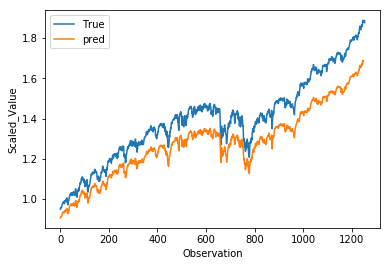

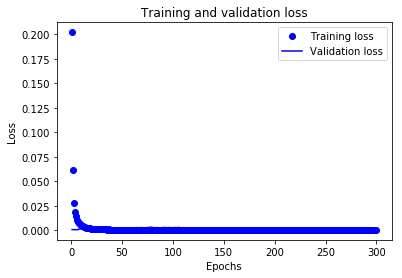

RUA_de5_tcn_clf9_n32_pe0.1_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.652
The Custom  sign score on the Test set is:	0.502
The Custom  R2 score on the Test set is:	0.577
Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_17 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_17[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 328us/sample - loss: 6.9189e-04 - val_loss: 0.0031
Epoch 84/300
5667/5667==============================] - 2s 328us/sample - loss: 7.1701e-04 - val_loss: 0.0031
Epoch 85/300
5667/5667==============================] - 2s 325us/sample - loss: 7.2552e-04 - val_loss: 0.0029
Epoch 86/300
5667/5667==============================] - 2s 329us/sample - loss: 7.1805e-04 - val_loss: 0.0030
Epoch 87/300
5667/5667==============================] - 2s 324us/sample - loss: 6.8757e-04 - val_loss: 0.0029
Epoch 88/300
5667/5667==============================] - 2s 329us/sample - loss: 6.9788e-04 - val_loss: 0.0034
Epoch 89/300
5667/5667==============================] - 2s 324us/sample - loss: 6.9836e-04 - val_loss: 0.0029
Epoch 90/300
5667/5667==============================] - 2s 332us/sample - loss: 6.8250e-04 - val_loss: 0.0034
Epoch 91/300
5667/5667==============================] - 2s 329us/sample - loss: 6.6985e-04 - val_loss: 0.0034
Epoch 92/300
5667/5667=

Epoch 230/300
5667/5667==============================] - 2s 327us/sample - loss: 4.9888e-04 - val_loss: 0.0027
Epoch 231/300
5667/5667==============================] - 2s 327us/sample - loss: 4.9358e-04 - val_loss: 0.0030
Epoch 232/300
5667/5667==============================] - 2s 325us/sample - loss: 5.0553e-04 - val_loss: 0.0027
Epoch 233/300
5667/5667==============================] - 2s 327us/sample - loss: 5.0798e-04 - val_loss: 0.0029
Epoch 234/300
5667/5667==============================] - 2s 328us/sample - loss: 4.9732e-04 - val_loss: 0.0028
Epoch 235/300
5667/5667==============================] - 2s 329us/sample - loss: 4.8941e-04 - val_loss: 0.0027
Epoch 236/300
5667/5667==============================] - 2s 328us/sample - loss: 5.0234e-04 - val_loss: 0.0027
Epoch 237/300
5667/5667==============================] - 2s 323us/sample - loss: 5.0553e-04 - val_loss: 0.0027
Epoch 238/300
5667/5667==============================] - 2s 327us/sample - loss: 5.0870e-04 - val_loss: 0.0027
E

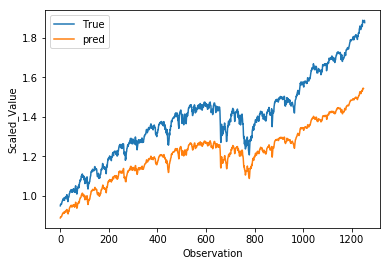

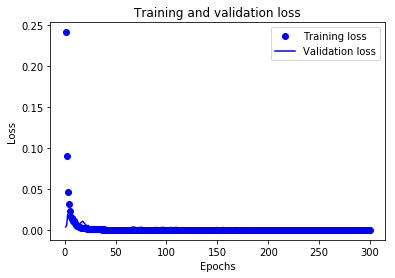

RUA_de5_tcn_clf9_n32_pe0.1_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.152
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.322
Model: "model_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_18 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_18[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 337us/sample - loss: 6.4758e-04 - val_loss: 0.0029TA: 1s - loss: 1.4 - ETA: 0
Epoch 84/300
5667/5667==============================] - 2s 341us/sample - loss: 6.2105e-04 - val_loss: 0.0031
Epoch 85/300
5667/5667==============================] - 2s 338us/sample - loss: 6.5072e-04 - val_loss: 0.0029
Epoch 86/300
5667/5667==============================] - 2s 343us/sample - loss: 6.4008e-04 - val_loss: 0.0035
Epoch 87/300
5667/5667==============================] - 2s 337us/sample - loss: 6.5764e-04 - val_loss: 0.0034
Epoch 88/300
5667/5667==============================] - 2s 338us/sample - loss: 6.4097e-04 - val_loss: 0.0038
Epoch 89/300
5667/5667==============================] - 2s 339us/sample - loss: 6.3385e-04 - val_loss: 0.0027
Epoch 90/300
5667/5667==============================] - 2s 335us/sample - loss: 6.2641e-04 - val_loss: 0.0040
Epoch 91/300
5667/5667==============================] - 2s 336us/sample - loss: 6.2945e-04 - val_loss: 0.0

5667/5667==============================] - 2s 335us/sample - loss: 5.0807e-04 - val_loss: 0.0024
Epoch 230/300
5667/5667==============================] - 2s 338us/sample - loss: 4.9948e-04 - val_loss: 0.0024
Epoch 231/300
5667/5667==============================] - 2s 337us/sample - loss: 4.9917e-04 - val_loss: 0.0025
Epoch 232/300
5667/5667==============================] - 2s 338us/sample - loss: 4.9636e-04 - val_loss: 0.0024
Epoch 233/300
5667/5667==============================] - 2s 337us/sample - loss: 4.9699e-04 - val_loss: 0.0024
Epoch 234/300
5667/5667==============================] - 2s 338us/sample - loss: 4.8782e-04 - val_loss: 0.0025
Epoch 235/300
5667/5667==============================] - 2s 340us/sample - loss: 4.9084e-04 - val_loss: 0.0025
Epoch 236/300
5667/5667==============================] - 2s 338us/sample - loss: 4.9127e-04 - val_loss: 0.0022
Epoch 237/300
5667/5667==============================] - 2s 341us/sample - loss: 4.8933e-04 - val_loss: 0.0024
Epoch 238/300
5

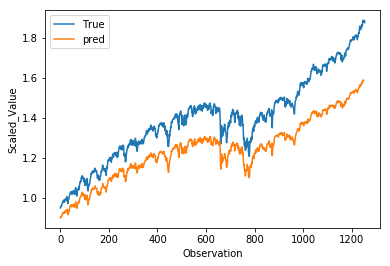

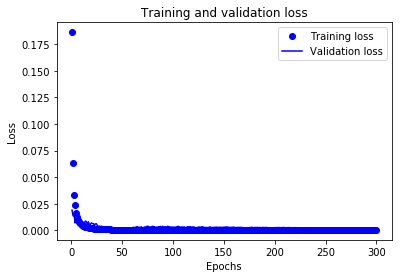

RUA_de5_tcn_clf9_n32_pe0.1_7:
(1254,)
The Adjusted R2 score on the Test set is:	0.352
The Custom  sign score on the Test set is:	0.512
The Custom  R2 score on the Test set is:	0.432
Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_19[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 330us/sample - loss: 6.8367e-04 - val_loss: 0.0034
Epoch 84/300
5667/5667==============================] - 2s 331us/sample - loss: 7.1916e-04 - val_loss: 0.0037
Epoch 85/300
5667/5667==============================] - 2s 338us/sample - loss: 7.6550e-04 - val_loss: 0.0024
Epoch 86/300
5667/5667==============================] - 2s 336us/sample - loss: 7.4453e-04 - val_loss: 0.0047
Epoch 87/300
5667/5667==============================] - 2s 334us/sample - loss: 6.9927e-04 - val_loss: 0.0035
Epoch 88/300
5667/5667==============================] - 2s 335us/sample - loss: 7.2605e-04 - val_loss: 0.0039
Epoch 89/300
5667/5667==============================] - 2s 336us/sample - loss: 6.9794e-04 - val_loss: 0.0039
Epoch 90/300
5667/5667==============================] - 2s 331us/sample - loss: 7.1786e-04 - val_loss: 0.0035
Epoch 91/300
5667/5667==============================] - 2s 334us/sample - loss: 6.8823e-04 - val_loss: 0.0037
Epoch 92/300
5667/5667=

Epoch 157/300
5667/5667==============================] - 2s 332us/sample - loss: 5.2799e-04 - val_loss: 0.0028
Epoch 158/300
5667/5667==============================] - 2s 335us/sample - loss: 5.3324e-04 - val_loss: 0.0029
Epoch 159/300
5667/5667==============================] - 2s 335us/sample - loss: 5.2701e-04 - val_loss: 0.0030
Epoch 160/300
5667/5667==============================] - 2s 336us/sample - loss: 5.3046e-04 - val_loss: 0.0028
Epoch 161/300
5667/5667==============================] - 2s 340us/sample - loss: 5.2246e-04 - val_loss: 0.0029
Epoch 162/300
5667/5667==============================] - 2s 335us/sample - loss: 5.1945e-04 - val_loss: 0.0027
Epoch 163/300
5667/5667==============================] - 2s 339us/sample - loss: 5.3188e-04 - val_loss: 0.0029
Epoch 164/300
5667/5667==============================] - 2s 337us/sample - loss: 5.2332e-04 - val_loss: 0.0028
Epoch 165/300
5667/5667==============================] - 2s 337us/sample - loss: 5.1660e-04 - val_loss: 0.0028
E

Epoch 231/300
5667/5667==============================] - 2s 334us/sample - loss: 4.9508e-04 - val_loss: 0.0027
Epoch 232/300
5667/5667==============================] - 2s 335us/sample - loss: 4.8038e-04 - val_loss: 0.0024
Epoch 233/300
5667/5667==============================] - 2s 336us/sample - loss: 4.7235e-04 - val_loss: 0.0026
Epoch 234/300
5667/5667==============================] - 2s 338us/sample - loss: 4.8191e-04 - val_loss: 0.0024
Epoch 235/300
5667/5667==============================] - 2s 335us/sample - loss: 4.7882e-04 - val_loss: 0.0023
Epoch 236/300
5667/5667==============================] - 2s 337us/sample - loss: 4.7526e-04 - val_loss: 0.0024
Epoch 237/300
5667/5667==============================] - 2s 336us/sample - loss: 4.7346e-04 - val_loss: 0.0023
Epoch 238/300
5667/5667==============================] - 2s 338us/sample - loss: 4.7651e-04 - val_loss: 0.0025
Epoch 239/300
5667/5667==============================] - 2s 341us/sample - loss: 4.8326e-04 - val_loss: 0.0025
E

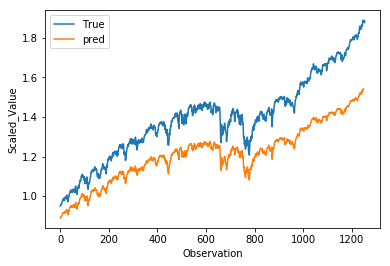

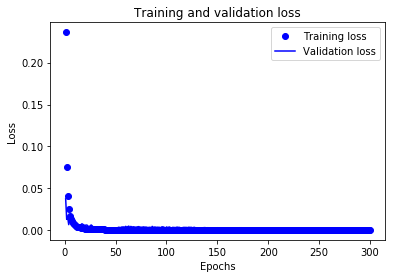

RUA_de5_tcn_clf9_n32_pe0.1_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.126
The Custom  sign score on the Test set is:	0.506
The Custom  R2 score on the Test set is:	0.316
Model: "model_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_20 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_20[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 342us/sample - loss: 0.0115 - val_loss: 0.0034
Epoch 9/300
5667/5667==============================] - 2s 341us/sample - loss: 0.0089 - val_loss: 0.0018
Epoch 10/300
5667/5667==============================] - 2s 339us/sample - loss: 0.0079 - val_loss: 0.0019
Epoch 11/300
5667/5667==============================] - 2s 338us/sample - loss: 0.0068 - val_loss: 0.0024
Epoch 12/300
5667/5667==============================] - 2s 340us/sample - loss: 0.0060 - val_loss: 0.0021
Epoch 13/300
5667/5667==============================] - 2s 339us/sample - loss: 0.0052 - val_loss: 0.0015
Epoch 14/300
5667/5667==============================] - 2s 337us/sample - loss: 0.0047 - val_loss: 0.0016
Epoch 15/300
5667/5667==============================] - 2s 342us/sample - loss: 0.0040 - val_loss: 0.0027
Epoch 16/300
5667/5667==============================] - 2s 339us/sample - loss: 0.0037 - val_loss: 0.0023
Epoch 17/300
5667/5667==============================] - 2s 3

5667/5667==============================] - 2s 337us/sample - loss: 5.4901e-04 - val_loss: 0.0029
Epoch 157/300
5667/5667==============================] - 2s 334us/sample - loss: 5.4967e-04 - val_loss: 0.0030
Epoch 158/300
5667/5667==============================] - 2s 337us/sample - loss: 5.4321e-04 - val_loss: 0.0028
Epoch 159/300
5667/5667==============================] - 2s 337us/sample - loss: 5.3615e-04 - val_loss: 0.0028
Epoch 160/300
5667/5667==============================] - 2s 341us/sample - loss: 5.4006e-04 - val_loss: 0.0031
Epoch 161/300
5667/5667==============================] - 2s 340us/sample - loss: 5.4031e-04 - val_loss: 0.0029
Epoch 162/300
5667/5667==============================] - 2s 341us/sample - loss: 5.3997e-04 - val_loss: 0.0031
Epoch 163/300
5667/5667==============================] - 2s 347us/sample - loss: 5.4484e-04 - val_loss: 0.0030
Epoch 164/300
5667/5667==============================] - 2s 337us/sample - loss: 5.1623e-04 - val_loss: 0.0028
Epoch 165/300
5

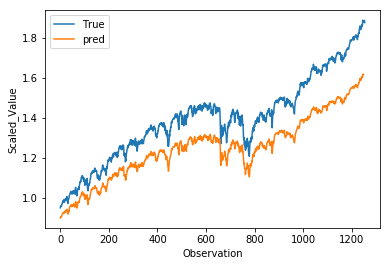

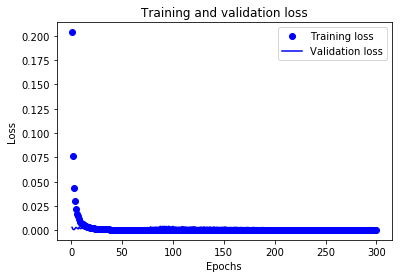

RUA_de5_tcn_clf9_n32_pe0.1_9:
(1254,)
The Adjusted R2 score on the Test set is:	0.433
The Custom  sign score on the Test set is:	0.502
The Custom  R2 score on the Test set is:	0.468


In [41]:
neurons=[32]
penalties=[0.01, 0.1]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

In [ ]:
neurons=[32]
penalties=[1, 10]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_1[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation (Activation)         (None, 1, 32)        0           tcn_d_causal_conv_1_tanh_s0[0][0]
______________________________________________________________________________________________

Epoch 10/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0578 - val_loss: 0.0056
Epoch 11/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0461 - val_loss: 0.0065
Epoch 12/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0371 - val_loss: 0.0050
Epoch 13/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0397 - val_loss: 0.0062
Epoch 14/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0330 - val_loss: 0.0076
Epoch 15/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0323 - val_loss: 0.0076
Epoch 16/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0268 - val_loss: 0.0072
Epoch 17/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0277 - val_loss: 0.0050
Epoch 18/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0248 - val_loss: 0.0066
Epoch 19/300
5667/5667========================

Epoch 164/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0188 - val_loss: 0.0915
Epoch 165/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0205 - val_loss: 0.1147
Epoch 166/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0204 - val_loss: 0.0995
Epoch 167/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0191 - val_loss: 0.1059
Epoch 168/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0178 - val_loss: 0.1133
Epoch 169/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0210 - val_loss: 0.1121
Epoch 170/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0193 - val_loss: 0.1352
Epoch 171/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0199 - val_loss: 0.1001
Epoch 172/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0197 - val_loss: 0.1102
Epoch 173/300
5667/5667==============

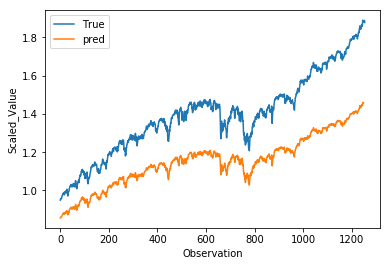

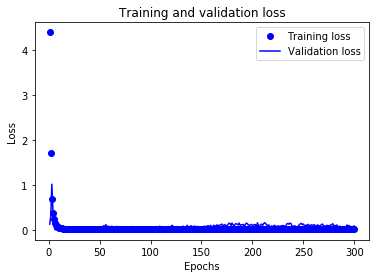

RUA_de5_tcn_clf9_n32_pe100_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.514
The Custom  sign score on the Test set is:	0.507
The Custom  R2 score on the Test set is:	-0.004
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_2[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 292us/sample - loss: 0.0243 - val_loss: 0.1240
Epoch 85/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0269 - val_loss: 0.1423
Epoch 86/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0265 - val_loss: 0.1366
Epoch 87/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0247 - val_loss: 0.1035
Epoch 88/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0258 - val_loss: 0.1126
Epoch 89/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0272 - val_loss: 0.1189
Epoch 90/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0267 - val_loss: 0.1340
Epoch 91/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0260 - val_loss: 0.1330
Epoch 92/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0240 - val_loss: 0.1175
Epoch 93/300
5667/5667==============================] - 2s 

5667/5667==============================] - 2s 287us/sample - loss: 0.0182 - val_loss: 0.0677
Epoch 235/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0185 - val_loss: 0.0835
Epoch 236/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0188 - val_loss: 0.0951
Epoch 237/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0217 - val_loss: 0.1255
Epoch 238/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0223 - val_loss: 0.1187
Epoch 239/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0222 - val_loss: 0.1340
Epoch 240/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0229 - val_loss: 0.1130
Epoch 241/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0227 - val_loss: 0.1303: 0.01
Epoch 242/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0221 - val_loss: 0.1197
Epoch 243/300
5667/5667======================

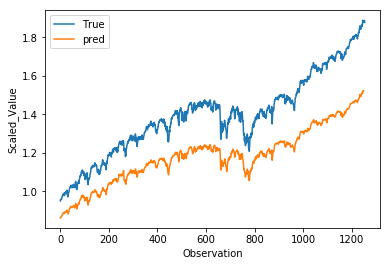

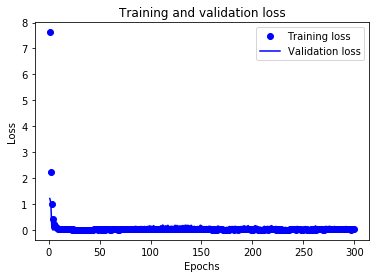

RUA_de5_tcn_clf9_n32_pe100_1:
(1254,)
The Adjusted R2 score on the Test set is:	-0.154
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	0.172
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_3[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 282us/sample - loss: 0.0256 - val_loss: 0.1200
Epoch 85/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0266 - val_loss: 0.1359
Epoch 86/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0273 - val_loss: 0.1272
Epoch 87/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0291 - val_loss: 0.1193
Epoch 88/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0298 - val_loss: 0.1288
Epoch 89/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0276 - val_loss: 0.1284
Epoch 90/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0295 - val_loss: 0.1226A:
Epoch 91/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0289 - val_loss: 0.1391
Epoch 92/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0278 - val_loss: 0.1173 loss: 0.
Epoch 93/300
5667/5667==========================

5667/5667==============================] - 2s 284us/sample - loss: 0.0187 - val_loss: 0.0790
Epoch 233/300
5667/5667==============================] - 2s 281us/sample - loss: 0.0189 - val_loss: 0.0876
Epoch 234/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0211 - val_loss: 0.0934
Epoch 235/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0218 - val_loss: 0.1114
Epoch 236/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0229 - val_loss: 0.1059
Epoch 237/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0217 - val_loss: 0.1264
Epoch 238/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0238 - val_loss: 0.0883
Epoch 239/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0256 - val_loss: 0.1228
Epoch 240/300
5667/5667==============================] - 2s 284us/sample - loss: 0.0293 - val_loss: 0.1174TA: 1s  - ETA: 0s - loss:
Epoch 241/300
5667/5667===

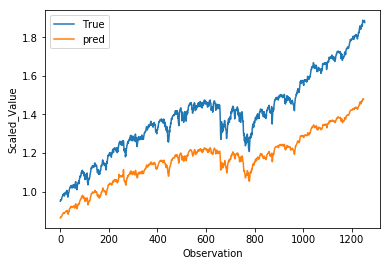

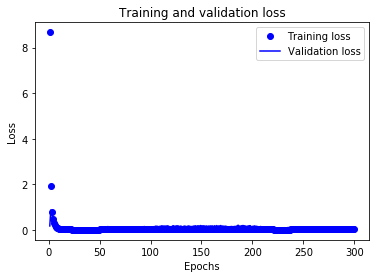

RUA_de5_tcn_clf9_n32_pe100_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.309
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.094
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_4[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 8/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0733 - val_loss: 0.0079
Epoch 9/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0588 - val_loss: 0.0048
Epoch 10/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0511 - val_loss: 0.0065
Epoch 11/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0457 - val_loss: 0.0066
Epoch 12/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0388 - val_loss: 0.0052
Epoch 13/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0352 - val_loss: 0.0056
Epoch 14/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0306 - val_loss: 0.0045TA: 1s - loss: 0.01 - ETA:
Epoch 15/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0324 - val_loss: 0.0085oss: 0.032
Epoch 16/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0269 - val_loss: 0.0074
Epoch 17/300

Epoch 159/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0235 - val_loss: 0.1637
Epoch 160/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0267 - val_loss: 0.2079
Epoch 161/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0255 - val_loss: 0.1896
Epoch 162/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0285 - val_loss: 0.1553
Epoch 163/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0253 - val_loss: 0.1413
Epoch 164/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0239 - val_loss: 0.1481
Epoch 165/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0241 - val_loss: 0.1678
Epoch 166/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0249 - val_loss: 0.1652
Epoch 167/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0271 - val_loss: 0.1892
Epoch 168/300
5667/5667==============

Epoch 234/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0233 - val_loss: 0.1219
Epoch 235/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0213 - val_loss: 0.1529
Epoch 236/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0232 - val_loss: 0.1455: 0.
Epoch 237/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0216 - val_loss: 0.1165
Epoch 238/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0201 - val_loss: 0.0946
Epoch 239/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0199 - val_loss: 0.0697
Epoch 240/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0202 - val_loss: 0.1120s - lo
Epoch 241/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0205 - val_loss: 0.1099
Epoch 242/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0210 - val_loss: 0.1380TA: 0s - loss: 0
Epoch 243/3

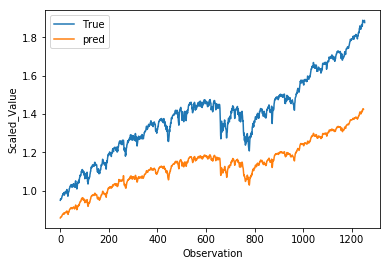

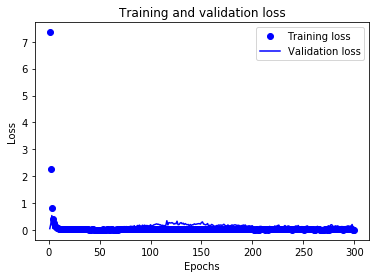

RUA_de5_tcn_clf9_n32_pe100_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.729
The Custom  sign score on the Test set is:	0.504
The Custom  R2 score on the Test set is:	-0.112
Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_5[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 294us/sample - loss: 0.0858 - val_loss: 0.0058
Epoch 9/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0697 - val_loss: 0.0050
Epoch 10/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0531 - val_loss: 0.0076
Epoch 11/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0470 - val_loss: 0.0078
Epoch 12/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0477 - val_loss: 0.0055
Epoch 13/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0373 - val_loss: 0.0050
Epoch 14/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0332 - val_loss: 0.0037
Epoch 15/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0290 - val_loss: 0.0050
Epoch 16/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0343 - val_loss: 0.0049
Epoch 17/300
5667/5667==============================] - 2s 2

5667/5667==============================] - 2s 305us/sample - loss: 0.0365 - val_loss: 0.1952
Epoch 161/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0388 - val_loss: 0.1368
Epoch 162/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0393 - val_loss: 0.2000
Epoch 163/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0387 - val_loss: 0.1900
Epoch 164/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0378 - val_loss: 0.1794
Epoch 165/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0410 - val_loss: 0.1632
Epoch 166/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0376 - val_loss: 0.1679
Epoch 167/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0374 - val_loss: 0.1604
Epoch 168/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0387 - val_loss: 0.2112
Epoch 169/300
5667/5667============================

Epoch 236/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0305 - val_loss: 0.1274
Epoch 237/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0292 - val_loss: 0.1280
Epoch 238/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0250 - val_loss: 0.1309
Epoch 239/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0269 - val_loss: 0.1240 - los - ETA: 0s - loss: 0.01 - ETA: 0s - loss: 0
Epoch 240/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0273 - val_loss: 0.0987
Epoch 241/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0256 - val_loss: 0.1143
Epoch 242/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0255 - val_loss: 0.1078
Epoch 243/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0249 - val_loss: 0.1220
Epoch 244/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0300 - val_l

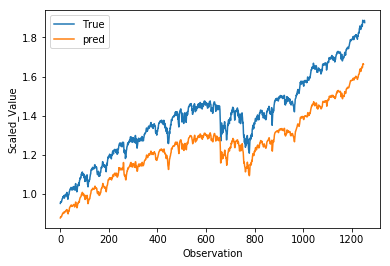

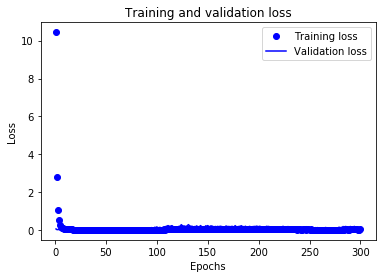

RUA_de5_tcn_clf9_n32_pe100_4:
(1254,)
The Adjusted R2 score on the Test set is:	0.419
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	0.459
Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_6[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 318us/sample - loss: 0.0269 - val_loss: 0.0701
Epoch 86/300
5667/5667==============================] - 2s 317us/sample - loss: 0.0226 - val_loss: 0.0677
Epoch 87/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0235 - val_loss: 0.0551
Epoch 88/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0222 - val_loss: 0.0694
Epoch 89/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0237 - val_loss: 0.0772
Epoch 90/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0227 - val_loss: 0.0692
Epoch 91/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0225 - val_loss: 0.0443
Epoch 92/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0223 - val_loss: 0.0723
Epoch 93/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0222 - val_loss: 0.0536
Epoch 94/300
5667/5667==============================] - 2s 

Epoch 162/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0188 - val_loss: 0.0468
Epoch 163/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0203 - val_loss: 0.0507
Epoch 164/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0216 - val_loss: 0.0485
Epoch 165/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0205 - val_loss: 0.0343
Epoch 166/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0207 - val_loss: 0.0627
Epoch 167/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0205 - val_loss: 0.1027
Epoch 168/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0189 - val_loss: 0.0293
Epoch 169/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0195 - val_loss: 0.0846
Epoch 170/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0208 - val_loss: 0.0890
Epoch 171/300
5667/5667==============

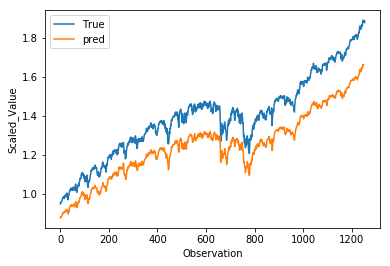

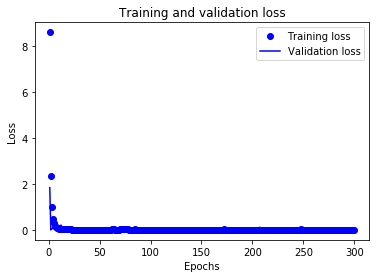

RUA_de5_tcn_clf9_n32_pe100_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.459
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.478
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_7[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 309us/sample - loss: 0.0200 - val_loss: 0.0581
Epoch 86/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0187 - val_loss: 0.0824
Epoch 87/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0199 - val_loss: 0.0682
Epoch 88/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0182 - val_loss: 0.0572
Epoch 89/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0176 - val_loss: 0.0575
Epoch 90/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0170 - val_loss: 0.0797
Epoch 91/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0204 - val_loss: 0.0556
Epoch 92/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0207 - val_loss: 0.0613
Epoch 93/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0209 - val_loss: 0.0495
Epoch 94/300
5667/5667==============================] - 2s 

In [ ]:
neurons=[32]
penalties=[100, 'x']
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_1[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation (Activation)         (None, 1, 32)        0           tcn_d_causal_conv_1_tanh_s0[0][0]
______________________________________________________________________________________________

Epoch 10/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0620 - val_loss: 0.0041
Epoch 11/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0518 - val_loss: 0.0046
Epoch 12/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0410 - val_loss: 0.0043
Epoch 13/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0378 - val_loss: 0.0053
Epoch 14/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0330 - val_loss: 0.0042
Epoch 15/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0312 - val_loss: 0.0054
Epoch 16/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0301 - val_loss: 0.0070
Epoch 17/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0271 - val_loss: 0.0046
Epoch 18/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0258 - val_loss: 0.0045
Epoch 19/300
5667/5667========================

Epoch 164/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0203 - val_loss: 0.1051
Epoch 165/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0218 - val_loss: 0.1102
Epoch 166/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0198 - val_loss: 0.0780
Epoch 167/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0188 - val_loss: 0.0904
Epoch 168/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0200 - val_loss: 0.0907
Epoch 169/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0186 - val_loss: 0.0649
Epoch 170/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0169 - val_loss: 0.0479
Epoch 171/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0185 - val_loss: 0.0860
Epoch 172/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0181 - val_loss: 0.0975
Epoch 173/300
5667/5667==============

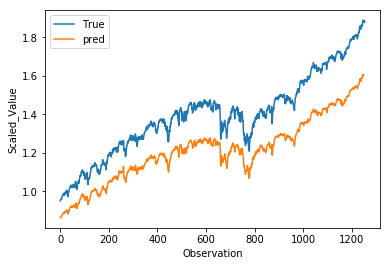

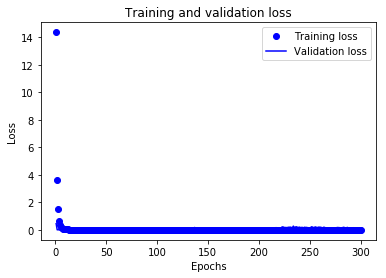

RUA_de5_tcn_clf9_n32_pe100_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.157
The Custom  sign score on the Test set is:	0.493
The Custom  R2 score on the Test set is:	0.325
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_2[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

Epoch 85/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0235 - val_loss: 0.1362
Epoch 86/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0276 - val_loss: 0.1325
Epoch 87/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0267 - val_loss: 0.1740
Epoch 88/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0283 - val_loss: 0.1732
Epoch 89/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0250 - val_loss: 0.1840
Epoch 90/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0292 - val_loss: 0.1733
Epoch 91/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0298 - val_loss: 0.1143
Epoch 92/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0287 - val_loss: 0.2086
Epoch 93/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0302 - val_loss: 0.1831
Epoch 94/300
5667/5667========================

5667/5667==============================] - 2s 310us/sample - loss: 0.0225 - val_loss: 0.1464
Epoch 238/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0236 - val_loss: 0.1241
Epoch 239/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0238 - val_loss: 0.1533
Epoch 240/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0234 - val_loss: 0.0837
Epoch 241/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0234 - val_loss: 0.0912
Epoch 242/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0213 - val_loss: 0.1097
Epoch 243/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0212 - val_loss: 0.0697
Epoch 244/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0200 - val_loss: 0.0885
Epoch 245/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0214 - val_loss: 0.1098
Epoch 246/300
5667/5667============================

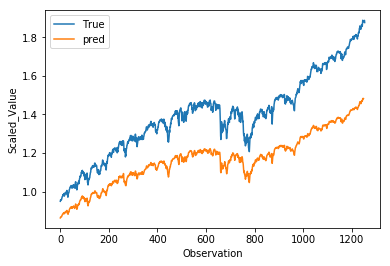

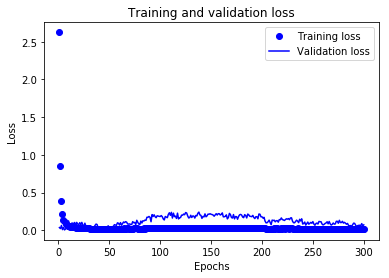

RUA_de5_tcn_clf9_n32_pe100_7:
(1254,)
The Adjusted R2 score on the Test set is:	-0.343
The Custom  sign score on the Test set is:	0.494
The Custom  R2 score on the Test set is:	0.076
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_3[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 301us/sample - loss: 0.0163 - val_loss: 0.0752
Epoch 86/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0188 - val_loss: 0.0712
Epoch 87/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0183 - val_loss: 0.0684
Epoch 88/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0161 - val_loss: 0.0808
Epoch 89/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0169 - val_loss: 0.0658
Epoch 90/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0182 - val_loss: 0.0660
Epoch 91/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0163 - val_loss: 0.0739
Epoch 92/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0180 - val_loss: 0.0793
Epoch 93/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0184 - val_loss: 0.0906
Epoch 94/300
5667/5667==============================] - 2s 

5667/5667==============================] - 2s 288us/sample - loss: 0.0474 - val_loss: 0.2157A: 1s - loss: 0.009 - ETA: 0s - l - ETA: 0s - loss: 0.0 - ETA: 0s - loss: 0.03
Epoch 215/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0486 - val_loss: 0.1870 0. - ETA: 0s - loss: 0.0
Epoch 216/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0478 - val_loss: 0.1573loss: 0.
Epoch 217/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0393 - val_loss: 0.2329 0s - loss: 0.022 - ETA: 0s - loss: - ETA: 0s - loss: 0.038
Epoch 218/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0461 - val_loss: 0.1343s: 0.035 - ETA: 0s - loss: 0.
Epoch 219/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0400 - val_loss: 0.2273A: 1s - loss: 0. - ETA: 0s - loss: 0. - ETA: 0s - lo
Epoch 220/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0442 - val_loss: 0.1821A: 0s - lo
Epoc

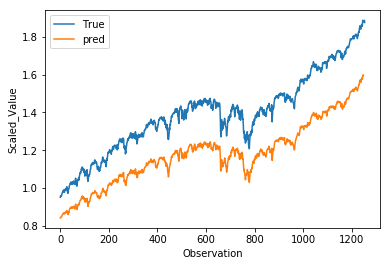

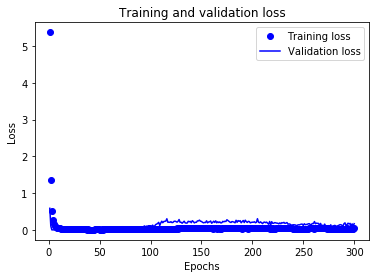

RUA_de5_tcn_clf9_n32_pe100_8:
(1254,)
The Adjusted R2 score on the Test set is:	-0.129
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.181
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_4[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 297us/sample - loss: 0.0350 - val_loss: 0.1654 - loss: 0.02 - ETA: 0s - loss: 0.0
Epoch 71/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0322 - val_loss: 0.1537
Epoch 72/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0338 - val_loss: 0.1549
Epoch 73/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0320 - val_loss: 0.1608
Epoch 74/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0309 - val_loss: 0.1679 0s - loss: - ETA: 0s - loss: 0.02 - ETA: 0s - loss: 0
Epoch 75/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0315 - val_loss: 0.1607TA: 0s - loss:  - ETA: 0s - loss
Epoch 76/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0332 - val_loss: 0.1547ss: 0.02 - ETA: 0s - loss: 
Epoch 77/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0304 - val_loss: 0.1204s - loss: 0.01 - E

5667/5667==============================] - 2s 297us/sample - loss: 0.0221 - val_loss: 0.1102TA: 1s - loss: 0.00 - ETA: 1s - loss: - ETA: 0s - loss - ETA: 0s - loss: 0.
Epoch 194/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0231 - val_loss: 0.1093
Epoch 195/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0217 - val_loss: 0.0933TA: 0s - loss: 0. - ETA: 0s - loss: 0.0 - ETA: 0s - loss:
Epoch 196/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0257 - val_loss: 0.1060- loss: 0. - ETA: 0s - loss
Epoch 197/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0229 - val_loss: 0.0758 0s - loss: 0.00 - ETA: 0s -
Epoch 198/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0207 - val_loss: 0.0913ss: 0.015 - ETA: 0s - loss:  - ETA: 0s - loss: 0.017 - ETA: 0s - loss: 0.01
Epoch 199/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0211 - val_loss: 0.1025
Epo

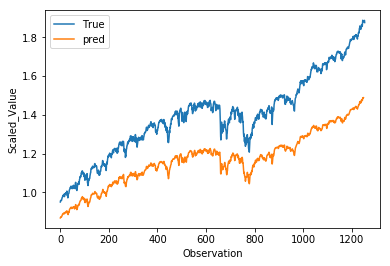

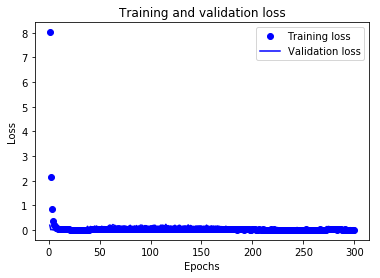

RUA_de5_tcn_clf9_n32_pe100_9:
(1254,)
The Adjusted R2 score on the Test set is:	-0.328
The Custom  sign score on the Test set is:	0.494
The Custom  R2 score on the Test set is:	0.083


In [39]:
neurons=[32]
penalties=[100]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(6 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_5[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_24 (Activation)      (None, 1, 32)        0           tcn_d_causal_conv_1_tanh_s0[0][0]
____________________________________________________________________________________________

5667/5667==============================] - 2s 288us/sample - loss: 7.4043e-04 - val_loss: 0.0035 - loss: 5.4207
Epoch 66/300
5667/5667==============================] - 2s 291us/sample - loss: 7.5660e-04 - val_loss: 0.0047oss: 5.2272 - ETA: 0s - loss: 5.9280e
Epoch 67/300
5667/5667==============================] - 2s 291us/sample - loss: 7.5372e-04 - val_loss: 0.0043
Epoch 68/300
5667/5667==============================] - 2s 290us/sample - loss: 7.6601e-04 - val_loss: 0.0047 0s - loss: 3.27 - ETA: 0s - loss: 5.3725e-0 - ETA: 0s - loss: 5.28
Epoch 69/300
5667/5667==============================] - 2s 291us/sample - loss: 7.5033e-04 - val_loss: 0.0043
Epoch 70/300
5667/5667==============================] - 2s 291us/sample - loss: 7.5187e-04 - val_loss: 0.0042A: 0s - loss: 1.99 - ETA: 0s - loss: 4.7771e- - ETA: 0s - loss: 4.9337e-0 - ETA: 0s - loss: 5.
Epoch 71/300
5667/5667==============================] - 2s 293us/sample - loss: 6.7925e-04 - val_loss: 0.00410s - loss:
Epoch 72/300
5667/56

5667/5667==============================] - 2s 284us/sample - loss: 5.4426e-04 - val_loss: 0.0033A: 0s - loss: 4.0980e
Epoch 185/300
5667/5667==============================] - 2s 278us/sample - loss: 5.3008e-04 - val_loss: 0.0032 ETA: 0s - loss: 1.0775 - ETA: 0s - loss: 3
Epoch 186/300
5667/5667==============================] - 2s 282us/sample - loss: 5.3539e-04 - val_loss: 0.0034A: 0s - loss: 3.
Epoch 187/300
5667/5667==============================] - 2s 283us/sample - loss: 5.4674e-04 - val_loss: 0.0035: 0s - loss: 5.95 - ETA: 0s - loss: 3
Epoch 188/300
5667/5667==============================] - 2s 284us/sample - loss: 5.5171e-04 - val_loss: 0.0033
Epoch 189/300
5667/5667==============================] - 2s 281us/sample - loss: 5.4119e-04 - val_loss: 0.0030
Epoch 190/300
5667/5667==============================] - 2s 280us/sample - loss: 5.3046e-04 - val_loss: 0.0032ETA: 0s - loss: 5.3146e- - ETA: 0s - loss: 7.1896e- - ETA: 0s - loss: 1.4656e-0 - ETA: 0s - loss
Epoch 191/300
5667/5667=

y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.207982
The Adjusted R2 score on the Test set is:	0.205


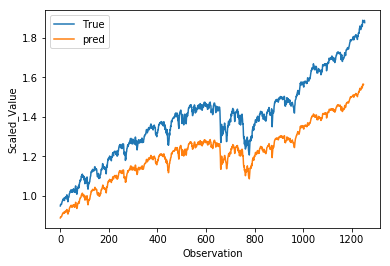

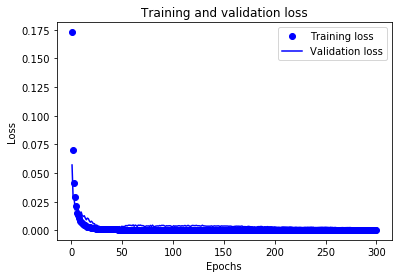

RUA_de5_tcn_clf9_n32_pex_0:
(1254,)
The Adjusted R2 score on the Test set is:	0.205
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.353
Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_6[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_

5667/5667==============================] - 2s 288us/sample - loss: 7.9602e-04 - val_loss: 0.0051- loss: 7.5926e-0
Epoch 68/300
5667/5667==============================] - 2s 291us/sample - loss: 7.5926e-04 - val_loss: 0.0039
Epoch 69/300
5667/5667==============================] - 2s 291us/sample - loss: 7.7698e-04 - val_loss: 0.0039s - loss: 5.5238e- - ETA: 0s - loss: 7.4197e-
Epoch 70/300
5667/5667==============================] - 2s 295us/sample - loss: 7.5537e-04 - val_loss: 0.0042
Epoch 71/300
5667/5667==============================] - 2s 292us/sample - loss: 7.5701e-04 - val_loss: 0.0033
Epoch 72/300
5667/5667==============================] - 2s 292us/sample - loss: 7.3993e-04 - val_loss: 0.0038- ETA: 1s - loss: 2. - ETA: 0s - loss: 3.5976 - ETA: 0s - loss: 5.2603 - ETA: 0s - loss: 5.2624
Epoch 73/300
5667/5667==============================] - 2s 295us/sample - loss: 7.3136e-04 - val_loss: 0.0040ss: 2.6665e- - ETA: 0s - loss: 3. - ETA: 0s - loss: 5.1769
Epoch 74/300
5667/5667======

5667/5667==============================] - 2s 280us/sample - loss: 5.0086e-04 - val_loss: 0.0024 - ETA: 0s - loss: 4.8914e-0
Epoch 180/300
5667/5667==============================] - 2s 283us/sample - loss: 4.9243e-04 - val_loss: 0.0024 0s - loss: 2.0343 - ETA: 0s - loss: 3.
Epoch 181/300
5667/5667==============================] - 2s 280us/sample - loss: 4.9028e-04 - val_loss: 0.0025- loss: 1.3344e-0 - ETA: 0s - loss: 1. - ETA: 0s - loss: 3.3829
Epoch 182/300
5667/5667==============================] - 2s 285us/sample - loss: 4.8918e-04 - val_loss: 0.0023TA: 1s - loss: 6.06 - ETA: 0s - loss: 2.0348e-0 - ETA: 0s - loss: 2.6989e- - ETA: 0s - loss: 
Epoch 183/300
5667/5667==============================] - 2s 283us/sample - loss: 4.8187e-04 - val_loss: 0.0025 ETA: 1s
Epoch 184/300
5667/5667==============================] - 2s 282us/sample - loss: 4.8646e-04 - val_loss: 0.0023- loss: 3.3395 - ETA: 0s - loss: 3.429
Epoch 185/300
5667/5667==============================] - 2s 281us/sample - loss

5667/5667==============================] - 2s 284us/sample - loss: 4.3449e-04 - val_loss: 0.0018 0s - loss: 5.6101e- - ETA: 0s - loss: 1.3058e- - ETA: 0s - loss: 2.4 - ETA: 0s - loss: 3.4440e
Epoch 286/300
5667/5667==============================] - 2s 285us/sample - loss: 4.4011e-04 - val_loss: 0.0018
Epoch 287/300
5667/5667==============================] - 2s 281us/sample - loss: 4.4473e-04 - val_loss: 0.0018- ETA: 0s - loss: 7.37 - ETA: 0s - loss: 3.2293e - ETA: 0s - loss: 3.197
Epoch 288/300
5667/5667==============================] - 2s 281us/sample - loss: 4.3565e-04 - val_loss: 0.0018
Epoch 289/300
5667/5667==============================] - 2s 279us/sample - loss: 4.4056e-04 - val_loss: 0.0019 - ETA: 0s - loss: 2.9292e-0 - ETA: 0s - loss: 3
Epoch 290/300
5667/5667==============================] - 2s 288us/sample - loss: 4.4123e-04 - val_loss: 0.0018 0s - loss: 3
Epoch 291/300
5667/5667==============================] - 2s 284us/sample - loss: 4.4457e-04 - val_loss: 0.0019
Epoch 292

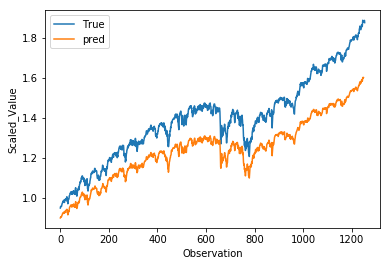

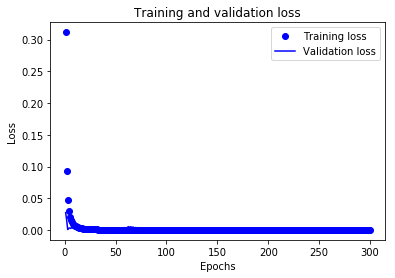

RUA_de5_tcn_clf9_n32_pex_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.386
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	0.443
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_7[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_

5667/5667==============================] - 2s 288us/sample - loss: 6.2899e-04 - val_loss: 0.0039 - ETA: 1s -  - ETA: 0s - loss: 6.0156e-0
Epoch 72/300
5667/5667==============================] - 2s 283us/sample - loss: 6.5729e-04 - val_loss: 0.0032ETA: 1s 
Epoch 73/300
5667/5667==============================] - 2s 289us/sample - loss: 6.3210e-04 - val_loss: 0.0024TA: 1s - loss: 1.5107e - ETA: 1s
Epoch 74/300
5667/5667==============================] - 2s 283us/sample - loss: 6.1375e-04 - val_loss: 0.0032 - loss: 1.48 - ETA: 0s - loss: 4
Epoch 75/300
5667/5667==============================] - 2s 281us/sample - loss: 6.1495e-04 - val_loss: 0.0031 ETA: 1s - loss: 1. - ETA: 0s - loss: 3.95 - ETA: 0s - loss: 4.5378e-0 - ETA: 0s - loss: 5.6569e-
Epoch 76/300
5667/5667==============================] - 2s 287us/sample - loss: 6.0769e-04 - val_loss: 0.0029- ETA: 1s 
Epoch 77/300
5667/5667==============================] - 2s 284us/sample - loss: 6.0090e-04 - val_loss: 0.0031TA: 1s - loss:  - ETA: 

5667/5667==============================] - 2s 286us/sample - loss: 4.7796e-04 - val_loss: 0.0024 - loss: 3.4728e-0 - ETA: 0s - loss: 3.395
Epoch 188/300
5667/5667==============================] - 2s 283us/sample - loss: 4.7437e-04 - val_loss: 0.0024
Epoch 189/300
5667/5667==============================] - 2s 283us/sample - loss: 4.7425e-04 - val_loss: 0.0023
Epoch 190/300
5667/5667==============================] - 2s 285us/sample - loss: 4.7061e-04 - val_loss: 0.0023s - loss: 3.3816e-0 - ETA: 0s - loss: 3.5879e
Epoch 191/300
5667/5667==============================] - 2s 286us/sample - loss: 4.6629e-04 - val_loss: 0.0023
Epoch 192/300
5667/5667==============================] - 2s 283us/sample - loss: 4.6970e-04 - val_loss: 0.0023 - loss: 3.378 - ETA: 0s - loss: 3.6796e-0 - ETA: 0s - loss: 4.6302e-0 - ETA: 0s - loss: 4.6957e-0
Epoch 193/300
5667/5667==============================] - 2s 285us/sample - loss: 4.7547e-04 - val_loss: 0.0024loss: 4.6635e-0
Epoch 194/300
5667/5667==============

5667/5667==============================] - 2s 285us/sample - loss: 4.4289e-04 - val_loss: 0.0017A: 0s - loss: 7.4511e- - ETA: 0s - loss
Epoch 299/300
5667/5667==============================] - 2s 284us/sample - loss: 4.3982e-04 - val_loss: 0.0017s - loss: 2.450 - ETA: 0s - loss: 3.2788e-0 - ETA: 0s - loss: 3.2152e-0 - ETA: 0s - loss: 3.2646
Epoch 300/300
5667/5667==============================] - 2s 284us/sample - loss: 4.4097e-04 - val_loss: 0.0017TA: 0s - loss: 3.223
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.362526
The Adjusted R2 score on the Test set is:	0.360


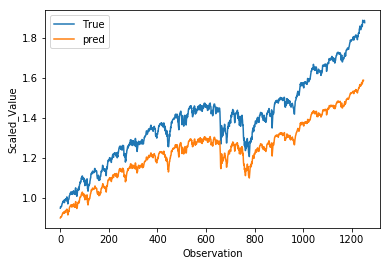

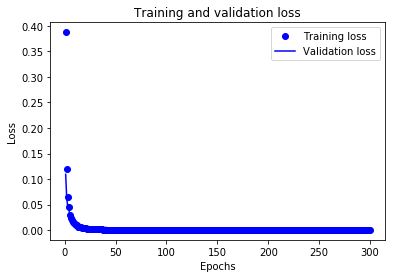

RUA_de5_tcn_clf9_n32_pex_2:
(1254,)
The Adjusted R2 score on the Test set is:	0.360
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.431
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_8[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_

5667/5667==============================] - 2s 285us/sample - loss: 7.2429e-04 - val_loss: 0.0037: 0s - loss: 
Epoch 67/300
5667/5667==============================] - 2s 289us/sample - loss: 7.0874e-04 - val_loss: 0.0036
Epoch 68/300
5667/5667==============================] - 2s 287us/sample - loss: 6.8655e-04 - val_loss: 0.0037
Epoch 69/300
5667/5667==============================] - 2s 288us/sample - loss: 7.1054e-04 - val_loss: 0.0036 - ETA: 0s - loss: 3. - ETA: 0s - loss: 5.0064e
Epoch 70/300
5667/5667==============================] - 2s 283us/sample - loss: 6.5859e-04 - val_loss: 0.0034- ETA: 0s - loss: 4.5731e- - ETA: 0s - loss: 6.2352e-
Epoch 71/300
5667/5667==============================] - 2s 288us/sample - loss: 6.6661e-04 - val_loss: 0.0038 ETA: 0s - loss: 5.7357e-0 - ETA: 0s - loss: 6.3405e-
Epoch 72/300
5667/5667==============================] - 2s 286us/sample - loss: 6.6713e-04 - val_loss: 0.0043ETA: 0s - los
Epoch 73/300
5667/5667==============================] - 2s 289us

5667/5667==============================] - 2s 290us/sample - loss: 5.4956e-04 - val_loss: 0.0030ETA: 0s - loss: 1.76 - ETA: 0s - loss: 4.04
Epoch 176/300
5667/5667==============================] - 2s 291us/sample - loss: 5.5952e-04 - val_loss: 0.0030 ETA: 0s 
Epoch 177/300
5667/5667==============================] - 2s 285us/sample - loss: 5.4764e-04 - val_loss: 0.0029
Epoch 178/300
5667/5667==============================] - 2s 288us/sample - loss: 5.5567e-04 - val_loss: 0.00305.4739e-
Epoch 179/300
5667/5667==============================] - 2s 291us/sample - loss: 5.3489e-04 - val_loss: 0.0029 - ETA
Epoch 180/300
5667/5667==============================] - 2s 286us/sample - loss: 5.4606e-04 - val_loss: 0.0026A: 0s - loss: 5.3897e-
Epoch 181/300
5667/5667==============================] - 2s 288us/sample - loss: 5.4282e-04 - val_loss: 0.0027
Epoch 182/300
5667/5667==============================] - 2s 291us/sample - loss: 5.4550e-04 - val_loss: 0.0027 - ETA: 0s - loss: 6.6485e-0 - ETA: 0s 

5667/5667==============================] - 2s 299us/sample - loss: 4.8020e-04 - val_loss: 0.0017
Epoch 289/300
5667/5667==============================] - 2s 294us/sample - loss: 4.8154e-04 - val_loss: 0.0017s - loss: 3.369 - ETA: 0s - loss: 3.5081e
Epoch 290/300
5667/5667==============================] - 2s 297us/sample - loss: 4.8117e-04 - val_loss: 0.0018TA: 0s - 
Epoch 291/300
5667/5667==============================] - 2s 299us/sample - loss: 4.7989e-04 - val_loss: 0.0017
Epoch 292/300
5667/5667==============================] - 2s 294us/sample - loss: 4.8446e-04 - val_loss: 0.0018loss: 3.4484e - ETA: 0s - loss: 3.413
Epoch 293/300
5667/5667==============================] - 2s 291us/sample - loss: 4.7107e-04 - val_loss: 0.0018 0s - loss: 5.0626e-0 - ETA: 0s - l - ETA: 0s - loss: 4.7069e-0
Epoch 294/300
5667/5667==============================] - 2s 299us/sample - loss: 4.7722e-04 - val_loss: 0.0018 ETA: 1s - loss: - ETA: 0s - loss: 2.8641 - ETA: 0s - loss: 3.4468e- - ETA: 0s - loss: 3

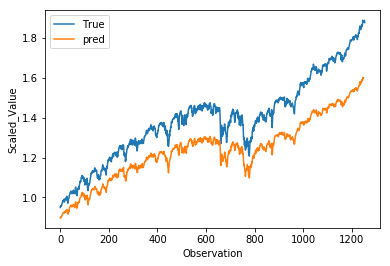

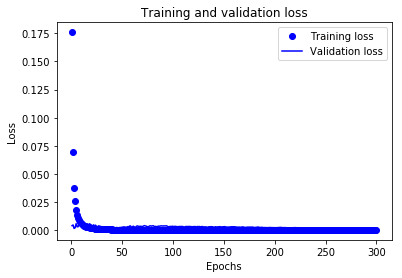

RUA_de5_tcn_clf9_n32_pex_3:
(1254,)
The Adjusted R2 score on the Test set is:	0.361
The Custom  sign score on the Test set is:	0.503
The Custom  R2 score on the Test set is:	0.432
Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_9[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_

5667/5667==============================] - 2s 290us/sample - loss: 9.4895e-04 - val_loss: 0.0039 - ETA: 0s - loss: 6.532
Epoch 65/300
5667/5667==============================] - 2s 295us/sample - loss: 8.8074e-04 - val_loss: 0.0041
Epoch 66/300
5667/5667==============================] - 2s 291us/sample - loss: 8.8533e-04 - val_loss: 0.0049loss: 5.5152e-0 - ETA: 0s - loss: 5.4857e - ETA: 0s - loss: 5.781
Epoch 67/300
5667/5667==============================] - 2s 291us/sample - loss: 8.5785e-04 - val_loss: 0.0041 - ETA: 0s 
Epoch 68/300
5667/5667==============================] - 2s 293us/sample - loss: 8.2180e-04 - val_loss: 0.0043 0s - loss: 2.6 - ETA: 0s - loss: 5.1
Epoch 69/300
5667/5667==============================] - 2s 293us/sample - loss: 8.1995e-04 - val_loss: 0.0042
Epoch 70/300
5667/5667==============================] - 2s 294us/sample - loss: 7.7063e-04 - val_loss: 0.0038 7.6562e-0
Epoch 71/300
5667/5667==============================] - 2s 291us/sample - loss: 8.1734e-04 - val

5667/5667==============================] - 2s 291us/sample - loss: 5.7596e-04 - val_loss: 0.0026loss: 3.9664e-0 - ETA: 0s - loss: 4.8601e-
Epoch 124/300
5667/5667==============================] - 2s 291us/sample - loss: 5.6492e-04 - val_loss: 0.0026- ETA: 0s - loss: 1.15 - ETA: 0s - loss: 3.3807e-0 - ETA: 0s - loss: 3.5636 - ETA: 0s - loss: 3.526
Epoch 125/300
5667/5667==============================] - 2s 293us/sample - loss: 5.7875e-04 - val_loss: 0.0027
Epoch 126/300
5667/5667==============================] - 2s 287us/sample - loss: 5.7676e-04 - val_loss: 0.0030A: 1s - loss: 1.0418e-0 - ETA: 1s - - ETA: 0s - loss: 5.7216e-0
Epoch 127/300
5667/5667==============================] - 2s 291us/sample - loss: 5.6985e-04 - val_loss: 0.0026TA: 0s - loss: 3. - ETA: 0s - loss: 5.3033e-
Epoch 128/300
5667/5667==============================] - 2s 292us/sample - loss: 5.6116e-04 - val_loss: 0.0015- ETA: 1s - loss: 1.45 - ETA: 1s - loss: 9. - ETA: 0s - loss: 3.32 - ETA: 0s - loss: 3.6758
Epoch 129

5667/5667==============================] - 2s 288us/sample - loss: 4.9374e-04 - val_loss: 0.0025 ETA: 0s - 
Epoch 238/300
5667/5667==============================] - 2s 290us/sample - loss: 5.0057e-04 - val_loss: 0.0026 ETA: 1s 
Epoch 239/300
5667/5667==============================] - 2s 289us/sample - loss: 4.9186e-04 - val_loss: 0.0027 loss: 3.2856
Epoch 240/300
5667/5667==============================] - 2s 292us/sample - loss: 4.9863e-04 - val_loss: 0.0024
Epoch 241/300
5667/5667==============================] - 2s 293us/sample - loss: 4.9949e-04 - val_loss: 0.0027 - ETA: 1s -  - ETA: 0s - loss: 3.4818
Epoch 242/300
5667/5667==============================] - 2s 289us/sample - loss: 4.8130e-04 - val_loss: 0.0022s: 3.288
Epoch 243/300
5667/5667==============================] - 2s 293us/sample - loss: 4.8292e-04 - val_loss: 0.0025- ETA: 1s - loss: 5.8055 - ETA: 1s - loss: 4.8251e-0 - ETA: 0s - loss: 5.1467e- - ETA: 0s - loss: 7.5166e- - ETA: 0s - loss: 1.5008e-0 - ETA: 0s - los
Epoch 24

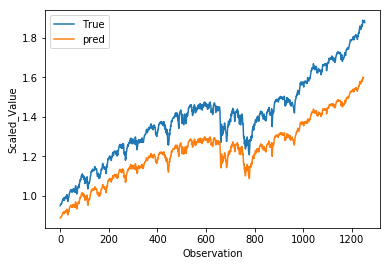

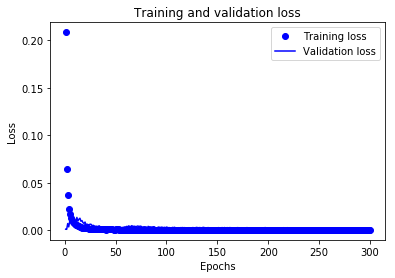

RUA_de5_tcn_clf9_n32_pex_4:
(1254,)
The Adjusted R2 score on the Test set is:	0.310
The Custom  sign score on the Test set is:	0.508
The Custom  R2 score on the Test set is:	0.409
Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_10[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_

5667/5667==============================] - 2s 300us/sample - loss: 6.4652e-04 - val_loss: 0.0011 - ETA: 1s - loss: 1.7509e - ETA: 0s - los - ETA: 0s - loss: 5.8726e-
Epoch 69/300
5667/5667==============================] - 2s 302us/sample - loss: 5.9859e-04 - val_loss: 0.0012- ETA: 0s - loss:  - ETA: 0s - loss: 5.7685e-0
Epoch 70/300
5667/5667==============================] - 2s 303us/sample - loss: 5.8127e-04 - val_loss: 0.0011
Epoch 71/300
5667/5667==============================] - 2s 301us/sample - loss: 6.0819e-04 - val_loss: 0.0014 - ETA: 0s - loss: 4.232
Epoch 72/300
5667/5667==============================] - 2s 303us/sample - loss: 5.7826e-04 - val_loss: 0.0013- ETA: 
Epoch 73/300
5667/5667==============================] - 2s 303us/sample - loss: 6.4899e-04 - val_loss: 0.0015
Epoch 74/300
5667/5667==============================] - 2s 299us/sample - loss: 5.9876e-04 - val_loss: 0.0014
Epoch 75/300
5667/5667==============================] - 2s 305us/sample - loss: 5.9363e-04 - val_

5667/5667==============================] - 2s 298us/sample - loss: 5.4403e-04 - val_loss: 0.0034- ETA: 0s - loss: 5.2610e-0
Epoch 192/300
5667/5667==============================] - 2s 300us/sample - loss: 5.3614e-04 - val_loss: 0.0031 0s - loss: 3.6080e - ETA: 0s - loss: 3.465
Epoch 193/300
5667/5667==============================] - 2s 302us/sample - loss: 5.3789e-04 - val_loss: 0.0031: 5.2099e-0
Epoch 194/300
5667/5667==============================] - 2s 303us/sample - loss: 5.2929e-04 - val_loss: 0.0031
Epoch 195/300
5667/5667==============================] - 2s 302us/sample - loss: 5.2743e-04 - val_loss: 0.0028s - loss: 3.7303e - ETA: 0s - loss: 3.6395e-0 - ETA: 0s - loss: 3.9027e
Epoch 196/300
5667/5667==============================] - 2s 305us/sample - loss: 4.9384e-04 - val_loss: 0.0034TA: 1s - loss: 5.4056e-0 - ETA: 0s - loss: 6.2009e- - ETA: 0s - l
Epoch 197/300
5667/5667==============================] - 2s 299us/sample - loss: 5.1920e-04 - val_loss: 0.0033s: 4.8162e-0 - ETA: 0

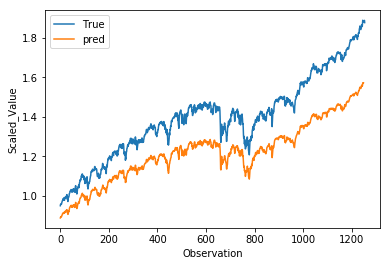

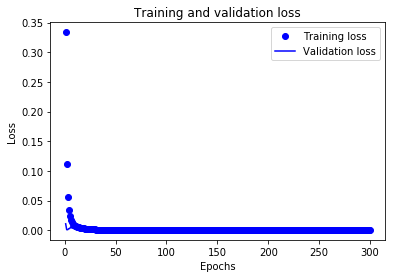

RUA_de5_tcn_clf9_n32_pex_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.205
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.353
Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_11[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation

5667/5667==============================] - 2s 302us/sample - loss: 6.8130e-04 - val_loss: 0.00270s - loss: 4
Epoch 64/300
5667/5667==============================] - 2s 308us/sample - loss: 6.7294e-04 - val_loss: 0.0031: 0s - loss: 4.
Epoch 65/300
5667/5667==============================] - 2s 307us/sample - loss: 6.8083e-04 - val_loss: 0.0026
Epoch 66/300
5667/5667==============================] - 2s 297us/sample - loss: 6.7257e-04 - val_loss: 0.0029
Epoch 67/300
5667/5667==============================] - 2s 302us/sample - loss: 7.1567e-04 - val_loss: 0.0029TA: 1s - loss: 1 - ETA: 0s - loss: 2.854 - ETA: 0s - loss: 4.4
Epoch 68/300
5667/5667==============================] - 2s 292us/sample - loss: 6.4016e-04 - val_loss: 0.0034TA: 0s - loss: 4.144 - ETA: 0s - loss: 4.42
Epoch 69/300
5667/5667==============================] - 2s 294us/sample - loss: 6.5936e-04 - val_loss: 0.0033 - ETA: 1s -  - ETA: 0s - loss: 4.659
Epoch 70/300
5667/5667==============================] - 2s 294us/sample - 

5667/5667==============================] - 2s 293us/sample - loss: 4.9135e-04 - val_loss: 0.0025 - ETA: 1s - loss: 6.2929e- - ETA: 1s - loss: 5.4 - ETA: 0s - loss: 1.622 - ETA: 0s - loss: 3.7132e-0 - ETA: 0s - loss: 3.7
Epoch 182/300
5667/5667==============================] - 2s 293us/sample - loss: 4.9352e-04 - val_loss: 0.0024- loss: - ETA: 0s - loss: 4.8312e-0
Epoch 183/300
5667/5667==============================] - 2s 297us/sample - loss: 4.9033e-04 - val_loss: 0.0024
Epoch 184/300
5667/5667==============================] - 2s 294us/sample - loss: 4.8041e-04 - val_loss: 0.0025- ETA: 0s - loss: 3.4291e- - ETA: 0s - loss: 3.7685e
Epoch 185/300
5667/5667==============================] - 2s 296us/sample - loss: 4.8264e-04 - val_loss: 0.0025
Epoch 186/300
5667/5667==============================] - 2s 291us/sample - loss: 4.8224e-04 - val_loss: 0.0024A: 0s - loss: 1.08 - ETA: 0s - loss: 3.
Epoch 187/300
5667/5667==============================] - 2s 295us/sample - loss: 4.8772e-04 - val_l

5667/5667==============================] - 2s 299us/sample - loss: 4.5144e-04 - val_loss: 0.0017
Epoch 298/300
5667/5667==============================] - 2s 291us/sample - loss: 4.4905e-04 - val_loss: 0.0017ETA: 1s - loss: 3.8261 - ETA: 0s - loss: 1.28 - ETA: 0s - loss: 3.3612 - ETA: 0s - loss: 3.4151
Epoch 299/300
5667/5667==============================] - 2s 291us/sample - loss: 4.4900e-04 - val_loss: 0.0016: 3.3245e- - ETA: 0s - loss: 4.4666e-0
Epoch 300/300
5667/5667==============================] - 2s 294us/sample - loss: 4.5284e-04 - val_loss: 0.00161s - loss: 3.8 - ETA: 0s - loss: 
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.494498
The Adjusted R2 score on the Test set is:	0.492


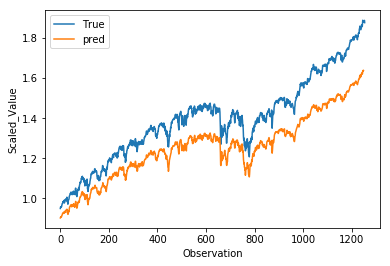

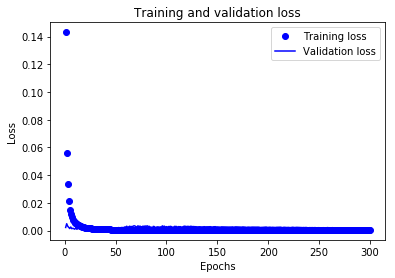

RUA_de5_tcn_clf9_n32_pex_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.492
The Custom  sign score on the Test set is:	0.507
The Custom  R2 score on the Test set is:	0.500
Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_12[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation

5667/5667==============================] - 2s 301us/sample - loss: 5.7917e-04 - val_loss: 0.0023TA: 0s - loss: 1.7756e-0 - ETA: 0s - lo
Epoch 64/300
5667/5667==============================] - 2s 305us/sample - loss: 5.6441e-04 - val_loss: 0.0026 loss: 3.88
Epoch 65/300
5667/5667==============================] - 2s 302us/sample - loss: 6.0229e-04 - val_loss: 0.0017oss: 3.8996e- - ETA: 0s - loss: 4.2
Epoch 66/300
5667/5667==============================] - 2s 302us/sample - loss: 5.7954e-04 - val_loss: 0.0026
Epoch 67/300
5667/5667==============================] - 2s 303us/sample - loss: 5.8410e-04 - val_loss: 0.00200s - los
Epoch 68/300
5667/5667==============================] - 2s 305us/sample - loss: 5.6471e-04 - val_loss: 0.0020 ETA: 1s - lo - ETA: 0s - loss: 3.
Epoch 69/300
5667/5667==============================] - 2s 305us/sample - loss: 5.4837e-04 - val_loss: 0.0024
Epoch 70/300
5667/5667==============================] - 2s 302us/sample - loss: 5.6595e-04 - val_loss: 0.0028 - ETA:

5667/5667==============================] - 2s 306us/sample - loss: 4.4707e-04 - val_loss: 0.0020- ETA: 0s - loss: 
Epoch 182/300
5667/5667==============================] - ETA: 0s - loss: 4.4411e-04- ETA: - 2s 309us/sample - loss: 4.5003e-04 - val_loss: 0.0022
Epoch 183/300
5667/5667==============================] - 2s 300us/sample - loss: 4.4863e-04 - val_loss: 0.0020 0s - loss: 8 - ETA: 0s - loss: 3.2027e-0 - ETA: 0s - loss: 3.1663e-0 - ETA: 0s - loss: 3.2649e
Epoch 184/300
5667/5667==============================] - 2s 312us/sample - loss: 4.4549e-04 - val_loss: 0.0020
Epoch 185/300
5667/5667==============================] - 2s 308us/sample - loss: 4.4032e-04 - val_loss: 0.0020
Epoch 186/300
5667/5667==============================] - 2s 303us/sample - loss: 4.4002e-04 - val_loss: 0.0021 loss: 3.1584e- - ETA: 0s - loss: 4.3169e-
Epoch 187/300
5667/5667==============================] - 2s 305us/sample - loss: 4.4284e-04 - val_loss: 0.0020 ETA: 0s - loss: 7.5363e- - ETA: 0s - loss: 1.66

5667/5667==============================] - 2s 305us/sample - loss: 4.1708e-04 - val_loss: 0.0016 0s -
Epoch 297/300
5667/5667==============================] - 2s 308us/sample - loss: 4.2233e-04 - val_loss: 0.0016- ETA: 1s - loss: 2.9637 - ETA: 0s - loss:  - ETA: 0s - loss: 3.0419
Epoch 298/300
5667/5667==============================] - 2s 308us/sample - loss: 4.2275e-04 - val_loss: 0.0015 ETA: 0s - 
Epoch 299/300
5667/5667==============================] - 2s 307us/sample - loss: 4.2675e-04 - val_loss: 0.0015
Epoch 300/300
5667/5667==============================] - 2s 307us/sample - loss: 4.2117e-04 - val_loss: 0.0016 - ETA: 1s - l - ETA: 0s - loss: 3.
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.395365
The Adjusted R2 score on the Test set is:	0.393


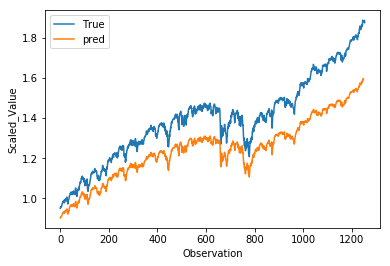

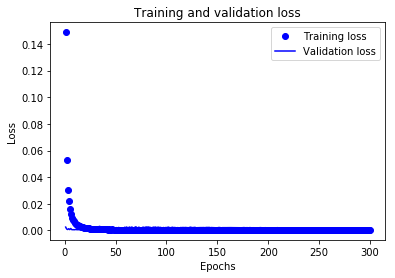

RUA_de5_tcn_clf9_n32_pex_7:
(1254,)
The Adjusted R2 score on the Test set is:	0.393
The Custom  sign score on the Test set is:	0.507
The Custom  R2 score on the Test set is:	0.450
Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_13[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation

5667/5667==============================] - 2s 308us/sample - loss: 8.0288e-04 - val_loss: 0.0042
Epoch 69/300
5667/5667==============================] - 2s 311us/sample - loss: 7.9526e-04 - val_loss: 0.0033 loss
Epoch 70/300
5667/5667==============================] - 2s 304us/sample - loss: 8.7831e-04 - val_loss: 0.0037TA: 0s - l
Epoch 71/300
5667/5667==============================] - 2s 303us/sample - loss: 7.6202e-04 - val_loss: 0.0039 - ETA: 1s - loss: 2.6356e - ETA: 0s - loss: 2.7236e - ETA: 0s - loss: 3. - ETA: 0s - loss: 5.6107e - ETA: 0s - loss: 7.1610e-
Epoch 72/300
5667/5667==============================] - 2s 307us/sample - loss: 6.8467e-04 - val_loss: 0.0037 - ETA: 1s - loss: 2.0 - ETA: 0s - loss: 1.9758e-0 - ETA: 0s - loss: 2.3667e-0 - ETA: 0s - loss: 2.7 - ETA: 0s - loss: 4.8
Epoch 73/300
5667/5667==============================] - 2s 308us/sample - loss: 7.7472e-04 - val_loss: 0.0039
Epoch 74/300
5667/5667==============================] - 2s 308us/sample - loss: 7.9026e-04

5667/5667==============================] - 2s 305us/sample - loss: 4.7541e-04 - val_loss: 0.0027 ETA: 1s - loss: 8.27 - ETA: 0s - loss: 8.5921e- - ETA: 0s - loss: 1.5371e- - ETA: 0s - loss: 2.7148e- - ETA: 0s - loss: 3.1606 - ETA: 0s - loss: 3.232 - ETA: 0s - loss: 4.6711e-0
Epoch 187/300
5667/5667==============================] - 2s 306us/sample - loss: 4.6574e-04 - val_loss: 0.0027
Epoch 188/300
5667/5667==============================] - 2s 307us/sample - loss: 4.8908e-04 - val_loss: 0.0027- ETA: 1s - loss: 8.4493e-0 - ETA: 1s - loss: 7.938 - ETA: 0s - loss: 1.6831e-0 - ETA: 0s - loss: 2. - ETA: 0s - loss: 3.4169e-0 - ETA: 0s - loss: 3.6092
Epoch 189/300
5667/5667==============================] - 2s 305us/sample - loss: 4.8251e-04 - val_loss: 0.0028- ETA:
Epoch 190/300
5667/5667==============================] - 2s 305us/sample - loss: 4.8615e-04 - val_loss: 0.0027- ETA: 0s - loss:
Epoch 191/300
5667/5667==============================] - 2s 310us/sample - loss: 4.8586e-04 - val_loss: 

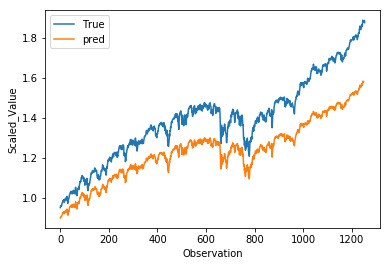

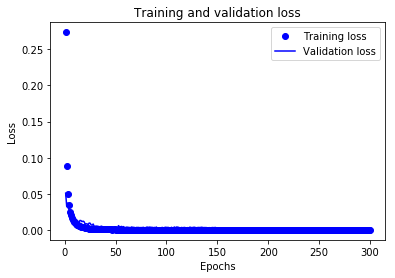

RUA_de5_tcn_clf9_n32_pex_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.311
The Custom  sign score on the Test set is:	0.510
The Custom  R2 score on the Test set is:	0.410
Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 32)        192         input_14[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 32)        2080        tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation

5667/5667==============================] - 2s 307us/sample - loss: 6.5602e-04 - val_loss: 0.0035 ETA: 0s - loss
Epoch 68/300
5667/5667==============================] - 2s 309us/sample - loss: 6.3560e-04 - val_loss: 0.0032 0s - loss: 1.7206e-0 - ETA: 0s - loss: - ETA: 0s - loss: 4.6719e
Epoch 69/300
5667/5667==============================] - 2s 309us/sample - loss: 6.5914e-04 - val_loss: 0.00261s - loss: - ETA: 0s - loss: 4.1718 - ETA: 0s - loss: 4.9631e
Epoch 70/300
5667/5667==============================] - 2s 308us/sample - loss: 6.4455e-04 - val_loss: 0.0031TA: 0s - loss:
Epoch 71/300
5667/5667==============================] - 2s 308us/sample - loss: 6.1691e-04 - val_loss: 0.00360s - loss: 4.0
Epoch 72/300
5667/5667==============================] - 2s 312us/sample - loss: 6.2714e-04 - val_loss: 0.0027
Epoch 73/300
5667/5667==============================] - 2s 309us/sample - loss: 5.9219e-04 - val_loss: 0.0030ETA: 1s - loss: 1.5325e-0 - ETA: 1s - loss: 1.4640e-0 - ETA: 0s - lo - ETA:

5667/5667==============================] - 2s 314us/sample - loss: 4.8537e-04 - val_loss: 0.0029
Epoch 126/300
5667/5667==============================] - 2s 309us/sample - loss: 5.1244e-04 - val_loss: 0.0030 - ETA: 0s - loss: 1.1240e-0 - ETA: 0s - loss: 1.5224e - ETA: 0s - loss: 3.0590e- - ETA: 0s - loss: 3
Epoch 127/300
5667/5667==============================] - 2s 306us/sample - loss: 5.1144e-04 - val_loss: 0.0029- ETA: 1s - loss: 6.3145e - ETA: 1s - loss: 5. - ETA: 0s - loss: 2.9320 - ETA: 0s - loss: 3.4
Epoch 128/300
5667/5667==============================] - 2s 306us/sample - loss: 4.9700e-04 - val_loss: 0.0027 ETA: 0s - loss: 4.7924e-0
Epoch 129/300
5667/5667==============================] - 2s 314us/sample - loss: 5.0145e-04 - val_loss: 0.00300s - loss: 2. - ETA: 0s - loss: 3.244
Epoch 130/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0351e-04 - val_loss: 0.0029
Epoch 131/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0841e-04

5667/5667==============================] - 2s 312us/sample - loss: 4.6567e-04 - val_loss: 0.0022
Epoch 241/300
5667/5667==============================] - 2s 306us/sample - loss: 4.6680e-04 - val_loss: 0.0022- ETA: 1s - ETA: 0s - loss: 4.5950e-0
Epoch 242/300
5667/5667==============================] - 2s 305us/sample - loss: 4.6594e-04 - val_loss: 0.0021
Epoch 243/300
5667/5667==============================] - 2s 313us/sample - loss: 4.4916e-04 - val_loss: 0.0022
Epoch 244/300
5667/5667==============================] - 2s 311us/sample - loss: 4.6146e-04 - val_loss: 0.0022- loss: 3.32
Epoch 245/300
5667/5667==============================] - 2s 307us/sample - loss: 4.5841e-04 - val_loss: 0.0022s - loss: 8.9 - ETA: 0s - loss: 3.30 - ETA: 0s - loss: 4.5111e-
Epoch 246/300
5667/5667==============================] - 2s 310us/sample - loss: 4.6773e-04 - val_loss: 0.0021
Epoch 247/300
5667/5667==============================] - 2s 311us/sample - loss: 4.6115e-04 - val_loss: 0.0021 0s - loss: 4.8

Epoch 298/300
5667/5667==============================] - 2s 307us/sample - loss: 4.3815e-04 - val_loss: 0.0018: 0s - loss: 3.
Epoch 299/300
5667/5667==============================] - 2s 310us/sample - loss: 4.4775e-04 - val_loss: 0.0019
Epoch 300/300
5667/5667==============================] - 2s 311us/sample - loss: 4.4610e-04 - val_loss: 0.0019 - ETA: 1s - loss: 3.5404e-0 - ETA: 1s -  - ETA: 0s - loss: 3.1651e-0 - ETA: 0s - loss: 3.3757e
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.427042
The Adjusted R2 score on the Test set is:	0.425


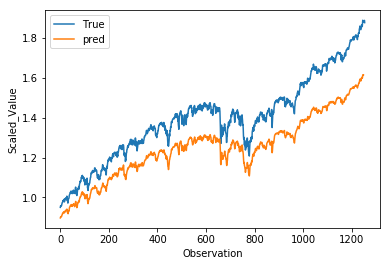

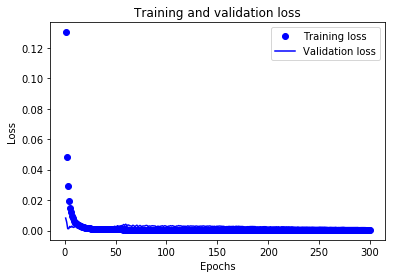

RUA_de5_tcn_clf9_n32_pex_9:
(1254,)
The Adjusted R2 score on the Test set is:	0.425
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.460


In [40]:
neurons=[32]
penalties=['x']
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_1[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation (Activation)         (None, 1, 128)       0           tcn_d_causal_conv_1_tanh_s0[0][0]
______________________________________________________________________________________________

5667/5667==============================] - 2s 289us/sample - loss: 4.9417e-04 - val_loss: 0.0011
Epoch 82/300
5667/5667==============================] - 2s 286us/sample - loss: 4.9053e-04 - val_loss: 0.0013
Epoch 83/300
5667/5667==============================] - 2s 287us/sample - loss: 4.7972e-04 - val_loss: 0.0012
Epoch 84/300
5667/5667==============================] - 2s 280us/sample - loss: 5.0289e-04 - val_loss: 0.0014
Epoch 85/300
5667/5667==============================] - 2s 285us/sample - loss: 4.9745e-04 - val_loss: 0.0012
Epoch 86/300
5667/5667==============================] - 2s 282us/sample - loss: 5.4854e-04 - val_loss: 0.0011
Epoch 87/300
5667/5667==============================] - 2s 290us/sample - loss: 5.1626e-04 - val_loss: 0.0015
Epoch 88/300
5667/5667==============================] - 2s 292us/sample - loss: 5.2150e-04 - val_loss: 0.0015
Epoch 89/300
5667/5667==============================] - 2s 294us/sample - loss: 5.1609e-04 - val_loss: 0.0012
Epoch 90/300
5667/5667=

Epoch 155/300
5667/5667==============================] - 2s 282us/sample - loss: 5.3635e-04 - val_loss: 0.0050
Epoch 156/300
5667/5667==============================] - 2s 286us/sample - loss: 5.4013e-04 - val_loss: 0.0044
Epoch 157/300
5667/5667==============================] - 2s 283us/sample - loss: 5.7406e-04 - val_loss: 0.0057
Epoch 158/300
5667/5667==============================] - 2s 283us/sample - loss: 5.9282e-04 - val_loss: 0.0048
Epoch 159/300
5667/5667==============================] - 2s 283us/sample - loss: 5.6094e-04 - val_loss: 0.0050
Epoch 160/300
5667/5667==============================] - 2s 286us/sample - loss: 5.7055e-04 - val_loss: 0.0054
Epoch 161/300
5667/5667==============================] - 2s 283us/sample - loss: 5.9640e-04 - val_loss: 0.0048
Epoch 162/300
5667/5667==============================] - 2s 287us/sample - loss: 5.9246e-04 - val_loss: 0.0052
Epoch 163/300
5667/5667==============================] - 2s 285us/sample - loss: 5.9421e-04 - val_loss: 0.0054
E

5667/5667==============================] - 2s 287us/sample - loss: 5.2025e-04 - val_loss: 0.0036
Epoch 229/300
5667/5667==============================] - 2s 284us/sample - loss: 5.1559e-04 - val_loss: 0.0032
Epoch 230/300
5667/5667==============================] - 2s 286us/sample - loss: 4.8529e-04 - val_loss: 0.0030
Epoch 231/300
5667/5667==============================] - 2s 285us/sample - loss: 5.3798e-04 - val_loss: 0.0034
Epoch 232/300
5667/5667==============================] - 2s 285us/sample - loss: 5.3346e-04 - val_loss: 0.0034
Epoch 233/300
5667/5667==============================] - 2s 285us/sample - loss: 5.0585e-04 - val_loss: 0.0027
Epoch 234/300
5667/5667==============================] - 2s 288us/sample - loss: 5.2200e-04 - val_loss: 0.0031
Epoch 235/300
5667/5667==============================] - 2s 293us/sample - loss: 4.9416e-04 - val_loss: 0.0034
Epoch 236/300
5667/5667==============================] - 2s 294us/sample - loss: 4.9751e-04 - val_loss: 0.0036
Epoch 237/300
5

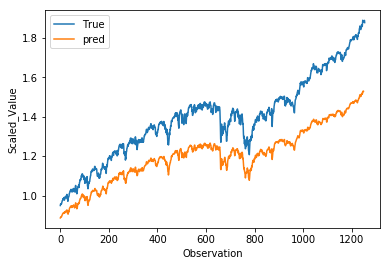

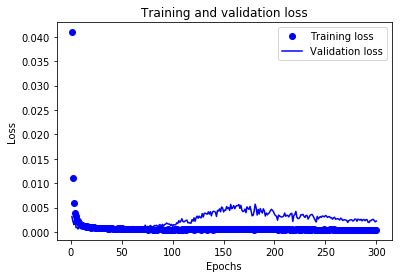

RUA_de5_tcn_clf9_n128_pe0.01_0:
(1254,)
The Adjusted R2 score on the Test set is:	0.047
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.271
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_2[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0023 - val_loss: 8.9381e-04
Epoch 9/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0019 - val_loss: 5.9544e-04
Epoch 10/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0018 - val_loss: 0.0021
Epoch 11/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0017 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0014 - val_loss: 6.7874e-04
Epoch 13/300
5667/5667==============================] - 2s 280us/sample - loss: 0.0013 - val_loss: 0.0012
Epoch 14/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0012 - val_loss: 0.0012
Epoch 15/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0013 - val_loss: 8.3420e-04
Epoch 16/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0013 - val_loss: 0.0010
Epoch 17/300
5667/5667==========

Epoch 81/300
5667/5667==============================] - 2s 283us/sample - loss: 5.2871e-04 - val_loss: 0.0011
Epoch 82/300
5667/5667==============================] - 2s 284us/sample - loss: 4.9229e-04 - val_loss: 0.0012
Epoch 83/300
5667/5667==============================] - 2s 280us/sample - loss: 5.3261e-04 - val_loss: 9.2398e-04
Epoch 84/300
5667/5667==============================] - 2s 282us/sample - loss: 4.9780e-04 - val_loss: 0.0012
Epoch 85/300
5667/5667==============================] - 2s 289us/sample - loss: 4.8618e-04 - val_loss: 9.6437e-04
Epoch 86/300
5667/5667==============================] - 2s 283us/sample - loss: 4.9017e-04 - val_loss: 0.0010
Epoch 87/300
5667/5667==============================] - 2s 281us/sample - loss: 5.0121e-04 - val_loss: 0.0012
Epoch 88/300
5667/5667==============================] - 2s 283us/sample - loss: 4.8879e-04 - val_loss: 0.0013
Epoch 89/300
5667/5667==============================] - 2s 275us/sample - loss: 5.2254e-04 - val_loss: 9.7332e-0

5667/5667==============================] - 2s 291us/sample - loss: 5.1367e-04 - val_loss: 0.0041
Epoch 228/300
5667/5667==============================] - 2s 290us/sample - loss: 5.5261e-04 - val_loss: 0.0040
Epoch 229/300
5667/5667==============================] - 2s 293us/sample - loss: 5.4106e-04 - val_loss: 0.0030
Epoch 230/300
5667/5667==============================] - 2s 281us/sample - loss: 5.5998e-04 - val_loss: 0.0033
Epoch 231/300
5667/5667==============================] - 2s 282us/sample - loss: 5.0814e-04 - val_loss: 0.0037
Epoch 232/300
5667/5667==============================] - 2s 287us/sample - loss: 5.2800e-04 - val_loss: 0.0029
Epoch 233/300
5667/5667==============================] - 2s 280us/sample - loss: 5.2452e-04 - val_loss: 0.0034
Epoch 234/300
5667/5667==============================] - 2s 283us/sample - loss: 5.2025e-04 - val_loss: 0.0032
Epoch 235/300
5667/5667==============================] - 2s 286us/sample - loss: 4.8658e-04 - val_loss: 0.0034
Epoch 236/300
5

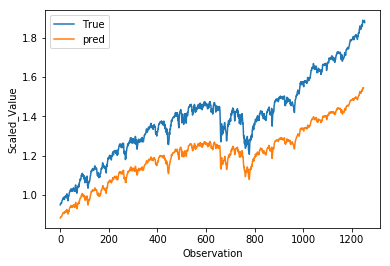

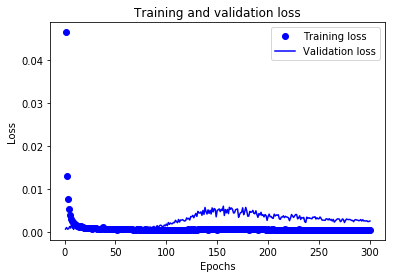

RUA_de5_tcn_clf9_n128_pe0.01_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.101
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.299
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_3[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0020 - val_loss: 7.5967e-04
Epoch 9/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0019 - val_loss: 0.0016
Epoch 10/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0016 - val_loss: 8.2168e-04
Epoch 11/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0014 - val_loss: 8.0460e-04
Epoch 12/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0014 - val_loss: 0.0011
Epoch 13/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0013 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0011 - val_loss: 8.6270e-04
Epoch 15/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0011 - val_loss: 7.7411e-04
Epoch 16/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0011 - val_loss: 8.3086e-04
Epoch 17/300
5667/5667==

5667/5667==============================] - 2s 286us/sample - loss: 6.1471e-04 - val_loss: 0.0058
Epoch 154/300
5667/5667==============================] - 2s 283us/sample - loss: 6.0970e-04 - val_loss: 0.0056
Epoch 155/300
5667/5667==============================] - 2s 283us/sample - loss: 6.2055e-04 - val_loss: 0.0041
Epoch 156/300
5667/5667==============================] - 2s 286us/sample - loss: 6.3147e-04 - val_loss: 0.0055
Epoch 157/300
5667/5667==============================] - 2s 286us/sample - loss: 6.4137e-04 - val_loss: 0.0058
Epoch 158/300
5667/5667==============================] - 2s 288us/sample - loss: 6.4652e-04 - val_loss: 0.0051
Epoch 159/300
5667/5667==============================] - 2s 284us/sample - loss: 6.3724e-04 - val_loss: 0.0057
Epoch 160/300
5667/5667==============================] - 2s 288us/sample - loss: 6.3492e-04 - val_loss: 0.0054
Epoch 161/300
5667/5667==============================] - 2s 286us/sample - loss: 5.9001e-04 - val_loss: 0.0052
Epoch 162/300
5

Epoch 300/300
5667/5667==============================] - 2s 288us/sample - loss: 4.8109e-04 - val_loss: 0.0025
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.017430
The Adjusted R2 score on the Test set is:	-0.022


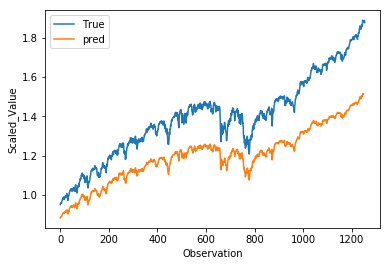

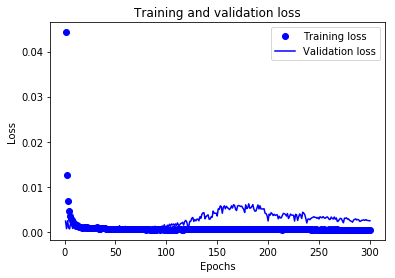

RUA_de5_tcn_clf9_n128_pe0.01_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.022
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.238
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_4[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

Epoch 8/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0020 - val_loss: 0.0011
Epoch 9/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0018 - val_loss: 0.0020
Epoch 10/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0015 - val_loss: 0.0014
Epoch 11/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0014 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0015 - val_loss: 0.0010
Epoch 13/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0012 - val_loss: 0.0013
Epoch 14/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0011 - val_loss: 8.3270e-04
Epoch 15/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0010 - val_loss: 9.7627e-04
Epoch 16/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0011 - val_loss: 0.0011
Epoch 17/300
5667/5667==================

5667/5667==============================] - 2s 305us/sample - loss: 6.3881e-04 - val_loss: 0.0049
Epoch 155/300
5667/5667==============================] - 2s 303us/sample - loss: 6.2497e-04 - val_loss: 0.0054
Epoch 156/300
5667/5667==============================] - 2s 302us/sample - loss: 6.0455e-04 - val_loss: 0.0050
Epoch 157/300
5667/5667==============================] - 2s 302us/sample - loss: 6.1087e-04 - val_loss: 0.0051
Epoch 158/300
5667/5667==============================] - 2s 301us/sample - loss: 6.5863e-04 - val_loss: 0.0050
Epoch 159/300
5667/5667==============================] - 2s 303us/sample - loss: 6.6799e-04 - val_loss: 0.0044
Epoch 160/300
5667/5667==============================] - 2s 300us/sample - loss: 6.3975e-04 - val_loss: 0.0041
Epoch 161/300
5667/5667==============================] - 2s 302us/sample - loss: 6.1524e-04 - val_loss: 0.0052
Epoch 162/300
5667/5667==============================] - 2s 301us/sample - loss: 5.6157e-04 - val_loss: 0.0050
Epoch 163/300
5

Epoch 228/300
5667/5667==============================] - 2s 304us/sample - loss: 5.6834e-04 - val_loss: 0.0036
Epoch 229/300
5667/5667==============================] - 2s 307us/sample - loss: 5.6484e-04 - val_loss: 0.0035
Epoch 230/300
5667/5667==============================] - 2s 303us/sample - loss: 5.5794e-04 - val_loss: 0.0033
Epoch 231/300
5667/5667==============================] - 2s 304us/sample - loss: 5.7198e-04 - val_loss: 0.0037
Epoch 232/300
5667/5667==============================] - 2s 305us/sample - loss: 5.6208e-04 - val_loss: 0.0038
Epoch 233/300
5667/5667==============================] - 2s 303us/sample - loss: 5.3658e-04 - val_loss: 0.0037
Epoch 234/300
5667/5667==============================] - 2s 303us/sample - loss: 5.2046e-04 - val_loss: 0.0037
Epoch 235/300
5667/5667==============================] - 2s 305us/sample - loss: 5.6828e-04 - val_loss: 0.0040
Epoch 236/300
5667/5667==============================] - 2s 301us/sample - loss: 5.4813e-04 - val_loss: 0.0036
E

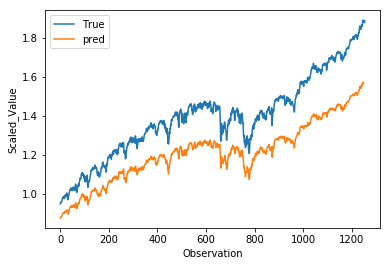

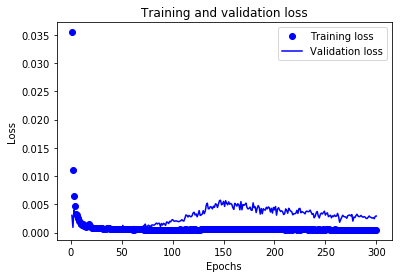

RUA_de5_tcn_clf9_n128_pe0.01_3:
(1254,)
The Adjusted R2 score on the Test set is:	0.137
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.316
Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_5[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 284us/sample - loss: 0.0024 - val_loss: 6.4578e-04
Epoch 9/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0023 - val_loss: 8.2174e-04
Epoch 10/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0021 - val_loss: 9.8332e-04
Epoch 11/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0018 - val_loss: 6.6699e-04
Epoch 12/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0016 - val_loss: 6.3225e-04
Epoch 13/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0013 - val_loss: 6.7282e-04
Epoch 14/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0014 - val_loss: 6.5857e-04
Epoch 15/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0014 - val_loss: 6.3685e-04
Epoch 16/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0013 - val_loss: 7.3689e-04
Epoch 17/300

5667/5667==============================] - 2s 283us/sample - loss: 5.3978e-04 - val_loss: 0.0037
Epoch 154/300
5667/5667==============================] - 2s 291us/sample - loss: 5.8444e-04 - val_loss: 0.0034
Epoch 155/300
5667/5667==============================] - 2s 295us/sample - loss: 5.7433e-04 - val_loss: 0.0037
Epoch 156/300
5667/5667==============================] - 2s 287us/sample - loss: 5.6938e-04 - val_loss: 0.0029
Epoch 157/300
5667/5667==============================] - 2s 288us/sample - loss: 5.7910e-04 - val_loss: 0.0044
Epoch 158/300
5667/5667==============================] - 2s 285us/sample - loss: 5.5822e-04 - val_loss: 0.0039
Epoch 159/300
5667/5667==============================] - 2s 288us/sample - loss: 5.9292e-04 - val_loss: 0.0040
Epoch 160/300
5667/5667==============================] - 2s 292us/sample - loss: 6.2300e-04 - val_loss: 0.0042
Epoch 161/300
5667/5667==============================] - 2s 282us/sample - loss: 6.0095e-04 - val_loss: 0.0044
Epoch 162/300
5

Epoch 227/300
5667/5667==============================] - 2s 288us/sample - loss: 5.9135e-04 - val_loss: 0.0043
Epoch 228/300
5667/5667==============================] - 2s 291us/sample - loss: 5.7371e-04 - val_loss: 0.0044
Epoch 229/300
5667/5667==============================] - 2s 293us/sample - loss: 6.1141e-04 - val_loss: 0.0045
Epoch 230/300
5667/5667==============================] - 2s 284us/sample - loss: 6.2136e-04 - val_loss: 0.0040
Epoch 231/300
5667/5667==============================] - 2s 284us/sample - loss: 6.0125e-04 - val_loss: 0.0042
Epoch 232/300
5667/5667==============================] - 2s 289us/sample - loss: 5.7429e-04 - val_loss: 0.0045
Epoch 233/300
5667/5667==============================] - 2s 289us/sample - loss: 5.9625e-04 - val_loss: 0.0046
Epoch 234/300
5667/5667==============================] - 2s 284us/sample - loss: 5.2713e-04 - val_loss: 0.0031
Epoch 235/300
5667/5667==============================] - 2s 286us/sample - loss: 5.4939e-04 - val_loss: 0.0034
E

y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.269052
The Adjusted R2 score on the Test set is:	-0.274


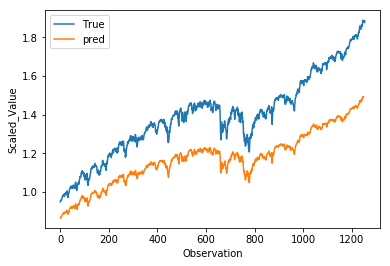

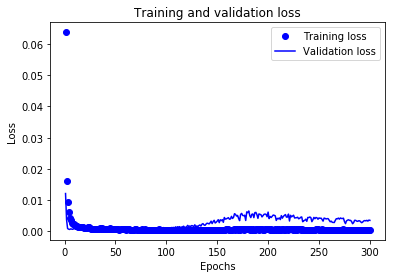

RUA_de5_tcn_clf9_n128_pe0.01_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.274
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.112
Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_6[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

Epoch 8/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0023 - val_loss: 9.5304e-04
Epoch 9/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0020 - val_loss: 7.1096e-04
Epoch 10/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0018 - val_loss: 6.2992e-04
Epoch 11/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0018 - val_loss: 0.0027
Epoch 12/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0016 - val_loss: 0.0011
Epoch 13/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0015 - val_loss: 0.0010
Epoch 14/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0015 - val_loss: 0.0011
Epoch 15/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0014 - val_loss: 0.0018
Epoch 16/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0012 - val_loss: 0.0015
Epoch 17/300
5667/5667==============

Epoch 81/300
5667/5667==============================] - 2s 306us/sample - loss: 5.2856e-04 - val_loss: 8.5021e-04
Epoch 82/300
5667/5667==============================] - 2s 307us/sample - loss: 5.1319e-04 - val_loss: 7.3854e-04
Epoch 83/300
5667/5667==============================] - 2s 303us/sample - loss: 4.8796e-04 - val_loss: 0.0010
Epoch 84/300
5667/5667==============================] - 2s 308us/sample - loss: 5.0337e-04 - val_loss: 8.4576e-04
Epoch 85/300
5667/5667==============================] - 2s 306us/sample - loss: 5.0069e-04 - val_loss: 0.0010
Epoch 86/300
5667/5667==============================] - 2s 307us/sample - loss: 5.4546e-04 - val_loss: 9.5863e-04
Epoch 87/300
5667/5667==============================] - 2s 306us/sample - loss: 5.3288e-04 - val_loss: 9.3670e-04
Epoch 88/300
5667/5667==============================] - 2s 304us/sample - loss: 5.5440e-04 - val_loss: 0.0011
Epoch 89/300
5667/5667==============================] - 2s 306us/sample - loss: 5.3877e-04 - val_los

Epoch 155/300
5667/5667==============================] - 2s 302us/sample - loss: 6.4638e-04 - val_loss: 0.0039
Epoch 156/300
5667/5667==============================] - 2s 307us/sample - loss: 6.2924e-04 - val_loss: 0.0050
Epoch 157/300
5667/5667==============================] - 2s 305us/sample - loss: 5.9504e-04 - val_loss: 0.0057
Epoch 158/300
5667/5667==============================] - 2s 306us/sample - loss: 6.6559e-04 - val_loss: 0.0051
Epoch 159/300
5667/5667==============================] - 2s 308us/sample - loss: 6.2767e-04 - val_loss: 0.0050
Epoch 160/300
5667/5667==============================] - 2s 308us/sample - loss: 5.9335e-04 - val_loss: 0.0051
Epoch 161/300
5667/5667==============================] - 2s 307us/sample - loss: 6.0153e-04 - val_loss: 0.0048
Epoch 162/300
5667/5667==============================] - 2s 306us/sample - loss: 5.8778e-04 - val_loss: 0.0052
Epoch 163/300
5667/5667==============================] - 2s 302us/sample - loss: 6.6771e-04 - val_loss: 0.0037
E

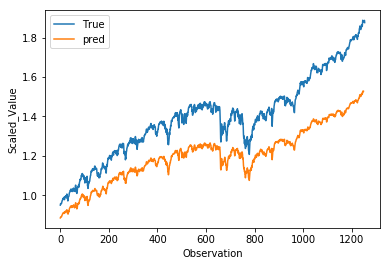

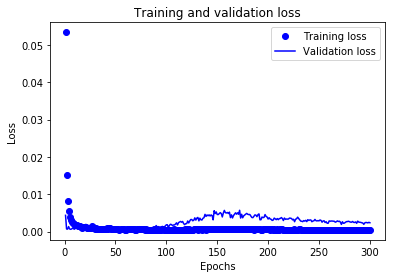

RUA_de5_tcn_clf9_n128_pe0.01_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.041
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.269
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_7[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 80/300
5667/5667==============================] - 2s 309us/sample - loss: 5.7147e-04 - val_loss: 0.0011
Epoch 81/300
5667/5667==============================] - 2s 306us/sample - loss: 5.7579e-04 - val_loss: 9.8567e-04
Epoch 82/300
5667/5667==============================] - 2s 308us/sample - loss: 5.4318e-04 - val_loss: 9.1139e-04
Epoch 83/300
5667/5667==============================] - 2s 308us/sample - loss: 5.3615e-04 - val_loss: 9.6919e-04
Epoch 84/300
5667/5667==============================] - 2s 309us/sample - loss: 5.3767e-04 - val_loss: 8.8306e-04
Epoch 85/300
5667/5667==============================] - 2s 309us/sample - loss: 5.1914e-04 - val_loss: 0.0011
Epoch 86/300
5667/5667==============================] - 2s 307us/sample - loss: 5.5367e-04 - val_loss: 8.4169e-04
Epoch 87/300
5667/5667==============================] - 2s 309us/sample - loss: 5.2296e-04 - val_loss: 0.0010
Epoch 88/300
5667/5667==============================] - 2s 309us/sample - loss: 5.3124e-04 - val_los

Epoch 227/300
5667/5667==============================] - 2s 307us/sample - loss: 5.9358e-04 - val_loss: 0.0033
Epoch 228/300
5667/5667==============================] - 2s 312us/sample - loss: 5.5801e-04 - val_loss: 0.0035
Epoch 229/300
5667/5667==============================] - 2s 307us/sample - loss: 5.8187e-04 - val_loss: 0.0035
Epoch 230/300
5667/5667==============================] - 2s 307us/sample - loss: 5.3877e-04 - val_loss: 0.0038
Epoch 231/300
5667/5667==============================] - 2s 308us/sample - loss: 5.8559e-04 - val_loss: 0.0042
Epoch 232/300
5667/5667==============================] - 2s 309us/sample - loss: 5.6536e-04 - val_loss: 0.0032
Epoch 233/300
5667/5667==============================] - 2s 306us/sample - loss: 5.3468e-04 - val_loss: 0.0044
Epoch 234/300
5667/5667==============================] - 2s 309us/sample - loss: 5.9063e-04 - val_loss: 0.0034
Epoch 235/300
5667/5667==============================] - 2s 305us/sample - loss: 6.0294e-04 - val_loss: 0.0038
E

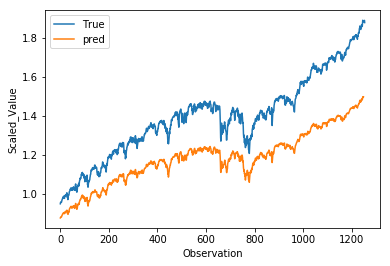

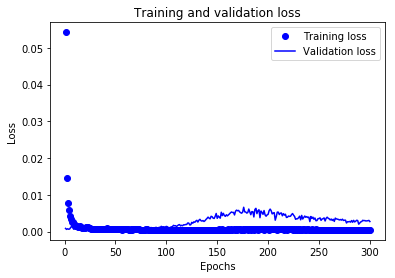

RUA_de5_tcn_clf9_n128_pe0.01_6:
(1254,)
The Adjusted R2 score on the Test set is:	-0.164
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.166
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_8[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

Epoch 8/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0021 - val_loss: 9.6799e-04
Epoch 9/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0019 - val_loss: 5.5347e-04
Epoch 10/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0016 - val_loss: 9.6544e-04
Epoch 11/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0016 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0015 - val_loss: 0.0014
Epoch 13/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0014 - val_loss: 7.6385e-04
Epoch 14/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0012 - val_loss: 9.2661e-04
Epoch 15/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0012 - val_loss: 0.0014
Epoch 16/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0011 - val_loss: 0.0010
Epoch 17/300
5667/5667======

5667/5667==============================] - 2s 311us/sample - loss: 5.5627e-04 - val_loss: 0.0039
Epoch 154/300
5667/5667==============================] - 2s 313us/sample - loss: 5.3836e-04 - val_loss: 0.0043
Epoch 155/300
5667/5667==============================] - 2s 310us/sample - loss: 5.6274e-04 - val_loss: 0.0040
Epoch 156/300
5667/5667==============================] - 2s 309us/sample - loss: 5.3019e-04 - val_loss: 0.0045
Epoch 157/300
5667/5667==============================] - 2s 309us/sample - loss: 5.5663e-04 - val_loss: 0.0044
Epoch 158/300
5667/5667==============================] - 2s 314us/sample - loss: 5.3113e-04 - val_loss: 0.0047
Epoch 159/300
5667/5667==============================] - 2s 313us/sample - loss: 5.5831e-04 - val_loss: 0.0049
Epoch 160/300
5667/5667==============================] - 2s 307us/sample - loss: 6.0002e-04 - val_loss: 0.0047
Epoch 161/300
5667/5667==============================] - 2s 311us/sample - loss: 5.7879e-04 - val_loss: 0.0045
Epoch 162/300
5

5667/5667==============================] - 2s 309us/sample - loss: 4.7585e-04 - val_loss: 0.0028
Epoch 300/300
5667/5667==============================] - 2s 307us/sample - loss: 4.8034e-04 - val_loss: 0.0027 ETA: 0s - loss: 3.148
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.081650
The Adjusted R2 score on the Test set is:	-0.086


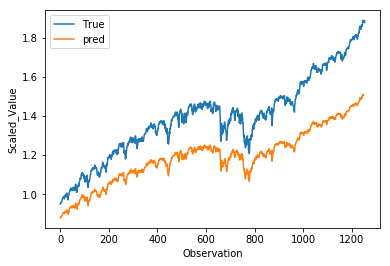

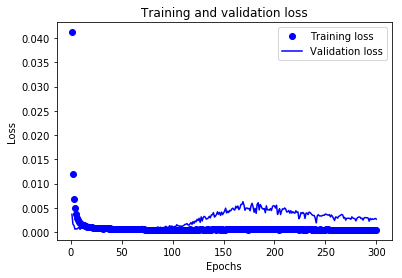

RUA_de5_tcn_clf9_n128_pe0.01_7:
(1254,)
The Adjusted R2 score on the Test set is:	-0.086
The Custom  sign score on the Test set is:	0.502
The Custom  R2 score on the Test set is:	0.208
Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_9[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 311us/sample - loss: 0.0019 - val_loss: 0.0013
Epoch 9/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0019 - val_loss: 0.0018
Epoch 10/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0017 - val_loss: 8.2212e-04
Epoch 11/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0016 - val_loss: 0.0014
Epoch 12/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0015 - val_loss: 0.0012
Epoch 13/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0015 - val_loss: 0.0016
Epoch 14/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0015 - val_loss: 0.0011
Epoch 15/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0012 - val_loss: 0.0016
Epoch 16/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0011 - val_loss: 8.9248e-04
Epoch 17/300
5667/5667==============================

5667/5667==============================] - 2s 313us/sample - loss: 5.8153e-04 - val_loss: 0.0011
Epoch 82/300
5667/5667==============================] - 2s 312us/sample - loss: 5.2936e-04 - val_loss: 0.0012
Epoch 83/300
5667/5667==============================] - 2s 316us/sample - loss: 5.0202e-04 - val_loss: 0.0011
Epoch 84/300
5667/5667==============================] - 2s 315us/sample - loss: 5.0421e-04 - val_loss: 0.0012
Epoch 85/300
5667/5667==============================] - 2s 313us/sample - loss: 4.9017e-04 - val_loss: 0.0010
Epoch 86/300
5667/5667==============================] - 2s 316us/sample - loss: 4.7967e-04 - val_loss: 0.0014
Epoch 87/300
5667/5667==============================] - 2s 315us/sample - loss: 5.2187e-04 - val_loss: 0.0012
Epoch 88/300
5667/5667==============================] - 2s 313us/sample - loss: 4.7414e-04 - val_loss: 0.0014
Epoch 89/300
5667/5667==============================] - 2s 318us/sample - loss: 5.2281e-04 - val_loss: 0.0010
Epoch 90/300
5667/5667=

5667/5667==============================] - 2s 314us/sample - loss: 6.5889e-04 - val_loss: 0.0055
Epoch 156/300
5667/5667==============================] - 2s 311us/sample - loss: 6.6128e-04 - val_loss: 0.0054
Epoch 157/300
5667/5667==============================] - 2s 313us/sample - loss: 6.1958e-04 - val_loss: 0.0062
Epoch 158/300
5667/5667==============================] - 2s 316us/sample - loss: 5.9695e-04 - val_loss: 0.0065
Epoch 159/300
5667/5667==============================] - 2s 313us/sample - loss: 5.9027e-04 - val_loss: 0.0056
Epoch 160/300
5667/5667==============================] - 2s 314us/sample - loss: 6.7787e-04 - val_loss: 0.0041
Epoch 161/300
5667/5667==============================] - 2s 312us/sample - loss: 6.4663e-04 - val_loss: 0.0059
Epoch 162/300
5667/5667==============================] - 2s 312us/sample - loss: 5.7122e-04 - val_loss: 0.0054
Epoch 163/300
5667/5667==============================] - 2s 316us/sample - loss: 6.2464e-04 - val_loss: 0.0057
Epoch 164/300
5

Epoch 229/300
5667/5667==============================] - 2s 316us/sample - loss: 5.3111e-04 - val_loss: 0.0029
Epoch 230/300
5667/5667==============================] - 2s 315us/sample - loss: 5.1173e-04 - val_loss: 0.0036
Epoch 231/300
5667/5667==============================] - 2s 317us/sample - loss: 5.0074e-04 - val_loss: 0.0041
Epoch 232/300
5667/5667==============================] - 2s 315us/sample - loss: 5.6096e-04 - val_loss: 0.0036
Epoch 233/300
5667/5667==============================] - 2s 319us/sample - loss: 5.5943e-04 - val_loss: 0.0040
Epoch 234/300
5667/5667==============================] - 2s 315us/sample - loss: 5.2651e-04 - val_loss: 0.0036
Epoch 235/300
5667/5667==============================] - 2s 317us/sample - loss: 5.1918e-04 - val_loss: 0.0037
Epoch 236/300
5667/5667==============================] - 2s 313us/sample - loss: 5.1717e-04 - val_loss: 0.0032
Epoch 237/300
5667/5667==============================] - 2s 312us/sample - loss: 5.2079e-04 - val_loss: 0.0031
E

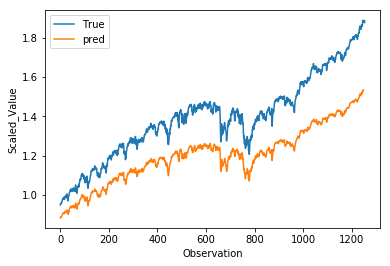

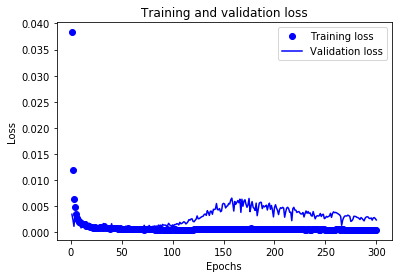

RUA_de5_tcn_clf9_n128_pe0.01_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.015
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.256
Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_10[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0023 - val_loss: 0.0023
Epoch 9/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0021 - val_loss: 0.0013
Epoch 10/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0019 - val_loss: 0.0025
Epoch 11/300
5667/5667==============================] - 2s 328us/sample - loss: 0.0016 - val_loss: 0.0020
Epoch 12/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0017 - val_loss: 0.0030
Epoch 13/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0014 - val_loss: 0.0025
Epoch 14/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0013 - val_loss: 0.0014
Epoch 15/300
5667/5667==============================] - 2s 326us/sample - loss: 0.0011 - val_loss: 0.0011
Epoch 16/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0012 - val_loss: 0.0022
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 2s 320us/sample - loss: 5.0461e-04 - val_loss: 8.4489e-04
Epoch 82/300
5667/5667==============================] - 2s 318us/sample - loss: 5.2488e-04 - val_loss: 0.0010ss: 3.5
Epoch 83/300
5667/5667==============================] - 2s 321us/sample - loss: 5.2255e-04 - val_loss: 8.3680e-04
Epoch 84/300
5667/5667==============================] - 2s 318us/sample - loss: 5.0765e-04 - val_loss: 7.7671e-04
Epoch 85/300
5667/5667==============================] - 2s 322us/sample - loss: 5.5107e-04 - val_loss: 0.0011
Epoch 86/300
5667/5667==============================] - 2s 320us/sample - loss: 5.4694e-04 - val_loss: 8.0771e-04
Epoch 87/300
5667/5667==============================] - 2s 318us/sample - loss: 5.4420e-04 - val_loss: 8.4936e-04
Epoch 88/300
5667/5667==============================] - 2s 319us/sample - loss: 5.5090e-04 - val_loss: 9.5089e-04
Epoch 89/300
5667/5667==============================] - 2s 319us/sample - loss: 5.3090e-04 - val_loss:

Epoch 228/300
5667/5667==============================] - 2s 316us/sample - loss: 5.7413e-04 - val_loss: 0.0027
Epoch 229/300
5667/5667==============================] - 2s 313us/sample - loss: 5.7180e-04 - val_loss: 0.0028
Epoch 230/300
5667/5667==============================] - 2s 316us/sample - loss: 5.3263e-04 - val_loss: 0.0028
Epoch 231/300
5667/5667==============================] - 2s 316us/sample - loss: 5.5477e-04 - val_loss: 0.0025
Epoch 232/300
5667/5667==============================] - 2s 313us/sample - loss: 4.9868e-04 - val_loss: 0.0035
Epoch 233/300
5667/5667==============================] - 2s 317us/sample - loss: 5.0062e-04 - val_loss: 0.0037
Epoch 234/300
5667/5667==============================] - 2s 315us/sample - loss: 5.6190e-04 - val_loss: 0.0036
Epoch 235/300
5667/5667==============================] - 2s 315us/sample - loss: 5.1601e-04 - val_loss: 0.0029
Epoch 236/300
5667/5667==============================] - 2s 316us/sample - loss: 5.4345e-04 - val_loss: 0.0029
E

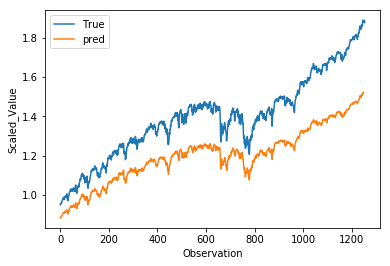

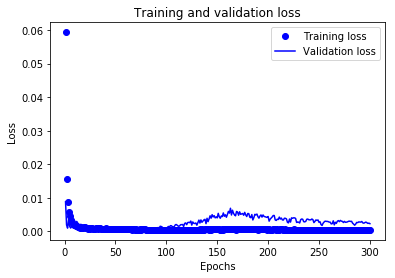

RUA_de5_tcn_clf9_n128_pe0.01_9:
(1254,)
The Adjusted R2 score on the Test set is:	0.009
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.252
Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_11[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 315us/sample - loss: 0.0019 - val_loss: 0.0021
Epoch 9/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0020 - val_loss: 0.0012
Epoch 10/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0020 - val_loss: 8.8720e-04
Epoch 11/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0016 - val_loss: 8.0096e-04
Epoch 12/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0015 - val_loss: 8.7286e-04
Epoch 13/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0015 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0014 - val_loss: 8.2873e-04
Epoch 15/300
5667/5667==============================] - 2s 317us/sample - loss: 0.0014 - val_loss: 0.0012
Epoch 16/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0012 - val_loss: 8.1176e-04
Epoch 17/300
5667/5667==================

5667/5667==============================] - 2s 317us/sample - loss: 5.9603e-04 - val_loss: 0.0051
Epoch 154/300
5667/5667==============================] - 2s 321us/sample - loss: 6.1915e-04 - val_loss: 0.0051
Epoch 155/300
5667/5667==============================] - 2s 318us/sample - loss: 5.9988e-04 - val_loss: 0.0053
Epoch 156/300
5667/5667==============================] - 2s 314us/sample - loss: 6.0727e-04 - val_loss: 0.0055
Epoch 157/300
5667/5667==============================] - 2s 320us/sample - loss: 5.8139e-04 - val_loss: 0.0061
Epoch 158/300
5667/5667==============================] - 2s 315us/sample - loss: 5.9213e-04 - val_loss: 0.0045
Epoch 159/300
5667/5667==============================] - 2s 319us/sample - loss: 6.2861e-04 - val_loss: 0.0045
Epoch 160/300
5667/5667==============================] - 2s 320us/sample - loss: 6.1954e-04 - val_loss: 0.0060
Epoch 161/300
5667/5667==============================] - 2s 318us/sample - loss: 6.5807e-04 - val_loss: 0.0052
Epoch 162/300
5

Epoch 299/300
5667/5667==============================] - 2s 316us/sample - loss: 5.3901e-04 - val_loss: 0.0024
Epoch 300/300
5667/5667==============================] - 2s 319us/sample - loss: 4.8857e-04 - val_loss: 0.0029
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.002761
The Adjusted R2 score on the Test set is:	-0.001


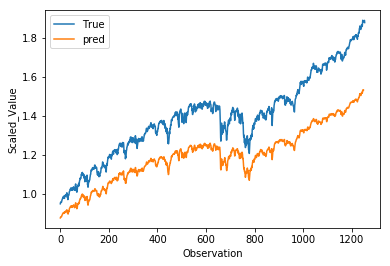

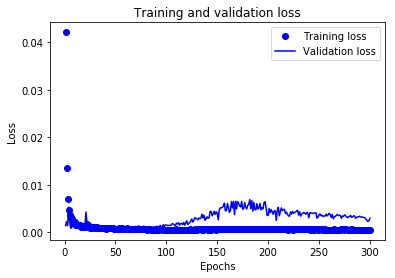

RUA_de5_tcn_clf9_n128_pe0.1_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.001
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.248
Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_12[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 311us/sample - loss: 0.0016 - val_loss: 8.9990e-04
Epoch 9/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0014 - val_loss: 5.9971e-04
Epoch 10/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0014 - val_loss: 5.9216e-04
Epoch 11/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0013 - val_loss: 0.0014
Epoch 12/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0012 - val_loss: 6.6797e-04
Epoch 13/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0012 - val_loss: 6.4650e-04
Epoch 14/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0011 - val_loss: 0.0025
Epoch 15/300
5667/5667==============================] - 2s 308us/sample - loss: 9.8585e-04 - val_loss: 6.0509e-04
Epoch 16/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0013 - val_loss: 6.8855e-04
Epoch 17/300
5667/5667======

5667/5667==============================] - 2s 305us/sample - loss: 5.5391e-04 - val_loss: 0.0042
Epoch 154/300
5667/5667==============================] - 2s 309us/sample - loss: 5.7646e-04 - val_loss: 0.0050
Epoch 155/300
5667/5667==============================] - 2s 307us/sample - loss: 5.6180e-04 - val_loss: 0.0035
Epoch 156/300
5667/5667==============================] - 2s 308us/sample - loss: 5.6345e-04 - val_loss: 0.0047
Epoch 157/300
5667/5667==============================] - 2s 311us/sample - loss: 5.0151e-04 - val_loss: 0.0042
Epoch 158/300
5667/5667==============================] - 2s 306us/sample - loss: 5.9416e-04 - val_loss: 0.0047
Epoch 159/300
5667/5667==============================] - 2s 307us/sample - loss: 6.1898e-04 - val_loss: 0.0045
Epoch 160/300
5667/5667==============================] - 2s 307us/sample - loss: 5.2174e-04 - val_loss: 0.0050
Epoch 161/300
5667/5667==============================] - 2s 306us/sample - loss: 5.4152e-04 - val_loss: 0.0047
Epoch 162/300
5

5667/5667==============================] - 2s 308us/sample - loss: 5.0993e-04 - val_loss: 0.0024
Epoch 300/300
5667/5667==============================] - 2s 305us/sample - loss: 4.6981e-04 - val_loss: 0.0025
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.133276
The Adjusted R2 score on the Test set is:	0.130


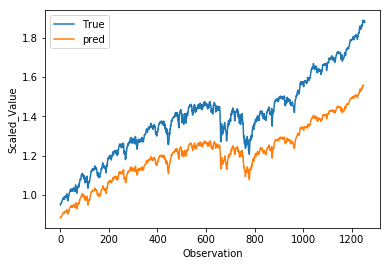

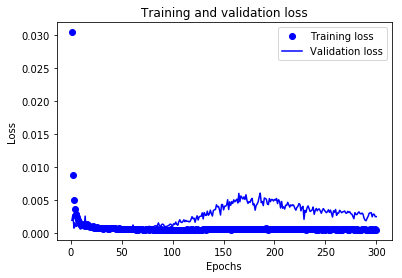

RUA_de5_tcn_clf9_n128_pe0.1_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.130
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.312
Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_13[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0018 - val_loss: 0.0012
Epoch 9/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0017 - val_loss: 7.1955e-04
Epoch 10/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0014 - val_loss: 8.4844e-04
Epoch 11/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0013 - val_loss: 8.2716e-04
Epoch 12/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0012 - val_loss: 8.8688e-04
Epoch 13/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0013 - val_loss: 6.6471e-04
Epoch 14/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0015 - val_loss: 0.0021
Epoch 15/300
5667/5667==============================] - ETA: 0s - loss: 0.0010   - 2s 315us/sample - loss: 0.0011 - val_loss: 0.0011
Epoch 16/300
5667/5667==============================] - 2s 312us/sample - loss: 9.9617e-04 - val_loss: 0.00

Epoch 154/300
5667/5667==============================] - 2s 307us/sample - loss: 5.5220e-04 - val_loss: 0.0046
Epoch 155/300
5667/5667==============================] - 2s 304us/sample - loss: 5.8297e-04 - val_loss: 0.0049
Epoch 156/300
5667/5667==============================] - 2s 307us/sample - loss: 5.4636e-04 - val_loss: 0.0052
Epoch 157/300
5667/5667==============================] - 2s 308us/sample - loss: 5.9243e-04 - val_loss: 0.0036
Epoch 158/300
5667/5667==============================] - 2s 308us/sample - loss: 5.7098e-04 - val_loss: 0.0047
Epoch 159/300
5667/5667==============================] - 2s 306us/sample - loss: 5.6485e-04 - val_loss: 0.0052
Epoch 160/300
5667/5667==============================] - 2s 311us/sample - loss: 5.6298e-04 - val_loss: 0.0047
Epoch 161/300
5667/5667==============================] - 2s 305us/sample - loss: 6.1363e-04 - val_loss: 0.0028
Epoch 162/300
5667/5667==============================] - 2s 305us/sample - loss: 6.0462e-04 - val_loss: 0.0042
E

Epoch 228/300
5667/5667==============================] - 2s 305us/sample - loss: 5.4411e-04 - val_loss: 0.0037
Epoch 229/300
5667/5667==============================] - 2s 306us/sample - loss: 5.2619e-04 - val_loss: 0.0032
Epoch 230/300
5667/5667==============================] - 2s 308us/sample - loss: 5.2119e-04 - val_loss: 0.0031
Epoch 231/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0712e-04 - val_loss: 0.0033
Epoch 232/300
5667/5667==============================] - 2s 305us/sample - loss: 5.1618e-04 - val_loss: 0.0035
Epoch 233/300
5667/5667==============================] - 2s 311us/sample - loss: 4.6650e-04 - val_loss: 0.0033
Epoch 234/300
5667/5667==============================] - 2s 305us/sample - loss: 5.5452e-04 - val_loss: 0.0031
Epoch 235/300
5667/5667==============================] - 2s 307us/sample - loss: 5.3828e-04 - val_loss: 0.0033
Epoch 236/300
5667/5667==============================] - 2s 314us/sample - loss: 5.2944e-04 - val_loss: 0.0036
E

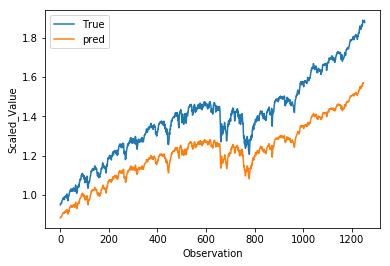

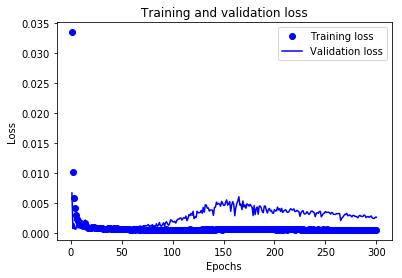

RUA_de5_tcn_clf9_n128_pe0.1_2:
(1254,)
The Adjusted R2 score on the Test set is:	0.189
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.341
Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_14[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 322us/sample - loss: 0.0026 - val_loss: 0.0013
Epoch 9/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0023 - val_loss: 0.0011
Epoch 10/300
5667/5667==============================] - 2s 322us/sample - loss: 0.0020 - val_loss: 0.0034
Epoch 11/300
5667/5667==============================] - 2s 336us/sample - loss: 0.0017 - val_loss: 6.4696e-04
Epoch 12/300
5667/5667==============================] - 2s 329us/sample - loss: 0.0017 - val_loss: 9.1665e-04
Epoch 13/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0016 - val_loss: 0.0015
Epoch 14/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0014 - val_loss: 0.0011
Epoch 15/300
5667/5667==============================] - 2s 336us/sample - loss: 0.0013 - val_loss: 0.0016
Epoch 16/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0013 - val_loss: 9.0468e-04
Epoch 17/300
5667/5667==========================

Epoch 81/300
5667/5667==============================] - 2s 324us/sample - loss: 6.2952e-04 - val_loss: 0.0010
Epoch 82/300
5667/5667==============================] - 2s 321us/sample - loss: 5.8826e-04 - val_loss: 0.0010
Epoch 83/300
5667/5667==============================] - 2s 324us/sample - loss: 5.4883e-04 - val_loss: 8.9525e-04
Epoch 84/300
5667/5667==============================] - 2s 323us/sample - loss: 5.6936e-04 - val_loss: 0.0011
Epoch 85/300
5667/5667==============================] - 2s 321us/sample - loss: 5.3598e-04 - val_loss: 9.5308e-04
Epoch 86/300
5667/5667==============================] - 2s 322us/sample - loss: 5.2421e-04 - val_loss: 0.0011
Epoch 87/300
5667/5667==============================] - 2s 320us/sample - loss: 4.9601e-04 - val_loss: 0.0011
Epoch 88/300
5667/5667==============================] - 2s 320us/sample - loss: 5.1943e-04 - val_loss: 0.0013
Epoch 89/300
5667/5667==============================] - 2s 321us/sample - loss: 6.0476e-04 - val_loss: 0.0012
Ep

5667/5667==============================] - ETA: 0s - loss: 6.0586e-0 - 2s 317us/sample - loss: 6.0593e-04 - val_loss: 0.0030
Epoch 228/300
5667/5667==============================] - 2s 324us/sample - loss: 5.6391e-04 - val_loss: 0.0027
Epoch 229/300
5667/5667==============================] - 2s 324us/sample - loss: 5.2604e-04 - val_loss: 0.0041
Epoch 230/300
5667/5667==============================] - 2s 321us/sample - loss: 5.6458e-04 - val_loss: 0.0038
Epoch 231/300
5667/5667==============================] - 2s 322us/sample - loss: 5.4142e-04 - val_loss: 0.0032
Epoch 232/300
5667/5667==============================] - 2s 327us/sample - loss: 5.5310e-04 - val_loss: 0.0025
Epoch 233/300
5667/5667==============================] - 2s 320us/sample - loss: 5.1291e-04 - val_loss: 0.0039
Epoch 234/300
5667/5667==============================] - 2s 321us/sample - loss: 5.6531e-04 - val_loss: 0.0041
Epoch 235/300
5667/5667==============================] - 2s 319us/sample - loss: 5.8366e-04 - val_

5667/5667==============================] - 2s 321us/sample - loss: 4.7399e-04 - val_loss: 0.0029
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.096605
The Adjusted R2 score on the Test set is:	-0.101


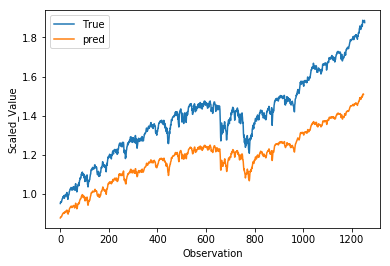

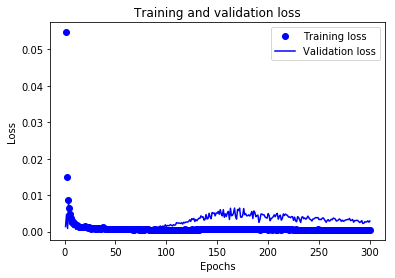

RUA_de5_tcn_clf9_n128_pe0.1_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.101
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.199
Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_15[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

Epoch 8/300
5667/5667==============================] - 2s 323us/sample - loss: 0.0019 - val_loss: 0.0015
Epoch 9/300
5667/5667==============================] - ETA: 0s - loss: 0.001 - 2s 327us/sample - loss: 0.0017 - val_loss: 6.1898e-04
Epoch 10/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0017 - val_loss: 0.0013
Epoch 11/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0016 - val_loss: 0.0010
Epoch 12/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0014 - val_loss: 9.6913e-04
Epoch 13/300
5667/5667==============================] - 2s 326us/sample - loss: 0.0013 - val_loss: 7.9152e-04
Epoch 14/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0012 - val_loss: 7.3202e-04
Epoch 15/300
5667/5667==============================] - 2s 328us/sample - loss: 0.0010 - val_loss: 9.2546e-04
Epoch 16/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0011 - val_loss: 7.1586e-04


5667/5667==============================] - 2s 322us/sample - loss: 5.4887e-04 - val_loss: 0.0032
Epoch 152/300
5667/5667==============================] - 2s 324us/sample - loss: 5.8469e-04 - val_loss: 0.0048
Epoch 153/300
5667/5667==============================] - 2s 324us/sample - loss: 6.0505e-04 - val_loss: 0.0042
Epoch 154/300
5667/5667==============================] - 2s 325us/sample - loss: 5.8653e-04 - val_loss: 0.0033
Epoch 155/300
5667/5667==============================] - 2s 324us/sample - loss: 5.8347e-04 - val_loss: 0.0031
Epoch 156/300
5667/5667==============================] - 2s 328us/sample - loss: 5.7006e-04 - val_loss: 0.0033
Epoch 157/300
5667/5667==============================] - 2s 325us/sample - loss: 5.4882e-04 - val_loss: 0.0034
Epoch 158/300
5667/5667==============================] - 2s 327us/sample - loss: 5.6458e-04 - val_loss: 0.0047
Epoch 159/300
5667/5667==============================] - 2s 325us/sample - loss: 6.0373e-04 - val_loss: 0.0054
Epoch 160/300
5

Epoch 225/300
5667/5667==============================] - 2s 332us/sample - loss: 6.4855e-04 - val_loss: 0.0055
Epoch 226/300
5667/5667==============================] - 2s 323us/sample - loss: 5.6701e-04 - val_loss: 0.0052
Epoch 227/300
5667/5667==============================] - 2s 327us/sample - loss: 6.2835e-04 - val_loss: 0.0048
Epoch 228/300
5667/5667==============================] - 2s 324us/sample - loss: 6.2148e-04 - val_loss: 0.0044
Epoch 229/300
5667/5667==============================] - 2s 326us/sample - loss: 6.1180e-04 - val_loss: 0.0045
Epoch 230/300
5667/5667==============================] - 2s 327us/sample - loss: 5.9653e-04 - val_loss: 0.0047
Epoch 231/300
5667/5667==============================] - 2s 327us/sample - loss: 6.0494e-04 - val_loss: 0.0048
Epoch 232/300
5667/5667==============================] - 2s 318us/sample - loss: 6.1082e-04 - val_loss: 0.0034
Epoch 233/300
5667/5667==============================] - 2s 324us/sample - loss: 5.6946e-04 - val_loss: 0.0046
E

Epoch 299/300
5667/5667==============================] - 2s 323us/sample - loss: 5.2258e-04 - val_loss: 0.0029
Epoch 300/300
5667/5667==============================] - 2s 326us/sample - loss: 5.1162e-04 - val_loss: 0.0032
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.169964
The Adjusted R2 score on the Test set is:	-0.175


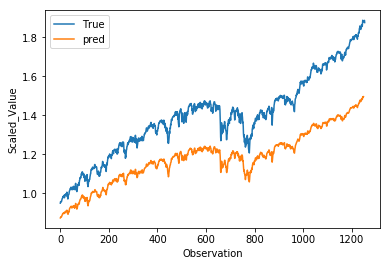

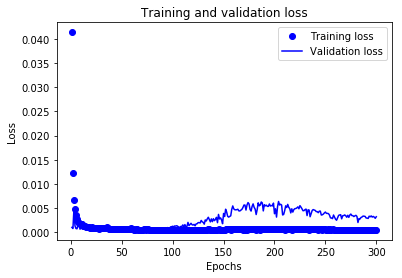

RUA_de5_tcn_clf9_n128_pe0.1_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.175
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.162
Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_16 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_16[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 322us/sample - loss: 0.0022 - val_loss: 0.0035
Epoch 9/300
5667/5667==============================] - 2s 318us/sample - loss: 0.0019 - val_loss: 6.3147e-04
Epoch 10/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0020 - val_loss: 0.0017
Epoch 11/300
5667/5667==============================] - 2s 322us/sample - loss: 0.0018 - val_loss: 0.0018
Epoch 12/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0015 - val_loss: 0.0020
Epoch 13/300
5667/5667==============================] - 2s 321us/sample - loss: 0.0016 - val_loss: 0.0016
Epoch 14/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0013 - val_loss: 0.0021
Epoch 15/300
5667/5667==============================] - 2s 322us/sample - loss: 0.0011 - val_loss: 0.0016
Epoch 16/300
5667/5667==============================] - 2s 316us/sample - loss: 0.0011 - val_loss: 0.0010
Epoch 17/300
5667/5667==============================] - 

5667/5667==============================] - 2s 320us/sample - loss: 4.9905e-04 - val_loss: 9.6510e-04
Epoch 82/300
5667/5667==============================] - 2s 317us/sample - loss: 4.6797e-04 - val_loss: 7.7376e-04
Epoch 83/300
5667/5667==============================] - 2s 321us/sample - loss: 4.7989e-04 - val_loss: 9.1403e-04
Epoch 84/300
5667/5667==============================] - 2s 319us/sample - loss: 5.7074e-04 - val_loss: 9.4593e-04
Epoch 85/300
5667/5667==============================] - 2s 321us/sample - loss: 5.4265e-04 - val_loss: 8.0163e-04
Epoch 86/300
5667/5667==============================] - 2s 316us/sample - loss: 5.0077e-04 - val_loss: 0.0011
Epoch 87/300
5667/5667==============================] - 2s 322us/sample - loss: 5.0124e-04 - val_loss: 0.0012
Epoch 88/300
5667/5667==============================] - 2s 317us/sample - loss: 4.8613e-04 - val_loss: 9.4380e-04
Epoch 89/300
5667/5667==============================] - 2s 321us/sample - loss: 5.0702e-04 - val_loss: 9.2981

Epoch 155/300
5667/5667==============================] - 2s 323us/sample - loss: 5.7463e-04 - val_loss: 0.0042
Epoch 156/300
5667/5667==============================] - 2s 320us/sample - loss: 5.3491e-04 - val_loss: 0.0042
Epoch 157/300
5667/5667==============================] - 2s 319us/sample - loss: 5.6120e-04 - val_loss: 0.0037
Epoch 158/300
5667/5667==============================] - 2s 321us/sample - loss: 5.3737e-04 - val_loss: 0.0044
Epoch 159/300
5667/5667==============================] - 2s 323us/sample - loss: 5.8478e-04 - val_loss: 0.0038
Epoch 160/300
5667/5667==============================] - 2s 321us/sample - loss: 5.4172e-04 - val_loss: 0.0034
Epoch 161/300
5667/5667==============================] - 2s 319us/sample - loss: 5.2506e-04 - val_loss: 0.0040
Epoch 162/300
5667/5667==============================] - 2s 323us/sample - loss: 5.5275e-04 - val_loss: 0.0026
Epoch 163/300
5667/5667==============================] - 2s 316us/sample - loss: 4.9848e-04 - val_loss: 0.0032
E

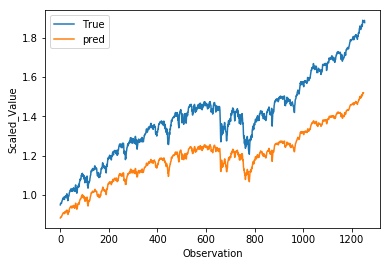

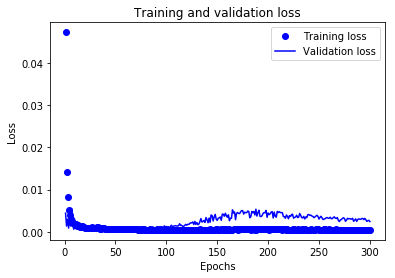

RUA_de5_tcn_clf9_n128_pe0.1_5:
(1254,)
The Adjusted R2 score on the Test set is:	-0.039
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.228
Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_17 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_17[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 330us/sample - loss: 0.0020 - val_loss: 8.5337e-04
Epoch 9/300
5667/5667==============================] - 2s 332us/sample - loss: 0.0017 - val_loss: 0.0013
Epoch 10/300
5667/5667==============================] - 2s 329us/sample - loss: 0.0016 - val_loss: 9.0515e-04
Epoch 11/300
5667/5667==============================] - 2s 328us/sample - loss: 0.0013 - val_loss: 7.1354e-04
Epoch 12/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0013 - val_loss: 6.8378e-04
Epoch 13/300
5667/5667==============================] - 2s 334us/sample - loss: 0.0013 - val_loss: 0.0014
Epoch 14/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0011 - val_loss: 0.0016
Epoch 15/300
5667/5667==============================] - 2s 333us/sample - loss: 0.0011 - val_loss: 9.4876e-04
Epoch 16/300
5667/5667==============================] - 2s 330us/sample - loss: 0.0010 - val_loss: 6.7573e-04
Epoch 17/300
5667/5667==============

Epoch 80/300
5667/5667==============================] - 2s 332us/sample - loss: 5.1268e-04 - val_loss: 0.0010
Epoch 81/300
5667/5667==============================] - 2s 331us/sample - loss: 5.4963e-04 - val_loss: 0.0014
Epoch 82/300
5667/5667==============================] - 2s 332us/sample - loss: 5.0649e-04 - val_loss: 0.0012
Epoch 83/300
5667/5667==============================] - 2s 329us/sample - loss: 4.9048e-04 - val_loss: 8.0871e-04
Epoch 84/300
5667/5667==============================] - 2s 332us/sample - loss: 4.7906e-04 - val_loss: 0.0012
Epoch 85/300
5667/5667==============================] - 2s 331us/sample - loss: 5.2505e-04 - val_loss: 0.0013
Epoch 86/300
5667/5667==============================] - 2s 331us/sample - loss: 5.4961e-04 - val_loss: 0.0012
Epoch 87/300
5667/5667==============================] - 2s 331us/sample - loss: 5.1023e-04 - val_loss: 0.0014
Epoch 88/300
5667/5667==============================] - 2s 329us/sample - loss: 4.9698e-04 - val_loss: 0.0011
Epoch 

5667/5667==============================] - 2s 328us/sample - loss: 5.4715e-04 - val_loss: 0.0034
Epoch 227/300
5667/5667==============================] - 2s 330us/sample - loss: 5.6582e-04 - val_loss: 0.0033
Epoch 228/300
5667/5667==============================] - 2s 329us/sample - loss: 5.1642e-04 - val_loss: 0.0037
Epoch 229/300
5667/5667==============================] - 2s 331us/sample - loss: 5.4396e-04 - val_loss: 0.0041
Epoch 230/300
5667/5667==============================] - 2s 329us/sample - loss: 5.4514e-04 - val_loss: 0.0037 - l
Epoch 231/300
5667/5667==============================] - 2s 328us/sample - loss: 5.7031e-04 - val_loss: 0.0034
Epoch 232/300
5667/5667==============================] - 2s 330us/sample - loss: 5.2525e-04 - val_loss: 0.0035
Epoch 233/300
5667/5667==============================] - 2s 331us/sample - loss: 5.6068e-04 - val_loss: 0.0039
Epoch 234/300
5667/5667==============================] - 2s 334us/sample - loss: 4.9375e-04 - val_loss: 0.0032
Epoch 235/3

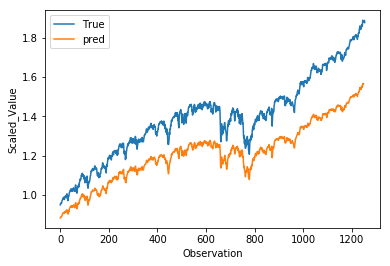

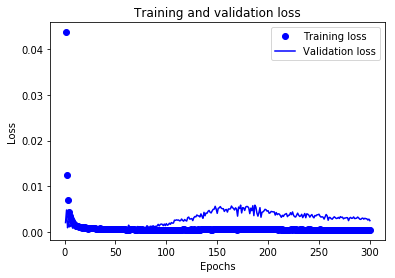

RUA_de5_tcn_clf9_n128_pe0.1_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.153
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.324
Model: "model_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_18 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_18[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 334us/sample - loss: 0.0025 - val_loss: 6.8621e-04
Epoch 9/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0025 - val_loss: 9.1549e-04
Epoch 10/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0018 - val_loss: 8.3090e-04
Epoch 11/300
5667/5667==============================] - 2s 341us/sample - loss: 0.0016 - val_loss: 7.9380e-04
Epoch 12/300
5667/5667==============================] - 2s 332us/sample - loss: 0.0015 - val_loss: 6.4606e-04
Epoch 13/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0013 - val_loss: 9.6930e-04
Epoch 14/300
5667/5667==============================] - 2s 333us/sample - loss: 0.0012 - val_loss: 6.4409e-04
Epoch 15/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0011 - val_loss: 8.9837e-04
Epoch 16/300
5667/5667==============================] - 2s 334us/sample - loss: 0.0013 - val_loss: 7.1198e-04
Epoch 17/300

Epoch 154/300
5667/5667==============================] - 2s 333us/sample - loss: 5.4213e-04 - val_loss: 0.0041
Epoch 155/300
5667/5667==============================] - 2s 332us/sample - loss: 5.9274e-04 - val_loss: 0.0046
Epoch 156/300
5667/5667==============================] - 2s 331us/sample - loss: 5.4948e-04 - val_loss: 0.0045- loss:
Epoch 157/300
5667/5667==============================] - 2s 332us/sample - loss: 5.6294e-04 - val_loss: 0.0046
Epoch 158/300
5667/5667==============================] - 2s 330us/sample - loss: 5.5521e-04 - val_loss: 0.0048
Epoch 159/300
5667/5667==============================] - 2s 332us/sample - loss: 5.8879e-04 - val_loss: 0.0035
Epoch 160/300
5667/5667==============================] - 2s 331us/sample - loss: 5.4291e-04 - val_loss: 0.0045
Epoch 161/300
5667/5667==============================] - 2s 332us/sample - loss: 5.4986e-04 - val_loss: 0.0041
Epoch 162/300
5667/5667==============================] - 2s 334us/sample - loss: 5.6772e-04 - val_loss: 0

5667/5667==============================] - 2s 330us/sample - loss: 5.1522e-04 - val_loss: 0.0027
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.043642
The Adjusted R2 score on the Test set is:	0.040


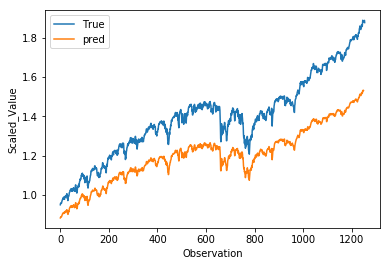

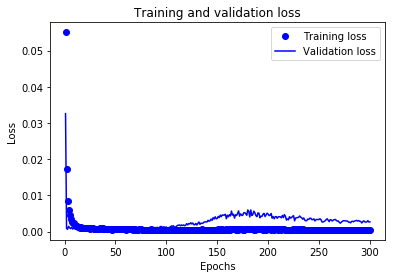

RUA_de5_tcn_clf9_n128_pe0.1_7:
(1254,)
The Adjusted R2 score on the Test set is:	0.040
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.267
Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_19[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0019 - val_loss: 0.0016
Epoch 9/300
5667/5667==============================] - 2s 330us/sample - loss: 0.0018 - val_loss: 0.0016
Epoch 10/300
5667/5667==============================] - 2s 334us/sample - loss: 0.0015 - val_loss: 0.0023
Epoch 11/300
5667/5667==============================] - 2s 335us/sample - loss: 0.0013 - val_loss: 0.0013
Epoch 12/300
5667/5667==============================] - 2s 337us/sample - loss: 0.0013 - val_loss: 7.3389e-04
Epoch 13/300
5667/5667==============================] - 2s 340us/sample - loss: 0.0012 - val_loss: 0.00100e-0 - ETA: 1
Epoch 14/300
5667/5667==============================] - 2s 330us/sample - loss: 0.0011 - val_loss: 9.5548e-04
Epoch 15/300
5667/5667==============================] - 2s 333us/sample - loss: 0.0011 - val_loss: 7.9534e-04
Epoch 16/300
5667/5667==============================] - 2s 333us/sample - loss: 0.0010 - val_loss: 6.9498e-04
Epoch 17/300
5667/5

5667/5667==============================] - 2s 339us/sample - loss: 5.2823e-04 - val_loss: 0.0035
Epoch 154/300
5667/5667==============================] - 2s 338us/sample - loss: 4.9912e-04 - val_loss: 0.0035
Epoch 155/300
5667/5667==============================] - 2s 341us/sample - loss: 5.3492e-04 - val_loss: 0.0034
Epoch 156/300
5667/5667==============================] - 2s 331us/sample - loss: 5.3663e-04 - val_loss: 0.0042
Epoch 157/300
5667/5667==============================] - ETA: 0s - loss: 4.9887e-0 - 2s 330us/sample - loss: 5.0175e-04 - val_loss: 0.0044
Epoch 158/300
5667/5667==============================] - 2s 334us/sample - loss: 5.0625e-04 - val_loss: 0.0031
Epoch 159/300
5667/5667==============================] - 2s 330us/sample - loss: 5.5077e-04 - val_loss: 0.0042
Epoch 160/300
5667/5667==============================] - 2s 340us/sample - loss: 5.4677e-04 - val_loss: 0.0037
Epoch 161/300
5667/5667==============================] - 2s 333us/sample - loss: 5.4200e-04 - val_

5667/5667==============================] - 2s 331us/sample - loss: 5.7032e-04 - val_loss: 0.0034
Epoch 227/300
5667/5667==============================] - 2s 331us/sample - loss: 5.5146e-04 - val_loss: 0.0044
Epoch 228/300
5667/5667==============================] - 2s 334us/sample - loss: 5.9468e-04 - val_loss: 0.0038
Epoch 229/300
5667/5667==============================] - 2s 332us/sample - loss: 5.3321e-04 - val_loss: 0.0044
Epoch 230/300
5667/5667==============================] - 2s 333us/sample - loss: 5.5325e-04 - val_loss: 0.0043
Epoch 231/300
5667/5667==============================] - 2s 331us/sample - loss: 5.9309e-04 - val_loss: 0.0044
Epoch 232/300
5667/5667==============================] - 2s 332us/sample - loss: 5.4960e-04 - val_loss: 0.0036
Epoch 233/300
5667/5667==============================] - 2s 329us/sample - loss: 5.4101e-04 - val_loss: 0.0039
Epoch 234/300
5667/5667==============================] - 2s 330us/sample - loss: 5.6575e-04 - val_loss: 0.0044
Epoch 235/300
5

Epoch 300/300
5667/5667==============================] - 2s 333us/sample - loss: 4.9120e-04 - val_loss: 0.0029
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.243458
The Adjusted R2 score on the Test set is:	0.240


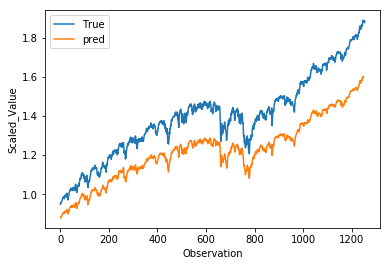

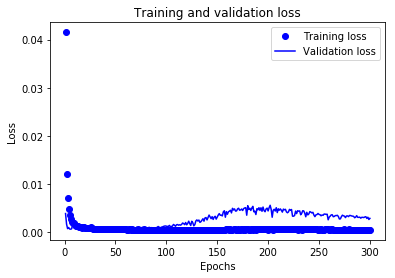

RUA_de5_tcn_clf9_n128_pe0.1_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.240
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	0.370
Model: "model_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_20 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_20[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 322us/sample - loss: 0.0022 - val_loss: 8.3782e-04
Epoch 9/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0020 - val_loss: 7.2629e-04
Epoch 10/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0017 - val_loss: 9.4998e-04
Epoch 11/300
5667/5667==============================] - 2s 327us/sample - loss: 0.0015 - val_loss: 5.7391e-04
Epoch 12/300
5667/5667==============================] - 2s 325us/sample - loss: 0.0016 - val_loss: 6.2853e-04
Epoch 13/300
5667/5667==============================] - 2s 325us/sample - loss: 0.0014 - val_loss: 5.8053e-04
Epoch 14/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0013 - val_loss: 6.0480e-04
Epoch 15/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0013 - val_loss: 9.0260e-04
Epoch 16/300
5667/5667==============================] - 2s 328us/sample - loss: 0.0014 - val_loss: 0.0015
Epoch 17/300
566

Epoch 80/300
5667/5667==============================] - 2s 323us/sample - loss: 5.2250e-04 - val_loss: 8.5239e-04
Epoch 81/300
5667/5667==============================] - 2s 323us/sample - loss: 5.2726e-04 - val_loss: 8.4276e-04
Epoch 82/300
5667/5667==============================] - 2s 325us/sample - loss: 5.2083e-04 - val_loss: 8.3312e-04
Epoch 83/300
5667/5667==============================] - 2s 326us/sample - loss: 5.3218e-04 - val_loss: 0.0010
Epoch 84/300
5667/5667==============================] - 2s 322us/sample - loss: 5.4155e-04 - val_loss: 9.9470e-04
Epoch 85/300
5667/5667==============================] - 2s 324us/sample - loss: 5.5728e-04 - val_loss: 9.1267e-04
Epoch 86/300
5667/5667==============================] - 2s 325us/sample - loss: 5.6956e-04 - val_loss: 9.3189e-04
Epoch 87/300
5667/5667==============================] - 2s 324us/sample - loss: 5.2379e-04 - val_loss: 8.2812e-04
Epoch 88/300
5667/5667==============================] - 2s 324us/sample - loss: 5.4602e-04 -

5667/5667==============================] - 2s 321us/sample - loss: 5.9252e-04 - val_loss: 0.0046
Epoch 154/300
5667/5667==============================] - 2s 322us/sample - loss: 5.8816e-04 - val_loss: 0.0061
Epoch 155/300
5667/5667==============================] - 2s 324us/sample - loss: 5.9172e-04 - val_loss: 0.0051
Epoch 156/300
5667/5667==============================] - 2s 322us/sample - loss: 5.7686e-04 - val_loss: 0.0050
Epoch 157/300
5667/5667==============================] - 2s 323us/sample - loss: 5.9857e-04 - val_loss: 0.0044
Epoch 158/300
5667/5667==============================] - 2s 324us/sample - loss: 5.7910e-04 - val_loss: 0.0059
Epoch 159/300
5667/5667==============================] - 2s 324us/sample - loss: 5.9186e-04 - val_loss: 0.0046
Epoch 160/300
5667/5667==============================] - 2s 323us/sample - loss: 6.2979e-04 - val_loss: 0.0054
Epoch 161/300
5667/5667==============================] - 2s 323us/sample - loss: 6.2907e-04 - val_loss: 0.0051
Epoch 162/300
5

5667/5667==============================] - 2s 321us/sample - loss: 5.2695e-04 - val_loss: 0.0028
Epoch 300/300
5667/5667==============================] - 2s 321us/sample - loss: 4.8500e-04 - val_loss: 0.0027
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.085042
The Adjusted R2 score on the Test set is:	0.081


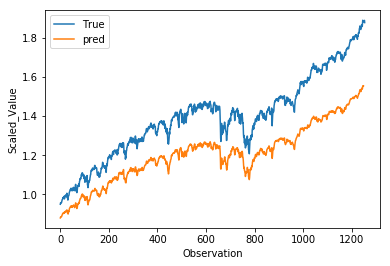

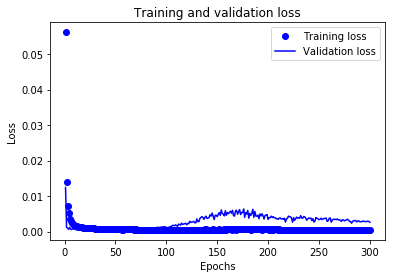

RUA_de5_tcn_clf9_n128_pe0.1_9:
(1254,)
The Adjusted R2 score on the Test set is:	0.081
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.288


In [39]:
neurons=[128]
penalties=[0.01, 0.1]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model_20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_21[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_120 (Activation)     (None, 1, 128)       0           tcn_d_causal_conv_1_tanh_s0[0][0]
___________________________________________________________________________________________

5667/5667==============================] - 2s 337us/sample - loss: 6.2672e-04 - val_loss: 0.0010
Epoch 83/300
5667/5667==============================] - 2s 338us/sample - loss: 6.5920e-04 - val_loss: 0.0011
Epoch 84/300
5667/5667==============================] - 2s 340us/sample - loss: 7.2034e-04 - val_loss: 9.7097e-04
Epoch 85/300
5667/5667==============================] - 2s 337us/sample - loss: 6.8172e-04 - val_loss: 0.0012
Epoch 86/300
5667/5667==============================] - 2s 338us/sample - loss: 7.0044e-04 - val_loss: 0.0012
Epoch 87/300
5667/5667==============================] - 2s 343us/sample - loss: 6.2308e-04 - val_loss: 0.0014
Epoch 88/300
5667/5667==============================] - 2s 341us/sample - loss: 6.3010e-04 - val_loss: 0.0015
Epoch 89/300
5667/5667==============================] - 2s 344us/sample - loss: 7.0268e-04 - val_loss: 0.0011
Epoch 90/300
5667/5667==============================] - 2s 336us/sample - loss: 6.4019e-04 - val_loss: 0.0014
Epoch 91/300
5667/5

5667/5667==============================] - 2s 337us/sample - loss: 7.7565e-04 - val_loss: 0.0050
Epoch 229/300
5667/5667==============================] - ETA: 0s - loss: 7.1452e-04- ETA: 0s -  - 2s 341us/sample - loss: 7.3778e-04 - val_loss: 0.0044
Epoch 230/300
5667/5667==============================] - 2s 335us/sample - loss: 7.2555e-04 - val_loss: 0.0043
Epoch 231/300
5667/5667==============================] - 2s 338us/sample - loss: 7.2235e-04 - val_loss: 0.0054
Epoch 232/300
5667/5667==============================] - 2s 336us/sample - loss: 7.0226e-04 - val_loss: 0.0053
Epoch 233/300
5667/5667==============================] - 2s 338us/sample - loss: 7.2953e-04 - val_loss: 0.0053
Epoch 234/300
5667/5667==============================] - 2s 340us/sample - loss: 6.8925e-04 - val_loss: 0.0053
Epoch 235/300
5667/5667==============================] - 2s 338us/sample - loss: 7.2682e-04 - val_loss: 0.0058
Epoch 236/300
5667/5667==============================] - 2s 340us/sample - loss: 6.95

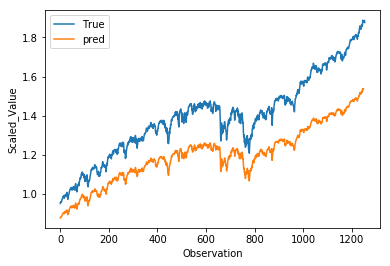

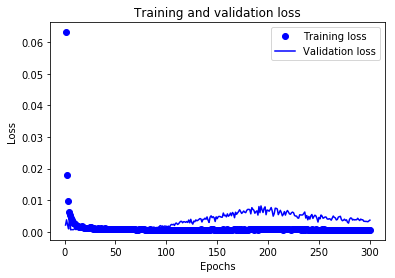

RUA_de5_tcn_clf9_n128_pe1_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.003
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	0.248
Model: "model_21"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_22[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 324us/sample - loss: 0.0026 - val_loss: 9.2977e-04
Epoch 9/300
5667/5667==============================] - 2s 323us/sample - loss: 0.0023 - val_loss: 7.0734e-04
Epoch 10/300
5667/5667==============================] - 2s 322us/sample - loss: 0.0023 - val_loss: 0.0016
Epoch 11/300
5667/5667==============================] - 2s 325us/sample - loss: 0.0020 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 320us/sample - loss: 0.0016 - val_loss: 6.9620e-04
Epoch 13/300
5667/5667==============================] - 2s 325us/sample - loss: 0.0017 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 2s 323us/sample - loss: 0.0018 - val_loss: 0.0020
Epoch 15/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0017 - val_loss: 0.0010
Epoch 16/300
5667/5667==============================] - 2s 324us/sample - loss: 0.0017 - val_loss: 7.1743e-04
Epoch 17/300
5667/5667======================

5667/5667==============================] - 2s 321us/sample - loss: 7.1989e-04 - val_loss: 0.0054
Epoch 155/300
5667/5667==============================] - 2s 322us/sample - loss: 7.2985e-04 - val_loss: 0.0048
Epoch 156/300
5667/5667==============================] - 2s 324us/sample - loss: 7.7004e-04 - val_loss: 0.0051
Epoch 157/300
5667/5667==============================] - 2s 324us/sample - loss: 7.1557e-04 - val_loss: 0.0064
Epoch 158/300
5667/5667==============================] - 2s 325us/sample - loss: 6.8315e-04 - val_loss: 0.0061
Epoch 159/300
5667/5667==============================] - 2s 323us/sample - loss: 7.8429e-04 - val_loss: 0.0054
Epoch 160/300
5667/5667==============================] - 2s 324us/sample - loss: 7.8737e-04 - val_loss: 0.0064
Epoch 161/300
5667/5667==============================] - 2s 323us/sample - loss: 7.7240e-04 - val_loss: 0.0052
Epoch 162/300
5667/5667==============================] - 2s 319us/sample - loss: 7.2175e-04 - val_loss: 0.0064
Epoch 163/300
5

5667/5667==============================] - 2s 324us/sample - loss: 5.9827e-04 - val_loss: 0.0036
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.127150
The Adjusted R2 score on the Test set is:	-0.132


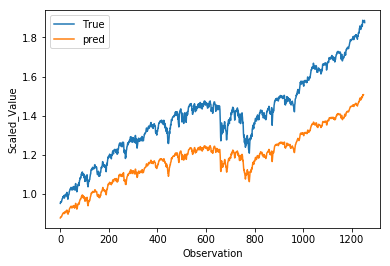

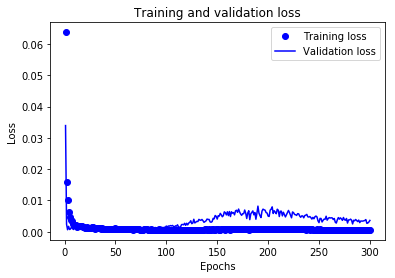

RUA_de5_tcn_clf9_n128_pe1_1:
(1254,)
The Adjusted R2 score on the Test set is:	-0.132
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.182
Model: "model_22"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_23 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_23[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 332us/sample - loss: 0.0028 - val_loss: 6.4419e-04
Epoch 9/300
5667/5667==============================] - 2s 333us/sample - loss: 0.0025 - val_loss: 0.0017
Epoch 10/300
5667/5667==============================] - 2s 332us/sample - loss: 0.0020 - val_loss: 7.9540e-04
Epoch 11/300
5667/5667==============================] - 2s 332us/sample - loss: 0.0018 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0016 - val_loss: 6.7448e-04
Epoch 13/300
5667/5667==============================] - 2s 334us/sample - loss: 0.0015 - val_loss: 0.0013
Epoch 14/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0016 - val_loss: 8.3441e-04
Epoch 15/300
5667/5667==============================] - 2s 335us/sample - loss: 0.0017 - val_loss: 8.2135e-04
Epoch 16/300
5667/5667==============================] - ETA: 0s - loss: 0.001 - 2s 334us/sample - loss: 0.0013 - val_loss: 9.2635e-04
Epoch 17/300

Epoch 81/300
5667/5667==============================] - 2s 326us/sample - loss: 7.3280e-04 - val_loss: 9.0597e-04
Epoch 82/300
5667/5667==============================] - 2s 324us/sample - loss: 7.8508e-04 - val_loss: 0.0012
Epoch 83/300
5667/5667==============================] - 2s 330us/sample - loss: 6.8679e-04 - val_loss: 7.9929e-04
Epoch 84/300
5667/5667==============================] - 2s 325us/sample - loss: 6.6216e-04 - val_loss: 8.9406e-04
Epoch 85/300
5667/5667==============================] - 2s 327us/sample - loss: 6.9039e-04 - val_loss: 0.0010
Epoch 86/300
5667/5667==============================] - 2s 335us/sample - loss: 6.0016e-04 - val_loss: 8.5282e-04
Epoch 87/300
5667/5667==============================] - 2s 328us/sample - loss: 5.9045e-04 - val_loss: 9.5023e-04
Epoch 88/300
5667/5667==============================] - 2s 323us/sample - loss: 5.8958e-04 - val_loss: 0.0012
Epoch 89/300
5667/5667==============================] - 2s 325us/sample - loss: 6.0248e-04 - val_los

5667/5667==============================] - 2s 327us/sample - loss: 6.1971e-04 - val_loss: 0.0047
Epoch 228/300
5667/5667==============================] - 2s 324us/sample - loss: 6.9282e-04 - val_loss: 0.0044
Epoch 229/300
5667/5667==============================] - 2s 324us/sample - loss: 7.3965e-04 - val_loss: 0.0047
Epoch 230/300
5667/5667==============================] - 2s 326us/sample - loss: 7.4479e-04 - val_loss: 0.0051
Epoch 231/300
5667/5667==============================] - 2s 323us/sample - loss: 7.0356e-04 - val_loss: 0.0054
Epoch 232/300
5667/5667==============================] - 2s 329us/sample - loss: 7.6615e-04 - val_loss: 0.0054
Epoch 233/300
5667/5667==============================] - 2s 325us/sample - loss: 7.3700e-04 - val_loss: 0.0051
Epoch 234/300
5667/5667==============================] - 2s 327us/sample - loss: 7.2340e-04 - val_loss: 0.0037
Epoch 235/300
5667/5667==============================] - 2s 327us/sample - loss: 6.5440e-04 - val_loss: 0.0042
Epoch 236/300
5

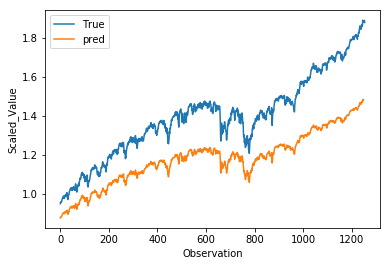

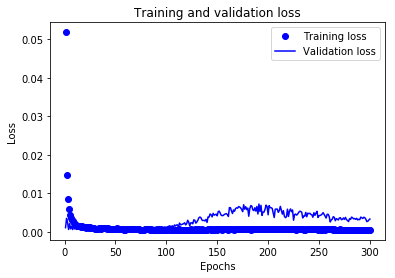

RUA_de5_tcn_clf9_n128_pe1_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.220
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.140
Model: "model_23"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_24[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 349us/sample - loss: 0.0026 - val_loss: 6.4223e-04
Epoch 9/300
5667/5667==============================] - 2s 345us/sample - loss: 0.0024 - val_loss: 7.2549e-04
Epoch 10/300
5667/5667==============================] - 2s 343us/sample - loss: 0.0024 - val_loss: 7.1480e-04
Epoch 11/300
5667/5667==============================] - 2s 342us/sample - loss: 0.0021 - val_loss: 0.0018
Epoch 12/300
5667/5667==============================] - 2s 343us/sample - loss: 0.0021 - val_loss: 0.0014
Epoch 13/300
5667/5667==============================] - 2s 347us/sample - loss: 0.0016 - val_loss: 0.0012
Epoch 14/300
5667/5667==============================] - 2s 344us/sample - loss: 0.0016 - val_loss: 0.0013
Epoch 15/300
5667/5667==============================] - 2s 346us/sample - loss: 0.0018 - val_loss: 0.0011
Epoch 16/300
5667/5667==============================] - 2s 342us/sample - loss: 0.0015 - val_loss: 0.0016
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 2s 341us/sample - loss: 7.4439e-04 - val_loss: 0.0046
Epoch 155/300
5667/5667==============================] - 2s 348us/sample - loss: 7.5712e-04 - val_loss: 0.0052
Epoch 156/300
5667/5667==============================] - 2s 344us/sample - loss: 7.4527e-04 - val_loss: 0.0057
Epoch 157/300
5667/5667==============================] - 2s 347us/sample - loss: 7.2082e-04 - val_loss: 0.0044
Epoch 158/300
5667/5667==============================] - 2s 358us/sample - loss: 7.4568e-04 - val_loss: 0.0059
Epoch 159/300
5667/5667==============================] - 2s 341us/sample - loss: 7.2666e-04 - val_loss: 0.0043
Epoch 160/300
5667/5667==============================] - 2s 344us/sample - loss: 6.9260e-04 - val_loss: 0.0054
Epoch 161/300
5667/5667==============================] - 2s 347us/sample - loss: 7.3716e-04 - val_loss: 0.0067
Epoch 162/300
5667/5667==============================] - 2s 349us/sample - loss: 7.3269e-04 - val_loss: 0.0055
Epoch 163/300
5

5667/5667==============================] - 2s 344us/sample - loss: 6.3413e-04 - val_loss: 0.0036
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.063511
The Adjusted R2 score on the Test set is:	-0.068


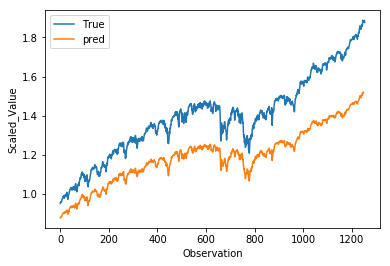

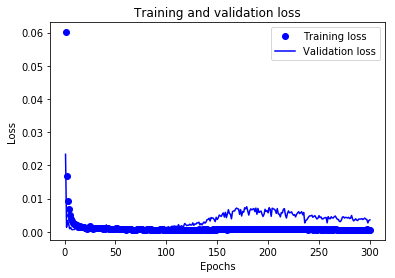

RUA_de5_tcn_clf9_n128_pe1_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.068
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.214
Model: "model_24"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_25 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_25[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 347us/sample - loss: 0.0024 - val_loss: 0.0023
Epoch 9/300
5667/5667==============================] - 2s 351us/sample - loss: 0.0023 - val_loss: 0.0029
Epoch 10/300
5667/5667==============================] - 2s 345us/sample - loss: 0.0018 - val_loss: 8.1716e-04
Epoch 11/300
5667/5667==============================] - 2s 347us/sample - loss: 0.0018 - val_loss: 0.0015
Epoch 12/300
5667/5667==============================] - 2s 350us/sample - loss: 0.0017 - val_loss: 0.0019
Epoch 13/300
5667/5667==============================] - 2s 346us/sample - loss: 0.0018 - val_loss: 0.0017
Epoch 14/300
5667/5667==============================] - 2s 346us/sample - loss: 0.0015 - val_loss: 0.0014
Epoch 15/300
5667/5667==============================] - 2s 345us/sample - loss: 0.0014 - val_loss: 7.9019e-04
Epoch 16/300
5667/5667==============================] - 2s 345us/sample - loss: 0.0014 - val_loss: 8.6596e-04
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 2s 347us/sample - loss: 7.1658e-04 - val_loss: 0.0046
Epoch 155/300
5667/5667==============================] - 2s 357us/sample - loss: 7.9839e-04 - val_loss: 0.0063
Epoch 156/300
5667/5667==============================] - 2s 346us/sample - loss: 7.0241e-04 - val_loss: 0.0055
Epoch 157/300
5667/5667==============================] - 2s 348us/sample - loss: 7.3970e-04 - val_loss: 0.0044
Epoch 158/300
5667/5667==============================] - 2s 345us/sample - loss: 7.4226e-04 - val_loss: 0.0050
Epoch 159/300
5667/5667==============================] - 2s 345us/sample - loss: 7.2846e-04 - val_loss: 0.0041
Epoch 160/300
5667/5667==============================] - 2s 347us/sample - loss: 7.4143e-04 - val_loss: 0.0062
Epoch 161/300
5667/5667==============================] - 2s 344us/sample - loss: 7.1315e-04 - val_loss: 0.0054
Epoch 162/300
5667/5667==============================] - 2s 348us/sample - loss: 7.5982e-04 - val_loss: 0.0042
Epoch 163/300
5

Epoch 300/300
5667/5667==============================] - 2s 348us/sample - loss: 6.9497e-04 - val_loss: 0.0039
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.071900
The Adjusted R2 score on the Test set is:	-0.076


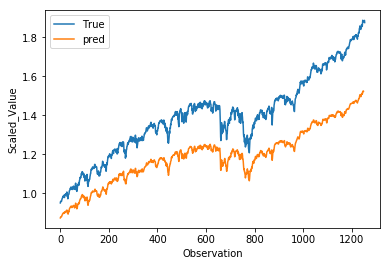

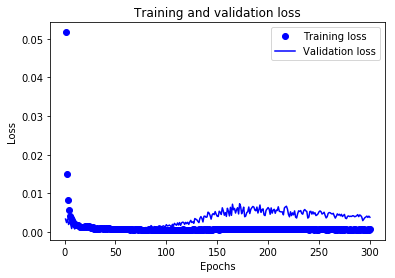

RUA_de5_tcn_clf9_n128_pe1_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.076
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.208
Model: "model_25"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_26 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_26[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 79/300
5667/5667==============================] - 2s 347us/sample - loss: 6.1708e-04 - val_loss: 0.0010
Epoch 80/300
5667/5667==============================] - 2s 349us/sample - loss: 7.1282e-04 - val_loss: 7.5053e-04
Epoch 81/300
5667/5667==============================] - 2s 362us/sample - loss: 6.9253e-04 - val_loss: 0.0010
Epoch 82/300
5667/5667==============================] - 2s 347us/sample - loss: 7.4736e-04 - val_loss: 0.0012
Epoch 83/300
5667/5667==============================] - 2s 349us/sample - loss: 7.2724e-04 - val_loss: 9.1036e-04
Epoch 84/300
5667/5667==============================] - 2s 348us/sample - loss: 6.7107e-04 - val_loss: 0.0011
Epoch 85/300
5667/5667==============================] - 2s 348us/sample - loss: 6.4980e-04 - val_loss: 0.0012
Epoch 86/300
5667/5667==============================] - 2s 351us/sample - loss: 7.0383e-04 - val_loss: 0.0015
Epoch 87/300
5667/5667==============================] - 2s 349us/sample - loss: 7.2533e-04 - val_loss: 0.0010
Ep

Epoch 226/300
5667/5667==============================] - 2s 350us/sample - loss: 7.3436e-04 - val_loss: 0.0042
Epoch 227/300
5667/5667==============================] - 2s 350us/sample - loss: 7.4080e-04 - val_loss: 0.0061
Epoch 228/300
5667/5667==============================] - 2s 349us/sample - loss: 8.0288e-04 - val_loss: 0.0057
Epoch 229/300
5667/5667==============================] - 2s 346us/sample - loss: 7.4017e-04 - val_loss: 0.0040
Epoch 230/300
5667/5667==============================] - 2s 349us/sample - loss: 7.4479e-04 - val_loss: 0.0039
Epoch 231/300
5667/5667==============================] - 2s 350us/sample - loss: 7.0551e-04 - val_loss: 0.0056
Epoch 232/300
5667/5667==============================] - 2s 348us/sample - loss: 7.7186e-04 - val_loss: 0.0056
Epoch 233/300
5667/5667==============================] - 2s 358us/sample - loss: 7.4600e-04 - val_loss: 0.0052
Epoch 234/300
5667/5667==============================] - 2s 348us/sample - loss: 7.2640e-04 - val_loss: 0.0056
E

5667/5667==============================] - 2s 349us/sample - loss: 6.8927e-04 - val_loss: 0.0033
Epoch 300/300
5667/5667==============================] - 2s 348us/sample - loss: 6.6667e-04 - val_loss: 0.0035
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.012432
The Adjusted R2 score on the Test set is:	-0.016


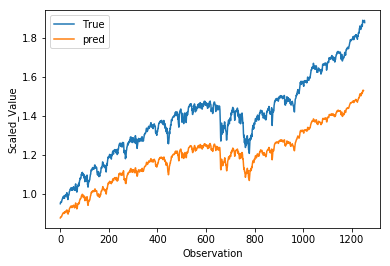

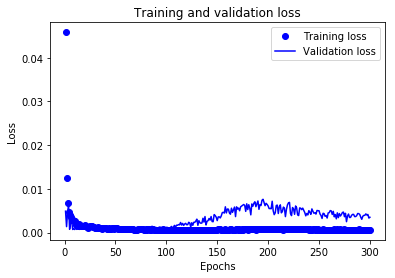

RUA_de5_tcn_clf9_n128_pe1_5:
(1254,)
The Adjusted R2 score on the Test set is:	-0.016
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.241
Model: "model_26"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_27[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

Epoch 8/300
5667/5667==============================] - 2s 342us/sample - loss: 0.0033 - val_loss: 0.0029
Epoch 9/300
5667/5667==============================] - 2s 342us/sample - loss: 0.0031 - val_loss: 9.7692e-04
Epoch 10/300
5667/5667==============================] - 2s 343us/sample - loss: 0.0029 - val_loss: 0.0011
Epoch 11/300
5667/5667==============================] - 2s 343us/sample - loss: 0.0027 - val_loss: 0.0014
Epoch 12/300
5667/5667==============================] - 2s 346us/sample - loss: 0.0021 - val_loss: 9.0902e-04
Epoch 13/300
5667/5667==============================] - 2s 345us/sample - loss: 0.0023 - val_loss: 9.0241e-04
Epoch 14/300
5667/5667==============================] - 2s 346us/sample - loss: 0.0021 - val_loss: 8.9458e-04
Epoch 15/300
5667/5667==============================] - 2s 344us/sample - loss: 0.0019 - val_loss: 0.0012
Epoch 16/300
5667/5667==============================] - 2s 344us/sample - loss: 0.0017 - val_loss: 7.4119e-04
Epoch 17/300
5667/5667======

5667/5667==============================] - 2s 344us/sample - loss: 7.8431e-04 - val_loss: 0.0055
Epoch 156/300
5667/5667==============================] - 2s 343us/sample - loss: 8.3714e-04 - val_loss: 0.0068
Epoch 157/300
5667/5667==============================] - 2s 347us/sample - loss: 7.6511e-04 - val_loss: 0.0060
Epoch 158/300
5667/5667==============================] - 2s 350us/sample - loss: 7.9875e-04 - val_loss: 0.0054
Epoch 159/300
5667/5667==============================] - 2s 341us/sample - loss: 7.7275e-04 - val_loss: 0.0061
Epoch 160/300
5667/5667==============================] - 2s 344us/sample - loss: 8.1595e-04 - val_loss: 0.0063
Epoch 161/300
5667/5667==============================] - 2s 342us/sample - loss: 8.1397e-04 - val_loss: 0.0072
Epoch 162/300
5667/5667==============================] - 2s 341us/sample - loss: 7.8758e-04 - val_loss: 0.0067
Epoch 163/300
5667/5667==============================] - 2s 338us/sample - loss: 8.4124e-04 - val_loss: 0.0057
Epoch 164/300
5

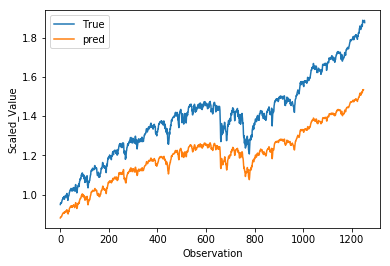

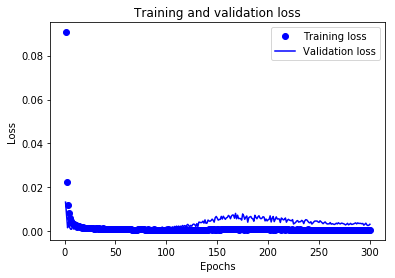

RUA_de5_tcn_clf9_n128_pe1_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.042
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.272
Model: "model_27"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_28 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_28[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 339us/sample - loss: 7.0456e-04 - val_loss: 9.9094e-04s: 5.115
Epoch 81/300
5667/5667==============================] - 2s 339us/sample - loss: 6.5065e-04 - val_loss: 0.0010
Epoch 82/300
5667/5667==============================] - 2s 339us/sample - loss: 5.8834e-04 - val_loss: 0.0011
Epoch 83/300
5667/5667==============================] - 2s 339us/sample - loss: 6.3170e-04 - val_loss: 9.1923e-04
Epoch 84/300
5667/5667==============================] - 2s 351us/sample - loss: 6.1131e-04 - val_loss: 9.6450e-04
Epoch 85/300
5667/5667==============================] - 2s 335us/sample - loss: 6.5532e-04 - val_loss: 0.0011
Epoch 86/300
5667/5667==============================] - 2s 341us/sample - loss: 6.7083e-04 - val_loss: 0.0010
Epoch 87/300
5667/5667==============================] - 2s 337us/sample - loss: 6.4519e-04 - val_loss: 8.2618e-04
Epoch 88/300
5667/5667==============================] - 2s 338us/sample - loss: 6.2338e-04 - val_loss: 9.0402

5667/5667==============================] - 2s 340us/sample - loss: 7.7730e-04 - val_loss: 0.0044
Epoch 227/300
5667/5667==============================] - 2s 339us/sample - loss: 6.9829e-04 - val_loss: 0.0050
Epoch 228/300
5667/5667==============================] - 2s 337us/sample - loss: 7.3502e-04 - val_loss: 0.0040
Epoch 229/300
5667/5667==============================] - 2s 341us/sample - loss: 6.5746e-04 - val_loss: 0.0040
Epoch 230/300
5667/5667==============================] - 2s 346us/sample - loss: 6.8766e-04 - val_loss: 0.0051
Epoch 231/300
5667/5667==============================] - 2s 335us/sample - loss: 6.6319e-04 - val_loss: 0.0049
Epoch 232/300
5667/5667==============================] - 2s 340us/sample - loss: 7.3270e-04 - val_loss: 0.0053
Epoch 233/300
5667/5667==============================] - 2s 336us/sample - loss: 7.4290e-04 - val_loss: 0.0047
Epoch 234/300
5667/5667==============================] - 2s 341us/sample - loss: 6.7272e-04 - val_loss: 0.0041
Epoch 235/300
5

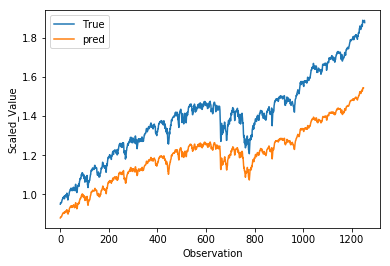

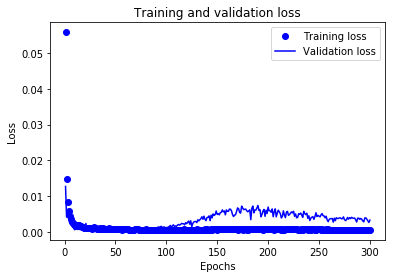

RUA_de5_tcn_clf9_n128_pe1_7:
(1254,)
The Adjusted R2 score on the Test set is:	0.060
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.276
Model: "model_28"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_29 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_29[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

Epoch 8/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0027 - val_loss: 6.5826e-04
Epoch 9/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0023 - val_loss: 7.0172e-04
Epoch 10/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0022 - val_loss: 7.2051e-04
Epoch 11/300
5667/5667==============================] - 2s 362us/sample - loss: 0.0022 - val_loss: 7.7921e-04
Epoch 12/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0019 - val_loss: 7.4827e-04
Epoch 13/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0016 - val_loss: 0.0013
Epoch 14/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0019 - val_loss: 9.4937e-04
Epoch 15/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0016 - val_loss: 8.6284e-04
Epoch 16/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0022 - val_loss: 8.5238e-04
Epoch 17/300
566

Epoch 154/300
5667/5667==============================] - 2s 357us/sample - loss: 7.7319e-04 - val_loss: 0.0049
Epoch 155/300
5667/5667==============================] - 2s 363us/sample - loss: 7.8464e-04 - val_loss: 0.0066
Epoch 156/300
5667/5667==============================] - 2s 359us/sample - loss: 7.8844e-04 - val_loss: 0.0061
Epoch 157/300
5667/5667==============================] - 2s 360us/sample - loss: 7.4315e-04 - val_loss: 0.0059
Epoch 158/300
5667/5667==============================] - 2s 357us/sample - loss: 7.5479e-04 - val_loss: 0.0065
Epoch 159/300
5667/5667==============================] - ETA: 0s - loss: 8.2629e-0 - 2s 356us/sample - loss: 8.5517e-04 - val_loss: 0.0057
Epoch 160/300
5667/5667==============================] - 2s 357us/sample - loss: 8.8418e-04 - val_loss: 0.0062
Epoch 161/300
5667/5667==============================] - 2s 359us/sample - loss: 8.2827e-04 - val_loss: 0.0061
Epoch 162/300
5667/5667==============================] - 2s 353us/sample - loss: 7.1

5667/5667==============================] - 2s 359us/sample - loss: 6.2844e-04 - val_loss: 0.0029
Epoch 300/300
5667/5667==============================] - 2s 359us/sample - loss: 6.3642e-04 - val_loss: 0.0028
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.167724
The Adjusted R2 score on the Test set is:	0.164


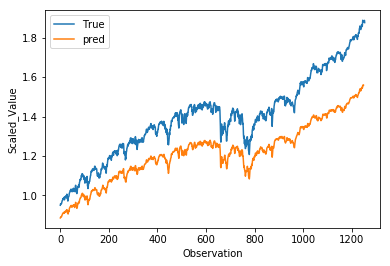

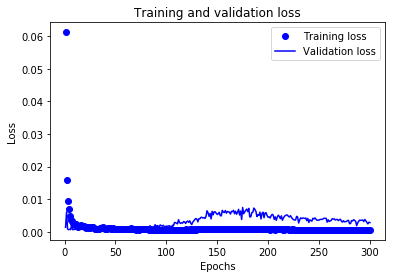

RUA_de5_tcn_clf9_n128_pe1_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.164
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.328
Model: "model_29"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_30 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_30[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

Epoch 8/300
5667/5667==============================] - 2s 353us/sample - loss: 0.0030 - val_loss: 6.6788e-04
Epoch 9/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0025 - val_loss: 7.4773e-04
Epoch 10/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0019 - val_loss: 0.0011
Epoch 11/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0021 - val_loss: 0.0014
Epoch 12/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0020 - val_loss: 0.0019
Epoch 13/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0019 - val_loss: 0.0013
Epoch 14/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0018 - val_loss: 8.3420e-04
Epoch 15/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0024 - val_loss: 0.0016
Epoch 16/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0016 - val_loss: 7.4779e-04
Epoch 17/300
5667/5667==========

5667/5667==============================] - 2s 360us/sample - loss: 7.0526e-04 - val_loss: 0.0013
Epoch 82/300
5667/5667==============================] - 2s 357us/sample - loss: 6.3862e-04 - val_loss: 0.0010
Epoch 83/300
5667/5667==============================] - 2s 356us/sample - loss: 6.1018e-04 - val_loss: 0.0016
Epoch 84/300
5667/5667==============================] - 2s 359us/sample - loss: 5.7625e-04 - val_loss: 0.0019
Epoch 85/300
5667/5667==============================] - 2s 357us/sample - loss: 6.2098e-04 - val_loss: 0.0018
Epoch 86/300
5667/5667==============================] - 2s 353us/sample - loss: 6.4087e-04 - val_loss: 0.0015
Epoch 87/300
5667/5667==============================] - 2s 357us/sample - loss: 6.7310e-04 - val_loss: 0.0012
Epoch 88/300
5667/5667==============================] - 2s 358us/sample - loss: 7.5164e-04 - val_loss: 9.8309e-04
Epoch 89/300
5667/5667==============================] - 2s 359us/sample - loss: 6.9465e-04 - val_loss: 0.0014
Epoch 90/300
5667/5

5667/5667==============================] - 2s 361us/sample - loss: 7.7609e-04 - val_loss: 0.0041
Epoch 228/300
5667/5667==============================] - 2s 358us/sample - loss: 7.1693e-04 - val_loss: 0.0041
Epoch 229/300
5667/5667==============================] - 2s 361us/sample - loss: 6.9787e-04 - val_loss: 0.0055
Epoch 230/300
5667/5667==============================] - 2s 358us/sample - loss: 7.6500e-04 - val_loss: 0.0055
Epoch 231/300
5667/5667==============================] - 2s 358us/sample - loss: 7.3120e-04 - val_loss: 0.0055
Epoch 232/300
5667/5667==============================] - 2s 357us/sample - loss: 7.9235e-04 - val_loss: 0.0055
Epoch 233/300
5667/5667==============================] - 2s 357us/sample - loss: 6.8457e-04 - val_loss: 0.0051
Epoch 234/300
5667/5667==============================] - 2s 356us/sample - loss: 6.8575e-04 - val_loss: 0.0039
Epoch 235/300
5667/5667==============================] - ETA: 0s - loss: 7.5366e-0 - 2s 356us/sample - loss: 7.6082e-04 - val_

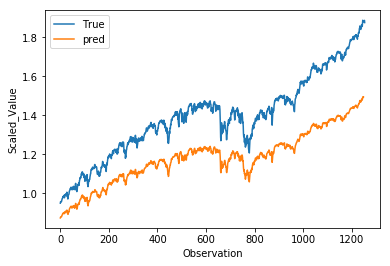

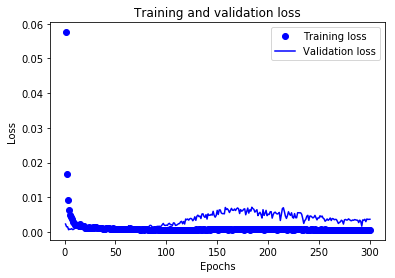

RUA_de5_tcn_clf9_n128_pe1_9:
(1254,)
The Adjusted R2 score on the Test set is:	-0.181
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.158
Model: "model_30"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_31 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_31[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 362us/sample - loss: 0.0020 - val_loss: 0.0045
Epoch 85/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0020 - val_loss: 0.0029
Epoch 86/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0020 - val_loss: 0.0026
Epoch 87/300
5667/5667==============================] - 2s 361us/sample - loss: 0.0024 - val_loss: 0.0039
Epoch 88/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0022 - val_loss: 0.0030
Epoch 89/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0021 - val_loss: 0.0039
Epoch 90/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0022 - val_loss: 0.0039
Epoch 91/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0020 - val_loss: 0.0050
Epoch 92/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0019 - val_loss: 0.0032
Epoch 93/300
5667/5667==============================] - 2s 

Epoch 234/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0018 - val_loss: 0.0105
Epoch 235/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0019 - val_loss: 0.0085
Epoch 236/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0019 - val_loss: 0.0094
Epoch 237/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0020 - val_loss: 0.0092
Epoch 238/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0017 - val_loss: 0.0081
Epoch 239/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0019 - val_loss: 0.0088
Epoch 240/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0020 - val_loss: 0.0121
Epoch 241/300
5667/5667==============================] - 2s 361us/sample - loss: 0.0019 - val_loss: 0.0113
Epoch 242/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0019 - val_loss: 0.0084
Epoch 243/300
5667/5667==============

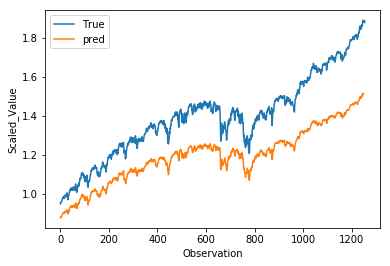

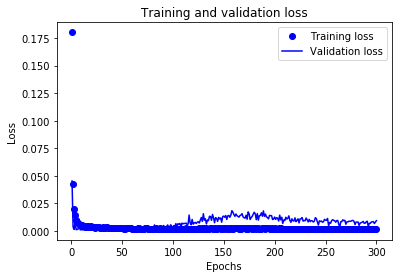

RUA_de5_tcn_clf9_n128_pe10_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.040
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.226
Model: "model_31"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_32 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_32[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

Epoch 8/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0068 - val_loss: 0.0017
Epoch 9/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0065 - val_loss: 0.0016
Epoch 10/300
5667/5667==============================] - 2s 354us/sample - loss: 0.0054 - val_loss: 0.0019
Epoch 11/300
5667/5667==============================] - 2s 354us/sample - loss: 0.0061 - val_loss: 0.0013
Epoch 12/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0053 - val_loss: 0.0015
Epoch 13/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0042 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0038 - val_loss: 0.0012
Epoch 15/300
5667/5667==============================] - 2s 352us/sample - loss: 0.0042 - val_loss: 0.0015
Epoch 16/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0040 - val_loss: 0.0011
Epoch 17/300
5667/5667==========================

Epoch 160/300
5667/5667==============================] - 2s 362us/sample - loss: 0.0019 - val_loss: 0.0136
Epoch 161/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0020 - val_loss: 0.0156
Epoch 162/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0020 - val_loss: 0.0109
Epoch 163/300
5667/5667==============================] - 2s 354us/sample - loss: 0.0023 - val_loss: 0.0120
Epoch 164/300
5667/5667==============================] - 2s 354us/sample - loss: 0.0022 - val_loss: 0.0142
Epoch 165/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0020 - val_loss: 0.0165
Epoch 166/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0020 - val_loss: 0.0130
Epoch 167/300
5667/5667==============================] - 2s 352us/sample - loss: 0.0020 - val_loss: 0.0102
Epoch 168/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0021 - val_loss: 0.0145
Epoch 169/300
5667/5667==============

Epoch 236/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0022 - val_loss: 0.0130
Epoch 237/300
5667/5667==============================] - 2s 359us/sample - loss: 0.0019 - val_loss: 0.0070
Epoch 238/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0021 - val_loss: 0.0094
Epoch 239/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0020 - val_loss: 0.0121
Epoch 240/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0021 - val_loss: 0.0117
Epoch 241/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0021 - val_loss: 0.0083
Epoch 242/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0020 - val_loss: 0.0094
Epoch 243/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0020 - val_loss: 0.0108
Epoch 244/300
5667/5667==============================] - 2s 353us/sample - loss: 0.0020 - val_loss: 0.0110
Epoch 245/300
5667/5667==============

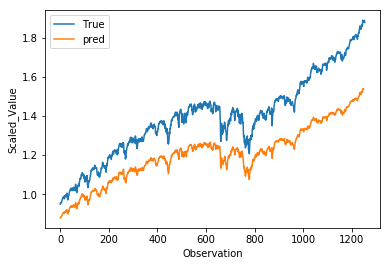

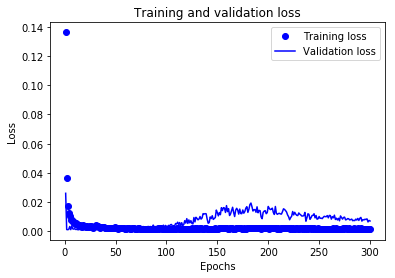

RUA_de5_tcn_clf9_n128_pe10_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.051
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	0.275
Model: "model_32"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_33 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_33[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 353us/sample - loss: 0.0078 - val_loss: 0.0020
Epoch 9/300
5667/5667==============================] - 2s 352us/sample - loss: 0.0071 - val_loss: 0.0014
Epoch 10/300
5667/5667==============================] - 2s 346us/sample - loss: 0.0072 - val_loss: 0.0015
Epoch 11/300
5667/5667==============================] - 2s 352us/sample - loss: 0.0065 - val_loss: 0.0013
Epoch 12/300
5667/5667==============================] - 2s 365us/sample - loss: 0.0059 - val_loss: 0.0013
Epoch 13/300
5667/5667==============================] - ETA: 0s - loss: 0.0062- ETA: 0s - - 2s 359us/sample - loss: 0.0065 - val_loss: 0.0016
Epoch 14/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0061 - val_loss: 0.0013
Epoch 15/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0051 - val_loss: 0.0014
Epoch 16/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0058 - val_loss: 0.0013
Epoch 17/300
5667/5667==

Epoch 85/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0029 - val_loss: 0.0025
Epoch 86/300
5667/5667==============================] - 2s 354us/sample - loss: 0.0027 - val_loss: 0.0025
Epoch 87/300
5667/5667==============================] - 2s 354us/sample - loss: 0.0026 - val_loss: 0.0040
Epoch 88/300
5667/5667==============================] - 2s 353us/sample - loss: 0.0020 - val_loss: 0.0033
Epoch 89/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0019 - val_loss: 0.0050
Epoch 90/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0019 - val_loss: 0.0035
Epoch 91/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0021 - val_loss: 0.0039
Epoch 92/300
5667/5667==============================] - 2s 353us/sample - loss: 0.0023 - val_loss: 0.0038
Epoch 93/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0024 - val_loss: 0.0053
Epoch 94/300
5667/5667========================

5667/5667==============================] - 2s 367us/sample - loss: 0.0020 - val_loss: 0.0141
Epoch 162/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0022 - val_loss: 0.0121
Epoch 163/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0023 - val_loss: 0.0108
Epoch 164/300
5667/5667==============================] - 2s 353us/sample - loss: 0.0022 - val_loss: 0.0145
Epoch 165/300
5667/5667==============================] - 2s 347us/sample - loss: 0.0021 - val_loss: 0.0109
Epoch 166/300
5667/5667==============================] - 2s 358us/sample - loss: 0.0024 - val_loss: 0.0144
Epoch 167/300
5667/5667==============================] - 2s 356us/sample - loss: 0.0023 - val_loss: 0.0176
Epoch 168/300
5667/5667==============================] - 2s 355us/sample - loss: 0.0024 - val_loss: 0.0186
Epoch 169/300
5667/5667==============================] - 2s 357us/sample - loss: 0.0024 - val_loss: 0.0161
Epoch 170/300
5667/5667============================

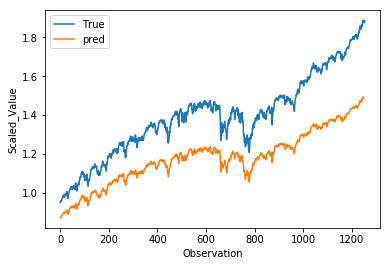

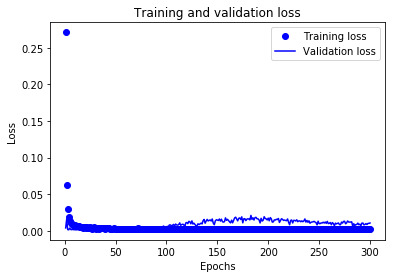

RUA_de5_tcn_clf9_n128_pe10_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.224
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.135
Model: "model_33"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_34 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_34[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 384us/sample - loss: 0.0069 - val_loss: 0.0015
Epoch 9/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0061 - val_loss: 0.0022
Epoch 10/300
5667/5667==============================] - 2s 370us/sample - loss: 0.0059 - val_loss: 0.0020
Epoch 11/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0046 - val_loss: 0.0043
Epoch 12/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0042 - val_loss: 0.0012
Epoch 13/300
5667/5667==============================] - 2s 365us/sample - loss: 0.0049 - val_loss: 0.0031
Epoch 14/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0048 - val_loss: 0.0011
Epoch 15/300
5667/5667==============================] - ETA: 0s - loss: 0.005 - 2s 370us/sample - loss: 0.0059 - val_loss: 0.0013
Epoch 16/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0051 - val_loss: 0.0037
Epoch 17/300
5667/5667==============

5667/5667==============================] - 2s 368us/sample - loss: 0.0021 - val_loss: 0.0123
Epoch 161/300
5667/5667==============================] - 2s 370us/sample - loss: 0.0023 - val_loss: 0.0111
Epoch 162/300
5667/5667==============================] - 2s 367us/sample - loss: 0.0024 - val_loss: 0.0154
Epoch 163/300
5667/5667==============================] - 2s 372us/sample - loss: 0.0023 - val_loss: 0.0162
Epoch 164/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0023 - val_loss: 0.0184
Epoch 165/300
5667/5667==============================] - 2s 370us/sample - loss: 0.0025 - val_loss: 0.0147
Epoch 166/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0022 - val_loss: 0.0156
Epoch 167/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0024 - val_loss: 0.0137
Epoch 168/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0023 - val_loss: 0.0135
Epoch 169/300
5667/5667============================

Epoch 236/300
5667/5667==============================] - 2s 367us/sample - loss: 0.0019 - val_loss: 0.0089
Epoch 237/300
5667/5667==============================] - 2s 381us/sample - loss: 0.0020 - val_loss: 0.0126
Epoch 238/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0020 - val_loss: 0.0106
Epoch 239/300
5667/5667==============================] - 2s 370us/sample - loss: 0.0021 - val_loss: 0.0122
Epoch 240/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0020 - val_loss: 0.0114
Epoch 241/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0018 - val_loss: 0.0099
Epoch 242/300
5667/5667==============================] - 2s 370us/sample - loss: 0.0021 - val_loss: 0.0109
Epoch 243/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0020 - val_loss: 0.0122
Epoch 244/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0021 - val_loss: 0.0081
Epoch 245/300
5667/5667==============

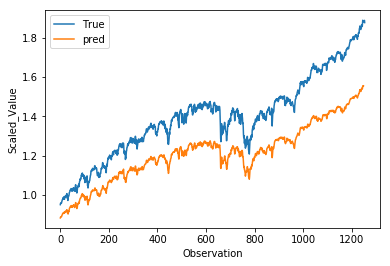

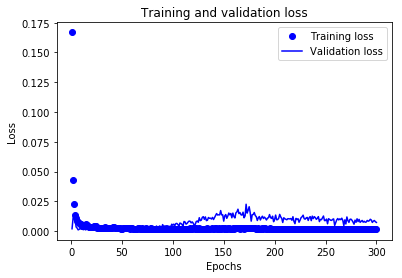

RUA_de5_tcn_clf9_n128_pe10_3:
(1254,)
The Adjusted R2 score on the Test set is:	0.125
The Custom  sign score on the Test set is:	0.493
The Custom  R2 score on the Test set is:	0.309
Model: "model_34"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_35 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_35[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 364us/sample - loss: 0.0058 - val_loss: 0.0012
Epoch 9/300
5667/5667==============================] - 2s 365us/sample - loss: 0.0052 - val_loss: 0.0034
Epoch 10/300
5667/5667==============================] - 2s 365us/sample - loss: 0.0051 - val_loss: 0.0015
Epoch 11/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0046 - val_loss: 0.0012
Epoch 12/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0047 - val_loss: 0.0033
Epoch 13/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0044 - val_loss: 0.0026
Epoch 14/300
5667/5667==============================] - 2s 361us/sample - loss: 0.0042 - val_loss: 0.0018
Epoch 15/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0041 - val_loss: 0.0011
Epoch 16/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0038 - val_loss: 0.0013
Epoch 17/300
5667/5667==============================] - 2s 3

5667/5667==============================] - 2s 361us/sample - loss: 0.0022 - val_loss: 0.0140
Epoch 160/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0021 - val_loss: 0.0149
Epoch 161/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0022 - val_loss: 0.0179
Epoch 162/300
5667/5667==============================] - ETA: 0s - loss: 0.002 - 2s 366us/sample - loss: 0.0024 - val_loss: 0.0167
Epoch 163/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0023 - val_loss: 0.0207
Epoch 164/300
5667/5667==============================] - 2s 361us/sample - loss: 0.0022 - val_loss: 0.0144
Epoch 165/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0023 - val_loss: 0.0136
Epoch 166/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0025 - val_loss: 0.0126
Epoch 167/300
5667/5667==============================] - 2s 361us/sample - loss: 0.0024 - val_loss: 0.0155
Epoch 168/300
5667/5667====

5667/5667==============================] - 2s 351us/sample - loss: 0.0019 - val_loss: 0.0106
Epoch 236/300
5667/5667==============================] - 2s 350us/sample - loss: 0.0018 - val_loss: 0.0085
Epoch 237/300
5667/5667==============================] - 2s 362us/sample - loss: 0.0021 - val_loss: 0.0093
Epoch 238/300
5667/5667==============================] - 2s 365us/sample - loss: 0.0017 - val_loss: 0.0119
Epoch 239/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0020 - val_loss: 0.0117
Epoch 240/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0019 - val_loss: 0.0108A: 0s - loss: 0.00 - ETA: 0s - loss:
Epoch 241/300
5667/5667==============================] - 2s 362us/sample - loss: 0.0020 - val_loss: 0.0111
Epoch 242/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0019 - val_loss: 0.0101
Epoch 243/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0018 - val_loss: 0.0106
Epoch 244/300
5

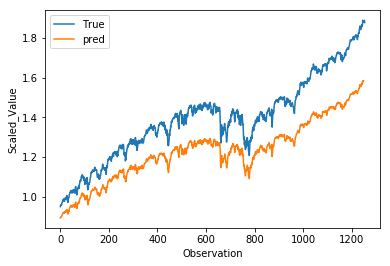

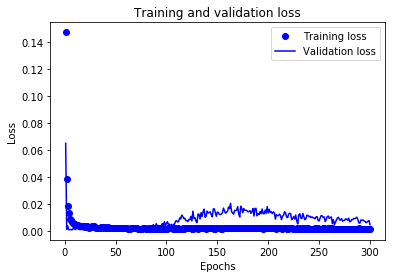

RUA_de5_tcn_clf9_n128_pe10_4:
(1254,)
The Adjusted R2 score on the Test set is:	0.276
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.386
Model: "model_35"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_36 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_36[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 364us/sample - loss: 0.0075 - val_loss: 0.0020
Epoch 9/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0069 - val_loss: 0.0017
Epoch 10/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0063 - val_loss: 0.0031
Epoch 11/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0050 - val_loss: 0.0012
Epoch 12/300
5667/5667==============================] - 2s 362us/sample - loss: 0.0060 - val_loss: 0.0013
Epoch 13/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0051 - val_loss: 0.0015
Epoch 14/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0050 - val_loss: 0.0017
Epoch 15/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0050 - val_loss: 0.0014
Epoch 16/300
5667/5667==============================] - 2s 360us/sample - loss: 0.0048 - val_loss: 0.0018
Epoch 17/300
5667/5667==============================] - 2s 3

5667/5667==============================] - 2s 374us/sample - loss: 0.0023 - val_loss: 0.0147
Epoch 161/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0022 - val_loss: 0.0156
Epoch 162/300
5667/5667==============================] - 2s 367us/sample - loss: 0.0022 - val_loss: 0.0151
Epoch 163/300
5667/5667==============================] - 2s 369us/sample - loss: 0.0021 - val_loss: 0.0132
Epoch 164/300
5667/5667==============================] - 2s 364us/sample - loss: 0.0022 - val_loss: 0.0193
Epoch 165/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0024 - val_loss: 0.0130
Epoch 166/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0022 - val_loss: 0.0160
Epoch 167/300
5667/5667==============================] - 2s 363us/sample - loss: 0.0022 - val_loss: 0.0191
Epoch 168/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0021 - val_loss: 0.0163
Epoch 169/300
5667/5667============================

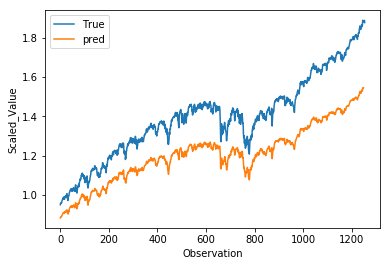

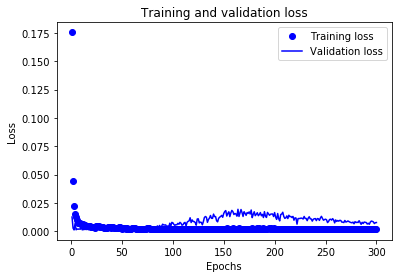

RUA_de5_tcn_clf9_n128_pe10_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.076
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.286
Model: "model_36"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_37 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_37[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 376us/sample - loss: 0.0019 - val_loss: 0.0046
Epoch 83/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0021 - val_loss: 0.0039
Epoch 84/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0022 - val_loss: 0.0042
Epoch 85/300
5667/5667==============================] - 2s 375us/sample - loss: 0.0024 - val_loss: 0.0034
Epoch 86/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0018 - val_loss: 0.0043
Epoch 87/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0020 - val_loss: 0.0038
Epoch 88/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0019 - val_loss: 0.0058
Epoch 89/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0018 - val_loss: 0.0062
Epoch 90/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0018 - val_loss: 0.0047
Epoch 91/300
5667/5667==============================] - 2s 

5667/5667==============================] - 2s 375us/sample - loss: 0.0020 - val_loss: 0.0103
Epoch 233/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0019 - val_loss: 0.0113
Epoch 234/300
5667/5667==============================] - 2s 377us/sample - loss: 0.0020 - val_loss: 0.0093
Epoch 235/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0020 - val_loss: 0.0093
Epoch 236/300
5667/5667==============================] - 2s 376us/sample - loss: 0.0018 - val_loss: 0.0100
Epoch 237/300
5667/5667==============================] - 2s 377us/sample - loss: 0.0020 - val_loss: 0.0098
Epoch 238/300
5667/5667==============================] - 2s 375us/sample - loss: 0.0020 - val_loss: 0.0080
Epoch 239/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0020 - val_loss: 0.0117
Epoch 240/300
5667/5667==============================] - 2s 372us/sample - loss: 0.0019 - val_loss: 0.0061
Epoch 241/300
5667/5667============================

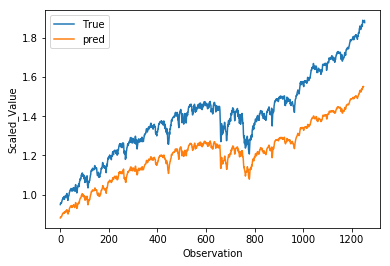

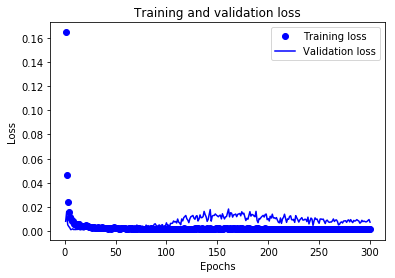

RUA_de5_tcn_clf9_n128_pe10_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.113
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.304
Model: "model_37"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_38 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_38[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 377us/sample - loss: 0.0084 - val_loss: 0.0011
Epoch 9/300
5667/5667==============================] - 2s 378us/sample - loss: 0.0062 - val_loss: 0.0016
Epoch 10/300
5667/5667==============================] - 2s 378us/sample - loss: 0.0061 - val_loss: 0.0021
Epoch 11/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0055 - val_loss: 0.0016
Epoch 12/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0063 - val_loss: 0.0012
Epoch 13/300
5667/5667==============================] - 2s 382us/sample - loss: 0.0052 - val_loss: 0.0021
Epoch 14/300
5667/5667==============================] - ETA: 0s - loss: 0.0056    - ETA: - 2s 384us/sample - loss: 0.0057 - val_loss: 0.0012
Epoch 15/300
5667/5667==============================] - ETA: 0s - loss: 0.005 - ETA: 0s - loss: 0.005 - 2s 381us/sample - loss: 0.0056 - val_loss: 0.0015
Epoch 16/300
5667/5667==============================] - 2s 382us/sample - loss: 0.0

Epoch 160/300
5667/5667==============================] - 2s 380us/sample - loss: 0.0020 - val_loss: 0.0163
Epoch 161/300
5667/5667==============================] - 2s 381us/sample - loss: 0.0024 - val_loss: 0.0132
Epoch 162/300
5667/5667==============================] - 2s 376us/sample - loss: 0.0022 - val_loss: 0.0139
Epoch 163/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0021 - val_loss: 0.0142
Epoch 164/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0021 - val_loss: 0.0139
Epoch 165/300
5667/5667==============================] - 2s 380us/sample - loss: 0.0020 - val_loss: 0.0171
Epoch 166/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0023 - val_loss: 0.0125
Epoch 167/300
5667/5667==============================] - 2s 380us/sample - loss: 0.0022 - val_loss: 0.0149
Epoch 168/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0023 - val_loss: 0.0168
Epoch 169/300
5667/5667==============

Epoch 236/300
5667/5667==============================] - 2s 380us/sample - loss: 0.0020 - val_loss: 0.0118
Epoch 237/300
5667/5667==============================] - 2s 382us/sample - loss: 0.0020 - val_loss: 0.0106
Epoch 238/300
5667/5667==============================] - 2s 380us/sample - loss: 0.0019 - val_loss: 0.0079
Epoch 239/300
5667/5667==============================] - 2s 386us/sample - loss: 0.0019 - val_loss: 0.0110
Epoch 240/300
5667/5667==============================] - 2s 381us/sample - loss: 0.0019 - val_loss: 0.0078
Epoch 241/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0020 - val_loss: 0.0111
Epoch 242/300
5667/5667==============================] - 2s 382us/sample - loss: 0.0021 - val_loss: 0.0112
Epoch 243/300
5667/5667==============================] - 2s 378us/sample - loss: 0.0019 - val_loss: 0.0101
Epoch 244/300
5667/5667==============================] - 2s 379us/sample - loss: 0.0019 - val_loss: 0.0103
Epoch 245/300
5667/5667==============

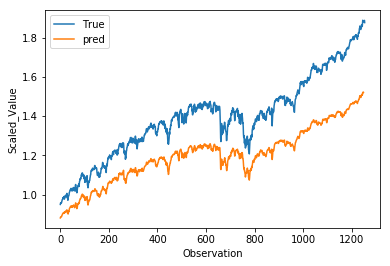

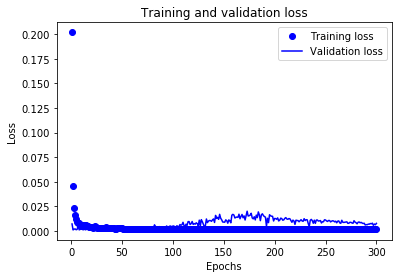

RUA_de5_tcn_clf9_n128_pe10_7:
(1254,)
The Adjusted R2 score on the Test set is:	-0.007
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.245
Model: "model_38"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_39 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_39[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 374us/sample - loss: 0.0063 - val_loss: 0.0050
Epoch 9/300
5667/5667==============================] - 2s 389us/sample - loss: 0.0077 - val_loss: 0.0048
Epoch 10/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0058 - val_loss: 0.0027
Epoch 11/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0047 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 376us/sample - loss: 0.0054 - val_loss: 0.0012
Epoch 13/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0057 - val_loss: 0.0013
Epoch 14/300
5667/5667==============================] - 2s 365us/sample - loss: 0.0057 - val_loss: 0.0013
Epoch 15/300
5667/5667==============================] - 2s 372us/sample - loss: 0.0053 - val_loss: 0.0018
Epoch 16/300
5667/5667==============================] - 2s 376us/sample - loss: 0.0047 - val_loss: 0.0011
Epoch 17/300
5667/5667==============================] - 2s 3

Epoch 85/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0019 - val_loss: 0.0022
Epoch 86/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0021 - val_loss: 0.0025
Epoch 87/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0021 - val_loss: 0.0031
Epoch 88/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0019 - val_loss: 0.0024
Epoch 89/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0018 - val_loss: 0.0037
Epoch 90/300
5667/5667==============================] - 2s 375us/sample - loss: 0.0020 - val_loss: 0.0016
Epoch 91/300
5667/5667==============================] - 2s 374us/sample - loss: 0.0020 - val_loss: 0.0035
Epoch 92/300
5667/5667==============================] - 2s 375us/sample - loss: 0.0021 - val_loss: 0.0029
Epoch 93/300
5667/5667==============================] - 2s 375us/sample - loss: 0.0021 - val_loss: 0.0040
Epoch 94/300
5667/5667========================

Epoch 235/300
5667/5667==============================] - 2s 368us/sample - loss: 0.0023 - val_loss: 0.0138
Epoch 236/300
5667/5667==============================] - 2s 376us/sample - loss: 0.0024 - val_loss: 0.0122
Epoch 237/300
5667/5667==============================] - 2s 376us/sample - loss: 0.0023 - val_loss: 0.0132
Epoch 238/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0021 - val_loss: 0.0126
Epoch 239/300
5667/5667==============================] - 2s 372us/sample - loss: 0.0022 - val_loss: 0.0145
Epoch 240/300
5667/5667==============================] - 2s 371us/sample - loss: 0.0022 - val_loss: 0.0121
Epoch 241/300
5667/5667==============================] - 2s 373us/sample - loss: 0.0021 - val_loss: 0.0110
Epoch 242/300
5667/5667==============================] - 2s 377us/sample - loss: 0.0020 - val_loss: 0.0124
Epoch 243/300
5667/5667==============================] - 2s 378us/sample - loss: 0.0023 - val_loss: 0.0111
Epoch 244/300
5667/5667==============

In [ ]:
neurons=[128]
penalties=[1, 10]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_1[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation (Activation)         (None, 1, 128)       0           tcn_d_causal_conv_1_tanh_s0[0][0]
______________________________________________________________________________________________

5667/5667==============================] - 2s 291us/sample - loss: 0.0227 - val_loss: 0.0108TA: 1s - loss: 0.0 - ETA: 0
Epoch 67/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0260 - val_loss: 0.0086
Epoch 68/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0235 - val_loss: 0.0072 0s - loss - ETA: 0s - loss:  - ETA: 0s - loss: 0.02
Epoch 69/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0211 - val_loss: 0.0076TA: 0s - loss: 0.0 - ETA: 0s - loss:
Epoch 70/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0214 - val_loss: 0.0094 
Epoch 71/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0227 - val_loss: 0.0074: 1s - - ETA: 0s - loss: 0.0 - ETA: 0s - loss: 0.0
Epoch 72/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0222 - val_loss: 0.0110 loss: 0.0 - ETA: 0s - l
Epoch 73/300
5667/5667==============================] - 2s 290us/sample - loss: 0

5667/5667==============================] - 2s 290us/sample - loss: 0.0221 - val_loss: 0.1086TA: 1s - loss - ETA: 0s -
Epoch 181/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0261 - val_loss: 0.0846TA: 0s - loss:  - ETA: 0s - loss: 
Epoch 182/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0246 - val_loss: 0.0751A: 1s - loss: 0.00 - ETA: 0s - loss: 0 - ETA: 0s - loss: 0.01 - ETA: 0s - loss: 0.0 - ETA: 0s - loss: 0.015 - ETA: 0s - loss: 0.015 - ETA: 0s - loss: 0.0
Epoch 183/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0211 - val_loss: 0.0932
Epoch 184/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0236 - val_loss: 0.0653s - loss: 0.011 - ETA: 0s - los - ETA: 0s - loss: 0
Epoch 185/300
5667/5667==============================] - 2s 289us/sample - loss: 0.0235 - val_loss: 0.0603TA: 1s - loss: 0.0 - ETA: 0s - loss: 0.012 - ETA: 0s - l - ETA: 0s - loss: 0.
Epoch 186/300
5667/5667=========

5667/5667==============================] - 2s 317us/sample - loss: 0.0203 - val_loss: 0.0712
Epoch 286/300
5667/5667==============================] - 2s 331us/sample - loss: 0.0190 - val_loss: 0.0580
Epoch 287/300
5667/5667==============================] - 2s 320us/sample - loss: 0.0179 - val_loss: 0.0812
Epoch 288/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0177 - val_loss: 0.0683
Epoch 289/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0193 - val_loss: 0.0564
Epoch 290/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0188 - val_loss: 0.0738
Epoch 291/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0193 - val_loss: 0.0506
Epoch 292/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0165 - val_loss: 0.0738
Epoch 293/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0186 - val_loss: 0.0597
Epoch 294/300
5667/5667============================

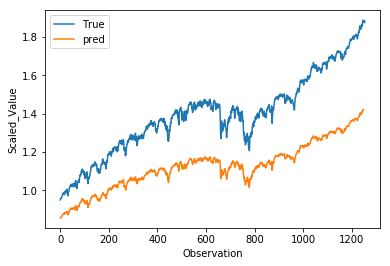

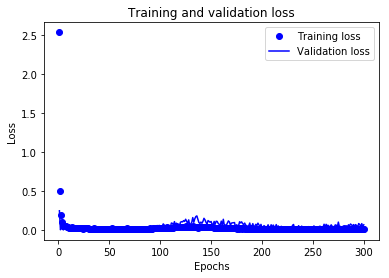

RUA_de5_tcn_clf9_n128_pe100_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.868
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	-0.185
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_2[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 301us/sample - loss: 0.0328 - val_loss: 0.0155
Epoch 9/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0377 - val_loss: 0.0210
Epoch 10/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0322 - val_loss: 0.0117
Epoch 11/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0297 - val_loss: 0.0114
Epoch 12/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0317 - val_loss: 0.0096
Epoch 13/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0301 - val_loss: 0.0103
Epoch 14/300
5667/5667==============================] - ETA: 0s - loss: 0.029 - 2s 299us/sample - loss: 0.0304 - val_loss: 0.0052
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0332 - val_loss: 0.0064
Epoch 16/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0282 - val_loss: 0.0051
Epoch 17/300
5667/5667==============

Epoch 85/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0165 - val_loss: 0.0157
Epoch 86/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0176 - val_loss: 0.0107
Epoch 87/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0163 - val_loss: 0.0176
Epoch 88/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0165 - val_loss: 0.0102
Epoch 89/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0163 - val_loss: 0.0102
Epoch 90/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0155 - val_loss: 0.0237
Epoch 91/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0173 - val_loss: 0.0103
Epoch 92/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0184 - val_loss: 0.0140
Epoch 93/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0173 - val_loss: 0.0164
Epoch 94/300
5667/5667========================

Epoch 161/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0252 - val_loss: 0.0755
Epoch 162/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0226 - val_loss: 0.0311
Epoch 163/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0223 - val_loss: 0.0679
Epoch 164/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0219 - val_loss: 0.0509
Epoch 165/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0216 - val_loss: 0.0742
Epoch 166/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0217 - val_loss: 0.0634
Epoch 167/300
5667/5667==============================] - 2s 293us/sample - loss: 0.0175 - val_loss: 0.0802
Epoch 168/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0222 - val_loss: 0.0416
Epoch 169/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0224 - val_loss: 0.0736
Epoch 170/300
5667/5667==============

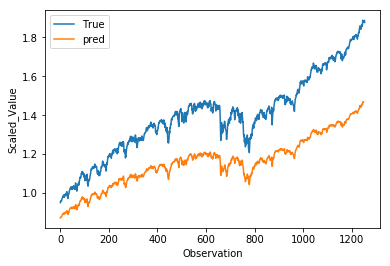

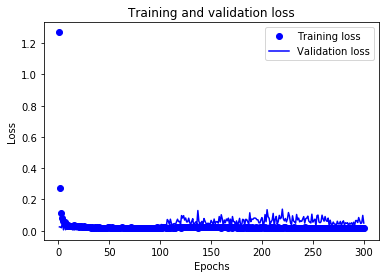

RUA_de5_tcn_clf9_n128_pe100_1:
(1254,)
The Adjusted R2 score on the Test set is:	-0.462
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.020
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_3[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 333us/sample - loss: 0.0461 - val_loss: 0.0789
Epoch 9/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0512 - val_loss: 0.0050
Epoch 10/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0498 - val_loss: 0.0294
Epoch 11/300
5667/5667==============================] - 2s 317us/sample - loss: 0.0356 - val_loss: 0.0048
Epoch 12/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0327 - val_loss: 0.0225
Epoch 13/300
5667/5667==============================] - 2s 319us/sample - loss: 0.0311 - val_loss: 0.0074
Epoch 14/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0290 - val_loss: 0.0189
Epoch 15/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0303 - val_loss: 0.0086
Epoch 16/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0233 - val_loss: 0.0064
Epoch 17/300
5667/5667==============================] - 2s 3

Epoch 161/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0226 - val_loss: 0.0733
Epoch 162/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0226 - val_loss: 0.0531
Epoch 163/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0244 - val_loss: 0.0880
Epoch 164/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0214 - val_loss: 0.1255
Epoch 165/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0224 - val_loss: 0.1165
Epoch 166/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0257 - val_loss: 0.0784
Epoch 167/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0245 - val_loss: 0.0947
Epoch 168/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0233 - val_loss: 0.1090
Epoch 169/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0245 - val_loss: 0.1197
Epoch 170/300
5667/5667==============

5667/5667==============================] - 2s 308us/sample - loss: 0.0190 - val_loss: 0.0951
Epoch 238/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0182 - val_loss: 0.1101
Epoch 239/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0181 - val_loss: 0.0885
Epoch 240/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0188 - val_loss: 0.0606
Epoch 241/300
5667/5667==============================] - 2s 336us/sample - loss: 0.0180 - val_loss: 0.0753
Epoch 242/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0186 - val_loss: 0.0650
Epoch 243/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0185 - val_loss: 0.1054
Epoch 244/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0189 - val_loss: 0.1135
Epoch 245/300
5667/5667==============================] - 2s 366us/sample - loss: 0.0209 - val_loss: 0.1167
Epoch 246/300
5667/5667============================

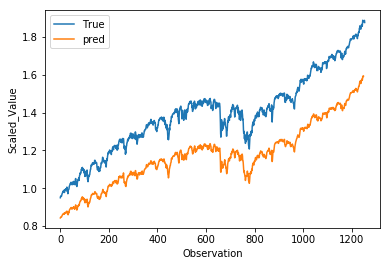

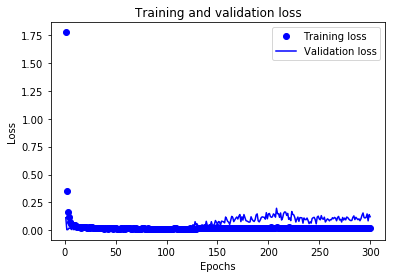

RUA_de5_tcn_clf9_n128_pe100_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.195
The Custom  sign score on the Test set is:	0.494
The Custom  R2 score on the Test set is:	0.149
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_4[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 282us/sample - loss: 0.0516 - val_loss: 0.0263
Epoch 9/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0380 - val_loss: 0.0143
Epoch 10/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0302 - val_loss: 0.0202
Epoch 11/300
5667/5667==============================] - 2s 281us/sample - loss: 0.0323 - val_loss: 0.0101
Epoch 12/300
5667/5667==============================] - 2s 280us/sample - loss: 0.0234 - val_loss: 0.0069
Epoch 13/300
5667/5667==============================] - 2s 279us/sample - loss: 0.0313 - val_loss: 0.0759
Epoch 14/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0246 - val_loss: 0.0073
Epoch 15/300
5667/5667==============================] - 2s 282us/sample - loss: 0.0255 - val_loss: 0.0085
Epoch 16/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0305 - val_loss: 0.0073
Epoch 17/300
5667/5667==============================] - 2s 2

5667/5667==============================] - 2s 287us/sample - loss: 0.0291 - val_loss: 0.0851
Epoch 162/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0264 - val_loss: 0.0729
Epoch 163/300
5667/5667==============================] - 2s 290us/sample - loss: 0.0302 - val_loss: 0.0342
Epoch 164/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0293 - val_loss: 0.0564
Epoch 165/300
5667/5667==============================] - 2s 285us/sample - loss: 0.0277 - val_loss: 0.0661
Epoch 166/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0314 - val_loss: 0.0792
Epoch 167/300
5667/5667==============================] - 2s 283us/sample - loss: 0.0283 - val_loss: 0.0902
Epoch 168/300
5667/5667==============================] - 2s 284us/sample - loss: 0.0290 - val_loss: 0.1136
Epoch 169/300
5667/5667==============================] - 2s 284us/sample - loss: 0.0305 - val_loss: 0.0830
Epoch 170/300
5667/5667============================

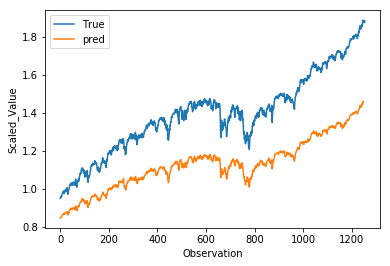

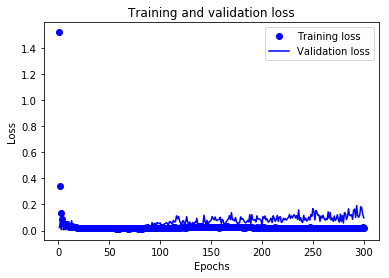

RUA_de5_tcn_clf9_n128_pe100_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.785
The Custom  sign score on the Test set is:	0.494
The Custom  R2 score on the Test set is:	-0.146
Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_5[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

Epoch 8/300
5667/5667==============================] - 2s 294us/sample - loss: 0.0342 - val_loss: 0.0187
Epoch 9/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0286 - val_loss: 0.0096
Epoch 10/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0356 - val_loss: 0.0059
Epoch 11/300
5667/5667==============================] - 2s 295us/sample - loss: 0.0240 - val_loss: 0.0085
Epoch 12/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0254 - val_loss: 0.0055
Epoch 13/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0322 - val_loss: 0.0208
Epoch 14/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0235 - val_loss: 0.0058
Epoch 15/300
5667/5667==============================] - 2s 292us/sample - loss: 0.0238 - val_loss: 0.0063
Epoch 16/300
5667/5667==============================] - 2s 291us/sample - loss: 0.0224 - val_loss: 0.0054
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 2s 287us/sample - loss: 0.0134 - val_loss: 0.0199
Epoch 86/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0153 - val_loss: 0.0214
Epoch 87/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0161 - val_loss: 0.0219
Epoch 88/300
5667/5667==============================] - 2s 286us/sample - loss: 0.0159 - val_loss: 0.0119
Epoch 89/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0139 - val_loss: 0.0156
Epoch 90/300
5667/5667==============================] - 2s 288us/sample - loss: 0.0164 - val_loss: 0.0125
Epoch 91/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0168 - val_loss: 0.0134
Epoch 92/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0159 - val_loss: 0.0133
Epoch 93/300
5667/5667==============================] - 2s 287us/sample - loss: 0.0178 - val_loss: 0.0186
Epoch 94/300
5667/5667==============================] - 2s 

5667/5667==============================] - 2s 300us/sample - loss: 0.0228 - val_loss: 0.0376
Epoch 238/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0199 - val_loss: 0.0963
Epoch 239/300
5667/5667==============================] - 2s 296us/sample - loss: 0.0226 - val_loss: 0.0632
Epoch 240/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0183 - val_loss: 0.0755
Epoch 241/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0195 - val_loss: 0.0672
Epoch 242/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0189 - val_loss: 0.0933
Epoch 243/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0198 - val_loss: 0.0476
Epoch 244/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0187 - val_loss: 0.1047
Epoch 245/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0208 - val_loss: 0.0616
Epoch 246/300
5667/5667============================

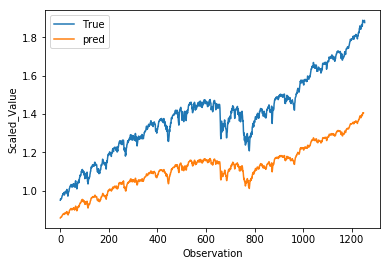

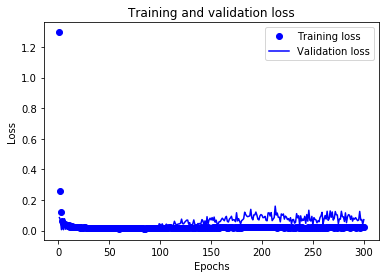

RUA_de5_tcn_clf9_n128_pe100_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.964
The Custom  sign score on the Test set is:	0.503
The Custom  R2 score on the Test set is:	-0.231
Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_6[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

Epoch 8/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0383 - val_loss: 0.0225
Epoch 9/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0313 - val_loss: 0.0087
Epoch 10/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0357 - val_loss: 0.0257
Epoch 11/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0323 - val_loss: 0.0068
Epoch 12/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0286 - val_loss: 0.0082
Epoch 13/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0247 - val_loss: 0.0073
Epoch 14/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0244 - val_loss: 0.0172
Epoch 15/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0209 - val_loss: 0.0055
Epoch 16/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0263 - val_loss: 0.0183
Epoch 17/300
5667/5667==========================

Epoch 161/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0231 - val_loss: 0.0578
Epoch 162/300
5667/5667==============================] - ETA: 0s - loss: 0.022 - 2s 301us/sample - loss: 0.0230 - val_loss: 0.0365
Epoch 163/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0237 - val_loss: 0.0285
Epoch 164/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0234 - val_loss: 0.0396
Epoch 165/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0234 - val_loss: 0.0226
Epoch 166/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0230 - val_loss: 0.0581
Epoch 167/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0211 - val_loss: 0.0254
Epoch 168/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0189 - val_loss: 0.0420
Epoch 169/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0225 - val_loss: 0.0320
Epoch 170/300

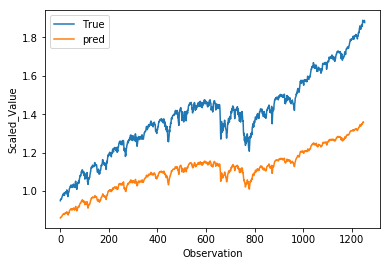

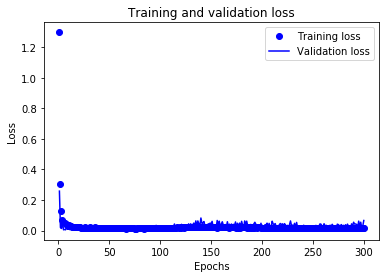

RUA_de5_tcn_clf9_n128_pe100_5:
(1254,)
The Adjusted R2 score on the Test set is:	-1.134
The Custom  sign score on the Test set is:	0.494
The Custom  R2 score on the Test set is:	-0.320
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_7[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 301us/sample - loss: 0.0433 - val_loss: 0.0469
Epoch 9/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0339 - val_loss: 0.0080
Epoch 10/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0347 - val_loss: 0.0199
Epoch 11/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0302 - val_loss: 0.0143
Epoch 12/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0313 - val_loss: 0.0240
Epoch 13/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0360 - val_loss: 0.0516
Epoch 14/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0250 - val_loss: 0.0063
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0296 - val_loss: 0.0148
Epoch 16/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0232 - val_loss: 0.0127
Epoch 17/300
5667/5667==============================] - 2s 3

5667/5667==============================] - 2s 304us/sample - loss: 0.0202 - val_loss: 0.1002
Epoch 162/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0234 - val_loss: 0.0198
Epoch 163/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0216 - val_loss: 0.0254
Epoch 164/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0240 - val_loss: 0.0169
Epoch 165/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0220 - val_loss: 0.0714
Epoch 166/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0249 - val_loss: 0.0366
Epoch 167/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0216 - val_loss: 0.0865
Epoch 168/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0239 - val_loss: 0.0445
Epoch 169/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0214 - val_loss: 0.0551
Epoch 170/300
5667/5667============================

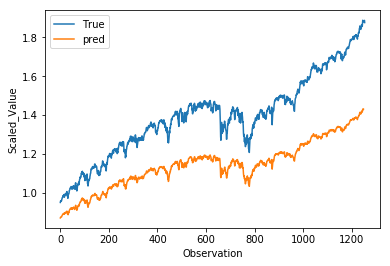

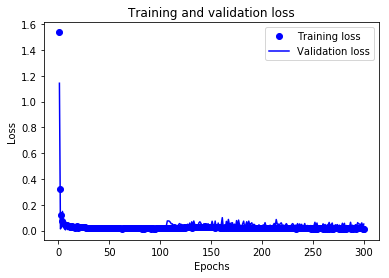

RUA_de5_tcn_clf9_n128_pe100_6:
(1254,)
The Adjusted R2 score on the Test set is:	-0.652
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	-0.077
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_8[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 301us/sample - loss: 0.0398 - val_loss: 0.0067
Epoch 9/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0348 - val_loss: 0.0092
Epoch 10/300
5667/5667==============================] - ETA: 0s - loss: 0.035 - 2s 303us/sample - loss: 0.0368 - val_loss: 0.0200
Epoch 11/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0353 - val_loss: 0.0074
Epoch 12/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0362 - val_loss: 0.0198
Epoch 13/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0301 - val_loss: 0.0418
Epoch 14/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0393 - val_loss: 0.0069
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0288 - val_loss: 0.0328
Epoch 16/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0326 - val_loss: 0.0075
Epoch 17/300
5667/5667==============

Epoch 161/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0277 - val_loss: 0.1451
Epoch 162/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0286 - val_loss: 0.0807
Epoch 163/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0279 - val_loss: 0.0920
Epoch 164/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0301 - val_loss: 0.0737
Epoch 165/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0228 - val_loss: 0.0818
Epoch 166/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0266 - val_loss: 0.0876
Epoch 167/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0292 - val_loss: 0.0985
Epoch 168/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0234 - val_loss: 0.0882
Epoch 169/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0228 - val_loss: 0.0937
Epoch 170/300
5667/5667==============

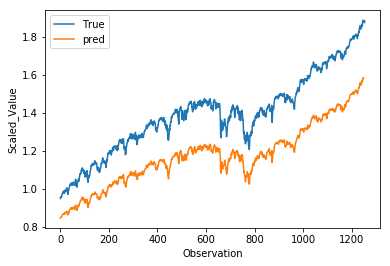

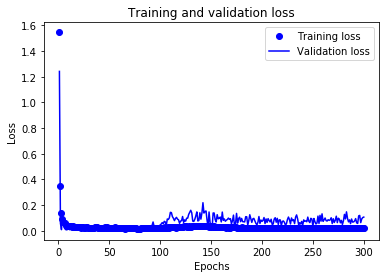

RUA_de5_tcn_clf9_n128_pe100_7:
(1254,)
The Adjusted R2 score on the Test set is:	-0.205
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.145
Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_9[0][0]                    
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activat

5667/5667==============================] - 2s 305us/sample - loss: 0.0450 - val_loss: 0.0039
Epoch 9/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0405 - val_loss: 0.0388
Epoch 10/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0334 - val_loss: 0.0059
Epoch 11/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0350 - val_loss: 0.0493
Epoch 12/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0283 - val_loss: 0.0123
Epoch 13/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0336 - val_loss: 0.0223
Epoch 14/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0267 - val_loss: 0.0063
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0286 - val_loss: 0.0060
Epoch 16/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0302 - val_loss: 0.0045
Epoch 17/300
5667/5667==============================] - 2s 3

5667/5667==============================] - 2s 312us/sample - loss: 0.0227 - val_loss: 0.0767
Epoch 162/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0214 - val_loss: 0.0608
Epoch 163/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0197 - val_loss: 0.0583
Epoch 164/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0216 - val_loss: 0.0305
Epoch 165/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0198 - val_loss: 0.0555
Epoch 166/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0231 - val_loss: 0.0236
Epoch 167/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0218 - val_loss: 0.0358
Epoch 168/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0199 - val_loss: 0.0435
Epoch 169/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0195 - val_loss: 0.0398
Epoch 170/300
5667/5667============================

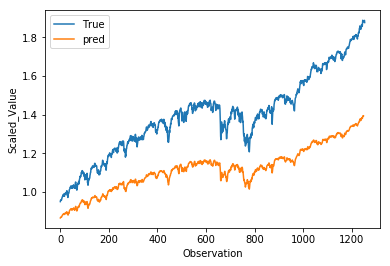

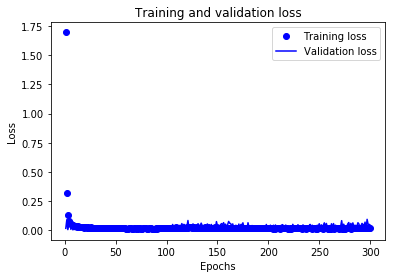

RUA_de5_tcn_clf9_n128_pe100_8:
(1254,)
The Adjusted R2 score on the Test set is:	-0.986
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	-0.243
Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_10[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 2s 312us/sample - loss: 0.0364 - val_loss: 0.0217
Epoch 9/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0376 - val_loss: 0.0340
Epoch 10/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0377 - val_loss: 0.0091
Epoch 11/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0334 - val_loss: 0.0069
Epoch 12/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0372 - val_loss: 0.0047
Epoch 13/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0274 - val_loss: 0.0077
Epoch 14/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0232 - val_loss: 0.0054
Epoch 15/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0344 - val_loss: 0.0091
Epoch 16/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0271 - val_loss: 0.0084
Epoch 17/300
5667/5667==============================] - 2s 3

Epoch 162/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0211 - val_loss: 0.0645
Epoch 163/300
5667/5667==============================] - 2s 308us/sample - loss: 0.0241 - val_loss: 0.0875
Epoch 164/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0192 - val_loss: 0.0721
Epoch 165/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0213 - val_loss: 0.0859
Epoch 166/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0243 - val_loss: 0.0652
Epoch 167/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0228 - val_loss: 0.0915
Epoch 168/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0228 - val_loss: 0.0878
Epoch 169/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0217 - val_loss: 0.0821
Epoch 170/300
5667/5667==============================] - 2s 309us/sample - loss: 0.0229 - val_loss: 0.0719
Epoch 171/300
5667/5667==============

5667/5667==============================] - 2s 317us/sample - loss: 0.0178 - val_loss: 0.0646
Epoch 239/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0183 - val_loss: 0.1015
Epoch 240/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0182 - val_loss: 0.0659
Epoch 241/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0184 - val_loss: 0.0426
Epoch 242/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0195 - val_loss: 0.0664
Epoch 243/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0164 - val_loss: 0.0678
Epoch 244/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0181 - val_loss: 0.0412
Epoch 245/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0175 - val_loss: 0.0659
Epoch 246/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0189 - val_loss: 0.0530
Epoch 247/300
5667/5667============================

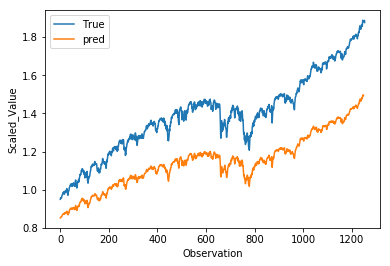

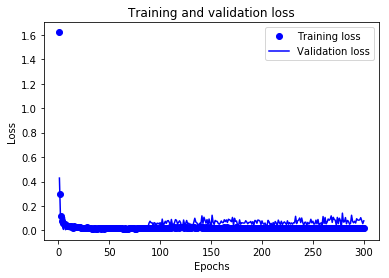

RUA_de5_tcn_clf9_n128_pe100_9:
(1254,)
The Adjusted R2 score on the Test set is:	-0.556
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	-0.029
Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_11[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

5667/5667==============================] - 2s 296us/sample - loss: 5.1401e-04 - val_loss: 8.1937e-04
Epoch 79/300
5667/5667==============================] - 2s 295us/sample - loss: 5.0477e-04 - val_loss: 7.8991e-04
Epoch 80/300
5667/5667==============================] - 2s 299us/sample - loss: 4.9928e-04 - val_loss: 8.5839e-04
Epoch 81/300
5667/5667==============================] - 2s 296us/sample - loss: 5.1307e-04 - val_loss: 8.6270e-04
Epoch 82/300
5667/5667==============================] - 2s 298us/sample - loss: 5.3713e-04 - val_loss: 9.9046e-04
Epoch 83/300
5667/5667==============================] - 2s 297us/sample - loss: 5.7829e-04 - val_loss: 7.4768e-04
Epoch 84/300
5667/5667==============================] - 2s 295us/sample - loss: 5.6259e-04 - val_loss: 7.5458e-04
Epoch 85/300
5667/5667==============================] - 2s 297us/sample - loss: 4.9725e-04 - val_loss: 0.0010
Epoch 86/300
5667/5667==============================] - 2s 295us/sample - loss: 5.3006e-04 - val_loss: 7.

5667/5667==============================] - 2s 294us/sample - loss: 5.5685e-04 - val_loss: 0.0044
Epoch 224/300
5667/5667==============================] - 2s 294us/sample - loss: 5.8795e-04 - val_loss: 0.0048
Epoch 225/300
5667/5667==============================] - 2s 296us/sample - loss: 5.5298e-04 - val_loss: 0.0041
Epoch 226/300
5667/5667==============================] - 2s 296us/sample - loss: 5.7938e-04 - val_loss: 0.0036
Epoch 227/300
5667/5667==============================] - 2s 297us/sample - loss: 5.6793e-04 - val_loss: 0.0045
Epoch 228/300
5667/5667==============================] - 2s 295us/sample - loss: 6.0101e-04 - val_loss: 0.0045
Epoch 229/300
5667/5667==============================] - 2s 298us/sample - loss: 5.7800e-04 - val_loss: 0.0044
Epoch 230/300
5667/5667==============================] - 2s 296us/sample - loss: 5.9163e-04 - val_loss: 0.0041
Epoch 231/300
5667/5667==============================] - 2s 298us/sample - loss: 5.7798e-04 - val_loss: 0.0043
Epoch 232/300
5

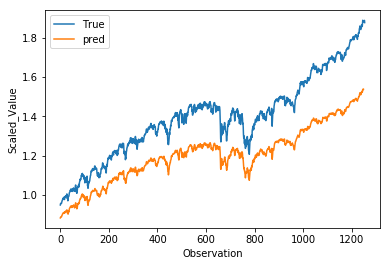

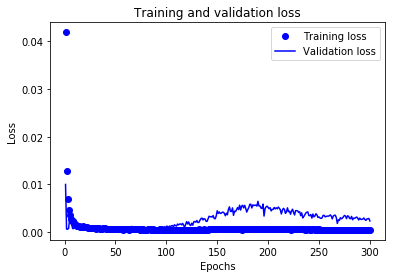

RUA_de5_tcn_clf9_n128_pex_0:
(1254,)
The Adjusted R2 score on the Test set is:	0.057
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.277
Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_12[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 300us/sample - loss: 0.0021 - val_loss: 8.5853e-04
Epoch 9/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0019 - val_loss: 0.0013
Epoch 10/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0019 - val_loss: 0.0010
Epoch 11/300
5667/5667==============================] - 2s 301us/sample - loss: 0.0019 - val_loss: 0.0044
Epoch 12/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0015 - val_loss: 8.5220e-04
Epoch 13/300
5667/5667==============================] - 2s 299us/sample - loss: 0.0013 - val_loss: 9.0762e-04
Epoch 14/300
5667/5667==============================] - 2s 300us/sample - loss: 0.0013 - val_loss: 0.0014
Epoch 15/300
5667/5667==============================] - 2s 297us/sample - loss: 0.0011 - val_loss: 7.4667e-04
Epoch 16/300
5667/5667==============================] - 2s 298us/sample - loss: 0.0013 - val_loss: 0.0014
Epoch 17/300
5667/5667======================

5667/5667==============================] - 2s 298us/sample - loss: 5.7855e-04 - val_loss: 0.0043
Epoch 154/300
5667/5667==============================] - 2s 299us/sample - loss: 5.6720e-04 - val_loss: 0.0053
Epoch 155/300
5667/5667==============================] - 2s 298us/sample - loss: 5.8618e-04 - val_loss: 0.0040
Epoch 156/300
5667/5667==============================] - 2s 300us/sample - loss: 5.9733e-04 - val_loss: 0.0048
Epoch 157/300
5667/5667==============================] - 2s 301us/sample - loss: 5.8630e-04 - val_loss: 0.0045
Epoch 158/300
5667/5667==============================] - 2s 298us/sample - loss: 6.0985e-04 - val_loss: 0.0058
Epoch 159/300
5667/5667==============================] - 2s 300us/sample - loss: 6.6670e-04 - val_loss: 0.0048
Epoch 160/300
5667/5667==============================] - 2s 297us/sample - loss: 5.9274e-04 - val_loss: 0.0044
Epoch 161/300
5667/5667==============================] - 2s 298us/sample - loss: 5.8733e-04 - val_loss: 0.0044
Epoch 162/300
5

Epoch 300/300
5667/5667==============================] - 2s 299us/sample - loss: 5.0054e-04 - val_loss: 0.0028
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.096261
The Adjusted R2 score on the Test set is:	0.093


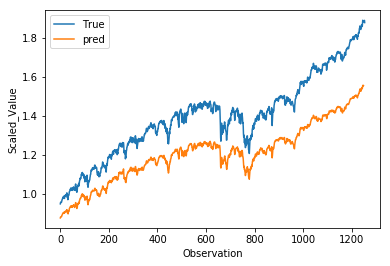

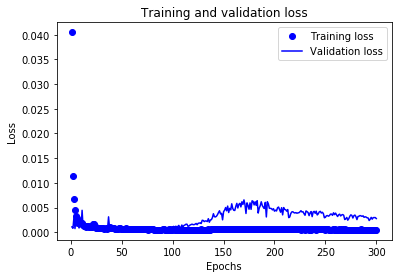

RUA_de5_tcn_clf9_n128_pex_1:
(1254,)
The Adjusted R2 score on the Test set is:	0.093
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	0.297
Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_13[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 303us/sample - loss: 0.0024 - val_loss: 7.0291e-04
Epoch 9/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0021 - val_loss: 0.0022
Epoch 10/300
5667/5667==============================] - ETA: 0s - loss: 0.001 - 2s 301us/sample - loss: 0.0018 - val_loss: 0.0023
Epoch 11/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0015 - val_loss: 0.0011
Epoch 12/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0015 - val_loss: 0.0025
Epoch 13/300
5667/5667==============================] - 2s 302us/sample - loss: 0.0014 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0012 - val_loss: 0.0014
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0012 - val_loss: 8.5701e-04
Epoch 16/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0013 - val_loss: 8.8306e-04
Epoch 17/300
5667/5667==

Epoch 152/300
5667/5667==============================] - 2s 304us/sample - loss: 5.2604e-04 - val_loss: 0.0041
Epoch 153/300
5667/5667==============================] - 2s 303us/sample - loss: 5.5916e-04 - val_loss: 0.0038
Epoch 154/300
5667/5667==============================] - 2s 305us/sample - loss: 5.2418e-04 - val_loss: 0.0035
Epoch 155/300
5667/5667==============================] - 2s 302us/sample - loss: 5.4098e-04 - val_loss: 0.0037
Epoch 156/300
5667/5667==============================] - 2s 301us/sample - loss: 5.3655e-04 - val_loss: 0.0039
Epoch 157/300
5667/5667==============================] - 2s 301us/sample - loss: 5.2923e-04 - val_loss: 0.0043
Epoch 158/300
5667/5667==============================] - 2s 302us/sample - loss: 5.3059e-04 - val_loss: 0.0043
Epoch 159/300
5667/5667==============================] - 2s 302us/sample - loss: 5.1158e-04 - val_loss: 0.0048
Epoch 160/300
5667/5667==============================] - 2s 301us/sample - loss: 5.2391e-04 - val_loss: 0.0046
E

Epoch 226/300
5667/5667==============================] - 2s 302us/sample - loss: 5.6407e-04 - val_loss: 0.0035
Epoch 227/300
5667/5667==============================] - 2s 300us/sample - loss: 5.2849e-04 - val_loss: 0.0045
Epoch 228/300
5667/5667==============================] - 2s 301us/sample - loss: 5.3178e-04 - val_loss: 0.0047
Epoch 229/300
5667/5667==============================] - 2s 302us/sample - loss: 5.8431e-04 - val_loss: 0.0042
Epoch 230/300
5667/5667==============================] - 2s 299us/sample - loss: 5.3231e-04 - val_loss: 0.0034
Epoch 231/300
5667/5667==============================] - 2s 301us/sample - loss: 5.2931e-04 - val_loss: 0.0048
Epoch 232/300
5667/5667==============================] - 2s 300us/sample - loss: 5.9218e-04 - val_loss: 0.0037
Epoch 233/300
5667/5667==============================] - 2s 300us/sample - loss: 4.8018e-04 - val_loss: 0.0030
Epoch 234/300
5667/5667==============================] - 2s 303us/sample - loss: 5.4966e-04 - val_loss: 0.0032
E

Epoch 300/300
5667/5667==============================] - 2s 301us/sample - loss: 4.7961e-04 - val_loss: 0.0029
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.014668
The Adjusted R2 score on the Test set is:	0.011


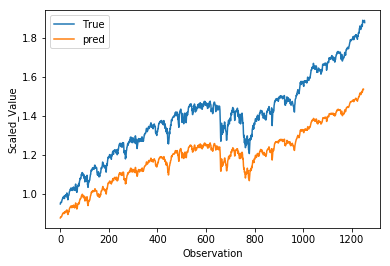

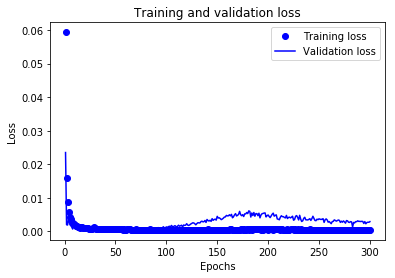

RUA_de5_tcn_clf9_n128_pex_2:
(1254,)
The Adjusted R2 score on the Test set is:	0.011
The Custom  sign score on the Test set is:	0.494
The Custom  R2 score on the Test set is:	0.252
Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_14[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 305us/sample - loss: 0.0022 - val_loss: 0.0011
Epoch 9/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0020 - val_loss: 0.0016
Epoch 10/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0019 - val_loss: 6.1349e-04
Epoch 11/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0017 - val_loss: 0.0020
Epoch 12/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0015 - val_loss: 9.2803e-04
Epoch 13/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0017 - val_loss: 0.0039
Epoch 14/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0013 - val_loss: 9.8617e-04
Epoch 15/300
5667/5667==============================] - 2s 303us/sample - loss: 0.0013 - val_loss: 9.3928e-04
Epoch 16/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0014 - val_loss: 6.3076e-04
Epoch 17/300
5667/5667==================

Epoch 81/300
5667/5667==============================] - 2s 304us/sample - loss: 5.0737e-04 - val_loss: 8.5679e-04
Epoch 82/300
5667/5667==============================] - 2s 304us/sample - loss: 5.0948e-04 - val_loss: 8.1142e-04
Epoch 83/300
5667/5667==============================] - 2s 303us/sample - loss: 5.5431e-04 - val_loss: 0.0010
Epoch 84/300
5667/5667==============================] - 2s 302us/sample - loss: 5.2280e-04 - val_loss: 7.1261e-04
Epoch 85/300
5667/5667==============================] - 2s 302us/sample - loss: 5.3594e-04 - val_loss: 0.0011
Epoch 86/300
5667/5667==============================] - 2s 301us/sample - loss: 6.1797e-04 - val_loss: 9.3283e-04
Epoch 87/300
5667/5667==============================] - ETA: 0s - loss: 6.1791e-0 - 2s 304us/sample - loss: 6.2476e-04 - val_loss: 9.3022e-04
Epoch 88/300
5667/5667==============================] - 2s 303us/sample - loss: 5.4441e-04 - val_loss: 0.0011
Epoch 89/300
5667/5667==============================] - 2s 308us/sample 

Epoch 154/300
5667/5667==============================] - 2s 302us/sample - loss: 6.0177e-04 - val_loss: 0.0060
Epoch 155/300
5667/5667==============================] - 2s 303us/sample - loss: 6.1825e-04 - val_loss: 0.0044
Epoch 156/300
5667/5667==============================] - 2s 303us/sample - loss: 6.0975e-04 - val_loss: 0.0048
Epoch 157/300
5667/5667==============================] - 2s 303us/sample - loss: 6.0793e-04 - val_loss: 0.0065
Epoch 158/300
5667/5667==============================] - 2s 303us/sample - loss: 6.0394e-04 - val_loss: 0.0057
Epoch 159/300
5667/5667==============================] - 2s 303us/sample - loss: 5.9591e-04 - val_loss: 0.0047
Epoch 160/300
5667/5667==============================] - 2s 305us/sample - loss: 6.5911e-04 - val_loss: 0.0067
Epoch 161/300
5667/5667==============================] - 2s 303us/sample - loss: 5.6298e-04 - val_loss: 0.0055
Epoch 162/300
5667/5667==============================] - 2s 312us/sample - loss: 6.2364e-04 - val_loss: 0.0056
E

5667/5667==============================] - 2s 307us/sample - loss: 4.6497e-04 - val_loss: 0.0027
Epoch 300/300
5667/5667==============================] - 2s 303us/sample - loss: 4.8685e-04 - val_loss: 0.0026
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.016403
The Adjusted R2 score on the Test set is:	-0.020


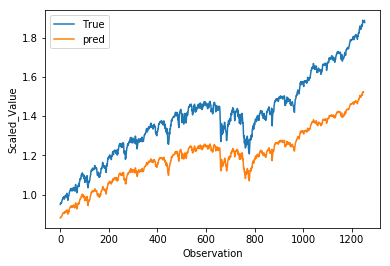

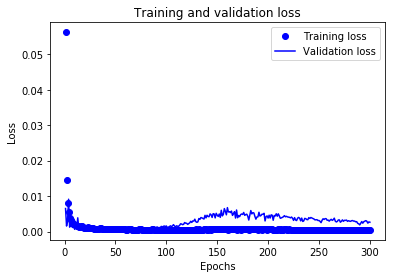

RUA_de5_tcn_clf9_n128_pex_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.020
The Custom  sign score on the Test set is:	0.502
The Custom  R2 score on the Test set is:	0.241
Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_15[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 303us/sample - loss: 0.0023 - val_loss: 6.0107e-04
Epoch 9/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0017 - val_loss: 7.7781e-04
Epoch 10/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0018 - val_loss: 7.0182e-04
Epoch 11/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0016 - val_loss: 7.0469e-04
Epoch 12/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0015 - val_loss: 7.2814e-04
Epoch 13/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0016 - val_loss: 6.8998e-04
Epoch 14/300
5667/5667==============================] - 2s 304us/sample - loss: 0.0014 - val_loss: 6.6659e-04
Epoch 15/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0014 - val_loss: 7.0639e-04
Epoch 16/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0013 - val_loss: 6.9042e-04
Epoch 17/300
5667/5667==

Epoch 80/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0783e-04 - val_loss: 7.5037e-04
Epoch 81/300
5667/5667==============================] - 2s 306us/sample - loss: 5.0623e-04 - val_loss: 7.9406e-04
Epoch 82/300
5667/5667==============================] - 2s 307us/sample - loss: 5.5429e-04 - val_loss: 7.0497e-04
Epoch 83/300
5667/5667==============================] - 2s 306us/sample - loss: 5.1044e-04 - val_loss: 7.6790e-04
Epoch 84/300
5667/5667==============================] - 2s 306us/sample - loss: 5.2568e-04 - val_loss: 7.5952e-04
Epoch 85/300
5667/5667==============================] - 2s 305us/sample - loss: 5.5583e-04 - val_loss: 9.2524e-04
Epoch 86/300
5667/5667==============================] - 2s 307us/sample - loss: 6.0015e-04 - val_loss: 8.8895e-04
Epoch 87/300
5667/5667==============================] - 2s 306us/sample - loss: 5.6455e-04 - val_loss: 8.2364e-04
Epoch 88/300
5667/5667==============================] - 2s 307us/sample - loss: 5.2064e-

Epoch 153/300
5667/5667==============================] - 2s 307us/sample - loss: 5.5193e-04 - val_loss: 0.0036
Epoch 154/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0124e-04 - val_loss: 0.0029
Epoch 155/300
5667/5667==============================] - 2s 309us/sample - loss: 5.2941e-04 - val_loss: 0.0038
Epoch 156/300
5667/5667==============================] - 2s 308us/sample - loss: 5.3997e-04 - val_loss: 0.0041
Epoch 157/300
5667/5667==============================] - 2s 306us/sample - loss: 5.5801e-04 - val_loss: 0.0043
Epoch 158/300
5667/5667==============================] - 2s 315us/sample - loss: 5.5820e-04 - val_loss: 0.0034
Epoch 159/300
5667/5667==============================] - 2s 303us/sample - loss: 5.3153e-04 - val_loss: 0.0040
Epoch 160/300
5667/5667==============================] - 2s 308us/sample - loss: 5.1979e-04 - val_loss: 0.0041
Epoch 161/300
5667/5667==============================] - 2s 309us/sample - loss: 5.6110e-04 - val_loss: 0.0033
E

5667/5667==============================] - 2s 307us/sample - loss: 5.1726e-04 - val_loss: 0.0032
Epoch 300/300
5667/5667==============================] - 2s 306us/sample - loss: 5.2293e-04 - val_loss: 0.0032
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.005063
The Adjusted R2 score on the Test set is:	-0.009


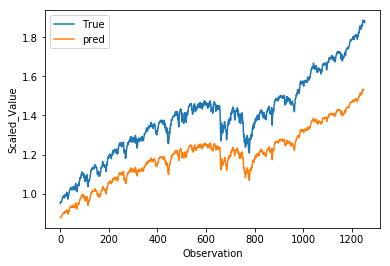

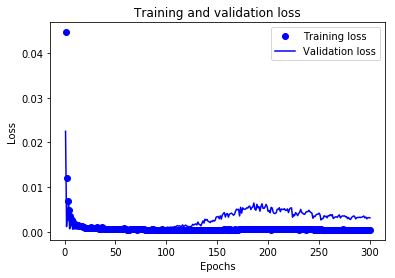

RUA_de5_tcn_clf9_n128_pex_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.009
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.244
Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_16 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_16[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activati

5667/5667==============================] - 2s 308us/sample - loss: 5.0980e-04 - val_loss: 7.8548e-04
Epoch 81/300
5667/5667==============================] - 2s 307us/sample - loss: 4.7873e-04 - val_loss: 9.5464e-04
Epoch 82/300
5667/5667==============================] - 2s 308us/sample - loss: 4.6641e-04 - val_loss: 0.0010
Epoch 83/300
5667/5667==============================] - 2s 308us/sample - loss: 4.7376e-04 - val_loss: 7.9010e-04
Epoch 84/300
5667/5667==============================] - 2s 306us/sample - loss: 4.8666e-04 - val_loss: 8.5382e-04
Epoch 85/300
5667/5667==============================] - 2s 309us/sample - loss: 4.8745e-04 - val_loss: 9.4871e-04
Epoch 86/300
5667/5667==============================] - 2s 310us/sample - loss: 4.8862e-04 - val_loss: 9.8977e-04
Epoch 87/300
5667/5667==============================] - 2s 307us/sample - loss: 4.9817e-04 - val_loss: 0.0012
Epoch 88/300
5667/5667==============================] - 2s 307us/sample - loss: 5.2395e-04 - val_loss: 0.0011

Epoch 226/300
5667/5667==============================] - 2s 306us/sample - loss: 5.2605e-04 - val_loss: 0.0035
Epoch 227/300
5667/5667==============================] - 2s 306us/sample - loss: 5.1104e-04 - val_loss: 0.0030
Epoch 228/300
5667/5667==============================] - 2s 306us/sample - loss: 5.3479e-04 - val_loss: 0.0029
Epoch 229/300
5667/5667==============================] - ETA: 0s - loss: 4.8481e-0 - 2s 306us/sample - loss: 4.9453e-04 - val_loss: 0.0034
Epoch 230/300
5667/5667==============================] - 2s 306us/sample - loss: 5.1185e-04 - val_loss: 0.0034
Epoch 231/300
5667/5667==============================] - 2s 306us/sample - loss: 5.4844e-04 - val_loss: 0.0034
Epoch 232/300
5667/5667==============================] - 2s 307us/sample - loss: 4.9367e-04 - val_loss: 0.0037
Epoch 233/300
5667/5667==============================] - 2s 317us/sample - loss: 5.4273e-04 - val_loss: 0.0034
Epoch 234/300
5667/5667==============================] - 2s 316us/sample - loss: 5.0

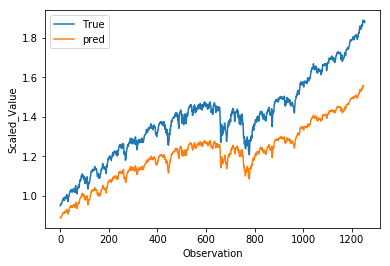

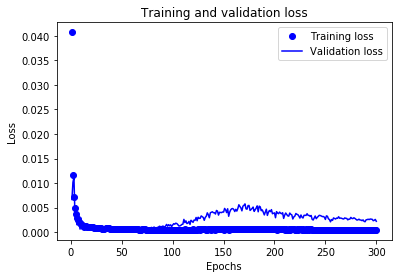

RUA_de5_tcn_clf9_n128_pex_5:
(1254,)
The Adjusted R2 score on the Test set is:	0.165
The Custom  sign score on the Test set is:	0.504
The Custom  R2 score on the Test set is:	0.334
Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_17 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_17[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 309us/sample - loss: 0.0021 - val_loss: 0.0032
Epoch 9/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0019 - val_loss: 9.1643e-04
Epoch 10/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0016 - val_loss: 8.3856e-04
Epoch 11/300
5667/5667==============================] - ETA: 0s - loss: 0.001 - 2s 305us/sample - loss: 0.0016 - val_loss: 8.5448e-04
Epoch 12/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0013 - val_loss: 6.2184e-04
Epoch 13/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0012 - val_loss: 7.9128e-04
Epoch 14/300
5667/5667==============================] - 2s 307us/sample - loss: 0.0012 - val_loss: 8.7938e-04
Epoch 15/300
5667/5667==============================] - 2s 305us/sample - loss: 0.0011 - val_loss: 6.9044e-04
Epoch 16/300
5667/5667==============================] - 2s 306us/sample - loss: 0.0012 - val_loss: 0.0011
Epoch 17

Epoch 154/300
5667/5667==============================] - 2s 311us/sample - loss: 5.5932e-04 - val_loss: 0.0046
Epoch 155/300
5667/5667==============================] - 2s 306us/sample - loss: 5.3469e-04 - val_loss: 0.0046
Epoch 156/300
5667/5667==============================] - 2s 310us/sample - loss: 5.2097e-04 - val_loss: 0.0045
Epoch 157/300
5667/5667==============================] - 2s 307us/sample - loss: 5.3663e-04 - val_loss: 0.0052
Epoch 158/300
5667/5667==============================] - 2s 309us/sample - loss: 5.6036e-04 - val_loss: 0.0041
Epoch 159/300
5667/5667==============================] - 2s 308us/sample - loss: 5.4222e-04 - val_loss: 0.0042
Epoch 160/300
5667/5667==============================] - 2s 307us/sample - loss: 5.2154e-04 - val_loss: 0.0049
Epoch 161/300
5667/5667==============================] - 2s 307us/sample - loss: 5.6299e-04 - val_loss: 0.0040
Epoch 162/300
5667/5667==============================] - 2s 310us/sample - loss: 5.2402e-04 - val_loss: 0.0036
E

y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.013239
The Adjusted R2 score on the Test set is:	0.009


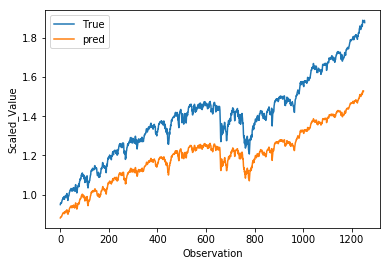

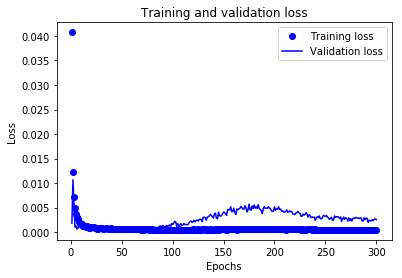

RUA_de5_tcn_clf9_n128_pex_6:
(1254,)
The Adjusted R2 score on the Test set is:	0.009
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	0.255
Model: "model_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_18 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_18[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

Epoch 8/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0020 - val_loss: 0.0013
Epoch 9/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0018 - val_loss: 6.5212e-04
Epoch 10/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0018 - val_loss: 0.0030
Epoch 11/300
5667/5667==============================] - 2s 326us/sample - loss: 0.0015 - val_loss: 7.5865e-04
Epoch 12/300
5667/5667==============================] - 2s 314us/sample - loss: 0.0013 - val_loss: 6.8195e-04
Epoch 13/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0013 - val_loss: 9.3714e-04
Epoch 14/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0012 - val_loss: 8.0358e-04
Epoch 15/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0012 - val_loss: 9.5901e-04oss: 8.
Epoch 16/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0011 - val_loss: 0.0014
Epoch 17/300
5667

Epoch 80/300
5667/5667==============================] - 2s 307us/sample - loss: 5.7878e-04 - val_loss: 9.8838e-04
Epoch 81/300
5667/5667==============================] - 2s 310us/sample - loss: 6.1431e-04 - val_loss: 0.0011
Epoch 82/300
5667/5667==============================] - 2s 309us/sample - loss: 5.6624e-04 - val_loss: 9.3448e-04
Epoch 83/300
5667/5667==============================] - 2s 310us/sample - loss: 5.5432e-04 - val_loss: 0.0010
Epoch 84/300
5667/5667==============================] - 2s 308us/sample - loss: 5.2431e-04 - val_loss: 0.0011
Epoch 85/300
5667/5667==============================] - 2s 308us/sample - loss: 4.9451e-04 - val_loss: 0.0012
Epoch 86/300
5667/5667==============================] - 2s 307us/sample - loss: 4.6880e-04 - val_loss: 0.0015
Epoch 87/300
5667/5667==============================] - 2s 309us/sample - loss: 4.6813e-04 - val_loss: 0.0013
Epoch 88/300
5667/5667==============================] - 2s 309us/sample - loss: 5.0552e-04 - val_loss: 0.0012
Ep

5667/5667==============================] - 2s 308us/sample - loss: 5.5417e-04 - val_loss: 0.0039
Epoch 225/300
5667/5667==============================] - 2s 309us/sample - loss: 5.6194e-04 - val_loss: 0.0028
Epoch 226/300
5667/5667==============================] - 2s 309us/sample - loss: 5.3574e-04 - val_loss: 0.0032
Epoch 227/300
5667/5667==============================] - 2s 311us/sample - loss: 5.3967e-04 - val_loss: 0.0029
Epoch 228/300
5667/5667==============================] - 2s 305us/sample - loss: 4.9759e-04 - val_loss: 0.0037
Epoch 229/300
5667/5667==============================] - 2s 308us/sample - loss: 5.6306e-04 - val_loss: 0.0036
Epoch 230/300
5667/5667==============================] - 2s 308us/sample - loss: 5.2139e-04 - val_loss: 0.0030
Epoch 231/300
5667/5667==============================] - 2s 309us/sample - loss: 4.9059e-04 - val_loss: 0.0032
Epoch 232/300
5667/5667==============================] - 2s 309us/sample - loss: 5.5459e-04 - val_loss: 0.0029
Epoch 233/300
5

Epoch 298/300
5667/5667==============================] - 2s 307us/sample - loss: 5.0937e-04 - val_loss: 0.0023
Epoch 299/300
5667/5667==============================] - 2s 306us/sample - loss: 5.0304e-04 - val_loss: 0.0024
Epoch 300/300
5667/5667==============================] - 2s 308us/sample - loss: 4.5539e-04 - val_loss: 0.0022
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.043165
The Adjusted R2 score on the Test set is:	0.039


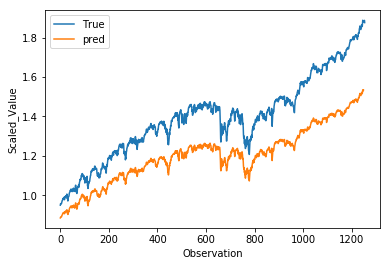

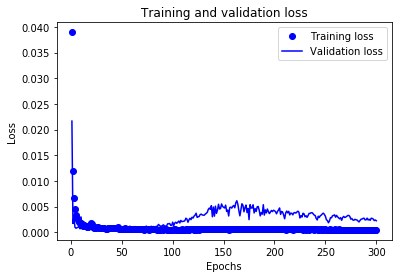

RUA_de5_tcn_clf9_n128_pex_7:
(1254,)
The Adjusted R2 score on the Test set is:	0.039
The Custom  sign score on the Test set is:	0.505
The Custom  R2 score on the Test set is:	0.272
Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_19[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

Epoch 8/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0024 - val_loss: 7.3300e-04
Epoch 9/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0020 - val_loss: 5.8541e-04
Epoch 10/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0017 - val_loss: 0.0011
Epoch 11/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0016 - val_loss: 8.9684e-04
Epoch 12/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0014 - val_loss: 0.0011
Epoch 13/300
5667/5667==============================] - 2s 310us/sample - loss: 0.0013 - val_loss: 0.0010
Epoch 14/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0013 - val_loss: 0.00163e - ETA: 0s - loss: 8.3763e-0 - ETA: 0s - loss: 8
Epoch 15/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0014 - val_loss: 7.1047e-04
Epoch 16/300
5667/5667==============================] - 2s 315us/sample - loss: 0.0013 -

5667/5667==============================] - 2s 313us/sample - loss: 5.2571e-04 - val_loss: 0.0012
Epoch 81/300
5667/5667==============================] - 2s 311us/sample - loss: 5.3623e-04 - val_loss: 9.8145e-04
Epoch 82/300
5667/5667==============================] - 2s 312us/sample - loss: 5.3152e-04 - val_loss: 0.0014
Epoch 83/300
5667/5667==============================] - 2s 312us/sample - loss: 5.8904e-04 - val_loss: 9.2399e-04
Epoch 84/300
5667/5667==============================] - 2s 312us/sample - loss: 5.9780e-04 - val_loss: 0.0010
Epoch 85/300
5667/5667==============================] - 2s 311us/sample - loss: 5.3786e-04 - val_loss: 0.0012
Epoch 86/300
5667/5667==============================] - 2s 312us/sample - loss: 5.3041e-04 - val_loss: 0.0011
Epoch 87/300
5667/5667==============================] - 2s 311us/sample - loss: 5.1497e-04 - val_loss: 0.0013
Epoch 88/300
5667/5667==============================] - 2s 310us/sample - loss: 5.2579e-04 - val_loss: 0.0013
Epoch 89/300
56

Epoch 154/300
5667/5667==============================] - 2s 313us/sample - loss: 6.0341e-04 - val_loss: 0.0056
Epoch 155/300
5667/5667==============================] - 2s 313us/sample - loss: 5.6176e-04 - val_loss: 0.0057
Epoch 156/300
5667/5667==============================] - 2s 312us/sample - loss: 5.6148e-04 - val_loss: 0.0052
Epoch 157/300
5667/5667==============================] - 2s 312us/sample - loss: 5.5612e-04 - val_loss: 0.0057
Epoch 158/300
5667/5667==============================] - 2s 314us/sample - loss: 5.8111e-04 - val_loss: 0.0065
Epoch 159/300
5667/5667==============================] - 2s 312us/sample - loss: 5.9335e-04 - val_loss: 0.0058
Epoch 160/300
5667/5667==============================] - 2s 310us/sample - loss: 6.0680e-04 - val_loss: 0.0056
Epoch 161/300
5667/5667==============================] - 2s 313us/sample - loss: 6.1186e-04 - val_loss: 0.0053
Epoch 162/300
5667/5667==============================] - 2s 313us/sample - loss: 5.6830e-04 - val_loss: 0.0060
E

y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.045684
The Adjusted R2 score on the Test set is:	0.042


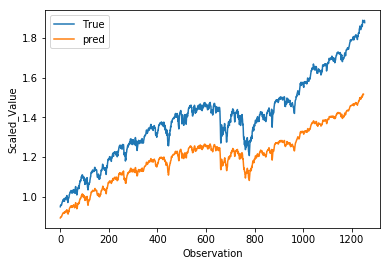

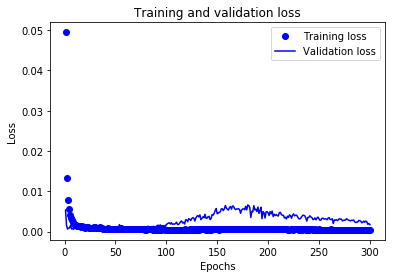

RUA_de5_tcn_clf9_n128_pex_8:
(1254,)
The Adjusted R2 score on the Test set is:	0.042
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	0.271
Model: "model_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_20 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 128)       768         input_20[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 128)       32896       tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activatio

5667/5667==============================] - 2s 314us/sample - loss: 0.0019 - val_loss: 0.0014
Epoch 9/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0017 - val_loss: 6.1134e-04ETA
Epoch 10/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0014 - val_loss: 0.0014
Epoch 11/300
5667/5667==============================] - 2s 311us/sample - loss: 0.0013 - val_loss: 0.0019
Epoch 12/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0012 - val_loss: 6.8802e-04
Epoch 13/300
5667/5667==============================] - 2s 313us/sample - loss: 0.0011 - val_loss: 8.4549e-04
Epoch 14/300
5667/5667==============================] - 2s 312us/sample - loss: 0.0011 - val_loss: 0.0013
Epoch 15/300
5667/5667==============================] - 2s 314us/sample - loss: 9.9877e-04 - val_loss: 9.6911e-04
Epoch 16/300
5667/5667==============================] - 2s 312us/sample - loss: 8.9077e-04 - val_loss: 6.7056e-04
Epoch 17/300
5667/5667=======

5667/5667==============================] - 2s 313us/sample - loss: 6.4240e-04 - val_loss: 0.0046
Epoch 154/300
5667/5667==============================] - 2s 313us/sample - loss: 5.8738e-04 - val_loss: 0.0042
Epoch 155/300
5667/5667==============================] - 2s 312us/sample - loss: 6.0572e-04 - val_loss: 0.0055
Epoch 156/300
5667/5667==============================] - 2s 314us/sample - loss: 5.6949e-04 - val_loss: 0.0045
Epoch 157/300
5667/5667==============================] - 2s 310us/sample - loss: 5.3423e-04 - val_loss: 0.0036
Epoch 158/300
5667/5667==============================] - 2s 313us/sample - loss: 5.5527e-04 - val_loss: 0.0052
Epoch 159/300
5667/5667==============================] - 2s 313us/sample - loss: 5.9823e-04 - val_loss: 0.0040
Epoch 160/300
5667/5667==============================] - 2s 311us/sample - loss: 6.2846e-04 - val_loss: 0.0054
Epoch 161/300
5667/5667==============================] - 2s 312us/sample - loss: 5.8137e-04 - val_loss: 0.0043
Epoch 162/300
5

5667/5667==============================] - 2s 314us/sample - loss: 4.8438e-04 - val_loss: 0.0024
Epoch 299/300
5667/5667==============================] - 2s 314us/sample - loss: 4.8802e-04 - val_loss: 0.0022
Epoch 300/300
5667/5667==============================] - 2s 313us/sample - loss: 4.7456e-04 - val_loss: 0.0021
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: 0.210333
The Adjusted R2 score on the Test set is:	0.207


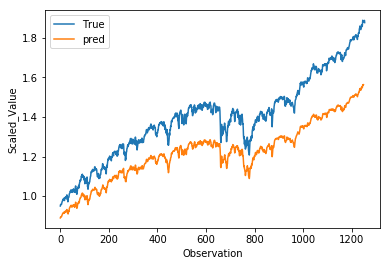

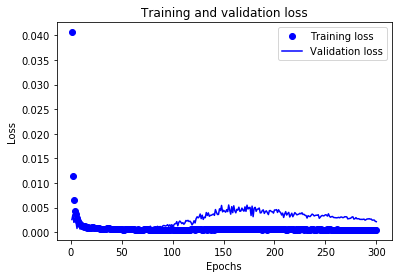

RUA_de5_tcn_clf9_n128_pex_9:
(1254,)
The Adjusted R2 score on the Test set is:	0.207
The Custom  sign score on the Test set is:	0.492
The Custom  R2 score on the Test set is:	0.349


In [39]:
neurons=[128]
penalties=[100, 'x']
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

Model: "model_20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_21[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activation_120 (Activation)     (None, 1, 512)       0           tcn_d_causal_conv_1_tanh_s0[0][0]
___________________________________________________________________________________________

5667/5667==============================] - 3s 447us/sample - loss: 5.8851e-04 - val_loss: 9.5333e-04
Epoch 85/300
5667/5667==============================] - 3s 448us/sample - loss: 5.5784e-04 - val_loss: 0.0012
Epoch 86/300
5667/5667==============================] - 3s 448us/sample - loss: 5.7640e-04 - val_loss: 0.0012
Epoch 87/300
5667/5667==============================] - 3s 449us/sample - loss: 5.5839e-04 - val_loss: 0.0012
Epoch 88/300
5667/5667==============================] - 3s 446us/sample - loss: 5.5290e-04 - val_loss: 0.0045
Epoch 89/300
5667/5667==============================] - 3s 447us/sample - loss: 6.4309e-04 - val_loss: 0.0017
Epoch 90/300
5667/5667==============================] - 3s 446us/sample - loss: 6.0084e-04 - val_loss: 0.0028
Epoch 91/300
5667/5667==============================] - 3s 447us/sample - loss: 6.6344e-04 - val_loss: 0.0014
Epoch 92/300
5667/5667==============================] - 3s 448us/sample - loss: 5.6200e-04 - val_loss: 0.0018
Epoch 93/300
5667/5

Epoch 230/300
5667/5667==============================] - 3s 449us/sample - loss: 3.9403e-04 - val_loss: 0.0018
Epoch 231/300
5667/5667==============================] - 3s 453us/sample - loss: 4.1115e-04 - val_loss: 0.0011
Epoch 232/300
5667/5667==============================] - 3s 448us/sample - loss: 3.7927e-04 - val_loss: 0.0012
Epoch 233/300
5667/5667==============================] - 3s 449us/sample - loss: 4.2056e-04 - val_loss: 0.0016
Epoch 234/300
5667/5667==============================] - 3s 449us/sample - loss: 3.8128e-04 - val_loss: 0.0015
Epoch 235/300
5667/5667==============================] - 3s 449us/sample - loss: 4.0521e-04 - val_loss: 0.0015
Epoch 236/300
5667/5667==============================] - 3s 450us/sample - loss: 3.9647e-04 - val_loss: 0.0017
Epoch 237/300
5667/5667==============================] - 3s 448us/sample - loss: 3.9188e-04 - val_loss: 0.0019
Epoch 238/300
5667/5667==============================] - 3s 448us/sample - loss: 3.8058e-04 - val_loss: 0.0018
E

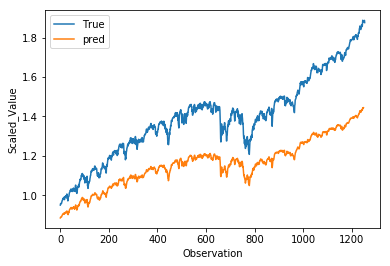

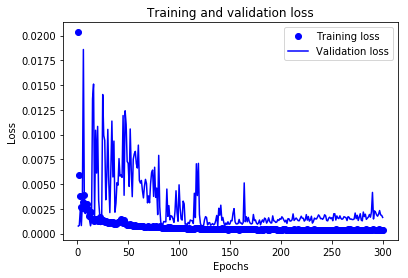

RUA_de5_tcn_clf9_n512_pe0.01_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.462
The Custom  sign score on the Test set is:	0.493
The Custom  R2 score on the Test set is:	0.015
Model: "model_21"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_22[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

Epoch 8/300
5667/5667==============================] - 3s 448us/sample - loss: 0.0020 - val_loss: 0.0075
Epoch 9/300
5667/5667==============================] - 3s 447us/sample - loss: 0.0022 - val_loss: 0.0024
Epoch 10/300
5667/5667==============================] - 3s 450us/sample - loss: 0.0023 - val_loss: 8.7741e-04
Epoch 11/300
5667/5667==============================] - 3s 449us/sample - loss: 0.0024 - val_loss: 0.0018
Epoch 12/300
5667/5667==============================] - 3s 448us/sample - loss: 0.0018 - val_loss: 0.0076
Epoch 13/300
5667/5667==============================] - 3s 449us/sample - loss: 0.0013 - val_loss: 0.0151
Epoch 14/300
5667/5667==============================] - 3s 448us/sample - loss: 0.0012 - val_loss: 0.0116
Epoch 15/300
5667/5667==============================] - 3s 448us/sample - loss: 0.0016 - val_loss: 0.0019
Epoch 16/300
5667/5667==============================] - 3s 449us/sample - loss: 0.0022 - val_loss: 8.5221e-04
Epoch 17/300
5667/5667==================

5667/5667==============================] - 3s 448us/sample - loss: 4.5902e-04 - val_loss: 9.3139e-04
Epoch 156/300
5667/5667==============================] - 3s 448us/sample - loss: 4.2221e-04 - val_loss: 0.0011
Epoch 157/300
5667/5667==============================] - 3s 450us/sample - loss: 4.1627e-04 - val_loss: 0.0011
Epoch 158/300
5667/5667==============================] - 3s 449us/sample - loss: 4.1409e-04 - val_loss: 9.5000e-04
Epoch 159/300
5667/5667==============================] - 3s 448us/sample - loss: 3.9653e-04 - val_loss: 0.0016
Epoch 160/300
5667/5667==============================] - 3s 448us/sample - loss: 4.2388e-04 - val_loss: 0.0015
Epoch 161/300
5667/5667==============================] - 3s 448us/sample - loss: 4.4986e-04 - val_loss: 0.0013
Epoch 162/300
5667/5667==============================] - 3s 448us/sample - loss: 4.3748e-04 - val_loss: 0.0014
Epoch 163/300
5667/5667==============================] - 3s 448us/sample - loss: 4.5737e-04 - val_loss: 0.0021
Epoch 1

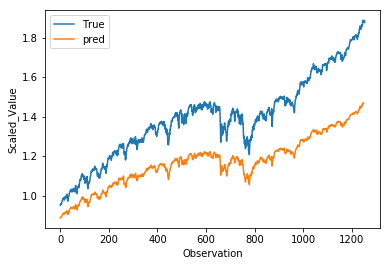

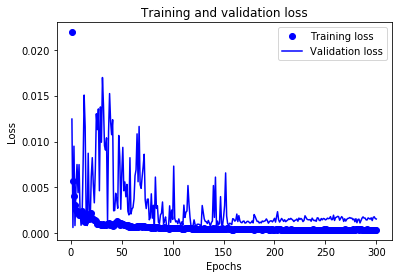

RUA_de5_tcn_clf9_n512_pe0.01_1:
(1254,)
The Adjusted R2 score on the Test set is:	-0.340
The Custom  sign score on the Test set is:	0.502
The Custom  R2 score on the Test set is:	0.081
Model: "model_22"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_23 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_23[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

Epoch 8/300
5667/5667==============================] - 3s 450us/sample - loss: 0.0022 - val_loss: 0.0111
Epoch 9/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0017 - val_loss: 0.0116
Epoch 10/300
5667/5667==============================] - 3s 451us/sample - loss: 0.0016 - val_loss: 0.0075
Epoch 11/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0016 - val_loss: 0.0061
Epoch 12/300
5667/5667==============================] - 3s 451us/sample - loss: 0.0020 - val_loss: 9.9844e-04
Epoch 13/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0025 - val_loss: 0.0030
Epoch 14/300
5667/5667==============================] - 3s 450us/sample - loss: 0.0020 - val_loss: 0.0072
Epoch 15/300
5667/5667==============================] - 3s 450us/sample - loss: 0.0018 - val_loss: 0.0137
Epoch 16/300
5667/5667==============================] - 3s 450us/sample - loss: 0.0015 - val_loss: 0.0060
Epoch 17/300
5667/5667======================

5667/5667==============================] - 3s 451us/sample - loss: 4.8600e-04 - val_loss: 0.0029
Epoch 155/300
5667/5667==============================] - 3s 452us/sample - loss: 5.1470e-04 - val_loss: 0.0016
Epoch 156/300
5667/5667==============================] - 3s 451us/sample - loss: 4.8117e-04 - val_loss: 0.0013
Epoch 157/300
5667/5667==============================] - 3s 451us/sample - loss: 4.6538e-04 - val_loss: 0.0011
Epoch 158/300
5667/5667==============================] - 3s 450us/sample - loss: 4.4136e-04 - val_loss: 9.3489e-04
Epoch 159/300
5667/5667==============================] - 3s 450us/sample - loss: 4.2942e-04 - val_loss: 0.0011
Epoch 160/300
5667/5667==============================] - 3s 449us/sample - loss: 4.5349e-04 - val_loss: 0.0012
Epoch 161/300
5667/5667==============================] - 3s 450us/sample - loss: 4.4053e-04 - val_loss: 0.0016
Epoch 162/300
5667/5667==============================] - 3s 449us/sample - loss: 4.7273e-04 - val_loss: 0.0011
Epoch 163/3

Epoch 228/300
5667/5667==============================] - 3s 450us/sample - loss: 3.8593e-04 - val_loss: 0.0016
Epoch 229/300
5667/5667==============================] - 3s 458us/sample - loss: 3.8544e-04 - val_loss: 0.0016
Epoch 230/300
5667/5667==============================] - 3s 449us/sample - loss: 4.0549e-04 - val_loss: 0.0016
Epoch 231/300
5667/5667==============================] - 3s 447us/sample - loss: 4.1214e-04 - val_loss: 0.0015
Epoch 232/300
5667/5667==============================] - 3s 450us/sample - loss: 4.0805e-04 - val_loss: 0.0016
Epoch 233/300
5667/5667==============================] - 3s 454us/sample - loss: 4.0086e-04 - val_loss: 0.0018
Epoch 234/300
5667/5667==============================] - 3s 450us/sample - loss: 4.1693e-04 - val_loss: 0.0014
Epoch 235/300
5667/5667==============================] - 3s 450us/sample - loss: 4.2544e-04 - val_loss: 0.0015
Epoch 236/300
5667/5667==============================] - 3s 450us/sample - loss: 3.9034e-04 - val_loss: 0.0016
E

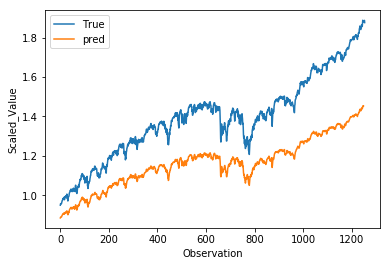

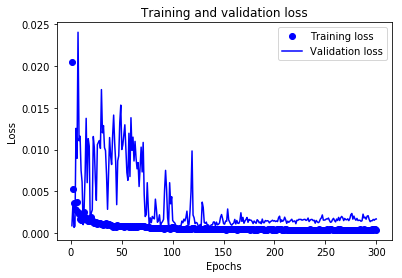

RUA_de5_tcn_clf9_n512_pe0.01_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.419
The Custom  sign score on the Test set is:	0.493
The Custom  R2 score on the Test set is:	0.037
Model: "model_23"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_24[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

Epoch 8/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0016 - val_loss: 8.1049e-04
Epoch 9/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0021 - val_loss: 0.0027
Epoch 10/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0016 - val_loss: 0.0021
Epoch 11/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0024 - val_loss: 0.0038
Epoch 12/300
5667/5667==============================] - 3s 453us/sample - loss: 0.0032 - val_loss: 0.0187
Epoch 13/300
5667/5667==============================] - 3s 453us/sample - loss: 0.0033 - val_loss: 0.0011
Epoch 14/300
5667/5667==============================] - 3s 454us/sample - loss: 0.0036 - val_loss: 0.0018
Epoch 15/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0020 - val_loss: 0.0052
Epoch 16/300
5667/5667==============================] - 3s 452us/sample - loss: 0.0018 - val_loss: 0.0096
Epoch 17/300
5667/5667======================

5667/5667==============================] - 3s 458us/sample - loss: 4.1516e-04 - val_loss: 0.0012
Epoch 157/300
5667/5667==============================] - 3s 476us/sample - loss: 4.2022e-04 - val_loss: 0.0014
Epoch 158/300
5667/5667==============================] - 3s 460us/sample - loss: 4.3019e-04 - val_loss: 0.0012
Epoch 159/300
5667/5667==============================] - 3s 462us/sample - loss: 4.2960e-04 - val_loss: 0.0015
Epoch 160/300
5667/5667==============================] - 3s 454us/sample - loss: 4.4779e-04 - val_loss: 0.0014
Epoch 161/300
5667/5667==============================] - 3s 454us/sample - loss: 4.6771e-04 - val_loss: 0.0012
Epoch 162/300
5667/5667==============================] - 3s 454us/sample - loss: 4.2490e-04 - val_loss: 0.0011
Epoch 163/300
5667/5667==============================] - 3s 453us/sample - loss: 4.2845e-04 - val_loss: 0.0013
Epoch 164/300
5667/5667==============================] - 3s 453us/sample - loss: 4.5157e-04 - val_loss: 0.0016
Epoch 165/300
5

Epoch 229/300
5667/5667==============================] - 3s 453us/sample - loss: 4.0088e-04 - val_loss: 0.0016
Epoch 230/300
5667/5667==============================] - 3s 453us/sample - loss: 4.1789e-04 - val_loss: 0.0014
Epoch 231/300
5667/5667==============================] - 3s 452us/sample - loss: 4.1237e-04 - val_loss: 0.0015
Epoch 232/300
5667/5667==============================] - 3s 455us/sample - loss: 4.0304e-04 - val_loss: 0.0017
Epoch 233/300
5667/5667==============================] - 3s 451us/sample - loss: 3.8298e-04 - val_loss: 0.0019
Epoch 234/300
5667/5667==============================] - 3s 454us/sample - loss: 3.9946e-04 - val_loss: 0.0016
Epoch 235/300
5667/5667==============================] - 3s 452us/sample - loss: 4.1359e-04 - val_loss: 0.0014
Epoch 236/300
5667/5667==============================] - 3s 452us/sample - loss: 4.0580e-04 - val_loss: 0.0015
Epoch 237/300
5667/5667==============================] - 3s 452us/sample - loss: 3.8975e-04 - val_loss: 0.0015
E

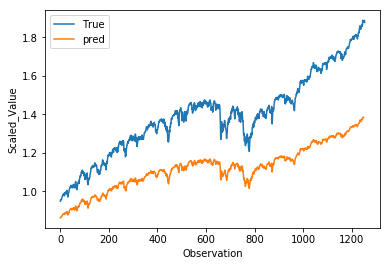

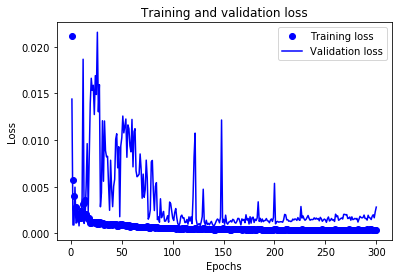

RUA_de5_tcn_clf9_n512_pe0.01_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.968
The Custom  sign score on the Test set is:	0.501
The Custom  R2 score on the Test set is:	-0.233
Model: "model_24"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_25 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_25[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
acti

Epoch 83/300
5667/5667==============================] - 3s 461us/sample - loss: 5.9918e-04 - val_loss: 0.0050
Epoch 84/300
5667/5667==============================] - 3s 453us/sample - loss: 6.6298e-04 - val_loss: 0.0080
Epoch 85/300
5667/5667==============================] - 3s 454us/sample - loss: 7.0760e-04 - val_loss: 0.0040
Epoch 86/300
5667/5667==============================] - 3s 455us/sample - loss: 6.1625e-04 - val_loss: 0.0032
Epoch 87/300
5667/5667==============================] - 3s 456us/sample - loss: 6.2522e-04 - val_loss: 0.0018
Epoch 88/300
5667/5667==============================] - 3s 456us/sample - loss: 5.9020e-04 - val_loss: 0.0025
Epoch 89/300
5667/5667==============================] - 3s 455us/sample - loss: 5.9304e-04 - val_loss: 0.0037
Epoch 90/300
5667/5667==============================] - 3s 455us/sample - loss: 7.3736e-04 - val_loss: 0.0013
Epoch 91/300
5667/5667==============================] - 3s 456us/sample - loss: 6.4055e-04 - val_loss: 0.0078
Epoch 92/3

5667/5667==============================] - 3s 454us/sample - loss: 4.2981e-04 - val_loss: 0.0015
Epoch 156/300
5667/5667==============================] - 3s 455us/sample - loss: 4.4147e-04 - val_loss: 0.0015
Epoch 157/300
5667/5667==============================] - 3s 455us/sample - loss: 4.5670e-04 - val_loss: 0.0014
Epoch 158/300
5667/5667==============================] - 3s 455us/sample - loss: 4.1894e-04 - val_loss: 0.0016
Epoch 159/300
5667/5667==============================] - 3s 455us/sample - loss: 4.3861e-04 - val_loss: 0.0019
Epoch 160/300
5667/5667==============================] - 3s 455us/sample - loss: 4.7960e-04 - val_loss: 0.0015
Epoch 161/300
5667/5667==============================] - 3s 456us/sample - loss: 4.2845e-04 - val_loss: 0.0011
Epoch 162/300
5667/5667==============================] - 3s 455us/sample - loss: 4.3624e-04 - val_loss: 0.0010
Epoch 163/300
5667/5667==============================] - 3s 455us/sample - loss: 4.3715e-04 - val_loss: 0.0012
Epoch 164/300
5

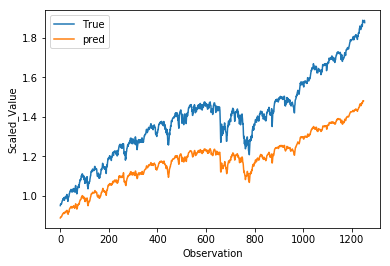

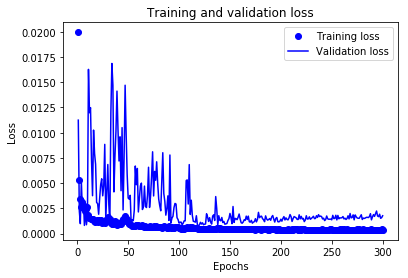

RUA_de5_tcn_clf9_n512_pe0.01_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.202
The Custom  sign score on the Test set is:	0.495
The Custom  R2 score on the Test set is:	0.146
Model: "model_25"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_26 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_26[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

5667/5667==============================] - 3s 457us/sample - loss: 0.0018 - val_loss: 9.1726e-04
Epoch 9/300
5667/5667==============================] - 3s 474us/sample - loss: 0.0017 - val_loss: 7.7461e-04
Epoch 10/300
5667/5667==============================] - 3s 466us/sample - loss: 0.0027 - val_loss: 0.0033
Epoch 11/300
5667/5667==============================] - 3s 461us/sample - loss: 0.0026 - val_loss: 0.0012
Epoch 12/300
5667/5667==============================] - 3s 459us/sample - loss: 0.0035 - val_loss: 0.0186
Epoch 13/300
5667/5667==============================] - 3s 464us/sample - loss: 0.0041 - val_loss: 0.0032
Epoch 14/300
5667/5667==============================] - 3s 455us/sample - loss: 0.0020 - val_loss: 0.0087
Epoch 15/300
5667/5667==============================] - 3s 457us/sample - loss: 0.0016 - val_loss: 0.0142
Epoch 16/300
5667/5667==============================] - 3s 458us/sample - loss: 0.0015 - val_loss: 0.0159
Epoch 17/300
5667/5667==============================

5667/5667==============================] - 3s 455us/sample - loss: 6.3268e-04 - val_loss: 0.0010
Epoch 84/300
5667/5667==============================] - 3s 455us/sample - loss: 5.9921e-04 - val_loss: 9.9456e-04
Epoch 85/300
5667/5667==============================] - 3s 453us/sample - loss: 5.8660e-04 - val_loss: 9.1399e-04
Epoch 86/300
5667/5667==============================] - 3s 454us/sample - loss: 6.4308e-04 - val_loss: 0.0045
Epoch 87/300
5667/5667==============================] - 3s 453us/sample - loss: 6.3438e-04 - val_loss: 0.0030
Epoch 88/300
5667/5667==============================] - 3s 455us/sample - loss: 6.4907e-04 - val_loss: 0.0017
Epoch 89/300
5667/5667==============================] - 3s 450us/sample - loss: 6.2305e-04 - val_loss: 0.0015
Epoch 90/300
5667/5667==============================] - 3s 456us/sample - loss: 6.1815e-04 - val_loss: 0.0018
Epoch 91/300
5667/5667==============================] - 3s 453us/sample - loss: 6.0799e-04 - val_loss: 0.0020
Epoch 92/300
56

5667/5667==============================] - 3s 452us/sample - loss: 4.0693e-04 - val_loss: 0.0018
Epoch 230/300
5667/5667==============================] - 3s 452us/sample - loss: 3.9786e-04 - val_loss: 0.0015
Epoch 231/300
5667/5667==============================] - 3s 454us/sample - loss: 3.8902e-04 - val_loss: 0.0017
Epoch 232/300
5667/5667==============================] - 3s 452us/sample - loss: 3.8766e-04 - val_loss: 0.0016
Epoch 233/300
5667/5667==============================] - 3s 452us/sample - loss: 4.0789e-04 - val_loss: 0.0016
Epoch 234/300
5667/5667==============================] - 3s 452us/sample - loss: 3.9498e-04 - val_loss: 0.0017
Epoch 235/300
5667/5667==============================] - 3s 453us/sample - loss: 4.1558e-04 - val_loss: 0.0018
Epoch 236/300
5667/5667==============================] - 3s 452us/sample - loss: 4.0987e-04 - val_loss: 0.0017
Epoch 237/300
5667/5667==============================] - 3s 452us/sample - loss: 3.9883e-04 - val_loss: 0.0018
Epoch 238/300
5

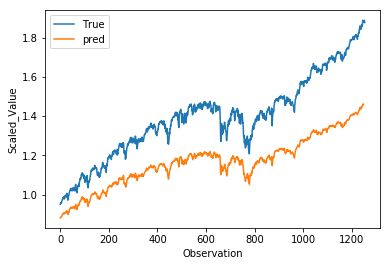

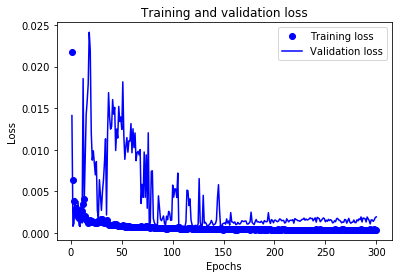

RUA_de5_tcn_clf9_n512_pe0.01_5:
(1254,)
The Adjusted R2 score on the Test set is:	-0.387
The Custom  sign score on the Test set is:	0.498
The Custom  R2 score on the Test set is:	0.055
Model: "model_26"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_27[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

Epoch 8/300
5667/5667==============================] - 3s 456us/sample - loss: 0.0022 - val_loss: 0.0104
Epoch 9/300
5667/5667==============================] - 3s 454us/sample - loss: 0.0027 - val_loss: 0.0059
Epoch 10/300
5667/5667==============================] - 3s 457us/sample - loss: 0.0032 - val_loss: 0.0027
Epoch 11/300
5667/5667==============================] - 3s 449us/sample - loss: 0.0021 - val_loss: 0.0055
Epoch 12/300
5667/5667==============================] - 3s 454us/sample - loss: 0.0019 - val_loss: 0.0050
Epoch 13/300
5667/5667==============================] - 3s 454us/sample - loss: 0.0019 - val_loss: 0.0088
Epoch 14/300
5667/5667==============================] - 3s 457us/sample - loss: 0.0017 - val_loss: 0.0061
Epoch 15/300
5667/5667==============================] - 3s 454us/sample - loss: 0.0012 - val_loss: 0.0118
Epoch 16/300
5667/5667==============================] - 3s 454us/sample - loss: 0.0012 - val_loss: 0.0178
Epoch 17/300
5667/5667==========================

5667/5667==============================] - 3s 459us/sample - loss: 4.7048e-04 - val_loss: 0.0013
Epoch 157/300
5667/5667==============================] - 3s 460us/sample - loss: 4.4256e-04 - val_loss: 0.0011
Epoch 158/300
5667/5667==============================] - 3s 459us/sample - loss: 4.3532e-04 - val_loss: 0.0011
Epoch 159/300
5667/5667==============================] - 3s 458us/sample - loss: 4.4844e-04 - val_loss: 9.4646e-04
Epoch 160/300
5667/5667==============================] - 3s 458us/sample - loss: 4.2549e-04 - val_loss: 0.0010
Epoch 161/300
5667/5667==============================] - 3s 460us/sample - loss: 4.3638e-04 - val_loss: 0.0012
Epoch 162/300
5667/5667==============================] - 3s 461us/sample - loss: 4.5119e-04 - val_loss: 0.0010
Epoch 163/300
5667/5667==============================] - 3s 457us/sample - loss: 4.1323e-04 - val_loss: 0.0012
Epoch 164/300
5667/5667==============================] - 3s 459us/sample - loss: 4.4654e-04 - val_loss: 0.0013
Epoch 165/3

y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.428438
The Adjusted R2 score on the Test set is:	-0.434


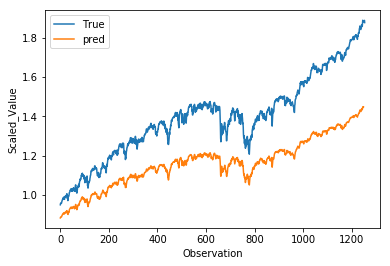

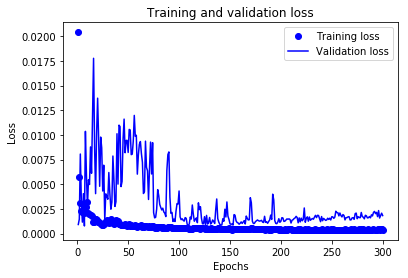

RUA_de5_tcn_clf9_n512_pe0.01_6:
(1254,)
The Adjusted R2 score on the Test set is:	-0.434
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.031
Model: "model_27"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_28 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_28[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

5667/5667==============================] - 3s 463us/sample - loss: 0.0031 - val_loss: 0.0031
Epoch 9/300
5667/5667==============================] - 3s 461us/sample - loss: 0.0031 - val_loss: 0.0040
Epoch 10/300
5667/5667==============================] - 3s 461us/sample - loss: 0.0024 - val_loss: 0.0084
Epoch 11/300
5667/5667==============================] - 3s 460us/sample - loss: 0.0023 - val_loss: 0.0072
Epoch 12/300
5667/5667==============================] - 3s 461us/sample - loss: 0.0013 - val_loss: 0.0074
Epoch 13/300
5667/5667==============================] - ETA: 0s - loss: 0.001 - 3s 461us/sample - loss: 0.0013 - val_loss: 0.0118
Epoch 14/300
5667/5667==============================] - 3s 457us/sample - loss: 0.0012 - val_loss: 0.0095: 0s - loss: 0.001
Epoch 15/300
5667/5667==============================] - 3s 461us/sample - loss: 0.0013 - val_loss: 0.0125
Epoch 16/300
5667/5667==============================] - 3s 460us/sample - loss: 0.0014 - val_loss: 0.0012
Epoch 17/300
5667/

5667/5667==============================] - 3s 464us/sample - loss: 4.6867e-04 - val_loss: 0.0016
Epoch 157/300
5667/5667==============================] - 3s 464us/sample - loss: 4.9589e-04 - val_loss: 0.0025
Epoch 158/300
5667/5667==============================] - 3s 464us/sample - loss: 4.9398e-04 - val_loss: 0.0014
Epoch 159/300
5667/5667==============================] - 3s 464us/sample - loss: 4.7402e-04 - val_loss: 0.0014
Epoch 160/300
5667/5667==============================] - 3s 464us/sample - loss: 4.6784e-04 - val_loss: 0.0012
Epoch 161/300
5667/5667==============================] - 3s 462us/sample - loss: 4.3115e-04 - val_loss: 0.0014
Epoch 162/300
5667/5667==============================] - 3s 463us/sample - loss: 4.5980e-04 - val_loss: 0.0013
Epoch 163/300
5667/5667==============================] - 3s 462us/sample - loss: 4.7357e-04 - val_loss: 0.0011
Epoch 164/300
5667/5667==============================] - 3s 462us/sample - loss: 4.5255e-04 - val_loss: 0.0012
Epoch 165/300
5

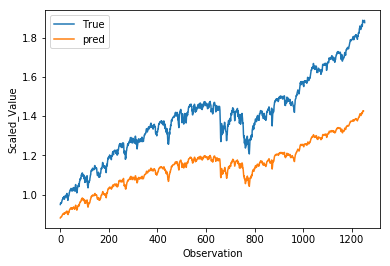

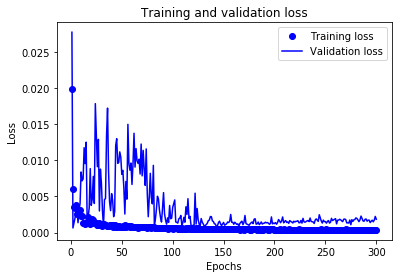

RUA_de5_tcn_clf9_n512_pe0.01_7:
(1254,)
The Adjusted R2 score on the Test set is:	-0.592
The Custom  sign score on the Test set is:	0.500
The Custom  R2 score on the Test set is:	-0.046
Model: "model_28"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_29 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_29[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
acti

5667/5667==============================] - 3s 475us/sample - loss: 6.5030e-04 - val_loss: 0.0030
Epoch 82/300
5667/5667==============================] - 3s 469us/sample - loss: 7.6360e-04 - val_loss: 0.00730s - 
Epoch 83/300
5667/5667==============================] - 3s 472us/sample - loss: 7.4637e-04 - val_loss: 0.0024
Epoch 84/300
5667/5667==============================] - 3s 465us/sample - loss: 7.5706e-04 - val_loss: 0.0016
Epoch 85/300
5667/5667==============================] - 3s 467us/sample - loss: 6.9367e-04 - val_loss: 9.6455e-04
Epoch 86/300
5667/5667==============================] - ETA: 0s - loss: 5.5141e-0 - 3s 470us/sample - loss: 5.5766e-04 - val_loss: 0.0010
Epoch 87/300
5667/5667==============================] - 3s 476us/sample - loss: 5.2275e-04 - val_loss: 7.3905e-04
Epoch 88/300
5667/5667==============================] - 3s 469us/sample - loss: 4.8936e-04 - val_loss: 6.3654e-04
Epoch 89/300
5667/5667==============================] - 3s 467us/sample - loss: 4.7967e-

5667/5667==============================] - 3s 467us/sample - loss: 3.9514e-04 - val_loss: 0.0012
Epoch 223/300
5667/5667==============================] - 3s 468us/sample - loss: 3.7935e-04 - val_loss: 0.0015
Epoch 224/300
5667/5667==============================] - 3s 469us/sample - loss: 4.0154e-04 - val_loss: 0.0015
Epoch 225/300
5667/5667==============================] - 3s 469us/sample - loss: 3.9411e-04 - val_loss: 0.0014l
Epoch 226/300
5667/5667==============================] - 3s 471us/sample - loss: 4.0226e-04 - val_loss: 0.0020
Epoch 227/300
5667/5667==============================] - 3s 468us/sample - loss: 4.3404e-04 - val_loss: 0.0015
Epoch 228/300
5667/5667==============================] - ETA: 0s - loss: 4.3789e-0 - 3s 467us/sample - loss: 4.4209e-04 - val_loss: 0.0013
Epoch 229/300
5667/5667==============================] - 3s 467us/sample - loss: 4.0555e-04 - val_loss: 0.0012
Epoch 230/300
5667/5667==============================] - 3s 468us/sample - loss: 3.9784e-04 - val

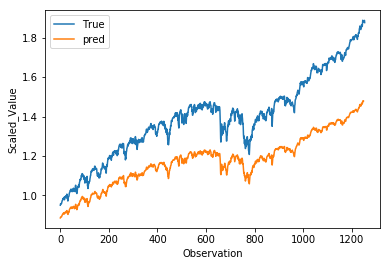

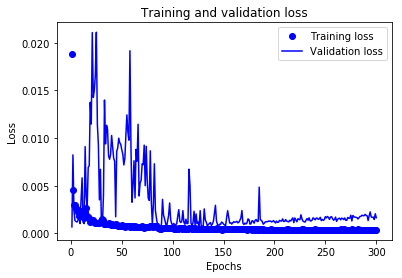

RUA_de5_tcn_clf9_n512_pe0.01_8:
(1254,)
The Adjusted R2 score on the Test set is:	-0.268
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.114
Model: "model_29"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_30 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_30[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

5667/5667==============================] - 3s 459us/sample - loss: 6.7403e-04 - val_loss: 0.0017
Epoch 82/300
5667/5667==============================] - 3s 462us/sample - loss: 6.2394e-04 - val_loss: 0.0022
Epoch 83/300
5667/5667==============================] - 3s 463us/sample - loss: 6.4285e-04 - val_loss: 0.0017
Epoch 84/300
5667/5667==============================] - 3s 463us/sample - loss: 6.4816e-04 - val_loss: 0.0049
Epoch 85/300
5667/5667==============================] - 3s 460us/sample - loss: 7.1281e-04 - val_loss: 0.0064
Epoch 86/300
5667/5667==============================] - 3s 461us/sample - loss: 6.6957e-04 - val_loss: 0.0028
Epoch 87/300
5667/5667==============================] - 3s 461us/sample - loss: 6.7192e-04 - val_loss: 0.0023
Epoch 88/300
5667/5667==============================] - 3s 461us/sample - loss: 6.6864e-04 - val_loss: 0.0044
Epoch 89/300
5667/5667==============================] - 3s 461us/sample - loss: 6.3639e-04 - val_loss: 0.0013
Epoch 90/300
5667/5667=

5667/5667==============================] - ETA: 0s - loss: 4.9506e-0 - 3s 463us/sample - loss: 4.9681e-04 - val_loss: 0.0013
Epoch 155/300
5667/5667==============================] - 3s 459us/sample - loss: 4.7892e-04 - val_loss: 0.0014
Epoch 156/300
5667/5667==============================] - 3s 461us/sample - loss: 4.7286e-04 - val_loss: 0.0013
Epoch 157/300
5667/5667==============================] - 3s 460us/sample - loss: 4.6536e-04 - val_loss: 0.0017
Epoch 158/300
5667/5667==============================] - 3s 461us/sample - loss: 4.7988e-04 - val_loss: 0.0015
Epoch 159/300
5667/5667==============================] - 3s 460us/sample - loss: 4.7841e-04 - val_loss: 0.0017
Epoch 160/300
5667/5667==============================] - 3s 463us/sample - loss: 5.0846e-04 - val_loss: 0.0012
Epoch 161/300
5667/5667==============================] - 3s 463us/sample - loss: 4.6028e-04 - val_loss: 0.0013
Epoch 162/300
5667/5667==============================] - 3s 463us/sample - loss: 4.5290e-04 - val_

5667/5667==============================] - 3s 462us/sample - loss: 3.9541e-04 - val_loss: 0.0017
Epoch 299/300
5667/5667==============================] - 3s 463us/sample - loss: 3.9513e-04 - val_loss: 0.0014
Epoch 300/300
5667/5667==============================] - 3s 461us/sample - loss: 4.0906e-04 - val_loss: 0.0018
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.968800
The Adjusted R2 score on the Test set is:	-0.977


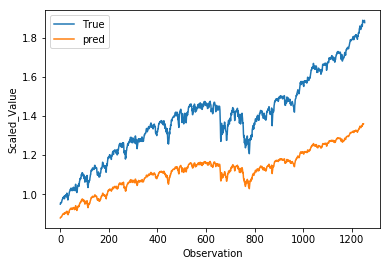

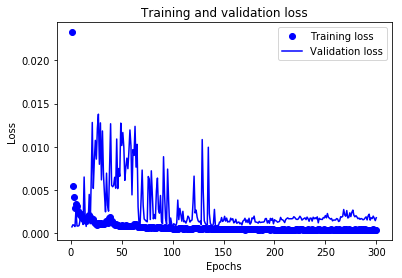

RUA_de5_tcn_clf9_n512_pe0.01_9:
(1254,)
The Adjusted R2 score on the Test set is:	-0.977
The Custom  sign score on the Test set is:	0.507
The Custom  R2 score on the Test set is:	-0.235
Model: "model_30"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_31 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_31[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
acti

5667/5667==============================] - 3s 471us/sample - loss: 7.4866e-04 - val_loss: 0.0048
Epoch 82/300
5667/5667==============================] - 3s 471us/sample - loss: 7.1825e-04 - val_loss: 0.0011
Epoch 83/300
5667/5667==============================] - 3s 470us/sample - loss: 6.1405e-04 - val_loss: 7.8211e-04
Epoch 84/300
5667/5667==============================] - 3s 471us/sample - loss: 6.3018e-04 - val_loss: 7.9052e-04
Epoch 85/300
5667/5667==============================] - 3s 471us/sample - loss: 6.3381e-04 - val_loss: 0.0048
Epoch 86/300
5667/5667==============================] - 3s 470us/sample - loss: 6.8482e-04 - val_loss: 0.0035
Epoch 87/300
5667/5667==============================] - 3s 470us/sample - loss: 6.6327e-04 - val_loss: 0.0013
Epoch 88/300
5667/5667==============================] - 3s 471us/sample - loss: 6.3369e-04 - val_loss: 8.7120e-04
Epoch 89/300
5667/5667==============================] - 3s 470us/sample - loss: 5.7455e-04 - val_loss: 0.0011
Epoch 90/30

5667/5667==============================] - 3s 471us/sample - loss: 4.2204e-04 - val_loss: 0.0019
Epoch 222/300
5667/5667==============================] - 3s 474us/sample - loss: 4.4724e-04 - val_loss: 0.0013
Epoch 223/300
5667/5667==============================] - 3s 471us/sample - loss: 4.2881e-04 - val_loss: 0.0016
Epoch 224/300
5667/5667==============================] - 3s 471us/sample - loss: 4.2980e-04 - val_loss: 0.0017
Epoch 225/300
5667/5667==============================] - 3s 470us/sample - loss: 4.1871e-04 - val_loss: 0.0016
Epoch 226/300
5667/5667==============================] - 3s 471us/sample - loss: 4.0938e-04 - val_loss: 0.0016
Epoch 227/300
5667/5667==============================] - 3s 469us/sample - loss: 4.0860e-04 - val_loss: 0.0015
Epoch 228/300
5667/5667==============================] - 3s 468us/sample - loss: 4.1051e-04 - val_loss: 0.0017ss: 5. - ETA: 0s - loss: 2.3 - ETA: 0s - loss: 2
Epoch 229/300
5667/5667==============================] - 3s 470us/sample - los

5667/5667==============================] - 3s 471us/sample - loss: 4.0682e-04 - val_loss: 0.0016
Epoch 294/300
5667/5667==============================] - 3s 470us/sample - loss: 3.9471e-04 - val_loss: 0.0018
Epoch 295/300
5667/5667==============================] - 3s 471us/sample - loss: 4.4516e-04 - val_loss: 0.0017
Epoch 296/300
5667/5667==============================] - 3s 471us/sample - loss: 4.1310e-04 - val_loss: 0.0020
Epoch 297/300
5667/5667==============================] - 3s 470us/sample - loss: 4.1349e-04 - val_loss: 0.0017
Epoch 298/300
5667/5667==============================] - 3s 471us/sample - loss: 4.0608e-04 - val_loss: 0.0016
Epoch 299/300
5667/5667==============================] - 3s 470us/sample - loss: 4.1512e-04 - val_loss: 0.0020
Epoch 300/300
5667/5667==============================] - 3s 470us/sample - loss: 4.0185e-04 - val_loss: 0.0016
y_pred.shape: (1254, 1)
y_test_rsquare.shape: (1254,)
R-Squared: -0.512683
The Adjusted R2 score on the Test set is:	-0.519


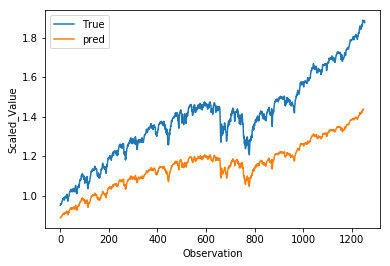

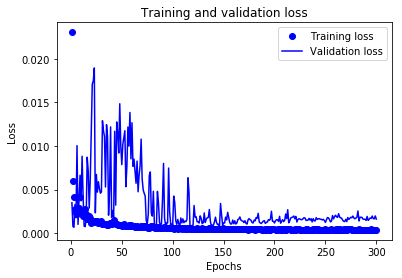

RUA_de5_tcn_clf9_n512_pe0.1_0:
(1254,)
The Adjusted R2 score on the Test set is:	-0.519
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	-0.012
Model: "model_31"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_32 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_32[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

Epoch 8/300
5667/5667==============================] - 3s 475us/sample - loss: 0.0024 - val_loss: 0.0014 lo
Epoch 9/300
5667/5667==============================] - 3s 472us/sample - loss: 0.0027 - val_loss: 0.0055
Epoch 10/300
5667/5667==============================] - 3s 472us/sample - loss: 0.0029 - val_loss: 8.2149e-04
Epoch 11/300
5667/5667==============================] - 3s 471us/sample - loss: 0.0023 - val_loss: 0.0107
Epoch 12/300
5667/5667==============================] - 3s 472us/sample - loss: 0.0016 - val_loss: 0.0027
Epoch 13/300
5667/5667==============================] - 3s 472us/sample - loss: 0.0019 - val_loss: 8.7167e-04
Epoch 14/300
5667/5667==============================] - 3s 471us/sample - loss: 0.0017 - val_loss: 0.0015A: 
Epoch 15/300
5667/5667==============================] - 3s 469us/sample - loss: 0.0020 - val_loss: 0.0015
Epoch 16/300
5667/5667==============================] - 3s 471us/sample - loss: 0.0017 - val_loss: 8.7642e-04
Epoch 17/300
5667/5667========

Epoch 83/300
5667/5667==============================] - 3s 470us/sample - loss: 6.0900e-04 - val_loss: 0.0053
Epoch 84/300
5667/5667==============================] - 3s 470us/sample - loss: 6.5970e-04 - val_loss: 0.0065
Epoch 85/300
5667/5667==============================] - 3s 469us/sample - loss: 6.6033e-04 - val_loss: 0.0107
Epoch 86/300
5667/5667==============================] - 3s 470us/sample - loss: 6.5886e-04 - val_loss: 0.0024
Epoch 87/300
5667/5667==============================] - 3s 470us/sample - loss: 6.3374e-04 - val_loss: 0.0019
Epoch 88/300
5667/5667==============================] - 3s 471us/sample - loss: 5.8661e-04 - val_loss: 0.0028
Epoch 89/300
5667/5667==============================] - 3s 470us/sample - loss: 6.0474e-04 - val_loss: 0.0013
Epoch 90/300
5667/5667==============================] - 3s 470us/sample - loss: 5.9184e-04 - val_loss: 0.0068
Epoch 91/300
5667/5667==============================] - 3s 470us/sample - loss: 6.7743e-04 - val_loss: 0.0047
Epoch 92/3

5667/5667==============================] - 3s 471us/sample - loss: 4.0503e-04 - val_loss: 0.0017
Epoch 227/300
5667/5667==============================] - 3s 469us/sample - loss: 4.1166e-04 - val_loss: 0.0017
Epoch 228/300
5667/5667==============================] - 3s 471us/sample - loss: 3.8545e-04 - val_loss: 0.0018
Epoch 229/300
5667/5667==============================] - 3s 469us/sample - loss: 4.1258e-04 - val_loss: 0.0016
Epoch 230/300
5667/5667==============================] - 3s 470us/sample - loss: 4.0433e-04 - val_loss: 0.0018
Epoch 231/300
5667/5667==============================] - ETA: 0s - loss: 3.9452e-0 - 3s 470us/sample - loss: 3.9600e-04 - val_loss: 0.0018
Epoch 232/300
5667/5667==============================] - 3s 471us/sample - loss: 3.8649e-04 - val_loss: 0.0017
Epoch 233/300
5667/5667==============================] - 3s 471us/sample - loss: 4.1931e-04 - val_loss: 0.0015
Epoch 234/300
5667/5667==============================] - 3s 469us/sample - loss: 3.9003e-04 - val_

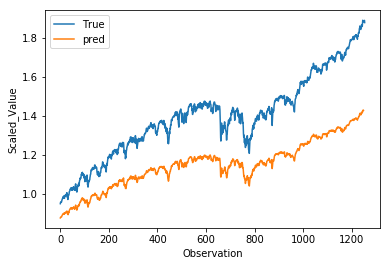

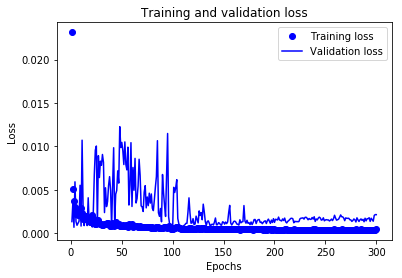

RUA_de5_tcn_clf9_n512_pe0.1_1:
(1254,)
The Adjusted R2 score on the Test set is:	-0.600
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	-0.051
Model: "model_32"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_33 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_33[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

5667/5667==============================] - 3s 474us/sample - loss: 7.4170e-04 - val_loss: 0.0049
Epoch 79/300
5667/5667==============================] - ETA: 0s - loss: 7.7879e-0 - 3s 472us/sample - loss: 7.8025e-04 - val_loss: 0.0033
Epoch 80/300
5667/5667==============================] - 3s 472us/sample - loss: 6.5828e-04 - val_loss: 0.0011
Epoch 81/300
5667/5667==============================] - 3s 469us/sample - loss: 6.7760e-04 - val_loss: 0.0090
Epoch 82/300
5667/5667==============================] - 3s 472us/sample - loss: 7.3534e-04 - val_loss: 0.0042
Epoch 83/300
5667/5667==============================] - 3s 468us/sample - loss: 7.3786e-04 - val_loss: 0.0023
Epoch 84/300
5667/5667==============================] - 3s 470us/sample - loss: 6.8097e-04 - val_loss: 0.0020
Epoch 85/300
5667/5667==============================] - 3s 476us/sample - loss: 6.7544e-04 - val_loss: 0.0013
Epoch 86/300
5667/5667==============================] - 3s 475us/sample - loss: 6.5700e-04 - val_loss: 0.

5667/5667==============================] - 3s 473us/sample - loss: 4.2499e-04 - val_loss: 0.0018
Epoch 216/300
5667/5667==============================] - 3s 474us/sample - loss: 4.0166e-04 - val_loss: 0.0019
Epoch 217/300
5667/5667==============================] - 3s 473us/sample - loss: 4.0905e-04 - val_loss: 0.0015
Epoch 218/300
5667/5667==============================] - 3s 476us/sample - loss: 4.2402e-04 - val_loss: 0.0015
Epoch 219/300
5667/5667==============================] - 3s 472us/sample - loss: 4.2014e-04 - val_loss: 0.0018
Epoch 220/300
5667/5667==============================] - 3s 476us/sample - loss: 4.4307e-04 - val_loss: 0.0018
Epoch 221/300
5667/5667==============================] - 3s 474us/sample - loss: 4.2724e-04 - val_loss: 0.0017
Epoch 222/300
5667/5667==============================] - 3s 473us/sample - loss: 4.2060e-04 - val_loss: 0.0014
Epoch 223/300
5667/5667==============================] - 3s 475us/sample - loss: 4.2470e-04 - val_loss: 0.0016
Epoch 224/300
5

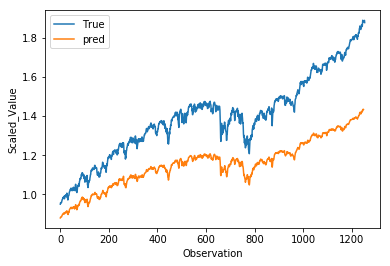

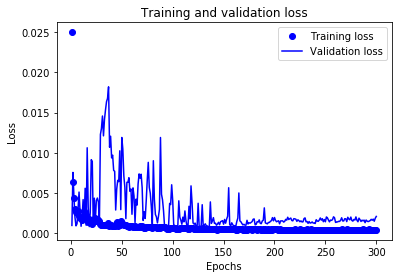

RUA_de5_tcn_clf9_n512_pe0.1_2:
(1254,)
The Adjusted R2 score on the Test set is:	-0.517
The Custom  sign score on the Test set is:	0.499
The Custom  R2 score on the Test set is:	-0.009
Model: "model_33"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_34 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_34[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activ

Epoch 73/300
5667/5667==============================] - 3s 487us/sample - loss: 6.9588e-04 - val_loss: 0.0062ETA: 0s - loss: 5.63
Epoch 74/300
5667/5667==============================] - 3s 481us/sample - loss: 7.1949e-04 - val_loss: 0.0126 loss: 5.5122 - ETA: 0s - loss: 5
Epoch 75/300
5667/5667==============================] - 3s 481us/sample - loss: 8.1433e-04 - val_loss: 0.0026oss: 7.9910e-0
Epoch 76/300
5667/5667==============================] - 3s 484us/sample - loss: 6.5650e-04 - val_loss: 0.0077TA: 2s - loss: 2. -
Epoch 77/300
5667/5667==============================] - 3s 482us/sample - loss: 7.7132e-04 - val_loss: 0.0158
Epoch 78/300
5667/5667==============================] - 3s 480us/sample - loss: 7.2483e-04 - val_loss: 0.0052
Epoch 79/300
5667/5667==============================] - 3s 479us/sample - loss: 7.0960e-04 - val_loss: 0.0023
Epoch 80/300
5667/5667==============================] - 3s 479us/sample - loss: 6.5687e-04 - val_loss: 0.0020- l - ETA: 0s - loss: 5.2
Epoch 81/

5667/5667==============================] - 3s 483us/sample - loss: 4.1974e-04 - val_loss: 0.0017
Epoch 202/300
5667/5667==============================] - 3s 480us/sample - loss: 4.4940e-04 - val_loss: 0.0016 - loss: 4.4425e-0
Epoch 203/300
5667/5667==============================] - ETA: 0s - loss: 4.4811e-04- ETA: 0s - loss: - 3s 479us/sample - loss: 4.4934e-04 - val_loss: 0.0014
Epoch 204/300
5667/5667==============================] - 3s 481us/sample - loss: 4.1099e-04 - val_loss: 0.0016- ETA: 2s - loss: 1.129 - ETA: 2s - loss: 7. - ETA: 1s - loss: 5.5 - ETA: 1s - loss: 1.4962 - ETA: 0s 
Epoch 205/300
5667/5667==============================] - ETA: 0s - loss: 4.1187e-04- ETA - ETA: 1s - 3s 479us/sample - loss: 4.1611e-04 - val_loss: 0.0017
Epoch 206/300
5667/5667==============================] - 3s 480us/sample - loss: 4.4301e-04 - val_loss: 0.0017A: 0s - loss: 3.20 - ETA: 0s - loss: 4.3985e-0
Epoch 207/300
5667/5667==============================] - 3s 482us/sample - loss: 4.1367e-04 

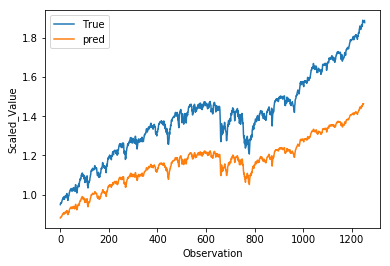

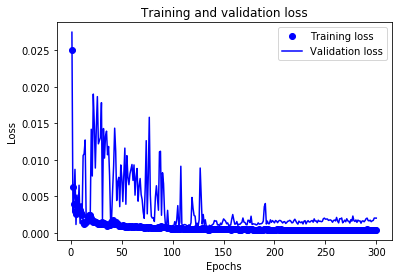

RUA_de5_tcn_clf9_n512_pe0.1_3:
(1254,)
The Adjusted R2 score on the Test set is:	-0.351
The Custom  sign score on the Test set is:	0.497
The Custom  R2 score on the Test set is:	0.073
Model: "model_34"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_35 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_35[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 3s 480us/sample - loss: 7.3007e-04 - val_loss: 0.0064 ETA: 0s - loss: 5.5975 - ETA: 0s - loss: 7.2006e-
Epoch 72/300
5667/5667==============================] - 3s 480us/sample - loss: 7.1121e-04 - val_loss: 0.0086
Epoch 73/300
5667/5667==============================] - 3s 478us/sample - loss: 8.2621e-04 - val_loss: 0.0046
Epoch 74/300
5667/5667==============================] - 3s 482us/sample - loss: 7.4691e-04 - val_loss: 0.0024
Epoch 75/300
5667/5667==============================] - 3s 481us/sample - loss: 7.3417e-04 - val_loss: 0.0037
Epoch 76/300
5667/5667==============================] - 3s 482us/sample - loss: 7.1863e-04 - val_loss: 0.0043 - loss: 7.0855e-0
Epoch 77/300
5667/5667==============================] - ETA: 0s - loss: 6.9319e-0 - ETA: 0s - loss: 6.9553e-0 - 3s 479us/sample - loss: 6.9838e-04 - val_loss: 0.0019
Epoch 78/300
5667/5667==============================] - 3s 479us/sample - loss: 6.4851e-04 - val_loss: 0.0057
Epoch 79/

5667/5667==============================] - 3s 478us/sample - loss: 4.5409e-04 - val_loss: 0.0013
Epoch 200/300
5667/5667==============================] - 3s 479us/sample - loss: 4.0847e-04 - val_loss: 0.0016- loss: 5.3112 - ETA: 1s - loss: 6.6 - ETA: 1s - loss: 2.2449 - ETA: 0s - loss - ETA: 0s - loss: 3.7968e
Epoch 201/300
5667/5667==============================] - ETA: 0s - loss: 4.2449e-04- ETA: 1s - loss: 5. - ETA: 1s - ETA: 0s - loss: 3.7122 - 3s 478us/sample - loss: 4.2621e-04 - val_loss: 0.0014
Epoch 202/300
5667/5667==============================] - 3s 478us/sample - loss: 4.1440e-04 - val_loss: 0.0019
Epoch 203/300
5667/5667==============================] - 3s 479us/sample - loss: 4.4147e-04 - val_loss: 0.0013
Epoch 204/300
5667/5667==============================] - 3s 478us/sample - loss: 4.2335e-04 - val_loss: 0.0017
Epoch 205/300
5667/5667==============================] - 3s 479us/sample - loss: 4.4639e-04 - val_loss: 0.0016
Epoch 206/300
5667/5667==========================

5667/5667==============================] - 3s 478us/sample - loss: 4.0513e-04 - val_loss: 0.0017 0s - loss: 2.8
Epoch 264/300
5667/5667==============================] - 3s 481us/sample - loss: 3.9273e-04 - val_loss: 0.0017
Epoch 265/300
5667/5667==============================] - 3s 488us/sample - loss: 4.2383e-04 - val_loss: 0.0013
Epoch 266/300
5667/5667==============================] - 3s 477us/sample - loss: 4.0974e-04 - val_loss: 0.0015
Epoch 267/300
5667/5667==============================] - ETA: 0s - loss: 3.9291e-04- - 3s 477us/sample - loss: 3.9386e-04 - val_loss: 0.0019
Epoch 268/300
5667/5667==============================] - 3s 478us/sample - loss: 3.9091e-04 - val_loss: 0.0015
Epoch 269/300
5667/5667==============================] - 3s 476us/sample - loss: 4.0326e-04 - val_loss: 0.0017
Epoch 270/300
5667/5667==============================] - 3s 478us/sample - loss: 3.8815e-04 - val_loss: 0.0015 - ETA: 0s - lo
Epoch 271/300
5667/5667==============================] - 3s 477us/

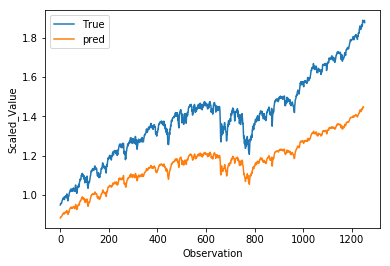

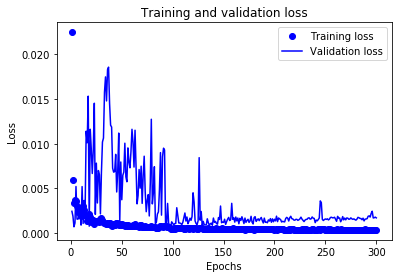

RUA_de5_tcn_clf9_n512_pe0.1_4:
(1254,)
The Adjusted R2 score on the Test set is:	-0.408
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.044
Model: "model_35"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_36 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_36[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 3s 482us/sample - loss: 7.3064e-04 - val_loss: 0.0053
Epoch 65/300
5667/5667==============================] - 3s 482us/sample - loss: 7.2089e-04 - val_loss: 0.0035
Epoch 66/300
5667/5667==============================] - 3s 482us/sample - loss: 7.3210e-04 - val_loss: 0.0052ETA: 2s - - ETA: 0s - loss: 5 - ETA: 0s - loss: 5
Epoch 67/300
5667/5667==============================] - 3s 481us/sample - loss: 7.0683e-04 - val_loss: 0.0059
Epoch 68/300
5667/5667==============================] - ETA: 0s - loss: 6.7096e-04- ETA: 0s - loss: 5.8752 - 3s 481us/sample - loss: 6.7318e-04 - val_loss: 0.0037
Epoch 69/300
5667/5667==============================] - 3s 480us/sample - loss: 6.5910e-04 - val_loss: 0.0061
Epoch 70/300
5667/5667==============================] - ETA: 0s - loss: 7.5747e-04- ETA: 0s - loss: 6.2948 - ETA: 0s - loss: 6 - 3s 481us/sample - loss: 7.5934e-04 - val_loss: 0.0061
Epoch 71/300
5667/5667==============================] - 3s 481us/sam

5667/5667==============================] - 3s 482us/sample - loss: 4.2141e-04 - val_loss: 0.0015 - - ETA: 0s - loss: 2.9181 - ETA: 0s - loss: 2. - ETA: 0s - loss: 3.8848e
Epoch 181/300
5667/5667==============================] - 3s 482us/sample - loss: 4.5313e-04 - val_loss: 0.0014
Epoch 182/300
5667/5667==============================] - 3s 482us/sample - loss: 4.2526e-04 - val_loss: 0.0014 0s - loss: 2.
Epoch 183/300
5667/5667==============================] - 3s 482us/sample - loss: 4.1257e-04 - val_loss: 0.0023
Epoch 184/300
5667/5667==============================] - 3s 482us/sample - loss: 4.8159e-04 - val_loss: 0.0015 - ETA: 0s - loss: 3.
Epoch 185/300
5667/5667==============================] - 3s 482us/sample - loss: 4.8862e-04 - val_loss: 0.0013
Epoch 186/300
5667/5667==============================] - 3s 482us/sample - loss: 4.2730e-04 - val_loss: 0.0014
Epoch 187/300
5667/5667==============================] - ETA: 0s - loss: 4.3728e-04- ETA: 2s - ETA: 1s - loss: 1.5293 - ETA: 1s 

5667/5667==============================] - 3s 482us/sample - loss: 4.1478e-04 - val_loss: 0.0023
Epoch 291/300
5667/5667==============================] - ETA: 0s - loss: 3.9590e-04- ETA: 2s - loss: 7.0123 - ETA: 1s - loss: 5 - ETA: 1s - loss: 7.841 - ETA: 1s - - ETA: 0s - loss: 3.7652e - 3s 483us/sample - loss: 3.9694e-04 - val_loss: 0.0022
Epoch 292/300
5667/5667==============================] - 3s 482us/sample - loss: 4.2334e-04 - val_loss: 0.0020
Epoch 293/300
5667/5667==============================] - ETA: 0s - loss: 3.7384e-04- ETA: 2s - - ETA: 1s - loss: 6 - ETA: 0s - los - ETA: 0s - loss: 3.6820e - 3s 483us/sample - loss: 3.7497e-04 - val_loss: 0.0018
Epoch 294/300
5667/5667==============================] - 3s 483us/sample - loss: 4.5326e-04 - val_loss: 0.0018
Epoch 295/300
5667/5667==============================] - 3s 482us/sample - loss: 3.9505e-04 - val_loss: 0.0017
Epoch 296/300
5667/5667==============================] - 3s 483us/sample - loss: 4.0041e-04 - val_loss: 0.0019 

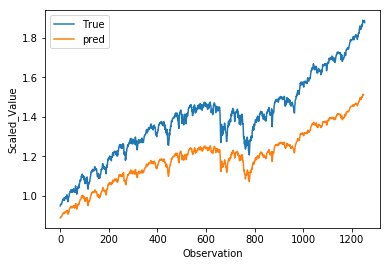

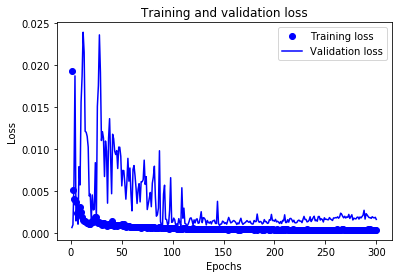

RUA_de5_tcn_clf9_n512_pe0.1_5:
(1254,)
The Adjusted R2 score on the Test set is:	-0.054
The Custom  sign score on the Test set is:	0.496
The Custom  R2 score on the Test set is:	0.221
Model: "model_36"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_37 (InputLayer)           [(None, 1, 5)]       0                                            
__________________________________________________________________________________________________
tcn_initial_conv (Conv1D)       (None, 1, 512)       3072        input_37[0][0]                   
__________________________________________________________________________________________________
tcn_d_causal_conv_1_tanh_s0 (Co (None, 1, 512)       524800      tcn_initial_conv[0][0]           
__________________________________________________________________________________________________
activa

5667/5667==============================] - 3s 492us/sample - loss: 8.4637e-04 - val_loss: 0.0080ETA: 1s - loss:  - ETA: 1s - loss: 7.02 - ETA: 0s - loss: 7 - ETA: 0s - loss: 7.8732e
Epoch 59/300
5667/5667==============================] - 3s 490us/sample - loss: 8.3922e-04 - val_loss: 0.0071
Epoch 60/300
5667/5667==============================] - 3s 488us/sample - loss: 8.3772e-04 - val_loss: 0.0081
Epoch 61/300
5667/5667==============================] - 3s 487us/sample - loss: 8.4633e-04 - val_loss: 0.00670s - loss: 7
Epoch 62/300
5667/5667==============================] - 3s 491us/sample - loss: 8.0643e-04 - val_loss: 0.0056
Epoch 63/300
5667/5667==============================] - 3s 488us/sample - loss: 7.7452e-04 - val_loss: 0.0062A: 1s - loss: 3.469 - ETA: 1s
Epoch 64/300
5667/5667==============================] - 3s 487us/sample - loss: 8.2206e-04 - val_loss: 0.0115 - ETA: 1s - loss: 6.2728e-0 - ETA: 0s -
Epoch 65/300
5667/5667==============================] - 3s 490us/sample - los

5667/5667==============================] - 3s 490us/sample - loss: 4.3977e-04 - val_loss: 9.3138e-04s - loss: 1.0623e-0 - ETA: 2s - loss: 9.9501 - ETA: 1s -  - ETA: 0s - loss: 2.67 - ETA: 0s - loss: 3.10 - ETA: 0s - loss: 3.335
Epoch 162/300
5667/5667==============================] - 3s 487us/sample - loss: 4.2062e-04 - val_loss: 0.0011ETA: 1s - loss: - ETA: 1s - loss: 2.079 - ETA: 0s - loss: 2.9107 - ETA: 0s - loss:
Epoch 163/300
5667/5667==============================] - 3s 489us/sample - loss: 4.2824e-04 - val_loss: 0.00110s - loss: 2.7475e-0 - ETA: 0s - loss: 2.9948e-0 - ETA: 0s - loss: - ETA: 0s - loss: 3.7806e-0 - ETA: 0s - loss: 3.9683e
Epoch 164/300
5667/5667==============================] - 3s 490us/sample - loss: 4.5586e-04 - val_loss: 0.0010: 2s - ETA: 0s - 
Epoch 165/300
5667/5667==============================] - 3s 489us/sample - loss: 4.3351e-04 - val_loss: 0.0014s
Epoch 166/300
5667/5667==============================] - 3s 491us/sample - loss: 4.3051e-04 - val_loss: 0.00

5667/5667==============================] - 3s 491us/sample - loss: 3.8688e-04 - val_loss: 0.0015- loss: 2.2253 - ETA: 0s - loss: 2.852 - ETA: 0s - loss: 2
Epoch 262/300
5667/5667==============================] - 3s 488us/sample - loss: 3.9868e-04 - val_loss: 0.0015
Epoch 263/300
5667/5667==============================] - 3s 489us/sample - loss: 3.9208e-04 - val_loss: 0.0017 - ETA: 1s - loss: 3.6746 - ETA: 1s - loss: 3.4112e-0 - ET - ETA: 0s - loss: 2.827
Epoch 264/300
5667/5667==============================] - 3s 492us/sample - loss: 4.0087e-04 - val_loss: 0.0016
Epoch 265/300
5667/5667==============================] - 3s 489us/sample - loss: 4.0443e-04 - val_loss: 0.0017
Epoch 266/300
5667/5667==============================] - 3s 489us/sample - loss: 3.9628e-04 - val_loss: 0.0017s - loss: 5.239 - ETA: 1s - loss: 1 - ETA: 0s - loss: 2.882 - ETA: 0s - loss: 2.7
Epoch 267/300
5667/5667==============================] - 3s 494us/sample - loss: 4.0192e-04 - val_loss: 0.0016ETA: 2s - loss: -

In [ ]:
#neurons=[512] are undone
neurons=[512]
penalties=[0.01, 0.1]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

In [ ]:
neurons=[512]
penalties=[1, 10]
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

In [ ]:
neurons=[512]
penalties=[100, 'x']
losses = tf_stock_loss_9
for neurons_j in neurons:
    for penalty_i in penalties:
        for i in range(0 ,10):
            if penalty_i == 'x':
                losses = 'mse'
            else:
                losses = tf_stock_loss_9
                penalty = penalty_i
            file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)+"_"+str(i)

            X_tr_t = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_tst_t = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            input_tensor= Input(shape=(1,X_train.shape[1],))
            output = TCN(nb_filters=neurons_j, kernel_size=2, nb_stacks=1, dilations=[1, 2, 4, 8, 16], \
                    activation='selu', padding='causal', use_skip_connections=True,\
                    dropout_rate=0.3, return_sequences=False, name='tcn')(input_tensor)  # The TCN layers are here.

            output_tensor = Dense(1)(output)
            model = Model([input_tensor], output_tensor)
            model.compile(optimizer=Adam(lr=0.0001, clipnorm=1, clipvalue=0.5), loss=losses)
            model.summary()
            early_stop = EarlyStopping(monitor='loss', patience=20, verbose=0)
            history_model = model.fit(x=[X_tr_t], y=y_train, epochs=300, 
                                                batch_size=32, verbose=1,
                                                validation_split= val_split_ratio,
                                                shuffle=False)
            plot_model_architecture(model=model, file_name=file_name)
            y_pred = predict_image(history_model=history_model,X_tst_t=X_tst_t,input_tensor=input_tensor,          
                              predict_imagepath=predict_imagepath, file_name=file_name)
            loss_image(history_model=history_model, loss_imagepath=loss_imagepath, file_name=file_name)
            save_csv(y_pred=y_pred,X_train=X_train,X_test=X_test,Target_DirPath=Target_DirPath,
                         file_name=file_name,test_date=test_date)
            save_train_csv(file_name=file_name)
            print(file_name+":")
            custom_r2_score(file_name)

# sign score

In [ ]:
import numpy as np
import pandas as pd
neurons=[32,128]
penalties=[0.01, 0.1, 1, 10, 100, 'x']

for neurons_j in neurons:
    for penalty_i in penalties:
        if penalty_i == 'x':
            losses = 'mse'
        else:
            penalty = penalty_i
        file_name='RUA_de5_tcn_clf9_n'+str(neurons_j)+'_pe'+str(penalty_i)
        print("=============================================")
        print(file_name)
        Target_DirPath = 'Deep-Learning-in-Python-master/'
        file_end_with = '.csv'
        #above need to be adjust
        df_for_eval= pd.read_csv(Target_DirPath + file_name + file_end_with)
        df_for_eval['Date'] = pd.to_datetime(df_for_eval["Date"])
        df_for_eval = df_for_eval.set_index(["Date"], drop=True)

        y_pred_for_eval = df_for_eval["Close"]
        ## create empty table with label fields
        y_pred_for_eval_data_like = np.zeros(shape=(len(y_pred_for_eval), X_train.shape[1]))
        ## put the predicted values in the right field
        y_pred_for_eval_data_like[:,0] = y_pred_for_eval[:]
        ## transform and then select the right field
        y_pred_for_eval_data = sc.transform(y_pred_for_eval_data_like)[:,0]


        r2_test = r2_score(y_test, y_pred_for_eval_data)
        print("The Adjusted R2 score on the Test set is:\t{:0.3f}"\
                  .format(adj_r2_score(r2_test, X_test.shape[0], X_test.shape[1])))

        y_test_diff = np.diff(y_test) #y_test[i]與y_test[i-1]差異
        y_pred_for_eval_data_diff = np.diff(y_pred_for_eval_data)#y_pred[i]與y_pred[i-1]差異
        rsquare_product = y_test_diff*y_pred_for_eval_data_diff #兩者相乘
        def return_same_sign_bool(d):
            d = np.array(d)
            return np.where(d > 0, 1, 0)
        rsquare_product_bool = return_same_sign_bool(rsquare_product) #如果兩者相乘為正數回傳1，非正數回傳0
        print("The Custom  sign score on the Test set is:\t{:0.3f}"\
                  .format((int(sum(rsquare_product_bool)) / len(rsquare_product_bool)))) 
                   #計算y_test及y_pred變動同向機率

        #Custom  sign score_2
        y_test_after = np.roll(y_test,-5) #y_test[i]與y_test[i-1]差異
        y_pred_for_eval_data_after = np.roll(y_pred_for_eval_data,-5)#y_pred[i]與y_pred[i-1]差異
        y_test__cl = np.subtract(y_test_after,y_test)
        y_pred_for_eval_data_cl = np.subtract(y_pred_for_eval_data_after,y_pred_for_eval_data)

        sign_raw = np.multiply(y_test__cl, y_pred_for_eval_data_cl)

        sign_bool_func = np.vectorize(lambda elements : 1 if elements <= 0  else 0)
        sign_bool = sign_bool_func(sign_raw)
        sign_bool[np.r_[-5:-1]] = 0

        print("The Custom  sign score_2 on the Test set is:\t{:0.3f}"\
                  .format((int(sum(sign_bool)) / (len(sign_bool)-5)))) 
                   #計算y_test及y_pred變動同向機率

In [ ]:
indices = tf.constant([[[0,0],[0,1]]])
updates = tf.constant([[[5, 5, 5, 5],[5, 5, 5, 5]]])
shape = tf.constant([4, 4, 4])
scatter = tf.scatter_nd(indices, updates, shape)
print(scatter)

In [ ]:
indices = tf.constant([[[0,0],[0,1]]])
updates = tf.constant([[5, 5]])
shape = tf.constant([3, 5])
scatter = tf.scatter_nd(indices, updates, shape)
print(scatter)

In [ ]:
de = list()
de = [0,2,6,7,8,9]
de[-1]